# **The open-source BTLE (Bluetooth Low Energy) baseband chip design**

Xianjun Jiao, 2024.

SPDX-FileCopyrightText: 2024 Xianjun Jiao

SPDX-License-Identifier: Apache-2.0 license

Team member:

|Name|Affiliation|IEEE Member|SSCS Member|
|----------------------------------------------|----------------------|--|--|
|Xianjun Jiao <br /> Email ID: putaoshu@msn.com|Independent researcher|No|No|

Summary of reference projects/papers:

Link|Role
----|----
https://www.bluetooth.com/specifications/specs/core-specification-5-3/|Core Specification 5.3 is the main reference. Mainly PartA&B of Vol6: Low Energy Controller
https://github.com/JiaoXianjun/BTLE|The starting point of this project. Created ~10 years ago by me. The new design files are in BTLE/python and BTLE/verilog directories
https://colab.research.google.com/github/efabless/openlane2/blob/main/notebook.ipynb|The OpenLane2 work flow I learnt/copied
https://github.com/halftop/Interface-Protocol-in-Verilog|general_uart is used for HCI (Host Controller Interface)
https://github.com/KennethWilke/sv-dpram|Dual port ram (modified in this project) IP
https://public.ccsds.org/Pubs/413x0g3e1.pdf|Figure 3-3: GMSK Using a Quadrature Modulator -- The GFSK modulation method adopted in this project
https://research.utwente.nl/en/publications/bluetooth-demodulation-algorithms-and-their-performance|Fig. 6. Phase-shift discriminator -- The GFSK demodulation method adopted in this project

Summary of the version of main packages:

|Packages|Version|
|--------|-------|
|Ubuntu | 22.04.4 LTS 64bit|
|libhackrf-dev | amd64/jammy 2021.03.1-2 uptodate|
|Icarus Verilog | version 12.0 (stable) (s20221226-498-g52d049b51)|
|cmake | version 3.22.1|
|build-essential | amd64/jammy 12.9ubuntu3 uptodate|
|Python | 3.10.12|
|numpy | Version: 1.21.5|
|matplotlib | Version: 3.5.1|
|BTLE commit | https://github.com/JiaoXianjun/BTLE/commit/3ebaad50bca03149d2a19d42ec4036c504ce6a53|
|Xilinx Vivado | 2021.1|
|openlane | 2.0.0rc2|
|sky130 PDK | bdc9412b3e468c102d01b7cf6337be06ec6e9c9a|


# **Introduction**

The open-source chip design is a hot topic in recent years. Across big companies to enthusiasts, lots of efforts have been put in multiple domains: high level instruction set definition (RISC-V), new HDL (Hardware Description Language, such as Chisel and SpinalHDL), open chip design (Rocket, BOOM), open EDA (Electronic Design Automation) tools (Yosys, OpenLane) and open PDK (Process Design Kit, such as SkyWater 130). These efforts inspired many active projects in the area of CPU (Central Processing Unit) and MCU (Micro Controller Unit) design. However open-source designs in the radio connectivity domain remain scarce. This project, the open-source BTLE (Bluetooth Low Energy) baseband chip design, aims to establish a foundational project in the domain of open radio connectivity chip design. Regarding the difference between this project and some prior arts, please find the prior art analysis section. As far as I know, this is the 1st open-source BTLE baseband project, that covers all modules from PDU to IQ sample, written in Verilog.

The main features and innovative points of this design are:
- Sub set of [BTLE core spec v5.3](https://www.bluetooth.com/specifications/specs/core-specification-5-3/)
  - LE 1M, with uncoded data at 1 Mb/s
  - GFSK (Gaussian Frequency Shift Keying) with BT(Bandwidth-bit period product)=0.5
  - Modulation index 0.5
  - Preamble has 1 octet
  - Access address has 4 octets
  - PDU (Protocol Data Unit) has 2-39 octets
  - CRC (Cyclic Redundancy Check) has 3 octets
- BER (Bit Error Rate) performance
  - With max 50PPM clock error, BER 0.1% @ 24.5dB SNR
  - With 20PPM clock error, BER 0.1% @ 11.5dB SNR
- Configurable gauss filter taps -- Flexible bandwidth/spectrum-shape
  - Support non-standard BT value or other phase smoothing strategy, such as GMSK (Gaussian Minimum Shift Keying).
- Configurable COS and SIN table -- Flexible modulation index
  - Support non-standard frequency deviation
- 16MHz main clock speed. 8x oversampling in both transmitter and receiver
  - oversampling rate is customizable in design time

The rest part of the document is organized into these sections:
- **BTLE chip architecture**
- **The overall design and implementation methodology**
- **Prior arts analysis**
- **Introduction of the reference SDR BTLE project and its users**
- **Basic principle of BTLE algorithm and structure of the project files**
- **Align the Python algorithms to the SDR BTLE project**
- **Use Python script to evaluate BER under different clock error**
- **Use Python script and Verilog testbench to simulate the design**
- **Synthesis and Implementation for Xilinx FPGA**
- **Run through OpenLane2 SKY130 PDK flow to generate GDSII**


# **BTLE chip architecture**

(It is assumed that the audiences already have basic knowledge of BTLE. If not, please check quickly the references in the SDR BTLE project: https://github.com/JiaoXianjun/BTLE/tree/master/doc)

Introduce what does the "BTLE chip" mean:
- [BTLE core spec v5.3](https://www.bluetooth.com/specifications/specs/core-specification-5-3/) Vol1 PartA Section2: "The Bluetooth Core system consists of a Host and a Controller".
- Vol4, HCI (Host Controller Interface) is defined over several options, such as UART (Universal Asynchronous Receiver-Transmitter), USB (Universal Serial Bus), etc.
- Vol6, the LE (Low Energy) Controller is composed of Physical Layer and Link Layer.
  - The Physical Layer is responsible for GFSK modulation/demodulation till RF (Radio Frequency) and antenna.
  - The Link Layer includes: packet composing/decomposing; control logic (protocol).
- In this project, BTLE chip refers to the LE controller.
architecture.svg

This project implements the LE controller that has Physical Layer and Link Layer, except that:
- ADC(Analog to Digital Converter)
- DAC(Digital to Analog Converter)
- zero-IF (Intermediate Frequency) analog transceiver

In other words, this project focuses on the baseband part, not RF.

The control logic in the Link Layer and the HCI currently are dummy modules due to the limited development time. The dummy module is suitable to be implemented by a simple MCU, such as some RISC-V project.

# **The overall design and implementation methodology**

In this project the open BTLE baseband is implemented in Verilog. The baseband bit-true algorithm model is implemented and verified in Python. The Python scripts are also used to generate test vectors and reference results for Verilog modules. The Python algorithm is based on and aligned with the parent project: [BTLE -- The open-source SDR (Software Defined Radio) Bluetooth Low Energy](https://github.com/JiaoXianjun/BTLE), which was created by me about 10 years ago. The SDR BTLE project is written in C language and can communicate with the commercial BTLE devices (Phone, Pad, etc.) via SDR hardwares (HackRF, BladeRF). It works not only in the fixed frequency advertisement channel 37/38/39, but also can track the frequency hopping data channel traffic. This means the completeness of the protocol implementation is high in the reference SDR BTLE project. The Python scripts functionalities are aligned with the SDR BTLE project, so the Python scripts are trustworthy. The Verilog testbench takes the test vectors and the reference result vectors generated by Python scripts, and simulate the functionality of the whole design in iverilog, so the Verilog design's correctness is guaranteed. The SDR BTLE C program, the Python scripts and the Verilog testbench exchange the test vectors and reference results via files in the operating system. You will see this validation chain throughout this document later on.


# **Prior arts analysis**

[Bluetooth Low Energy Baseband](https://github.com/tapeout/ble-baseband), **2018**, is a classroom project. It is written in Chisel, and only includes the bit level processing (scrambling and CRC) of the LE Link Layer. GFSK modulation and demodulation is not included. It is far from a complete LE baseband.

[Low Power Bluetooth Baseband with a RISC-V Core for Autonomous Sensors using Chisel](https://repository.tudelft.nl/islandora/object/uuid%3A1380a830-61ef-4f4b-88c2-8a8fdff2a3d4), **2022-10-13**, is a master thesis work that writes some BTLE baseband functionalities in Chisel. Like the previous classroom project, this project also mainly implements the bit level processing (scrambling and CRC). GFSK modulation and demodulation is not included. It is far from a complete LE baseband.

[A Bluetooth Low Energy Radio using FPGA SERDES: No ADC, AGC, filters, mixers, or amplifiers required.](https://github.com/newhouseb/onebitbt), **2021**, is the BTLE receiver and transmitter written in nmigen HDL. It has learnt and acknowledged my SDR BTLE project at the end of README. The main unique point of the project is implementing a kind of "Sigma Delta Modulation" with the high speed SERDES differential lines on the FPGA to create an ADC and DAC. It is a kind of experimental work mainly for demonstrating the unique idea of using FPGA SERDES as SDR radio frontend. The full support/testing of every corner of the BTLE protocol is not the main consideration. For example, it supports only fixed preamble and access address patterns for advertisement channels, and does not support the data channel packet transmission and reception. As a comparison, my SDR BTLE project targets to create a full/complete baseband that works not only for advertisement channels but also data channels. Not like the experimental SERDES idea, my project works with the mature zero-IF analog transceiver.

[A Fully Synthesizable Bluetooth Baseband Module for a System-on-a-Chip](https://onlinelibrary.wiley.com/doi/pdf/10.4218/etrij.03.0303.0018), **2003**, ETRI Journal, Volume 25, Number 5, October 2003, is for Bluetooth instead of Bluetooth LE (BT classical and LE are different). The paper is only for result reporting, not open sourcing.

# **Introduction of the reference SDR BTLE project and its users**

The [SDR BTLE project](https://github.com/JiaoXianjun/BTLE) was created by me about 10 years ago. It implements the BTLE stack in C language and can communicate with the COTS (Commercial Off The Shelf) devices via SDR boards, such as HackRF and BladeRF. The capability includes not only advertisement packet processing in the fixed frequency channel but also data packet in the frequency hopping channels. Since it was created, it has been used in multiple projects and academic papers. This track record brings people confidence if it is the starting point of the open BTLE chip design.

Some example works that are based on my SDR BTLE project:

[Bidirectional Bluetooth Backscatter With Edges](https://ieeexplore.ieee.org/document/10032655), **2024** IEEE Transactions on Mobile Computing (Volume: 23, Issue: 2, February 2024). In this work the SDR BTLE acts as a core module in the SDR edge server (with HackRF) to setup a bidirectional link between the BTLE reader and the BTLE backscatter tag.

[Bluetooth Low Energy with Software-Defined Radio Proof-of-Concept and Performance Analysis](https://vbn.aau.dk/ws/portalfiles/portal/528271663/2023_CCNC.pdf), **2023** IEEE 20th Consumer Communications and Networking Conference (CCNC). In this work, the USB based SDR devices (such as HackRF, BladeRF) in the SDR BTLE project are replaced by PCIe based SDR devices to achieve the accurate IFS (Inter Frame Space) timing requirement of the BTLE standard. The BTLE stack on the host PC is based on the SDR BTLE project.

[Tracking Anonymized Bluetooth Devices](https://people.bu.edu/staro/Tracking_Anonymized_Bluetooth_Devices__PoPETS_Camera_Ready_.pdf), **2019**, Proceedings on Privacy Enhancing Technologies. This work uses the SDR BTLE project to access the low level raw PHY bit of the BTLE packet, then discovers the vulnerability of BTLE MAC address randomization mechanism. The author says that normally some low level information/PHY-header are discarded by the ASIC/COTS BTLE chip, so SDR is a better choice for BTLE security research. The counter measure was also proposed.

[Snout: A Middleware Platform for Software-Defined Radios](https://people.bu.edu/staro/IEEE_TNSM_Snout.pdf), **2023**, IEEE Transactions on Network and Service Management (Volume: 20, Issue: 1, March 2023). This paper implemented a middleware platform that supports many SDR programs and platforms. the btle_rx program (the receiver program in the SDR BTLE project package) is integrated as a receiver example.

[Bluetooth Low Energy Receiver of portapack-mayhem](https://github.com/portapack-mayhem/mayhem-firmware/wiki/Bluetooth-Low-Energy-Receiver), **2023**. At the end of the page, it says Reference Code Used in Porting Protocol: https://github.com/JiaoXianjun/BTLE . The Portpack is a very popular "HAT" that can be integrated with HackRF SDR board, and run the SDR fully in embedded/hand-held style. The firmware has integrated lots of SDR applications. The BTLE application is based on my SDR BTLE project.

[Unveiling IoT Vulnerabilities: Exploring Replay Attacks on BLE Devices](https://medium.com/@boluksadettin_77351/unveiling-iot-vulnerabilities-exploring-replay-attacks-on-ble-devices-e79ea85bbd31), **2024**. In this experiment, the btle_tx program (the transmitter program in the SDR BTLE project package) is used to generate the attack packet. The purpose is using the SDR device to pretend any other BTLE devices.

[Security Fuzz Testing Framework for Bluetooth Low Energy Protocols](https://cccisa.ccisa.org.tw/article/view/2000/2007), **2019**, Communications of the CCISA, Regular Paper, (Vol 25, No 1, Feb 2019), TAIWAN. This paper integrates the btle_tx program for fuzzing (malformed) packet generation in their BTLE fuzzing test framework.

[Bluetooth Security](https://link.springer.com/chapter/10.1007/978-981-10-8447-8_6), **2018**, Book Chapter, pp 195-226, First Online: 20 March 2018. In this chapter of the book "Inside Radio: An Attack and Defense Guide", the SDR BTLE project is introduced as a tool for security research.



# **Basic principle of BTLE algorithm and structure of the project files**

According to the section of "BTLE chip architecture", the BTLE chip actually refers to the LE controller. The controller is composed of two modules: Link Layer and Physical Layer. The following figure shows the big picture of BTLE operation principle, and involved modules with Verilog file name in blue (Python function names are similar). It also shows what is included in this project and what is not included. To check how each module work, please refer to seciont "Use Python script and Verilog testbench to simulate the design"

btle-principle.svg

According to the standard, the Link Layer includes the control logic and packet composition/decomposition part. The Physical Layer does the GFSK modulation/demodulation till RF and antenna. The following further elaboration on the operation principle is based on the reference SDR BTLE project, the standard (core spec v5.3) and some other references. The principle is also shown in the above figure.

The packet composition, also called bit level processing, does the CRC24 calculation and pad the 3 CRC octets to the original PDU. Then scramble the PDU to get Physical Layer bits. Before sending it to GFSK modulation in Physical Layer, preamble (1 octet) and access address (4 octets) are padded before the scrambled PDU bit. According to the standard, the scrambling pattern and the preamble is related to the channel number. The CRC initial state and the access address are either fixed (advertisement channel) or negotiated with peers (data channel).

The Physical Layer GFSK modulation's principle could refer to the "Figure 3-3: GMSK Using a Quadrature Modulator" in [CCSDS 413.0-G-3](https://public.ccsds.org/Pubs/413x0g3e1.pdf). The basic idea of the implementation is that: bit 0 will drive the input address decrementing for the phase (COS and SIN) table to generate negative frequency deviation; bit 1 will drive the input address incrementing for the phase table to generate positive frequency deviation. The 0-1 transition smoothing is controlled by the coefficients of gauss filter, and this further shapes the spectrum. The max positive/negative frequency achieved is controlled by the waveform samples in the COS&SIN table. In this project, both gauss filter coefficients and COS&SIN table are configurable. This will help the design support multiple standards/purpose beyond BTLE.

The packet decomposition in the Link Layer at the receiver side does the inverse bit level processing of that in the transmitter. It is trivial.

The GFSK demodulation in the Physical Layer at the receiver side uses a simple Signal-to-Bit algorithm (digital baseband version of Fig.6 in https://research.utwente.nl/en/publications/bluetooth-demodulation-algorithms-and-their-performance):

`sign(i0*q1-i1*q0)`.

Where sign() means taking the sign of the result. Positive means 1, negative means 0. i0, q0, i1, q1 are input IQ samples at two successive sampling moments spaced by 1us (according to the LE 1M PHY in the standard)

Above actually detects whether the phase rotates clockwise or counter-clockwise between two successive IQ samples. It starts from:

`(i1+q1*j)*conj(i0+q0*j) = i1*i0+q1*q0+(i0*q1-i1*q0)*j`

It is easy to understand that the sign of the imaginary part `i0*q1-i1*q0` decides the rotation direction.

In our design, 8x oversampling is used in both transmitter and receiver. But the receiver does not know which one out of 8 sampling phases is the best after the signal experiences the circuit/channel propagation delay and the noise. So the receiver will do the GFSK demodulation and inverse bit level processing on all 8 sampling phases, and output the one that gives correct CRC checksum. The oversampling rate is also configurable.

In this project, the HCI UART interface between the controller Link Layer and the host is forked from https://github.com/halftop/Interface-Protocol-in-Verilog . The Link Layer control logic is temporarily a dummy module due to limited development time. In principle, the control logic module can be implemented by some simple RISC-V core.

The project includes two self explaining directories: python and verilog. The naming of those files are well aligned with the BTLE operation principle introduced above.

For Python files,
- **btlelib.py** has the top level transmitter function btle_tx and receiver function btle_rx. It also has all the sub-functions and some other helper functions, such as clock error emulation and AWGN (Additive White Gaussian Noise) channel.
- **btle_tx**'s subfunctions: crc24, crc24_core, scramble, scramble_core, gfsk_modulation_fixed_point, vco_fixed_point, etc.
- **btle_rx**'s subfunctions: gfsk_demodulation_fixed_point, search_unique_bit_sequence, scramble, scramble_core, crc24_core, etc.
- **test_alignment_with_btle_sdr.py** compares the signal generated by the Python transmitter (by calling btle_tx) and the signal generated by the SDR BTLE project.
- **test_btle_ber.py** simulates the BER vs SNR (Signal to Noise Ratio) under specified clock frequency error (max 50PPM according to the standard). It calls btle_tx, AWGN channel, cock error emulation, btle_rx, and runs many PDUs to get reliable BER statistics.
- **test_vector_for_btle_verilog.py** generates test vectors and the reference result vectors for Verilog testbench by using a similar script like test_btle_ber.py. The main difference is that it turns on the file saving flag.

For Verilog files,
- **btle_controller.v** is the top level module.
- **btle_controller.v** has Link Layer module btle_ll.v (with dummy control logic) and btle_phy.v, which actually include the Link Layer bit level processing and Physical Layer GFSK modulation and demodulation.
- **btle_phy.v** has btle_tx.v and btle_rx.v for transmitter and receiver respectively. btle_tx.v is matched to the btle_tx function in btlelib.py. btle_rx.v is matched to the btle_rx function in btlelib.py.
- **btle_tx.v** has submodules which are well aligned with the phython functions.
- **btle_rx.v** has 8 bele_rx_core.v instances via the "generate" method of Verilog to act as 8 parallel decoders working on 8 different sampling phases. Any of the 8 decoders has the correct CRC, the receiver will end working on the current packet. There is also a timeout logic to ensure the receiver will not work endlessly.
- **btle_rx_core.v** has submodules which are well aligned with the phython functions.
- module/submodule specific Verilog testbench file is module_name_tb.v.
- Though the top level module btle_controller.v has a UART interface, currently the UART is not used. The testbench btle_controller_tb.v uses the exposed raw Link Layer bit interface passing through the dummy Link Layer control logic.



# **Align the Python algorithms to the SDR BTLE project**

Install necessary libs, download the open BTLE chip design (python and verilog directory) and build the reference SDR BTLE project.

In [ ]:
!apt install libhackrf-dev
!apt install iverilog
%cd /content/
!rm -rf BTLE
!git clone https://github.com/JiaoXianjun/BTLE.git
%cd /content/BTLE/
!git checkout vlsi24-code-a-chip
%cd ./host/
!mkdir -p ./build
%cd ./build/
!cmake ../
!make

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libhackrf0
The following NEW packages will be installed:
  libhackrf-dev libhackrf0
0 upgraded, 2 newly installed, 0 to remove and 45 not upgraded.
Need to get 31.2 kB of archives.
After this operation, 133 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libhackrf0 amd64 2021.03.1-2 [15.5 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 libhackrf-dev amd64 2021.03.1-2 [15.7 kB]
Fetched 31.2 kB in 0s (215 kB/s)
Selecting previously unselected package libhackrf0:amd64.
(Reading database ... 121752 files and directories currently installed.)
Preparing to unpack .../libhackrf0_2021.03.1-2_amd64.deb ...
Unpacking libhackrf0:amd64 (2021.03.1-2) ...
Selecting previously unselected package libhackrf-dev.
Preparing to unpack .../libhackrf-dev_2021.03.1-2_amd64.deb ...
Unpacking

Run SDR BTLE project to generate IQ sample of a BTLE packet and save it to phy_sample.txt

In [ ]:
%cd /content/BTLE/python/
!../host/build/btle-tools/src/btle_tx 10-LL_DATA-AA-11850A1B-LLID-1-NESN-0-SN-0-MD-0-DATA-XX-CRCInit-123456

/content/BTLE/python
num_repeat not specified! (-1 means inf). Set to 1
num_repeat 1
num_packet 1

packet 0
channel_number 10
pkt_type LL_DATA
pdu payload_len 0 bytes
preamble+access+pdu(NO CRC) 56 bit
preamble+access+pdu(NO CRC) 7 byte
before crc24, pdu
0100
after crc24, pdu+crc
01009b8950
after scramble, pdu+crc
9bc14d4c14
preamble+access+pdu+crc total 80 bits 10 bytes
num_phy_bit 80
num_phy_sample 336
space 200ms
Upper byte:551b0a85110100
PHY   byte:551b0a85119bc14d4c14
PHY sample: PHY_bit_for_matlab.txt IQ_sample_for_matlab.txt and other txt files

open_board: hackrf_open() failed: HackRF not found (-5)
tx_one_buf: open_board() failed
exit


Run test_alignment_with_btle_sdr.py to call Python algorithm generating IQ sample, then calculate realtime frequency offset for the SDR BTLE generated signal (phy_sample.txt) and the Python generated signal (by calling btle_tx in btlelib.py). Save the frequency offset result to btle_fo.txt and python_fo.txt for further plotting and comparison.

In [ ]:
%cd /content/BTLE/python/
!python test_alignment_with_btle_sdr.py 2

/content/BTLE/python
argument: example_idx
2
Plese run firstly:
../host/build/btle-tools/src/btle_tx 10-LL_DATA-AA-11850A1B-LLID-1-NESN-0-SN-0-MD-0-DATA-XX-CRCInit-123456
Figure(640x480)


Please noticed that "2" is given as argument to the script. It means the example index is 2. The Python script also gives hint of this example related btle_tx command line `../host/build/btle-tools/src/btle_tx 10-LL_DATA-AA-11850A1B-LLID-1-NESN-0-SN-0-MD-0-DATA-XX-CRCInit-123456`. This command has run before. Though hardware does not exist, the IQ sample is still generated and saved to phyt_sample.txt. The command also shows some information during the packet generation:
```
...
before crc24, pdu
0100
after crc24, pdu+crc
01009b8950
after scramble, pdu+crc
9bc14d4c14
...
```
The argument `10-LL_DATA-AA-11850A1B-LLID-1-NESN-0-SN-0-MD-0-DATA-XX-CRCInit-123456` given to btle_tx means that it is a data packet in channel 10 with access address 0x11850A1B and CRC initial state 0x123456. Regarding the exact meaning of the argument of btle_tx, please refer to the project README https://github.com/JiaoXianjun/BTLE/blob/master/README.md

If you open the test_alignment_with_btle_sdr.py and find out the initialization code for example 2, you will see
```
    print('Plese run firstly:')
    print('../host/build/btle-tools/src/btle_tx 10-LL_DATA-AA-11850A1B-LLID-1-NESN-0-SN-0-MD-0-DATA-XX-CRCInit-123456')
    channel_number = 10 # from the 1st field in above btle_tx command argument
    access_address = '1B0A8511' # due to byte order, the 11850A1B in above argument needs to be 1B0A8511
    crc_state_init_hex = '123456' # from the CRCInit field in above btle_tx command argument
    crc_state_init_bit = bl.hex_string_to_bit(crc_state_init_hex) # from the CRCInit field in above btle_tx command argument
    pdu_bit_in_hex = '0100' # from the output of above btle_tx command
```
These are aligned with the argument and output of btle_tx program. This is the way of how SDR BTLE and phython take the same input. Only when the input are the same, comparison of the output is meaningful.

Now let's plot and compare the realtime frequency offset based on the output of SDR BTLE project and the Python algorithm.

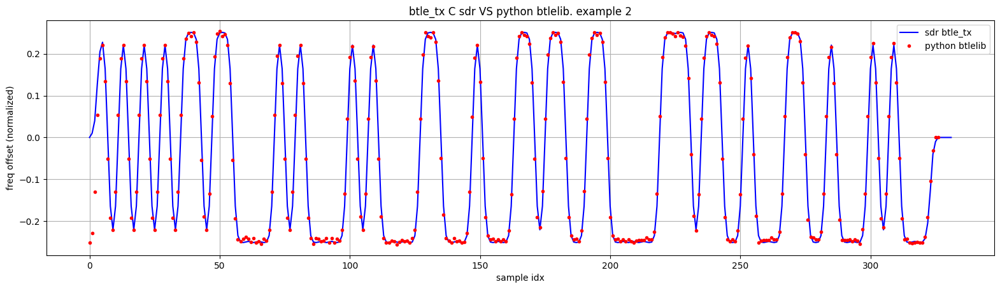

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
btle_fo = np.loadtxt('btle_fo.txt')
python_fo = np.loadtxt('python_fo.txt')
plt.figure().set_size_inches(19.2,4.8)
plt.plot(btle_fo[2:], 'b', label='sdr btle_tx')
plt.plot(python_fo[0::2], 'r.', label='python btlelib') # decimate to 4x oversampling
plt.legend(loc="upper right")
plt.title('btle_tx C sdr VS python btlelib. example '+str(2))
plt.xlabel('sample idx')
plt.ylabel('freq offset (normalized)')
plt.grid()

In the above figure the Python btlelib.py output (red dots) is well aligned with the SDR BTLE btle_tx output. The minor differences happen at the ramping up area (at the beginning) and the max frequency deviation area (around +/-0.25). It is due to the fact that the Python scripts use slightly different oversampling rate, gauss filter coefficients and COS&SIN table. But they both meet the BTLE standard requirements.

On page 2641 of the core spec v5.3, it says "The minimum frequency deviation shall never be less than 185 kHz when transmitting at 1 megasymbol per second (Msym/s) symbol rate". The above figure shows the normalized frequency offset with regards to 1Msym/s. The normalized frequency offset of 185kHz is 185KHz/1Msym/s = 0.185. In the figure, the max frequency deviation during each bit period is always bigger than 0.2 which is larger than the minimum requirement 0.185 in the standard.

Now let's run example 0 which has a longer packet in advertisement channel number 37.

In [ ]:
%cd /content/BTLE/python/
!../host/build/btle-tools/src/btle_tx 37-DISCOVERY-TxAdd-1-RxAdd-0-AdvA-010203040506-LOCAL_NAME09-SDR/Bluetooth/Low/Energy r500

/content/BTLE/python
num_repeat 500
num_packet 1

packet 0
channel_number 37
pkt_type DISCOVERY
preamble 8bit: AA
0101-0101
0101-0101 
access address 32bit: D6BE898E
0110-1011 0111-1101 1001-0001 0111-0001
0110-1011 0111-1101 1001-0001 0111-0001 
ADVA buffer begin from byte 7
display buffer begin from byte 15
pdu payload 192bit: SDR/Bluetooth/Low/Energy
1100-1010 0010-0010 0100-1010 1111-0100 0100-0010 0011-0110 1010-1110 1010-0110 0010-1110 1111-0110 1111-0110 0010-1110 0001-0110 1111-0100 0011-0010 1111-0110 1110-1110 1111-0100 1010-0010 0111-0110 1010-0110 0100-1110 1110-0110 1001-1110
1100-1010 0010-0010 0100-1010 1111-0100 0100-0010 0011-0110 1010-1110 1010-0110 0010-1110 1111-0110 1111-0110 0010-1110 0001-0110 1111-0100 0011-0010 1111-0110 1110-1110 1111-0100 1010-0010 0111-0110 1010-0110 0100-1110 1110-0110 1001-1110 
pdu header 16bit: length and AD_TYPE:
1001-1000 1001-0000
1001-1000 1001-0000 
pdu payload_len 32 bytes
preamble+access+pdu(NO CRC) 312 bit
preamble+access+pdu(NO 

Then run test_alignment_with_btle_sdr.py with example index 0 and compare the Python and SDR BTLE result. Again they are aligned.

/content/BTLE/python
argument: example_idx
0
Plese run firstly:
../host/build/btle-tools/src/btle_tx 37-DISCOVERY-TxAdd-1-RxAdd-0-AdvA-010203040506-LOCAL_NAME09-SDR/Bluetooth/Low/Energy r500
Figure(640x480)


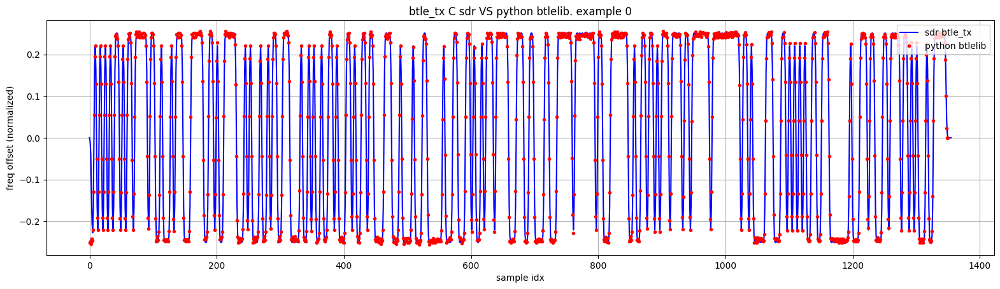

In [ ]:
%cd /content/BTLE/python/
!python test_alignment_with_btle_sdr.py 0
import numpy as np
import matplotlib.pyplot as plt
# plt.rcParams["figure.figsize"] = (18, 10)
btle_fo = np.loadtxt('btle_fo.txt')
python_fo = np.loadtxt('python_fo.txt')
plt.figure().set_size_inches(19.2,4.8)
plt.plot(btle_fo[2:], 'b', label='sdr btle_tx')
plt.plot(python_fo[0::2], 'r.', label='python btlelib') # decimate to 4x oversampling
plt.legend(loc="upper right")
plt.title('btle_tx C sdr VS python btlelib. example '+str(0))
plt.xlabel('sample idx')
plt.ylabel('freq offset (normalized)')
plt.grid()

# **Use Python script to evaluate BER under different clock error**

After we have verified Python btle_tx model/algorithm, the corresponding Python receiver algorithm is designed and implemented in btlelib.py. Please find the basic idea of the receiver algorithm in the section "Basic principle of BTLE algorithm and structure of the project files"

Then the next step is evaluating the BER (Bit Error Rate) performance of the receiver algorithm before going to the Verilog implementation. The BER performance is mainly affected by the AWGN noise, clock frequency error between the transmitter and the receiver. The multipath effect is not dominant here because the BTLE is basically a narrow band system. The related requirements in the standard (core spec v5.3) are listed:
- "3.1 MODULATION CHARACTERISTICS: The symbol timing accuracy shall be better than ±50 ppm."
- "4 RECEIVER CHARACTERISTICS: The reference sensitivity level referred to in this section is -70 dBm"
- "4.1 ACTUAL SENSITIVITY LEVEL: Maximum Supported Payload Length (bytes) 1 to 37, BER 0.1%. LE Uncoded PHYs, Sensitivity (dBm) <= -70"

For nowadays hardware quality, the above requirement is not tough. The crystal could reach PPM performance well below 50PPM easily. At -70dBm RSSI (Received Signal Strength Indicator) level, SNR could reach above 25dBm easily.

The Python script test_btle_ber.py constructs the simulation chain of btle_tx, AWGN channel and clock error emulation, btle_rx and BER statistics. It runs 300 packets with random content to achieve stable BER results. The packet has the maximum 37 octets in the PDU payload field, and 39 octets (2 octet header) in total for the PDU. It means `300*39*8 = 93600` bits passing through at each SNR point. There will be 93.6 error bits for BER 0.1%. Normally having around 100 error bits is regarded as sufficient.

Now let's run a worst 50PPM case by giving 50 as argument to the test_btle_ber.py, and plot the BER-SNR curve. It will take a while.

/content/BTLE/python
argument: ppm_value
50.0
snr_set  [22.0, 23.5, 25.0, 26.0]
pkt_count_set  [100, 200, 300, 300]
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
ppm  50.0  freq offset  122500.0 Hz snr  22.0 dB ber  0.05375  num_bit_total  31200  num_bit_err  1677
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
ppm  50.0  freq offset  122500.0 Hz snr  23.5 dB ber  0.02637820512820513  num_bit_total  62400  num_bit_err  1646
ppm  50.0  freq offset  122500.0 Hz snr  25.0 dB ber  0.00024572649572649575  num_bit_total  93600  num_bit_err  23
ppm  50.0  freq offset  122500.0 Hz snr  26.0 dB ber  0.00010683760683760684  num_bit_total  93600  num_bit_err  10
Figure(640x480)


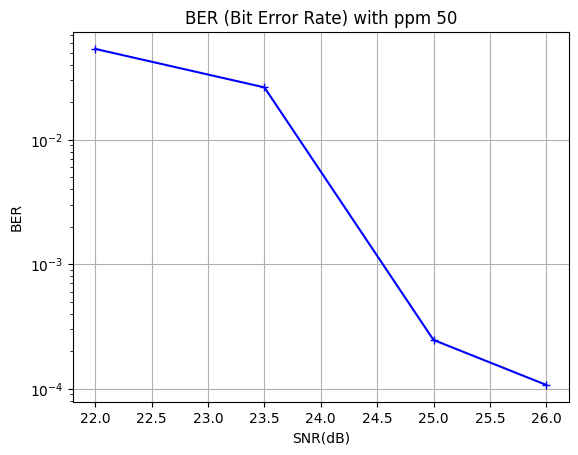

In [ ]:
%cd /content/BTLE/python/
!python test_btle_ber.py 50

import numpy as np
import matplotlib.pyplot as plt
snr_set = np.loadtxt('snr_set.txt')
ber_set = np.loadtxt('ber_set.txt')
plt.figure().set_size_inches(6.4,4.8)
plt.semilogy(snr_set, ber_set, 'b+-')
plt.title('BER (Bit Error Rate) with ppm '+str(50))
plt.xlabel('SNR(dB)')
plt.ylabel('BER')
plt.grid()

During the simulation, some realtime info is shown: ppm value, frequency offset (50PPM --> 122.5KHz under 2.45GHz center frequency of 2.4GHz ISM band), BER and related the number of error bits, etc.

The figure shows that BER 0.1% is achieved around SNR 24.5dB, which is easy to have with RSSI -70dBm. This means the receiver algorithm meets the standard requirements on BER/sensitivity.

Let's simulate another better case: -30PPM.

/content/BTLE/python
argument: ppm_value
-30.0
snr_set  [11.0, 12.5, 14.0, 15.0]
pkt_count_set  [100, 200, 300, 300]
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
btle_rx: Access address NOT found!
ppm  -30.0  freq offset  -73500.0 Hz snr  11.0 dB ber  0.038814102564102566  num_bit_total  31200  num_bit_err  1211
ppm  -30.0  freq offset  -73500.0 Hz snr  12.5 dB ber  0.003012820512820513  num_bit_total  62400  num_bit_err  188
ppm  -30.0  freq offset  -73500.0 Hz snr  14.0 dB ber  0.000844017094017094  num_bit_total  93600  num_bit_err  79
ppm  -30.0  freq offset  -73500.0 Hz snr  15.0 dB ber  0.00018162393162393162  num_bit_total  93600  num_bit_err  17
Figure(640x480)


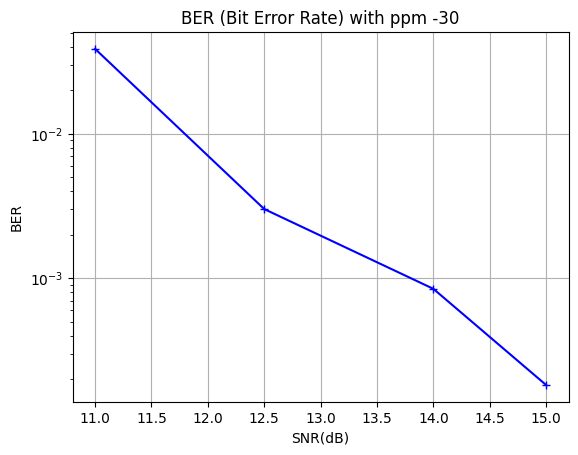

In [ ]:
%cd /content/BTLE/python/
!python test_btle_ber.py -30

import numpy as np
import matplotlib.pyplot as plt
snr_set = np.loadtxt('snr_set.txt')
ber_set = np.loadtxt('ber_set.txt')
plt.figure().set_size_inches(6.4,4.8)
plt.semilogy(snr_set, ber_set, 'b+-')
plt.title('BER (Bit Error Rate) with ppm '+str(-30))
plt.xlabel('SNR(dB)')
plt.ylabel('BER')
plt.grid()

From the above figure, BER 0.1% is achieved around SNR 13.5dB. In modern hardware, 30PPM is an easy task for a crystal, and it already can bring big gain on the sensitivity.

# **Use Python script and Verilog testbench to simulate the design**

Run test_vector_for_btle_verilog.py to generate test vectors and reference results into the verilog directory. The script also shows the input and output waveforms of some key Python/Verilog modules.

/content/BTLE/python
arguments: example_idx snr ppm_value num_sample_delay
[2, 20, 0, 0]
btle_tx command for current example:
../host/build/btle-tools/src/btle_tx 10-LL_DATA-AA-11850A1B-LLID-1-NESN-0-SN-0-MD-0-DATA-XX-CRCInit-123456
config
channel_number  10
access_address  1B0A8511
crc_state_init_hex  123456

btle_tx
before crc24, pdu
0100
after crc24, pdu+crc
01009b8950
after scramble, pdu+crc
9bc14d4c14

btle_rx
rx phy bit
9bc14d4c14
rx descramble, pdu
0100
snr  20 dB ppm  0  freq offset  0.0 Hz num of pdu bit (no header and crc)  0
crc ok  True  num_byte_payload  0  best_sample_phase_idx  0
Figure(640x480)
Figure(640x480)


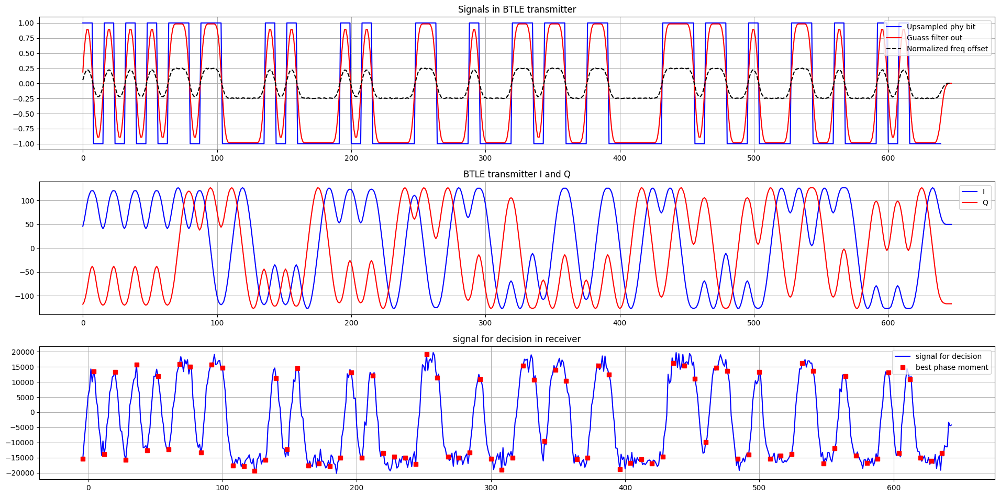

In [ ]:
%cd /content/BTLE/python/
!python test_vector_for_btle_verilog.py 2

import numpy as np
import matplotlib.pyplot as plt

plt.figure().set_size_inches(19.2,9.6)
plot_phy_bit_upsample = np.loadtxt('plot_phy_bit_upsample.txt')
plot_btle_tx_vco_test_input = np.loadtxt('plot_btle_tx_vco_test_input.txt')
plot_fo = np.loadtxt('plot_fo.txt')
plot_tx_i = np.loadtxt('plot_tx_i.txt')
plot_tx_q = np.loadtxt('plot_tx_q.txt')
plot_signal_for_decision_x = np.loadtxt('plot_signal_for_decision_x.txt')
plot_signal_for_decision_y = np.loadtxt('plot_signal_for_decision_y.txt')
plot_signal_for_decision_best_phase_x = np.loadtxt('plot_signal_for_decision_best_phase_x.txt')
plot_signal_for_decision_best_phase_y = np.loadtxt('plot_signal_for_decision_best_phase_y.txt')

ax = plt.subplot(311)
ax.plot(plot_phy_bit_upsample, 'b', label='Upsampled phy bit')
ax.plot(plot_btle_tx_vco_test_input, 'r', label='Guass filter out')
ax.plot(plot_fo, 'k--', label='Normalized freq offset')
ax.legend(loc='upper right')
ax.grid(True)
ax.set_title('Signals in BTLE transmitter')

ax = plt.subplot(312)
ax.plot(plot_tx_i, 'b', label='I')
ax.plot(plot_tx_q, 'r', label='Q')
ax.legend(loc='upper right')
ax.grid(True)
ax.set_title('BTLE transmitter I and Q')

ax = plt.subplot(313)
ax.plot(plot_signal_for_decision_x, plot_signal_for_decision_y, 'b', label='signal for decision')
ax.plot(plot_signal_for_decision_best_phase_x, plot_signal_for_decision_best_phase_y, 'rs', label='best phase moment')
ax.legend(loc='upper right')
ax.grid(True)
ax.set_title('signal for decision in receiver')
plt.tight_layout()

In above example, "2" is input as argument to test_vector_for_btle_verilog.py. It is the same example index as introduced in the section "Align the Python scripts to the SDR BTLE project".

The full argument list for test_vector_for_btle_verilog.py is: `example_idx snr ppm_value num_sample_delay`. The name is self explained.

The figure shows that:
- The upsampled PHY bit (PDU bit after CRC and scramble), which is in blue squared NRZ waveform, is shown in the top figure.
- After the gauss filter, the PHY bit NRZ waveform is smoothed, and shown in red.
- Then the gauss filter output drives the GFSK modulator to generate the IQ (COS, SIN) sample which is shown in the middle figure.
- The IQ sample related normalized frequency offset is shown in the dashed black curve in the top figure. It is well aligned with the PHY bit and gauss filter output waveform.
- The bottom figure shows the output of GFSK demodulator (algorithm: `sign(i0*q1 - i1*q0)`) in blue, and the best sampling phase (out of 8 possible phases) that gives correct CRC, in red square.

Now let's run the top level Verilog testbench btle_controller_tb.v which takes the Python transmitter input&output and the Python receiver input&output as test vectors.

In [ ]:
%cd /content/BTLE/verilog/
!iverilog -o btle_controller_tb btle_controller_tb.v btle_controller.v btle_ll.v uart_frame_rx.v uart_frame_tx.v rx_clk_gen.v tx_clk_gen.v btle_phy.v btle_rx.v btle_rx_core.v gfsk_demodulation.v search_unique_bit_sequence.v scramble_core.v crc24_core.v serial_in_ram_out.v dpram.v btle_tx.v crc24.v scramble.v gfsk_modulation.v bit_repeat_upsample.v gauss_filter.v vco.v
!vvp btle_controller_tb

/content/BTLE/verilog
VCD info: dumpfile btle_controller_tb.vcd opened for output.
Read                                                   btle_config.txt
CHANNEL_NUMBER 10
CRC_STATE_INIT_BIT 123456
ACCESS_ADDRESS 11850a1b
PREAMBLE 55
Read test input and output reference for receiver
Reading input I from                                                  btle_rx_test_input_i.txt
        656 read finish for test input I.
Reading input Q from                                                  btle_rx_test_input_q.txt
        656 read finish for test input Q.
Reading output rx_crc_ok ref from                                        btle_rx_test_output_crc_ok_ref.txt
          1 read finish from                                        btle_rx_test_output_crc_ok_ref.txt
Reading output ref from                                               btle_rx_test_output_ref.txt
          2 read finish from                                               btle_rx_test_output_ref.txt
Read test input and output ref

Notice that the testbench also emulates the configuration behaviors (before sending packet) to show the runtime flexibility, such as writing the gauss filter coefficient memory and COS&SIN table, that were generated by Python scripts, into the related memory areas inside the controller.

The Verilog testbech btle_controller_tb.v compares the Verilog output with the reference Python output and gives PASS/FAIL indication at the end. From the above testbench output, the test result is PASS.

The testbench of almost all submodules, that compose the BTLE controller, are offered:
- crc24_tb.v
- scramble_tb.v
- bit_repeat_upsample_tb.v
- gauss_filter_tb.v
- vco_tb.v
- gfsk_demodulation_tb.v
- search_unique_bit_sequence_tb.v -- here the unique bit sequence is referring to the access address
- btle_rx_core_tb.v
- btle_tx_tb.v
- btle_rx_tb.v

At the beginning of each Verilog module_tb.v file, there are detailed instructions about how to generate the test vectors and run the testbench.

Some submodule testbench examples will be shown in the following part.

Run the CRC 24 testbench:

In [ ]:
%cd /content/BTLE/verilog/
!iverilog -o crc24_tb crc24_tb.v crc24.v crc24_core.v
!vvp crc24_tb

/content/BTLE/verilog
VCD info: dumpfile crc24_tb.vcd opened for output.
CRC_STATE_INIT_BIT 123456
Reading input from                                      btle_tx_crc24_test_input.txt
         56 read finish for test input.
Reading output ref from                                 btle_tx_crc24_test_output_ref.txt
         80 read finish for test output ref.
         56 input
        80 output
Save output to                                     btle_tx_crc24_test_output.txt
Compare the crc24_test_output_mem and the crc24_test_output_ref_mem ...
          0 error found! Test PASS.
crc24_tb.v:164: $finish called at 86406250 (1ps)


Above testbench shows that 24 bits are padded after the original packet, and the bits are equal to those generated by the Python scripts.

Run the testbench of VCO (Voltage Controlled Oscillator), which has the COS&SIN table as the last stage of GFSK modulator in the transmitter btle_tx:

In [ ]:
%cd /content/BTLE/verilog/
!iverilog -o vco_tb vco_tb.v vco.v dpram.v
!vvp vco_tb

/content/BTLE/verilog
VCD info: dumpfile vco_tb.vcd opened for output.
        656 read finish for test input.
Reading output ref from                               btle_tx_vco_test_output_cos_ref.txt
        656 read finish for test output cos ref.
Reading output ref from                               btle_tx_vco_test_output_sin_ref.txt
        656 read finish for test output sin ref.
cos sin table initialized.
        656 input
       656 output
Save output cos to                                   btle_tx_vco_test_output_cos.txt
Save output sin to                                   btle_tx_vco_test_output_sin.txt
Compare the vco_test_output_cos_mem and the vco_test_output_cos_ref_mem ...
          0 error found! output cos Test PASS.
Compare the vco_test_output_sin_mem and the vco_test_output_sin_ref_mem ...
          0 error found! output sin Test PASS.
vco_tb.v:223: $finish called at 214218750 (1ps)


Run the full receiver btle_rx testbench:

In [ ]:
%cd /content/BTLE/verilog/
!iverilog -o btle_rx_tb btle_rx_tb.v btle_rx.v btle_rx_core.v gfsk_demodulation.v search_unique_bit_sequence.v scramble_core.v crc24_core.v serial_in_ram_out.v dpram.v
!vvp btle_rx_tb

/content/BTLE/verilog
VCD info: dumpfile btle_rx_tb.vcd opened for output.
CHANNEL_NUMBER 10
CRC_STATE_INIT_BIT 123456
ACCESS_ADDRESS 11850a1b
Reading input I from                                                  btle_rx_test_input_i.txt
        656 read finish for test input I.
Reading input Q from                                                  btle_rx_test_input_q.txt
        656 read finish for test input Q.
Reading output crc_ok ref from                                        btle_rx_test_output_crc_ok_ref.txt
          1 read finish from                                        btle_rx_test_output_crc_ok_ref.txt
Reading output ref from                                               btle_rx_test_output_ref.txt
          2 read finish from                                               btle_rx_test_output_ref.txt
ACCESS_ADDRESS 11850a1b detected
payload_length   0 octet
best_phase idx (among    8 samples) 4
crc_ok 1
        656 NUM_SAMPLE_INPUT
      1456 sample_in_count
Save output t

Run the gfsk_demodulation (part of the btle_rx receiver) testbench:

In [ ]:
%cd /content/BTLE/verilog/
!iverilog -o gfsk_demodulation_tb gfsk_demodulation_tb.v gfsk_demodulation.v
!vvp gfsk_demodulation_tb

/content/BTLE/verilog
VCD info: dumpfile gfsk_demodulation_tb.vcd opened for output.
Reading input I from                                btle_rx_gfsk_demodulation_test_input_i.txt
         82 read finish for test input I.
Reading input Q from                                btle_rx_gfsk_demodulation_test_input_q.txt
         82 read finish for test input Q.
Reading output ref from         btle_rx_gfsk_demodulation_test_output_signal_for_decision_ref.txt
         81 read finish from         btle_rx_gfsk_demodulation_test_output_signal_for_decision_ref.txt
Reading output ref from                         btle_rx_gfsk_demodulation_test_output_bit_ref.txt
         81 read finish from                         btle_rx_gfsk_demodulation_test_output_bit_ref.txt
         82 input
        82 bit output
        82 signal for decision output
Save output bit to                             btle_rx_gfsk_demodulation_test_output_bit.txt
Save output signal for decision to             btle_rx_gfsk_demodula

Run the access address searching (part of the btle_rx receiver) testbench:

In [ ]:
%cd /content/BTLE/verilog/
!iverilog -o search_unique_bit_sequence_tb search_unique_bit_sequence_tb.v search_unique_bit_sequence.v
!vvp search_unique_bit_sequence_tb

/content/BTLE/verilog
VCD info: dumpfile search_unique_bit_sequence_tb.vcd opened for output.
ACCESS_ADDRESS 11850a1b
Reading input from                 btle_rx_search_unique_bit_sequence_test_input.txt
         81 read finish from                 btle_rx_search_unique_bit_sequence_test_input.txt
Reading output ref from            btle_rx_search_unique_bit_sequence_test_output_ref.txt
          1 read finish from            btle_rx_search_unique_bit_sequence_test_output_ref.txt
unique_bit_sequence full match at the         41th bit
unique_bit_sequence starting idx          9
Compare the unique_bit_sequence starting idx and the search_unique_bit_sequence_test_output_ref_mem[0] ...
Same as python result     9. Test PASS.
         81 input
search_unique_bit_sequence_tb.v:122: $finish called at 111406250 (1ps)


Above Verilog testbench shows that the access address is found at index 9 in the incoming IQ sample stream, and it is equal to the Python script test vector/result. Because the beginning 8 bits are preamble, the access address starts from the 9th bit. We can add 1 sample delay (8 in the oversampling domain) in the channel emulation part of the Python script, and run this access address search testbench again:

In [ ]:
%cd /content/BTLE/python/
!python test_vector_for_btle_verilog.py 2 20 0 8

%cd /content/BTLE/verilog/
!iverilog -o search_unique_bit_sequence_tb search_unique_bit_sequence_tb.v search_unique_bit_sequence.v
!vvp search_unique_bit_sequence_tb

%cd /content/

/content/BTLE/python
arguments: example_idx snr ppm_value num_sample_delay
[2, 20.0, 0.0, 8]
btle_tx command for current example:
../host/build/btle-tools/src/btle_tx 10-LL_DATA-AA-11850A1B-LLID-1-NESN-0-SN-0-MD-0-DATA-XX-CRCInit-123456
config
channel_number  10
access_address  1B0A8511
crc_state_init_hex  123456

btle_tx
before crc24, pdu
0100
after crc24, pdu+crc
01009b8950
after scramble, pdu+crc
9bc14d4c14

btle_rx
rx phy bit
9bc14d4c14
rx descramble, pdu
0100
snr  20.0 dB ppm  0.0  freq offset  0.0 Hz num of pdu bit (no header and crc)  0
crc ok  True  num_byte_payload  0  best_sample_phase_idx  0
/content/BTLE/python/btlelib.py:93: RuntimeWarning: divide by zero encountered in divide
  iq_complex_diff = iq_complex[2:len(iq_complex)]/iq_complex[1:(len(iq_complex)-1)]
/content/BTLE/python/btlelib.py:93: RuntimeWarning: invalid value encountered in divide
  iq_complex_diff = iq_complex[2:len(iq_complex)]/iq_complex[1:(len(iq_complex)-1)]
Figure(640x480)
Figure(640x480)
/content/BTLE

As you can see, the Verilog testbench shows that the access address starts from the index 10 instead of 9 in the previous case, after we add artificial 1 sample delay in the channel.

The argument `2 20 0 8` to test_vector_for_btle_verilog.py means that: example index 2; 20dB SNR; 0 PPM; 8 oversample delay (8 oversample = 1 sample)

# **Synthesis and Implementation for Xilinx FPGA**

Before going to the OpenLan2 in the next section, here we firstly try to map the design into a Xilinx FPGA by Xilinx Vivado 2021.1. Not any paid license is needed because we choose a FPGA model with volume smaller than a certain size. The model is xc7z020 which has been widely used in many FPGA dev boards, such as ZedBoard, PYNQ, etc.

Method to run the Xilinx FPGA project:
- Open Vivado 2021.1, and go to the BTLE/verilog directory by "cd" command in the Tcl Console.
- Run `source ./btle_controller.tcl` in the Tcl Console to create the project for target FPGA xc7z020 with 16MHz constraints in the `btle_controller_wrapper.xdc`
- Click `Generate Bitstream` on the left bottom corner to run the FPGA implementation and generate FPGA bitstream.

With the default Xilinx Vivado strategy, the design fits in the FPGA easily without much optimization efforts on the clock speed and area. The main information in the Vivado report:

Utilization:

Cell|Used|Total in FPGA|Percentage
----|----|-------------|----------
Slice LUTs|3563|53200|6.7%
Slice Registers| 2307|106400|2.1%
F7 Muxes| 75|26600|0.28%
F8 Muxes| 16|13300|0.12%
Slice| 1180|13300|8.87%
LUT as Logic| 2687|53200|5%
LUT as Memory| 876|17400|5%
DSPs| 48|220|21.8%

Timing:

Worst Negative Slack (WNS)|Total Negative Slack (TNS)|Number of Failing Endpoints
----|----|-------------
27.701 ns| 0 ns | 0

Power:

Total On-Chip Power|Junction Temperature|Thermal Margin|Effective theta JA
----|----|-------------|----------
0.12W|26.4 C(Celsius)|58.6C (4.9W)|11.5 C/W

The final floorplanning&routing result:

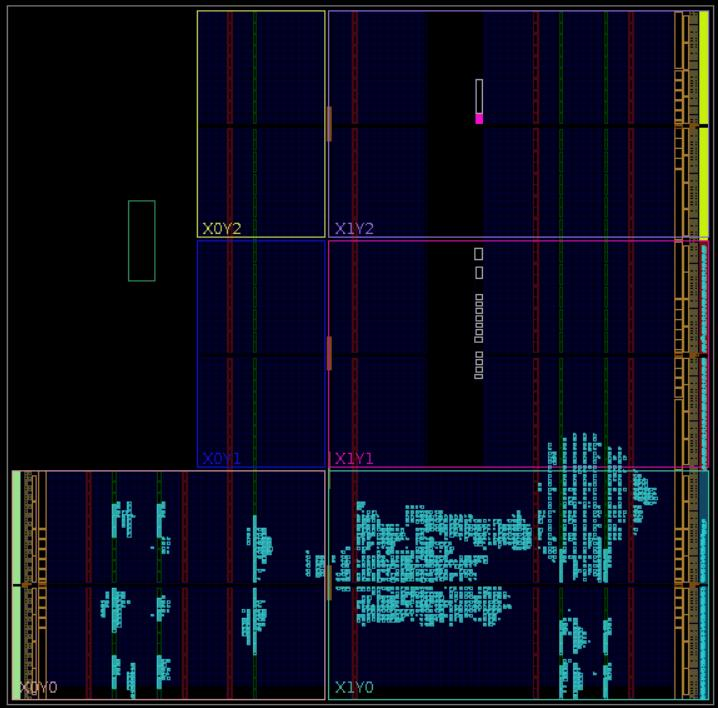

# **Run through OpenLane2 SKY130 PDK flow to generate GDSII**

The flow is mainly learnt/copied from this reference colab file:

https://colab.research.google.com/github/efabless/openlane2/blob/main/notebook.ipynb

In [ ]:
# @title Setup Nix {display-mode: "form"}
# @markdown <img src="https://raw.githubusercontent.com/NixOS/nixos-artwork/master/logo/nix-snowflake.svg" width="32"/>
# @markdown
# @markdown Nix is a package manager with an emphasis on reproducible builds,
# @markdown and it is the primary method for installing OpenLane 2.
# @markdown
# @markdown This step installs the Nix package manager and enables the
# @markdown experimental "flakes" feature.
# @markdown
# @markdown If you're not in a Colab, this just sets the environment variables.
# @markdown You will need to install Nix and enable flakes on your own using
# @markdown the [Determinate Systems Nix Installer](https://github.com/DeterminateSystems/nix-installer).

%cd /content/

import os
import sys
import shutil

os.environ["LOCALE_ARCHIVE"] = "/usr/lib/locale/locale-archive"

if "google.colab" in sys.modules:
    if shutil.which("nix-env") is None:
        !curl -L https://nixos.org/nix/install | bash -s -- --daemon --yes
        !echo "extra-experimental-features = nix-command flakes" >> /etc/nix/nix.conf
        !killall nix-daemon
else:
    if shutil.which("nix-env") is None:
        raise RuntimeError("Nix is not installed!")

os.environ["PATH"] = f"/nix/var/nix/profiles/default/bin/:{os.getenv('PATH')}"

/content


In [ ]:
# @title Get OpenLane {display-mode: "form"}
# @markdown Click the ▷ button to download and install OpenLane.
# @markdown
# @markdown This will install OpenLane's tool dependencies using Nix,
# @markdown and OpenLane itself using PIP.
# @markdown
# @markdown Note that `python3-tk` may need to be installed using your OS's
# @markdown package manager.
import os
import subprocess
import IPython

openlane_version = "latest"  # @param {key:"OpenLane Version", type:"string"}

if openlane_version == "latest":
    openlane_version = "main"

pdk_root = "~/.volare"  # @param {key:"PDK Root", type:"string"}

pdk_root = os.path.expanduser(pdk_root)

pdk = "sky130"  # @param {key:"PDK (without the variant)", type:"string"}

openlane_ipynb_path = os.path.join(os.getcwd(), "openlane_ipynb")

display(IPython.display.HTML("<h3>Downloading OpenLane…</a>"))


TESTING_LOCALLY = False
!rm -rf {openlane_ipynb_path}
!mkdir -p {openlane_ipynb_path}
if TESTING_LOCALLY:
    !ln -s {os.getcwd()} {openlane_ipynb_path}
else:
    !curl -L "https://github.com/efabless/openlane2/tarball/{openlane_version}" | tar -xzC {openlane_ipynb_path} --strip-components 1

try:
    import tkinter
except ImportError:
    if "google.colab" in sys.modules:
        !sudo apt-get install python-tk

try:
    import tkinter
except ImportError as e:
    display(
        IPython.display.HTML(
            '<h3 style="color: #800020";>❌ Failed to import the <code>tkinter</code> library for Python, which is required to load PDK configuration values. Make sure <code>python3-tk</code> or equivalent is installed on your system.</a>'
        )
    )
    raise e from None


display(IPython.display.HTML("<h3>Downloading OpenLane's dependencies…</a>"))

!cd {openlane_ipynb_path} && nix profile install ".#colab-env" --accept-flake-config

display(IPython.display.HTML("<h3>Downloading Python dependencies using PIP…</a>"))
try:
    subprocess.check_output(
        [
            "pip3",
            "install",
            "-r",
            os.path.join(openlane_ipynb_path, "requirements.txt"),
        ]
    )
except subprocess.CalledProcessError as e:
    display(
        IPython.display.HTML(
            '<h3 style="color: #800020";>❌ Failed to install Python dependencies using PIP…</h3>'
        )
    )
    raise e from None

display(IPython.display.HTML("<h3>Downloading PDK…</a>"))
import volare

volare.enable(
    volare.get_volare_home(pdk_root),
    pdk,
    open(
        os.path.join(openlane_ipynb_path, "openlane", "open_pdks_rev"),
        encoding="utf8",
    )
    .read()
    .strip(),
)

sys.path.insert(0, openlane_ipynb_path)
display(IPython.display.HTML("<h3>⭕️ Done.</a>"))

import logging

# Remove the stupid default colab logging handler
logging.getLogger().handlers.clear()

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 13.3M    0 13.3M    0     0  2079k      0 --:--:--  0:00:06 --:--:-- 3283k


Version bdc9412b3e468c102d01b7cf6337be06ec6e9c9a enabled for the sky130 PDK.

In [ ]:
# @title Prepare Verilog files
%cd /content/
!rm -rf BTLE-openlane
!git clone https://github.com/JiaoXianjun/BTLE.git BTLE-openlane
%cd BTLE-openlane/
!git checkout vlsi24-code-a-chip
%cd /content/
!cp BTLE-openlane/verilog/*.v ./
!rm *_tb.v
!ls

/content
Cloning into 'BTLE-openlane'...
remote: Enumerating objects: 1692, done.
remote: Counting objects: 100% (277/277), done.
remote: Compressing objects: 100% (151/151), done.
remote: Total 1692 (delta 142), reused 249 (delta 119), pack-reused 1415
Receiving objects: 100% (1692/1692), 3.80 MiB | 13.27 MiB/s, done.
Resolving deltas: 100% (1008/1008), done.
/content/BTLE-openlane
Branch 'vlsi24-code-a-chip' set up to track remote branch 'vlsi24-code-a-chip' from 'origin'.
Switched to a new branch 'vlsi24-code-a-chip'
/content
bit_repeat_upsample.v	   btle_rx.v		gfsk_modulation.v	      serial_in_ram_out.v
BTLE			   btle_tx.v		openlane_ipynb		      tx_clk_gen.v
btle_controller.v	   crc24_core.v		openlane_run		      uart_frame_rx.v
btle_controller_wrapper.v  crc24.v		rx_clk_gen.v		      uart_frame_tx.v
btle_ll.v		   dpram.v		sample_data		      vco.v
BTLE-openlane		   drive		scramble_core.v
btle_phy.v		   gauss_filter.v	scramble.v
btle_rx_core.v		   gfsk_demodulation.v	search_unique_bit

## Try the full design top level

In [ ]:
# @title Setting up the configuration
# the btle_controller_wrapper is the top level module
# CLOCK_PERIOD 62.5 means 16MHz according to the current design

from openlane.config import Config

Config.interactive(
    "btle_controller_wrapper",
    PDK="sky130A",
    CLOCK_PORT="clk",
    CLOCK_NET="clk",
    CLOCK_PERIOD=62.5,
    PRIMARY_GDSII_STREAMOUT_TOOL="klayout",
)


### Interactive Configuration
#### Initial Values

<br />

```yaml
CELL_BB_VERILOG_MODELS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/sky130_fd_sc_hd__blackbox.v
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/sky130_fd_sc_hd__blackbox_pp.v
CELL_GDS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/gds/sky130_fd_sc_hd.gds
CELL_LEFS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef
CELL_PAD_EXCLUDE:
- sky130_fd_sc_hd__tap*
- sky130_fd_sc_hd__decap*
- sky130_ef_sc_hd__decap*
- sky130_fd_sc_hd__fill*
CELL_SPICE_MODELS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__decap_12.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_12.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_4.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_8.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_fd_sc_hd.spice
CELL_VERILOG_MODELS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/primitives.v
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/sky130_fd_sc_hd.v
CLOCK_NET: clk
CLOCK_PERIOD: 62.5
CLOCK_PORT: clk
CLOCK_TRANSITION_CONSTRAINT: 0.15
CLOCK_UNCERTAINTY_CONSTRAINT: 0.25
CLOCK_WIRE_RC_LAYER: met5
DATA_WIRE_RC_LAYER: met2
DECAP_CELL:
- sky130_ef_sc_hd__decap_12
- sky130_fd_sc_hd__decap_8
- sky130_fd_sc_hd__decap_6
- sky130_fd_sc_hd__decap_4
- sky130_fd_sc_hd__decap_3
DEFAULT_CORNER: nom_tt_025C_1v80
DEFAULT_MAX_TRAN: null
DESIGN_DIR: .
DESIGN_NAME: btle_controller_wrapper
DIE_AREA: null
DIODE_CELL: sky130_fd_sc_hd__diode_2/DIODE
ENDCAP_CELL: sky130_fd_sc_hd__decap_3
EXTRA_EXCLUDED_CELLS: null
EXTRA_GDS_FILES: null
EXTRA_LEFS: null
EXTRA_LIBS: null
EXTRA_SPICE_MODELS: null
EXTRA_VERILOG_MODELS: null
FALLBACK_SDC_FILE: /content/openlane_ipynb/openlane/scripts/base.sdc
FILL_CELL:
- sky130_fd_sc_hd__fill*
FP_IO_HLAYER: met3
FP_IO_VLAYER: met2
FP_TAPCELL_DIST: 13
FP_TRACKS_INFO: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tracks.info
GND_NETS: null
GND_PIN: VGND
GPIO_PADS_LEF:
- /root/.volare/sky130A/libs.ref/sky130_fd_io/lef/sky130_fd_io.lef
- /root/.volare/sky130A/libs.ref/sky130_fd_io/lef/sky130_ef_io.lef
GPIO_PADS_LEF_CORE_SIDE:
- /root/.volare/sky130A/libs.tech/openlane/custom_cells/lef/sky130_fd_io_core.lef
- /root/.volare/sky130A/libs.tech/openlane/custom_cells/lef/sky130_ef_io_core.lef
GPIO_PADS_VERILOG:
- /root/.volare/sky130A/libs.ref/sky130_fd_io/verilog/sky130_ef_io.v
GPIO_PAD_CELLS:
- sky130_fd_io*
- sky130_ef_io*
IO_DELAY_CONSTRAINT: 20
LIB:
  '*_ff_n40C_1v95':
  - /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ff_n40C_1v95.lib
  '*_ss_100C_1v60':
  - /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ss_100C_1v60.lib
  '*_tt_025C_1v80':
  - /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib
MACROS: null
MAX_CAPACITANCE_CONSTRAINT: 0.2
MAX_FANOUT_CONSTRAINT: 10
MAX_TRANSITION_CONSTRAINT: 0.75
OUTPUT_CAP_LOAD: 33.442
PDK: sky130A
PDK_ROOT: /root/.volare
PLACE_SITE: unithd
PNR_EXCLUDED_CELL_FILE: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/drc_exclude.cells
PRIMARY_GDSII_STREAMOUT_TOOL: klayout
RT_MAX_LAYER: met5
RT_MIN_LAYER: met1
SCL_GROUND_PINS:
- VGND
- VNB
SCL_POWER_PINS:
- VPWR
- VPB
STA_CORNERS:
- nom_tt_025C_1v80
- nom_ss_100C_1v60
- nom_ff_n40C_1v95
- min_tt_025C_1v80
- min_ss_100C_1v60
- min_ff_n40C_1v95
- max_tt_025C_1v80
- max_ss_100C_1v60
- max_ff_n40C_1v95
STD_CELL_LIBRARY: sky130_fd_sc_hd
SYNTH_BUFFER_CELL: sky130_fd_sc_hd__buf_2/A/X
SYNTH_CLK_DRIVING_CELL: null
SYNTH_DRIVING_CELL: sky130_fd_sc_hd__inv_2/Y
SYNTH_EXCLUDED_CELL_FILE: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/no_synth.cells
SYNTH_TIEHI_CELL: sky130_fd_sc_hd__conb_1/HI
SYNTH_TIELO_CELL: sky130_fd_sc_hd__conb_1/LO
TECH_LEFS:
  max_*: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__max.tlef
  min_*: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__min.tlef
  nom_*: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef
TIME_DERATING_CONSTRAINT: 5
TRISTATE_CELLS:
- sky130_fd_sc_hd__ebuf*
VDD_NETS: null
VDD_PIN: VPWR
VDD_PIN_VOLTAGE: 1.8
WELLTAP_CELL: sky130_fd_sc_hd__tapvpwrvgnd_1
WIRE_LENGTH_THRESHOLD: null
meta:
  flow: null
  openlane_version: 2.0.0rc2
  step: null
  version: 1

```


## Running implementation steps


In [ ]:
# @title Synthesis

from openlane.steps import Step
Synthesis = Step.factory.get("Yosys.Synthesis")
from openlane.state import State

synthesis = Synthesis(
    VERILOG_FILES=["btle_controller_wrapper.v", "btle_controller.v", "btle_ll.v", "uart_frame_rx.v", "uart_frame_tx.v", "rx_clk_gen.v", "tx_clk_gen.v", "btle_phy.v", "btle_rx.v", "btle_rx_core.v", "gfsk_demodulation.v", "search_unique_bit_sequence.v", "scramble_core.v", "crc24_core.v", "serial_in_ram_out.v", "dpram.v", "btle_tx.v", "crc24.v", "scramble.v", "gfsk_modulation.v", "bit_repeat_upsample.v", "gauss_filter.v", "vco.v"],
    state_in=State(),
)
synthesis.start()
display(synthesis)

──────────────────────────────────────────────────── Synthesis ────────────────────────────────────────────────────

[18:31:17] VERBOSE  Running 'Yosys.Synthesis'… (Log:                                                   ]8;id=201019;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=892006;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=186234;file:///content/openlane_run/18-yosys-synthesis/yosys-synthesis.log\.]8;;\]8;id=790678;file:///content/openlane_run/18-yosys-synthesis/yosys-synthesis.log\/openlane_run/18-yosys-synthesis/]8;;\]8;id=537602;file:///content/openlane_run/18-yosys-synthesis/yosys-synthesis.log\yosys-synthesis.log]8;;\)                                         

/----------------------------------------------------------------------------\

|                                                                            |

|  yosys -- Yosys Open SYnthesis Suite                                       |

|                                                                            |

|  Copyright (C) 2012 - 2020  Claire Xenia Wolf <claire@yosyshq.com>         |

|                                                                            |

|  Permission to use, copy, modify, and/or distribute this software for any  |

|  purpose with or without fee is hereby granted, provided that the above    |

|  copyright notice and this permission notice appear in all copies.         |

|                                                                            |

|  THE SOFTWARE IS PROVIDED "AS IS" AND THE AUTHOR DISCLAIMS ALL WARRANTIES  |

|  WITH REGARD TO THIS SOFTWARE INCLUDING ALL IMPLIED WARRANTIES OF          |

|  MERCHANTABILITY AND FITNESS. IN NO EVENT SHALL THE AUTHOR BE LIABLE FOR   |

|  ANY SPECIAL, DIRECT, INDIRECT, OR CONSEQUENTIAL DAMAGES OR ANY DAMAGES    |

|  WHATSOEVER RESULTING FROM LOSS OF USE, DATA OR PROFITS, WHETHER IN AN     |

|  ACTION OF CONTRACT, NEGLIGENCE OR OTHER TORTIOUS ACTION, ARISING OUT OF   |

|  OR IN CONNECTION WITH THE USE OR PERFORMANCE OF THIS SOFTWARE.            |

|                                                                            |

\----------------------------------------------------------------------------/

Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)

Loaded SDC plugin

[TCL: yosys -import] Command name collision: found pre-existing command `cd' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `eval' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `exec' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `read' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `trace' -> skip.

1. Executing Liberty frontend: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib

Imported 428 cell types from liberty file.

2. Executing Verilog-2005 frontend: btle_controller_wrapper.v

Parsing SystemVerilog input from `btle_controller_wrapper.v' to AST representation.

Generating RTLIL representation for module `\btle_controller_wrapper'.

Successfully finished Verilog frontend.

3. Executing Verilog-2005 frontend: btle_controller.v

Parsing SystemVerilog input from `btle_controller.v' to AST representation.

Generating RTLIL representation for module `\btle_controller'.

Successfully finished Verilog frontend.

4. Executing Verilog-2005 frontend: btle_ll.v

Parsing SystemVerilog input from `btle_ll.v' to AST representation.

Generating RTLIL representation for module `\btle_ll'.

Successfully finished Verilog frontend.

5. Executing Verilog-2005 frontend: uart_frame_rx.v

Parsing SystemVerilog input from `uart_frame_rx.v' to AST representation.

Generating RTLIL representation for module `\uart_frame_rx'.

Successfully finished Verilog frontend.

6. Executing Verilog-2005 frontend: uart_frame_tx.v

Parsing SystemVerilog input from `uart_frame_tx.v' to AST representation.

Generating RTLIL representation for module `\uart_frame_tx'.

Successfully finished Verilog frontend.

7. Executing Verilog-2005 frontend: rx_clk_gen.v

Parsing SystemVerilog input from `rx_clk_gen.v' to AST representation.

Generating RTLIL representation for module `\rx_clk_gen'.

Successfully finished Verilog frontend.

8. Executing Verilog-2005 frontend: tx_clk_gen.v

Parsing SystemVerilog input from `tx_clk_gen.v' to AST representation.

Generating RTLIL representation for module `\tx_clk_gen'.

Successfully finished Verilog frontend.

9. Executing Verilog-2005 frontend: btle_phy.v

Parsing SystemVerilog input from `btle_phy.v' to AST representation.

Generating RTLIL representation for module `\btle_phy'.

Successfully finished Verilog frontend.

10. Executing Verilog-2005 frontend: btle_rx.v

Parsing SystemVerilog input from `btle_rx.v' to AST representation.

Generating RTLIL representation for module `\btle_rx'.

Warning: Replacing memory \payload_length_store with list of registers. See btle_rx.v:288

Successfully finished Verilog frontend.

11. Executing Verilog-2005 frontend: btle_rx_core.v

Parsing SystemVerilog input from `btle_rx_core.v' to AST representation.

Generating RTLIL representation for module `\btle_rx_core'.

Successfully finished Verilog frontend.

12. Executing Verilog-2005 frontend: gfsk_demodulation.v

Parsing SystemVerilog input from `gfsk_demodulation.v' to AST representation.

Generating RTLIL representation for module `\gfsk_demodulation'.

Successfully finished Verilog frontend.

13. Executing Verilog-2005 frontend: search_unique_bit_sequence.v

Parsing SystemVerilog input from `search_unique_bit_sequence.v' to AST representation.

Generating RTLIL representation for module `\search_unique_bit_sequence'.

Successfully finished Verilog frontend.

14. Executing Verilog-2005 frontend: scramble_core.v

Parsing SystemVerilog input from `scramble_core.v' to AST representation.

Generating RTLIL representation for module `\scramble_core'.

Successfully finished Verilog frontend.

15. Executing Verilog-2005 frontend: crc24_core.v

Parsing SystemVerilog input from `crc24_core.v' to AST representation.

Generating RTLIL representation for module `\crc24_core'.

Successfully finished Verilog frontend.

16. Executing Verilog-2005 frontend: serial_in_ram_out.v

Parsing SystemVerilog input from `serial_in_ram_out.v' to AST representation.

Generating RTLIL representation for module `\serial_in_ram_out'.

Successfully finished Verilog frontend.

17. Executing Verilog-2005 frontend: dpram.v

Parsing SystemVerilog input from `dpram.v' to AST representation.

Generating RTLIL representation for module `\dpram'.

Successfully finished Verilog frontend.

18. Executing Verilog-2005 frontend: btle_tx.v

Parsing SystemVerilog input from `btle_tx.v' to AST representation.

Generating RTLIL representation for module `\btle_tx'.

Successfully finished Verilog frontend.

19. Executing Verilog-2005 frontend: crc24.v

Parsing SystemVerilog input from `crc24.v' to AST representation.

Generating RTLIL representation for module `\crc24'.

Successfully finished Verilog frontend.

20. Executing Verilog-2005 frontend: scramble.v

Parsing SystemVerilog input from `scramble.v' to AST representation.

Generating RTLIL representation for module `\scramble'.

Successfully finished Verilog frontend.

21. Executing Verilog-2005 frontend: gfsk_modulation.v

Parsing SystemVerilog input from `gfsk_modulation.v' to AST representation.

Generating RTLIL representation for module `\gfsk_modulation'.

Successfully finished Verilog frontend.

22. Executing Verilog-2005 frontend: bit_repeat_upsample.v

Parsing SystemVerilog input from `bit_repeat_upsample.v' to AST representation.

Generating RTLIL representation for module `\bit_repeat_upsample'.

Successfully finished Verilog frontend.

23. Executing Verilog-2005 frontend: gauss_filter.v

Parsing SystemVerilog input from `gauss_filter.v' to AST representation.

Generating RTLIL representation for module `\gauss_filter'.

Successfully finished Verilog frontend.

24. Executing Verilog-2005 frontend: vco.v

Parsing SystemVerilog input from `vco.v' to AST representation.

Generating RTLIL representation for module `\vco'.

Successfully finished Verilog frontend.

25. Generating Graphviz representation of design.

Writing dot description to `/content/openlane_run/18-yosys-synthesis/hierarchy.dot'.

Dumping module btle_controller_wrapper to page 1.

26. Executing HIERARCHY pass (managing design hierarchy).

26.1. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     \btle_controller

Used module:         \btle_phy

Used module:             \btle_rx

Used module:                 \serial_in_ram_out

Used module:                     \dpram

Used module:                 \btle_rx_core

Used module:                     \crc24_core

Used module:                     \scramble_core

Used module:                     \search_unique_bit_sequence

Used module:                     \gfsk_demodulation

Used module:             \btle_tx

Used module:                 \gfsk_modulation

Used module:                     \vco

Used module:                     \gauss_filter

Used module:                     \bit_repeat_upsample

Used module:                 \scramble

Used module:                 \crc24

Used module:         \btle_ll

Used module:             \uart_frame_rx

Used module:                 \rx_clk_gen

Used module:             \uart_frame_tx

Used module:                 \tx_clk_gen

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

26.2. Executing AST frontend in derive mode using pre-parsed AST for module `\btle_controller'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Generating RTLIL representation for module `$paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

26.3. Executing AST frontend in derive mode using pre-parsed AST for module `\btle_phy'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Generating RTLIL representation for module `$paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

26.4. Executing AST frontend in derive mode using pre-parsed AST for module `\btle_ll'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Generating RTLIL representation for module `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

26.5. Executing AST frontend in derive mode using pre-parsed AST for module `\uart_frame_rx'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Generating RTLIL representation for module `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

26.6. Executing AST frontend in derive mode using pre-parsed AST for module `\uart_frame_tx'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Generating RTLIL representation for module `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx'.

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

26.7. Executing AST frontend in derive mode using pre-parsed AST for module `\btle_rx'.

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Generating RTLIL representation for module `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx'.

Warning: Replacing memory \payload_length_store with list of registers. See btle_rx.v:288

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

26.8. Executing AST frontend in derive mode using pre-parsed AST for module `\btle_tx'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Generating RTLIL representation for module `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx'.

Parameter \CLK_FREQUENCE = 50000000

Parameter \BAUD_RATE = 9600

26.9. Executing AST frontend in derive mode using pre-parsed AST for module `\tx_clk_gen'.

Parameter \CLK_FREQUENCE = 50000000

Parameter \BAUD_RATE = 9600

Generating RTLIL representation for module `$paramod$884dbb9f2b40711f6d1975d59eba4b2b0e2cfe26\tx_clk_gen'.

Parameter \CLK_FREQUENCE = 50000000

Parameter \BAUD_RATE = 9600

26.10. Executing AST frontend in derive mode using pre-parsed AST for module `\rx_clk_gen'.

Parameter \CLK_FREQUENCE = 50000000

Parameter \BAUD_RATE = 9600

Generating RTLIL representation for module `$paramod$884dbb9f2b40711f6d1975d59eba4b2b0e2cfe26\rx_clk_gen'.

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

26.11. Executing AST frontend in derive mode using pre-parsed AST for module `\gfsk_modulation'.

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Generating RTLIL representation for module `$paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

26.12. Executing AST frontend in derive mode using pre-parsed AST for module `\scramble'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Generating RTLIL representation for module `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble'.

Parameter \CRC_STATE_BIT_WIDTH = 24

26.13. Executing AST frontend in derive mode using pre-parsed AST for module `\crc24'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Generating RTLIL representation for module                                                                         
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

26.14. Executing AST frontend in derive mode using pre-parsed AST for module `\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Generating RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

26.15. Executing AST frontend in derive mode using pre-parsed AST for module `\serial_in_ram_out'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Generating RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

26.16. Executing AST frontend in derive mode using pre-parsed AST for module `\btle_rx_core'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Generating RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Reprocessing module btle_rx because instantiated module serial_in_ram_out has become available.

Generating RTLIL representation for module `\btle_rx'.

Warning: Replacing memory \payload_length_store with list of registers. See btle_rx.v:288

Parameter \CRC_STATE_BIT_WIDTH = 24

26.17. Executing AST frontend in derive mode using pre-parsed AST for module `\crc24_core'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Generating RTLIL representation for module                                                                         
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

26.18. Executing AST frontend in derive mode using pre-parsed AST for module `\scramble_core'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Generating RTLIL representation for module `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core'.

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

26.19. Executing AST frontend in derive mode using pre-parsed AST for module `\search_unique_bit_sequence'.

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Generating RTLIL representation for module                                                                         
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

26.20. Executing AST frontend in derive mode using pre-parsed AST for module `\gfsk_demodulation'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Generating RTLIL representation for module `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module                                                                       
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Found cached RTLIL representation for module `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core'.

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

26.21. Executing AST frontend in derive mode using pre-parsed AST for module `\vco'.

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Generating RTLIL representation for module `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco'.

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

26.22. Executing AST frontend in derive mode using pre-parsed AST for module `\gauss_filter'.

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Generating RTLIL representation for module `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter'.

Parameter \SAMPLE_PER_SYMBOL = 8

26.23. Executing AST frontend in derive mode using pre-parsed AST for module `\bit_repeat_upsample'.

Parameter \SAMPLE_PER_SYMBOL = 8

Generating RTLIL representation for module                                                                         
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

26.24. Executing AST frontend in derive mode using pre-parsed AST for module `\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Generating RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Found cached RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

Reprocessing module vco because instantiated module $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram has    
become available.

Generating RTLIL representation for module `\vco'.

26.25. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         \btle_phy

Used module:             $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx

Used module:                 \serial_in_ram_out

Used module:                     $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:                 \btle_rx_core

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:                     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Used module:             $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx

Used module:                 \gfsk_modulation

Used module:                     $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco

Used module:                         \dpram

Used module:                     $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter

Used module:                                                                                                       
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000

Used module:                 \scramble

Used module:                 \crc24

Used module:         \btle_ll

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx

Used module:                 \rx_clk_gen

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx

Used module:                 \tx_clk_gen

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Found cached RTLIL representation for module `$paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Found cached RTLIL representation for module `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

26.26. Executing AST frontend in derive mode using pre-parsed AST for module `\rx_clk_gen'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Generating RTLIL representation for module `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

26.27. Executing AST frontend in derive mode using pre-parsed AST for module `\tx_clk_gen'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Generating RTLIL representation for module `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Reprocessing module $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx because instantiated module          
$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out has become available.

Generating RTLIL representation for module `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx'.

Warning: Replacing memory \payload_length_store with list of registers. See btle_rx.v:288

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Found cached RTLIL representation for module `$paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Found cached RTLIL representation for module `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module                                                                       
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Found cached RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Found cached RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

Reprocessing module $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco because instantiated module              
$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram has become available.

Generating RTLIL representation for module `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco'.

26.28. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy

Used module:             \btle_rx

Used module:                 \serial_in_ram_out

Used module:                     $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:                 \btle_rx_core

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:                     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Used module:             \btle_tx

Used module:                 $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation

Used module:                     \vco

Used module:                         \dpram

Used module:                     \gauss_filter

Used module:                     \bit_repeat_upsample

Used module:                 $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble

Used module:                     \scramble_core

Used module:                 $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     \crc24_core

Used module:         $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll

Used module:             \uart_frame_rx

Used module:                 $paramod$884dbb9f2b40711f6d1975d59eba4b2b0e2cfe26\rx_clk_gen

Used module:             \uart_frame_tx

Used module:                 $paramod$884dbb9f2b40711f6d1975d59eba4b2b0e2cfe26\tx_clk_gen

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Found cached RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Found cached RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \SAMPLE_PER_SYMBOL = 8

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Parameter \GAUSS_FIR_OUT_AMP_SCALE_DOWN_NUM_BIT_SHIFT = 1

Found cached RTLIL representation for module `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Found cached RTLIL representation for module `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx'.

Parameter \CLK_FREQUENCE = 16000000

Parameter \BAUD_RATE = 115200

Parameter \PARITY = 1313820229

Parameter \FRAME_WD = 8

Found cached RTLIL representation for module `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx'.

Parameter \VCO_BIT_WIDTH = 16

Parameter \SIN_COS_ADDR_BIT_WIDTH = 11

Parameter \IQ_BIT_WIDTH = 8

Found cached RTLIL representation for module `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco'.

Parameter \GAUSS_FILTER_BIT_WIDTH = 16

Parameter \NUM_TAP_GAUSS_FILTER = 17

Found cached RTLIL representation for module `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter'.

Parameter \SAMPLE_PER_SYMBOL = 8

Found cached RTLIL representation for module                                                                       
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Found cached RTLIL representation for module `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module                                                                       
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000'.

26.29. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy

Used module:             $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx

Used module:                 \serial_in_ram_out

Used module:                     $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:                 \btle_rx_core

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:                     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Used module:             $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx

Used module:                 $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation

Used module:                     $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco

Used module:                         \dpram

Used module:                     $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter

Used module:                                                                                                       
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000

Used module:                 $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble

Used module:                 $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:         $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Found cached RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 11

Found cached RTLIL representation for module `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram'.

26.30. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy

Used module:             $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx

Used module:                 $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out

Used module:                     \dpram

Used module:                 $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core

Used module:                     \crc24_core

Used module:                     \scramble_core

Used module:                     \search_unique_bit_sequence

Used module:                     \gfsk_demodulation

Used module:             $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx

Used module:                 $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation

Used module:                     $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco

Used module:                         $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram

Used module:                     $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter

Used module:                                                                                                       
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000

Used module:                 $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                 $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                 $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:         $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen

Parameter \DATA_WIDTH = 8

Parameter \ADDRESS_WIDTH = 6

Found cached RTLIL representation for module `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Found cached RTLIL representation for module                                                                       
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Found cached RTLIL representation for module `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core'.

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Found cached RTLIL representation for module                                                                       
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Found cached RTLIL representation for module `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation'.

26.31. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy

Used module:             $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx

Used module:                 $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out

Used module:                     $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:                 $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:                     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Used module:             $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx

Used module:                 $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation

Used module:                     $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco

Used module:                         $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram

Used module:                     $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter

Used module:                                                                                                       
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000

Used module:                 $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble

Used module:                 $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:         $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen

26.32. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy

Used module:             $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx

Used module:                 $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out

Used module:                     $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:                 $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:                     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Used module:             $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx

Used module:                 $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation

Used module:                     $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco

Used module:                         $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram

Used module:                     $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter

Used module:                                                                                                       
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000

Used module:                 $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble

Used module:                 $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:         $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen

Removing unused module `\btle_rx'.

Removing unused module `\vco'.

Removing unused module `$paramod$884dbb9f2b40711f6d1975d59eba4b2b0e2cfe26\rx_clk_gen'.

Removing unused module `$paramod$884dbb9f2b40711f6d1975d59eba4b2b0e2cfe26\tx_clk_gen'.

Removing unused module `\gauss_filter'.

Removing unused module `\bit_repeat_upsample'.

Removing unused module `\gfsk_modulation'.

Removing unused module `\scramble'.

Removing unused module `\crc24'.

Removing unused module `\btle_tx'.

Removing unused module `\dpram'.

Removing unused module `\serial_in_ram_out'.

Removing unused module `\crc24_core'.

Removing unused module `\scramble_core'.

Removing unused module `\search_unique_bit_sequence'.

Removing unused module `\gfsk_demodulation'.

Removing unused module `\btle_rx_core'.

Removing unused module `\btle_phy'.

Removing unused module `\tx_clk_gen'.

Removing unused module `\rx_clk_gen'.

Removing unused module `\uart_frame_tx'.

Removing unused module `\uart_frame_rx'.

Removing unused module `\btle_ll'.

Removing unused module `\btle_controller'.

Removed 24 unused modules.

Module $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller directly or indirectly displays text ->   
setting "keep" attribute.

Module $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx directly or indirectly displays text -> setting   
"keep" attribute.

Module $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy directly or indirectly displays text -> setting  
"keep" attribute.

Module btle_controller_wrapper directly or indirectly displays text -> setting "keep" attribute.

Renaming module btle_controller_wrapper to btle_controller_wrapper.

27. Executing TRIBUF pass.

28. Executing HIERARCHY pass (managing design hierarchy).

28.1. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy

Used module:             $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx

Used module:                 $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out

Used module:                     $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:                 $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:                     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Used module:             $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx

Used module:                 $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation

Used module:                     $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco

Used module:                         $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram

Used module:                     $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter

Used module:                                                                                                       
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000

Used module:                 $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble

Used module:                 $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:         $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen

28.2. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Used module:     $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller

Used module:         $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy

Used module:             $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx

Used module:                 $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out

Used module:                     $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram

Used module:                 $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core

Used module:                     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:                     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:                     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:                     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Used module:             $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx

Used module:                 $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation

Used module:                     $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco

Used module:                         $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram

Used module:                     $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter

Used module:                                                                                                       
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000

Used module:                 $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble

Used module:                 $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:         $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen

Used module:             $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx

Used module:                 $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen

Removed 0 unused modules.

Module btle_controller_wrapper directly or indirectly displays text -> setting "keep" attribute.

Module $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx directly or indirectly displays text -> setting   
"keep" attribute.

Module $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy directly or indirectly displays text -> setting  
"keep" attribute.

Module $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller directly or indirectly displays text ->   
setting "keep" attribute.

29. Executing PROC_CLEAN pass (remove empty switches from decision trees).

Cleaned up 0 empty switches.

30. Executing PROC_RMDEAD pass (remove dead branches from decision trees).

Marked 1 switch rules as full_case in process $proc$btle_controller_wrapper.v:107$16 in module                     
btle_controller_wrapper.

Marked 2 switch rules as full_case in process $proc$dpram.v:45$1766 in module                                      
$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2152 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2148 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2146 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2137 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2133 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2131 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2122 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2118 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2116 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2107 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2103 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2101 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2092 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2088 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2086 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2077 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2073 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2071 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2062 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2058 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2056 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:304$2047 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:294$2043 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:286$2041 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 2 switch rules as full_case in process $proc$btle_rx.v:216$1983 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Removed 1 dead cases from process $proc$btle_rx.v:185$1982 in module                                               
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$btle_rx.v:185$1982 in module                                   
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 5 switch rules as full_case in process $proc$btle_rx.v:97$1972 in module                                    
$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Marked 1 switch rules as full_case in process $proc$gfsk_demodulation.v:36$1691 in module                          
$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.

Marked 1 switch rules as full_case in process $proc$search_unique_bit_sequence.v:24$1690 in module                 
$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.

Marked 3 switch rules as full_case in process $proc$scramble_core.v:25$1685 in module                              
$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.

Marked 2 switch rules as full_case in process $proc$crc24_core.v:31$1678 in module                                 
$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Marked 1 switch rules as full_case in process $proc$vco.v:36$2161 in module                                        
$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.

Marked 2 switch rules as full_case in process $proc$rx_clk_gen.v:65$1793 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.

Marked 3 switch rules as full_case in process $proc$rx_clk_gen.v:54$1788 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.

Removed 1 dead cases from process $proc$rx_clk_gen.v:44$1785 in module                                             
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.

Marked 1 switch rules as full_case in process $proc$rx_clk_gen.v:44$1785 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.

Marked 1 switch rules as full_case in process $proc$rx_clk_gen.v:36$1783 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.

Marked 1 switch rules as full_case in process $proc$serial_in_ram_out.v:23$1302 in module                          
$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.

Marked 2 switch rules as full_case in process $proc$dpram.v:45$1292 in module                                      
$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.

Marked 2 switch rules as full_case in process $proc$crc24.v:42$1275 in module                                      
$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Marked 3 switch rules as full_case in process $proc$scramble.v:65$1264 in module                                   
$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.

Marked 2 switch rules as full_case in process $proc$bit_repeat_upsample.v:39$1755 in module                        
$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.

Marked 3 switch rules as full_case in process $proc$btle_rx_core.v:62$1309 in module                               
$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.

Marked 1 switch rules as full_case in process $proc$gauss_filter.v:105$1733 in module                              
$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.

Marked 1 switch rules as full_case in process $proc$gauss_filter.v:78$1732 in module                               
$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.

Marked 4 switch rules as full_case in process $proc$btle_tx.v:102$1205 in module                                   
$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.

Marked 2 switch rules as full_case in process $proc$tx_clk_gen.v:65$1807 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.

Marked 3 switch rules as full_case in process $proc$tx_clk_gen.v:52$1802 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.

Removed 1 dead cases from process $proc$tx_clk_gen.v:42$1799 in module                                             
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.

Marked 1 switch rules as full_case in process $proc$tx_clk_gen.v:42$1799 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.

Marked 1 switch rules as full_case in process $proc$tx_clk_gen.v:35$1797 in module                                 
$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.

Marked 4 switch rules as full_case in process $proc$uart_frame_tx.v:103$978 in module                              
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.

Marked 1 switch rules as full_case in process $proc$uart_frame_tx.v:90$964 in module                               
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.

Marked 1 switch rules as full_case in process $proc$uart_frame_tx.v:83$962 in module                               
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.

Marked 3 switch rules as full_case in process $proc$uart_frame_tx.v:71$955 in module                               
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.

Marked 4 switch rules as full_case in process $proc$uart_frame_rx.v:153$947 in module                              
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Removed 1 dead cases from process $proc$uart_frame_rx.v:135$928 in module                                          
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 2 switch rules as full_case in process $proc$uart_frame_rx.v:135$928 in module                              
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 1 switch rules as full_case in process $proc$uart_frame_rx.v:128$926 in module                              
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 2 switch rules as full_case in process $proc$uart_frame_rx.v:116$923 in module                              
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 3 switch rules as full_case in process $proc$uart_frame_rx.v:104$919 in module                              
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 4 switch rules as full_case in process $proc$uart_frame_rx.v:90$916 in module                               
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 3 switch rules as full_case in process $proc$uart_frame_rx.v:77$912 in module                               
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 1 switch rules as full_case in process $proc$uart_frame_rx.v:61$905 in module                               
$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Marked 1 switch rules as full_case in process $proc$btle_ll.v:105$761 in module                                    
$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.

Removed a total of 4 dead cases.

31. Executing PROC_PRUNE pass (remove redundant assignments in processes).

Removed 64 redundant assignments.

Promoted 66 assignments to connections.

32. Executing PROC_INIT pass (extract init attributes).

33. Executing PROC_ARST pass (detect async resets in processes).

Found async reset \rst_n in                                                                                        
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:65$1793'.

Found async reset \rst_n in                                                                                        
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:54$1788'.

Found async reset \rst_n in                                                                                        
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:36$1783'.

Found async reset \rst_n in                                                                                        
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:65$1807'.

Found async reset \rst_n in                                                                                        
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:52$1802'.

Found async reset \rst_n in                                                                                        
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:35$1797'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:83$962'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:71$955'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:153$947'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:128$926'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:116$923'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:104$919'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:90$916'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:77$912'.

Found async reset \rst_n in                                                                                        
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:61$905'.

34. Executing PROC_ROM pass (convert switches to ROMs).

Converted 0 switches.

<suppressed ~144 debug messages>

35. Executing PROC_MUX pass (convert decision trees to multiplexers).

Creating decoders for process `\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

1/19: $0\ext_rx_pdu_octet_mem_addr[5:0]

2/19: $0\ext_rx_crc_state_init_bit[23:0]

3/19: $0\ext_rx_channel_number[5:0]

4/19: $0\ext_rx_unique_bit_sequence[31:0]

5/19: $0\ext_tx_start[0:0]

6/19: $0\ext_tx_pdu_octet_mem_addr[5:0]

7/19: $0\ext_tx_pdu_octet_mem_data[7:0]

8/19: $0\ext_tx_channel_number_load[0:0]

9/19: $0\ext_tx_channel_number[5:0]

10/19: $0\ext_tx_crc_state_init_bit_load[0:0]

11/19: $0\ext_tx_crc_state_init_bit[23:0]

12/19: $0\ext_tx_access_address[31:0]

13/19: $0\ext_tx_preamble[7:0]

14/19: $0\ext_tx_sin_table_write_data[7:0]

15/19: $0\ext_tx_sin_table_write_address[10:0]

16/19: $0\ext_tx_cos_table_write_data[7:0]

17/19: $0\ext_tx_cos_table_write_address[10:0]

18/19: $0\ext_tx_gauss_filter_tap_value[15:0]

19/19: $0\ext_tx_gauss_filter_tap_index[3:0]

Creating decoders for process `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$proc$dpram.v:45$1766'.

1/6: $2$memwr$\memory$dpram.v:52$1764_EN[7:0]$1775

2/6: $2$memwr$\memory$dpram.v:52$1764_DATA[7:0]$1774

3/6: $2$memwr$\memory$dpram.v:52$1764_ADDR[10:0]$1773

4/6: $1$memwr$\memory$dpram.v:52$1764_EN[7:0]$1772

5/6: $1$memwr$\memory$dpram.v:52$1764_DATA[7:0]$1771

6/6: $1$memwr$\memory$dpram.v:52$1764_ADDR[10:0]$1770

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2152'.

1/1: $0\hit_flag_all_phase[7:7]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2148'.

1/2: $0\decode_end_store[7:7]

2/2: $0\crc_ok_store[7:7]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2146'.

1/1: $0\payload_length_store[7][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2137'.

1/1: $0\hit_flag_all_phase[6:6]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2133'.

1/2: $0\decode_end_store[6:6]

2/2: $0\crc_ok_store[6:6]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2131'.

1/1: $0\payload_length_store[6][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2122'.

1/1: $0\hit_flag_all_phase[5:5]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2118'.

1/2: $0\decode_end_store[5:5]

2/2: $0\crc_ok_store[5:5]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2116'.

1/1: $0\payload_length_store[5][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2107'.

1/1: $0\hit_flag_all_phase[4:4]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2103'.

1/2: $0\decode_end_store[4:4]

2/2: $0\crc_ok_store[4:4]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2101'.

1/1: $0\payload_length_store[4][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2092'.

1/1: $0\hit_flag_all_phase[3:3]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2088'.

1/2: $0\decode_end_store[3:3]

2/2: $0\crc_ok_store[3:3]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2086'.

1/1: $0\payload_length_store[3][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2077'.

1/1: $0\hit_flag_all_phase[2:2]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2073'.

1/2: $0\decode_end_store[2:2]

2/2: $0\crc_ok_store[2:2]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2071'.

1/1: $0\payload_length_store[2][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2062'.

1/1: $0\hit_flag_all_phase[1:1]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2058'.

1/2: $0\decode_end_store[1:1]

2/2: $0\crc_ok_store[1:1]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2056'.

1/1: $0\payload_length_store[1][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2047'.

1/1: $0\hit_flag_all_phase[0:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2043'.

1/2: $0\decode_end_store[0:0]

2/2: $0\crc_ok_store[0:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2041'.

1/1: $0\payload_length_store[0][6:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

1/31: $2$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$2028

2/31: $2$memwr$\q_store$btle_rx.v:230$1963_DATA[15:0]$2029

3/31: $2$memwr$\q_store$btle_rx.v:230$1963_ADDR[2:0]$2030

4/31: $2$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$2031

5/31: $2$memwr$\i_store$btle_rx.v:229$1962_DATA[15:0]$2032

6/31: $2$memwr$\i_store$btle_rx.v:229$1962_ADDR[2:0]$2033

7/31: $1\idx[31:0]

8/31: $1$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$2015

9/31: $1$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$2016

10/31: $1$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$2017

11/31: $1$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$2018

12/31: $1$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$2019

13/31: $1$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$2020

14/31: $1$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$2021

15/31: $1$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2022

16/31: $1$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2023

17/31: $1$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2024

18/31: $1$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2025

19/31: $1$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2026

20/31: $1$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2027

21/31: $1$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$2006

22/31: $1$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$2007

23/31: $1$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$2008

24/31: $0\iq_valid_store[7:0]

25/31: $1$memwr$\i_store$btle_rx.v:229$1962_ADDR[2:0]$2014

26/31: $1$memwr$\i_store$btle_rx.v:229$1962_DATA[15:0]$2013

27/31: $1$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$2012

28/31: $1$memwr$\q_store$btle_rx.v:230$1963_ADDR[2:0]$2011

29/31: $1$memwr$\q_store$btle_rx.v:230$1963_DATA[15:0]$2010

30/31: $1$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$2009

31/31: $0\iq_phase[2:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:185$1982'.

1/1: $1\pdu_octet_mem_data[7:0]

Creating decoders for process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

1/9: $0\timeout_count_enable[0:0]

2/9: $0\timeout_count_sample[3:0]

3/9: $0\best_phase[2:0]

4/9: $0\hit_flag_any_delay[0:0]

5/9: $0\decode_end_state[0:0]

6/9: $0\payload_length[6:0]

7/9: $0\crc_ok[0:0]

8/9: $0\decode_end[0:0]

9/9: $0\decode_run[0:0]

Creating decoders for process                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

1/9: $0\iq_valid_delay3[0:0]

2/9: $0\iq_valid_delay2[0:0]

3/9: $0\iq_valid_delay1[0:0]

4/9: $0\phy_bit[0:0]

5/9: $0\signal_for_decision[31:0]

6/9: $0\q1[31:0]

7/9: $0\q0[31:0]

8/9: $0\i1[31:0]

9/9: $0\i0[31:0]

Creating decoders for process                                                                                      
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$1690'.

1/3: $0\bit_store[31:0] [31]

2/3: $0\bit_store[31:0] [30:0]

3/3: $0\bit_valid_delay1[0:0]

Creating decoders for process                                                                                      
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$1685'.

1/9: $0\lfsr[6:0] [6]

2/9: $0\lfsr[6:0] [5]

3/9: $0\lfsr[6:0] [4]

4/9: $0\lfsr[6:0] [3]

5/9: $0\lfsr[6:0] [2]

6/9: $0\lfsr[6:0] [1]

7/9: $0\lfsr[6:0] [0]

8/9: $0\data_out[0:0]

9/9: $0\data_out_valid[0:0]

Creating decoders for process                                                                                      
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$1678'.

1/12: $0\lfsr[23:0] [23:11]

2/12: $0\lfsr[23:0] [10]

3/12: $0\lfsr[23:0] [9]

4/12: $0\lfsr[23:0] [8]

5/12: $0\lfsr[23:0] [7]

6/12: $0\lfsr[23:0] [6]

7/12: $0\lfsr[23:0] [5]

8/12: $0\lfsr[23:0] [4]

9/12: $0\lfsr[23:0] [3]

10/12: $0\lfsr[23:0] [2]

11/12: $0\lfsr[23:0] [1]

12/12: $0\lfsr[23:0] [0]

Creating decoders for process `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.$proc$vco.v:36$2161'.

1/3: $0\sin_cos_out_valid_last[0:0]

2/3: $0\sin_cos_out_valid[0:0]

3/3: $0\integral_voltage_signal[15:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:65$1793'.

1/1: $0\sample_clk[0:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:54$1788'.

1/1: $0\clk_count[3:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:44$1785'.

1/1: $1\nstate[0:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:36$1783'.

1/1: $0\cstate[0:0]

Creating decoders for process                                                                                      
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.$proc$serial_in_ram_out.v:23$1302'.

1/1: $0\addr_internal[5:0]

Creating decoders for process `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$proc$dpram.v:45$1292'.

1/6: $2$memwr$\memory$dpram.v:52$1290_EN[7:0]$1301

2/6: $2$memwr$\memory$dpram.v:52$1290_DATA[7:0]$1300

3/6: $2$memwr$\memory$dpram.v:52$1290_ADDR[5:0]$1299

4/6: $1$memwr$\memory$dpram.v:52$1290_EN[7:0]$1298

5/6: $1$memwr$\memory$dpram.v:52$1290_DATA[7:0]$1297

6/6: $1$memwr$\memory$dpram.v:52$1290_ADDR[5:0]$1296

Creating decoders for process                                                                                      
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

1/7: $0\crc_bit_count[4:0]

2/7: $0\info_bit_count[8:0]

3/7: $0\crc_state[1:0]

4/7: $0\info_bit_after_crc24_valid_last[0:0]

5/7: $0\info_bit_after_crc24_valid[0:0]

6/7: $0\info_bit_after_crc24[0:0]

7/7: $0\clk_count[3:0]

Creating decoders for process                                                                                      
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

1/5: $0\data_in_count[8:0]

2/5: $0\data_in_valid_last_delay[0:0]

3/5: $0\data_in_valid_delay[0:0]

4/5: $0\data_in_delay[0:0]

5/5: $0\scramble_state[0:0]

Creating decoders for process                                                                                      
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

1/8: $0\bit_valid_last_delay[14:0] [14:1]

2/8: $0\bit_valid_last_delay[14:0] [0]

3/8: $0\bit_valid_delay[14:0] [0]

4/8: $0\bit_upsample_count[2:0]

5/8: $0\bit_upsample_valid_internal[0:0]

6/8: $0\bit_valid_delay[14:0] [14:1]

7/8: $0\first_bit_valid_encountered[0:0]

8/8: $0\bit_upsample[0:0]

Creating decoders for process                                                                                      
`$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

1/10: $0\octet[7:0] [7]

2/10: $0\octet[7:0] [6:0]

3/10: $0\bit_count[9:0]

4/10: $0\phy_rx_state[1:0]

5/10: $0\bit_valid_delay[0:0]

6/10: $0\octet_valid[0:0]

7/10: $0\payload_length_valid[0:0]

8/10: $0\payload_length[6:0]

9/10: $0\crc_ok[0:0]

10/10: $0\decode_end[0:0]

Creating decoders for process                                                                                      
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:105$1733'.

1/5: $0\bit_upsample_store[15:0] [15:1]

2/5: $0\bit_upsample_store[15:0] [0]

3/5: $0\bit_upsample_gauss_filter_valid[0:0]

4/5: $0\bit_upsample_gauss_filter_valid_last[0:0]

5/5: $0\bit_upsample_gauss_filter[15:0]

Creating decoders for process                                                                                      
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

1/9: $0\gauss_filter_tap8[15:0]

2/9: $0\gauss_filter_tap7[15:0]

3/9: $0\gauss_filter_tap6[15:0]

4/9: $0\gauss_filter_tap5[15:0]

5/9: $0\gauss_filter_tap4[15:0]

6/9: $0\gauss_filter_tap3[15:0]

7/9: $0\gauss_filter_tap2[15:0]

8/9: $0\gauss_filter_tap1[15:0]

9/9: $0\gauss_filter_tap0[15:0]

Creating decoders for process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

1/14: $0\octet[7:0] [7]

2/14: $0\octet[7:0] [6:0]

3/14: $0\preamble_access_address[39:0] [38:0]

4/14: $display$btle_tx.v:186$1229_EN

5/14: $0\info_bit_valid[0:0]

6/14: $0\info_bit_valid_last[0:0]

7/14: $0\bit_count_preamble_access[5:0]

8/14: $0\phy_tx_state[1:0]

9/14: $0\bit_count[9:0]

10/14: $0\addr[5:0]

11/14: $0\preamble_access_address[39:0] [39]

12/14: $0\info_bit[0:0]

13/14: $0\payload_length[6:0]

14/14: $0\clk_count[6:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:65$1807'.

1/1: $0\bps_clk[0:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:52$1802'.

1/1: $0\count[7:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:42$1799'.

1/1: $1\n_state[0:0]

Creating decoders for process                                                                                      
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:35$1797'.

1/1: $0\c_state[0:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

1/4: $0\parity_even[0:0]

2/4: $0\data_reg[7:0]

3/4: $0\tx_done[0:0]

4/4: $0\uart_tx[0:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:90$964'.

1/1: $1\nstate[5:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:83$962'.

1/1: $0\cstate[5:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:71$955'.

1/1: $0\cnt[2:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:153$947'.

1/3: $0\frame_error[0:0]

2/3: $0\rx_done[0:0]

3/3: $0\rx_frame[7:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:135$928'.

1/2: $2\nstate[4:0]

2/2: $1\nstate[4:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:128$926'.

1/1: $0\cstate[4:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:116$923'.

1/1: $0\sample_result[1:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:104$919'.

1/1: $0\sample_bit_cnt[3:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:90$916'.

1/1: $0\sample_clk_cnt[3:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:77$912'.

1/1: $0\cnt_en[0:0]

Creating decoders for process                                                                                      
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:61$905'.

1/4: $0\uart_rx3[0:0]

2/4: $0\uart_rx2[0:0]

3/4: $0\uart_rx1[0:0]

4/4: $0\uart_rx0[0:0]

Creating decoders for process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

1/20: $0\ll_state[2:0]

2/20: $0\data_frame[7:0]

3/20: $0\frame_en[0:0]

4/20: $0\rx_pdu_octet_mem_addr[5:0]

5/20: $0\rx_crc_state_init_bit[23:0]

6/20: $0\rx_channel_number[5:0]

7/20: $0\rx_unique_bit_sequence[31:0]

8/20: $0\tx_start[0:0]

9/20: $0\tx_pdu_octet_mem_addr[5:0]

10/20: $0\tx_pdu_octet_mem_data[7:0]

11/20: $0\tx_channel_number[5:0]

12/20: $0\tx_crc_state_init_bit[23:0]

13/20: $0\tx_access_address[31:0]

14/20: $0\tx_preamble[7:0]

15/20: $0\tx_sin_table_write_data[7:0]

16/20: $0\tx_sin_table_write_address[10:0]

17/20: $0\tx_cos_table_write_data[7:0]

18/20: $0\tx_cos_table_write_address[10:0]

19/20: $0\tx_gauss_filter_tap_value[15:0]

20/20: $0\tx_gauss_filter_tap_index[3:0]

36. Executing PROC_DLATCH pass (convert process syncs to latches).

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[0]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[1]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[2]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[3]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[4]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[5]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[6]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_internal[7]' from process               
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[0]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[1]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[2]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[3]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[4]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[5]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[6]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\octet_internal[7]' from   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[0]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[1]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[2]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[3]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[4]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[5]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[6]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\data_internal[7]' from    
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[0]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[1]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[2]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[3]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[4]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[5]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[6]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store_wire[7]' from process             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

No latch inferred for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\pdu_octet_mem_data' from  
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:185$1982'.

No latch inferred for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.\nstate' from process   
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:44$1785'.

No latch inferred for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.\n_state' from process  
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:42$1799'.

No latch inferred for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.\nstate' from process
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:90$964'.

No latch inferred for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\nstate' from process
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:135$928'.

37. Executing PROC_DFF pass (convert process syncs to FFs).

Creating register for signal `\btle_controller_wrapper.\ext_tx_gauss_filter_tap_index' using process               
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3739' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_gauss_filter_tap_value' using process               
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3740' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_cos_table_write_address' using process              
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3741' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_cos_table_write_data' using process                 
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3742' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_sin_table_write_address' using process              
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3743' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_sin_table_write_data' using process                 
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3744' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_preamble' using process                             
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3745' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_access_address' using process                       
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3746' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_crc_state_init_bit' using process                   
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3747' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_crc_state_init_bit_load' using process              
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3748' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_channel_number' using process                       
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3749' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_channel_number_load' using process                  
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3750' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_pdu_octet_mem_data' using process                   
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3751' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_pdu_octet_mem_addr' using process                   
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3752' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_tx_start' using process                                
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3753' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_rx_unique_bit_sequence' using process                  
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3754' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_rx_channel_number' using process                       
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3755' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_rx_crc_state_init_bit' using process                   
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3756' with positive edge clock.

Creating register for signal `\btle_controller_wrapper.\ext_rx_pdu_octet_mem_addr' using process                   
`\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

created $dff cell `$procdff$3757' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$memwr$\memory$dpram.v:52$1764_ADDR' using process        
`$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$proc$dpram.v:45$1766'.

created $dff cell `$procdff$3758' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$memwr$\memory$dpram.v:52$1764_DATA' using process        
`$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$proc$dpram.v:45$1766'.

created $dff cell `$procdff$3759' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$memwr$\memory$dpram.v:52$1764_EN' using process          
`$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$proc$dpram.v:45$1766'.

created $dff cell `$procdff$3760' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [7]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2152'.

created $dff cell `$procdff$3761' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [7]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2148'.

created $dff cell `$procdff$3762' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [7]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2148'.

created $dff cell `$procdff$3763' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[7]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2146'.

created $dff cell `$procdff$3764' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [6]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2137'.

created $dff cell `$procdff$3765' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [6]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2133'.

created $dff cell `$procdff$3766' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [6]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2133'.

created $dff cell `$procdff$3767' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[6]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2131'.

created $dff cell `$procdff$3768' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [5]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2122'.

created $dff cell `$procdff$3769' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [5]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2118'.

created $dff cell `$procdff$3770' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [5]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2118'.

created $dff cell `$procdff$3771' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[5]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2116'.

created $dff cell `$procdff$3772' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [4]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2107'.

created $dff cell `$procdff$3773' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [4]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2103'.

created $dff cell `$procdff$3774' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [4]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2103'.

created $dff cell `$procdff$3775' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[4]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2101'.

created $dff cell `$procdff$3776' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [3]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2092'.

created $dff cell `$procdff$3777' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [3]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2088'.

created $dff cell `$procdff$3778' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [3]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2088'.

created $dff cell `$procdff$3779' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[3]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2086'.

created $dff cell `$procdff$3780' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [2]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2077'.

created $dff cell `$procdff$3781' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [2]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2073'.

created $dff cell `$procdff$3782' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [2]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2073'.

created $dff cell `$procdff$3783' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[2]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2071'.

created $dff cell `$procdff$3784' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [1]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2062'.

created $dff cell `$procdff$3785' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [1]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2058'.

created $dff cell `$procdff$3786' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [1]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2058'.

created $dff cell `$procdff$3787' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[1]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2056'.

created $dff cell `$procdff$3788' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_all_phase [0]'   
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2047'.

created $dff cell `$procdff$3789' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok_store [0]' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2043'.

created $dff cell `$procdff$3790' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_store [0]'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2043'.

created $dff cell `$procdff$3791' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length_store[0]'  
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2041'.

created $dff cell `$procdff$3792' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\iq_valid_store' using     
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3793' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\iq_phase' using process   
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3794' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\idx' using process        
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3795' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1948_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3796' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1947_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3797' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1946_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3798' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:230$1963_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3799' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:230$1963_DATA' using process  
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3800' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:230$1963_ADDR' using process  
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3801' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:229$1962_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3802' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:229$1962_DATA' using process  
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3803' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:229$1962_ADDR' using process  
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3804' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1961_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3805' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1960_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3806' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1959_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3807' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1958_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3808' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1957_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3809' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1956_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3810' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1955_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3811' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1954_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3812' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1953_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3813' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1952_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3814' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1951_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3815' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\i_store$btle_rx.v:222$1950_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3816' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$memwr$\q_store$btle_rx.v:223$1949_EN' using process    
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

created $dff cell `$procdff$3817' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_run' using process 
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3818' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end' using process 
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3819' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\crc_ok' using process     
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3820' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\best_phase' using process 
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3821' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\payload_length' using     
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3822' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\hit_flag_any_delay' using 
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3823' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\timeout_count_enable'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3824' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\timeout_count_sample'     
using process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3825' with positive edge clock.

Creating register for signal `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.\decode_end_state' using   
process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

created $dff cell `$procdff$3826' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\phy_bit' using  
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3827' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\signal_for_decision' using process           
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3828' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\i0' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3829' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\i1' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3830' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\q0' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3831' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\q1' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3832' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\iq_valid_delay1'
using process                                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3833' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\iq_valid_delay2'
using process                                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3834' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\iq_valid_delay3'
using process                                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

created $dff cell `$procdff$3835' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.\bit_valid_delay1' using process     
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$1690'.

created $dff cell `$procdff$3836' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.\bit_store' using process            
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$1690'.

created $dff cell `$procdff$3837' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.\lfsr' using process 
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$1685'.

created $dff cell `$procdff$3838' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.\data_out' using     
process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$1685'.

created $dff cell `$procdff$3839' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.\data_out_valid'     
using process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$1685'.

created $dff cell `$procdff$3840' with positive edge clock.

Creating register for signal `$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\lfsr'  
using process                                                                                                      
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$1678'.

created $dff cell `$procdff$3841' with positive edge clock.

Creating register for signal `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.\sin_cos_out_valid' using      
process `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.$proc$vco.v:36$2161'.

created $dff cell `$procdff$3842' with positive edge clock.

Creating register for signal `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.\sin_cos_out_valid_last' using 
process `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.$proc$vco.v:36$2161'.

created $dff cell `$procdff$3843' with positive edge clock.

Creating register for signal `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.\integral_voltage_signal' using
process `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.$proc$vco.v:36$2161'.

created $dff cell `$procdff$3844' with positive edge clock.

Creating register for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.\sample_clk' using      
process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:65$1793'.

created $adff cell `$procdff$3845' with positive edge clock and negative level reset.

Creating register for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.\clk_count' using       
process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:54$1788'.

created $adff cell `$procdff$3846' with positive edge clock and negative level reset.

Creating register for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.\cstate' using process  
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:36$1783'.

created $adff cell `$procdff$3847' with positive edge clock and negative level reset.

Creating register for signal `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.\addr_internal'  
using process                                                                                                      
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.$proc$serial_in_ram_out.v:23$1302'.

created $dff cell `$procdff$3848' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$memwr$\memory$dpram.v:52$1290_ADDR' using process        
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$proc$dpram.v:45$1292'.

created $dff cell `$procdff$3849' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$memwr$\memory$dpram.v:52$1290_DATA' using process        
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$proc$dpram.v:45$1292'.

created $dff cell `$procdff$3850' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$memwr$\memory$dpram.v:52$1290_EN' using process          
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$proc$dpram.v:45$1292'.

created $dff cell `$procdff$3851' with positive edge clock.

Creating register for signal `$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\clk_count'  
using process `$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

created $dff cell `$procdff$3852' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\info_bit_after_crc24' using process      
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

created $dff cell `$procdff$3853' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\info_bit_after_crc24_valid' using process
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

created $dff cell `$procdff$3854' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\info_bit_after_crc24_valid_last' using   
process `$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

created $dff cell `$procdff$3855' with positive edge clock.

Creating register for signal `$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\crc_state'  
using process `$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

created $dff cell `$procdff$3856' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\info_bit_count' using process            
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

created $dff cell `$procdff$3857' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\crc_bit_count' using process             
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

created $dff cell `$procdff$3858' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.\scramble_state' using    
process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

created $dff cell `$procdff$3859' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.\data_in_delay' using     
process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

created $dff cell `$procdff$3860' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.\data_in_valid_delay'     
using process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

created $dff cell `$procdff$3861' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.\data_in_valid_last_delay'
using process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

created $dff cell `$procdff$3862' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.\data_in_count' using     
process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

created $dff cell `$procdff$3863' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.\bit_upsample' using process  
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

created $dff cell `$procdff$3864' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.\bit_valid_delay' using       
process                                                                                                            
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

created $dff cell `$procdff$3865' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.\bit_valid_last_delay' using  
process                                                                                                            
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

created $dff cell `$procdff$3866' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.\bit_upsample_valid_internal' 
using process                                                                                                      
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

created $dff cell `$procdff$3867' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.\bit_upsample_count' using    
process                                                                                                            
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

created $dff cell `$procdff$3868' with positive edge clock.

Creating register for signal                                                                                       
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.\first_bit_valid_encountered' 
using process                                                                                                      
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

created $dff cell `$procdff$3869' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\decode_end' using    
process `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3870' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\crc_ok' using process
`$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3871' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\payload_length' using
process `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3872' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\payload_length_valid'
using process `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3873' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\octet_valid' using   
process `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3874' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\octet' using process 
`$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3875' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\bit_valid_delay'     
using process `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3876' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\phy_rx_state' using  
process `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3877' with positive edge clock.

Creating register for signal `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.\bit_count' using     
process `$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

created $dff cell `$procdff$3878' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\bit_upsample_gauss_filter' using process          
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:105$1733'.

created $dff cell `$procdff$3879' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\bit_upsample_gauss_filter_valid' using process    
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:105$1733'.

created $dff cell `$procdff$3880' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\bit_upsample_gauss_filter_valid_last' using       
process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:105$1733'.

created $dff cell `$procdff$3881' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\bit_upsample_store'  
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:105$1733'.

created $dff cell `$procdff$3882' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap0'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3883' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap1'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3884' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap2'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3885' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap3'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3886' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap4'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3887' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap5'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3888' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap6'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3889' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap7'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3890' with positive edge clock.

Creating register for signal `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.\gauss_filter_tap8'   
using process `$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

created $dff cell `$procdff$3891' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\clk_count' using process  
`$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3892' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\payload_length' using     
process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3893' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\info_bit' using process   
`$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3894' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\octet' using process      
`$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3895' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\addr' using process       
`$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3896' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\bit_count' using process  
`$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3897' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\phy_tx_state' using       
process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3898' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\bit_count_preamble_access'
using process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3899' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\info_bit_valid' using     
process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3900' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\info_bit_valid_last' using
process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3901' with positive edge clock.

Creating register for signal `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.\preamble_access_address'  
using process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

created $dff cell `$procdff$3902' with positive edge clock.

Creating register for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.\bps_clk' using process 
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:65$1807'.

created $adff cell `$procdff$3903' with positive edge clock and negative level reset.

Creating register for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.\count' using process   
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:52$1802'.

created $adff cell `$procdff$3904' with positive edge clock and negative level reset.

Creating register for signal `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.\c_state' using process 
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:35$1797'.

created $adff cell `$procdff$3905' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.\uart_tx' using      
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

created $adff cell `$procdff$3906' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.\tx_done' using      
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

created $adff cell `$procdff$3907' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.\data_reg' using     
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

created $adff cell `$procdff$3908' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.\parity_even' using  
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

created $adff cell `$procdff$3909' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.\cstate' using       
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:83$962'.

created $adff cell `$procdff$3910' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.\cnt' using process  
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:71$955'.

created $adff cell `$procdff$3911' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\rx_frame' using     
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:153$947'.

created $adff cell `$procdff$3912' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\rx_done' using      
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:153$947'.

created $adff cell `$procdff$3913' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\frame_error' using  
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:153$947'.

created $adff cell `$procdff$3914' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\cstate' using       
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:128$926'.

created $adff cell `$procdff$3915' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\sample_result' using
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:116$923'.

created $adff cell `$procdff$3916' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\sample_bit_cnt'     
using process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:104$919'.

created $adff cell `$procdff$3917' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\sample_clk_cnt'     
using process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:90$916'.

created $adff cell `$procdff$3918' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\cnt_en' using       
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:77$912'.

created $adff cell `$procdff$3919' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\uart_rx0' using     
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:61$905'.

created $adff cell `$procdff$3920' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\uart_rx1' using     
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:61$905'.

created $adff cell `$procdff$3921' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\uart_rx2' using     
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:61$905'.

created $adff cell `$procdff$3922' with positive edge clock and negative level reset.

Creating register for signal `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.\uart_rx3' using     
process `$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:61$905'.

created $adff cell `$procdff$3923' with positive edge clock and negative level reset.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_gauss_filter_tap_index'
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3924' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_gauss_filter_tap_value'
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3925' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_cos_table_write_address' using process              
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3926' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_cos_table_write_data'  
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3927' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_sin_table_write_address' using process              
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3928' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_sin_table_write_data'  
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3929' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_preamble' using process
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3930' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_access_address' using  
process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3931' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_crc_state_init_bit'    
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3932' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_channel_number' using  
process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3933' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_pdu_octet_mem_data'    
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3934' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_pdu_octet_mem_addr'    
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3935' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\tx_start' using process   
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3936' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\rx_unique_bit_sequence'   
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3937' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\rx_channel_number' using  
process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3938' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\rx_crc_state_init_bit'    
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3939' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\rx_pdu_octet_mem_addr'    
using process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3940' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\frame_en' using process   
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3941' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\data_frame' using process 
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3942' with positive edge clock.

Creating register for signal `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.\ll_state' using process   
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

created $dff cell `$procdff$3943' with positive edge clock.

38. Executing PROC_MEMWR pass (convert process memory writes to cells).

39. Executing PROC_CLEAN pass (remove empty switches from decision trees).

Found and cleaned up 1 empty switch in `\btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

Removing empty process `btle_controller_wrapper.$proc$btle_controller_wrapper.v:107$16'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$proc$dpram.v:45$1766'.

Removing empty process `$paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.$proc$dpram.v:45$1766'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:0$2156'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2152'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2152'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2148'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2148'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2146'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2146'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2137'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2137'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2133'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2133'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2131'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2131'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2122'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2122'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2118'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2118'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2116'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2116'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2107'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2107'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2103'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2103'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2101'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2101'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2092'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2092'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2088'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2088'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2086'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2086'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2077'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2077'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2073'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2073'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2071'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2071'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2062'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2062'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2058'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2058'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2056'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2056'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2047'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:304$2047'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2043'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:294$2043'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2041'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:286$2041'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:216$1983'.

Found and cleaned up 1 empty switch in                                                                             
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:185$1982'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:185$1982'.

Found and cleaned up 7 empty switches in                                                                           
`$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

Removing empty process `$paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.$proc$btle_rx.v:97$1972'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

Removing empty process                                                                                             
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$1691'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$1690'.

Removing empty process                                                                                             
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$1690'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$1685'.

Removing empty process                                                                                             
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$1685'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$1678'.

Removing empty process                                                                                             
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$1678'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.$proc$vco.v:36$2161'.

Removing empty process `$paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.$proc$vco.v:36$2161'.

Found and cleaned up 1 empty switch in                                                                             
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:65$1793'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:65$1793'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:54$1788'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:54$1788'.

Found and cleaned up 1 empty switch in                                                                             
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:44$1785'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:44$1785'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.$proc$rx_clk_gen.v:36$1783'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.$proc$serial_in_ram_out.v:23$1302'.

Removing empty process                                                                                             
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.$proc$serial_in_ram_out.v:23$1302'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$proc$dpram.v:45$1292'.

Removing empty process `$paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.$proc$dpram.v:45$1292'.

Found and cleaned up 4 empty switches in                                                                           
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

Removing empty process                                                                                             
`$paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24.v:42$1275'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

Removing empty process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.$proc$scramble.v:65$1264'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

Removing empty process                                                                                             
`$paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.$proc$bit_repeat_upsample.v:39
$1755'.

Found and cleaned up 7 empty switches in                                                                           
`$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

Removing empty process                                                                                             
`$paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.$proc$btle_rx_core.v:62$1309'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:105$1733'.

Removing empty process                                                                                             
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:105$1733'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

Removing empty process                                                                                             
`$paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.$proc$gauss_filter.v:78$1732'.

Found and cleaned up 9 empty switches in                                                                           
`$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

Removing empty process `$paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.$proc$btle_tx.v:102$1205'.

Found and cleaned up 1 empty switch in                                                                             
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:65$1807'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:65$1807'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:52$1802'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:52$1802'.

Found and cleaned up 1 empty switch in                                                                             
`$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:42$1799'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:42$1799'.

Removing empty process `$paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.$proc$tx_clk_gen.v:35$1797'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:103$978'.

Found and cleaned up 1 empty switch in                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:90$964'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:90$964'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:83$962'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:71$955'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.$proc$uart_frame_tx.v:71$955'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:153$947'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:153$947'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:135$928'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:135$928'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:128$926'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:116$923'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:116$923'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:104$919'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:104$919'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:90$916'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:90$916'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:77$912'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:77$912'.

Removing empty process                                                                                             
`$paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.$proc$uart_frame_rx.v:61$905'.

Found and cleaned up 9 empty switches in                                                                           
`$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

Removing empty process `$paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.$proc$btle_ll.v:105$761'.

Cleaned up 144 empty switches.

40. Executing CHECK pass (checking for obvious problems).

Checking module btle_controller_wrapper...

Checking module $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram...

Checking module $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx...

Checking module $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation...

Checking module $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence...

Checking module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core...

Checking module $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000...

Checking module $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco...

Checking module $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen...

Checking module $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out...

Checking module $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram...

Checking module $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000...

Checking module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble...

Checking module $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation...

Checking module $paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000...

Checking module $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core...

Checking module $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter...

Checking module $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx...

Checking module $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen...

Checking module $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx...

Checking module $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx...

Checking module $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll...

Checking module $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy...

Checking module $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller...

Found and reported 0 problems.

41. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

Optimizing module $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.

Optimizing module $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

<suppressed ~9 debug messages>

Optimizing module $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.

Optimizing module $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.

Optimizing module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.

Optimizing module $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Optimizing module $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.

Optimizing module $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.

<suppressed ~2 debug messages>

Optimizing module $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.

Optimizing module $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.

Optimizing module $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

<suppressed ~7 debug messages>

Optimizing module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.

<suppressed ~2 debug messages>

Optimizing module $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation.

Optimizing module $paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.

<suppressed ~5 debug messages>

Optimizing module $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.

<suppressed ~12 debug messages>

Optimizing module $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.

<suppressed ~1 debug messages>

Optimizing module $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.

<suppressed ~18 debug messages>

Optimizing module $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.

<suppressed ~2 debug messages>

Optimizing module $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.

<suppressed ~13 debug messages>

Optimizing module $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

<suppressed ~10 debug messages>

Optimizing module $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.

<suppressed ~26 debug messages>

Optimizing module $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy.

Optimizing module $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller.

42. Executing FLATTEN pass (flatten design).

Deleting now unused module $paramod$18cb21fb90708fc6090f5cc5f35688a6f5908992\dpram.

Deleting now unused module $paramod$d061df89b3ebe4039218c97f7878eb2927c27ee3\btle_rx.

Deleting now unused module $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.

Deleting now unused module $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.

Deleting now unused module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.

Deleting now unused module $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Deleting now unused module $paramod$bc882b4cdc736eeeccd04004dfc2af4ee0a6a53c\vco.

Deleting now unused module $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\rx_clk_gen.

Deleting now unused module $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\serial_in_ram_out.

Deleting now unused module $paramod$c5959fe1d51302305cc1bc27854679490c3bc23c\dpram.

Deleting now unused module $paramod\crc24\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Deleting now unused module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble.

Deleting now unused module $paramod$54bf1fc1e597c4961f6c79392be886807d390147\gfsk_modulation.

Deleting now unused module $paramod\bit_repeat_upsample\SAMPLE_PER_SYMBOL=s32'00000000000000000000000000001000.

Deleting now unused module $paramod$e6426322eca7872e92cc14f35f3dbb9cc60ac757\btle_rx_core.

Deleting now unused module $paramod$cf0693f3a00c75d0471d97168bc5440fe3887b70\gauss_filter.

Deleting now unused module $paramod$3c695b8303ce02b66c773d1aa7115a459e39de4d\btle_tx.

Deleting now unused module $paramod$943a074fabb5682085a8b4d5419bf00e7cec09e9\tx_clk_gen.

Deleting now unused module $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_tx.

Deleting now unused module $paramod$bf144d778d94c8886015c672915f18ffd80793a7\uart_frame_rx.

Deleting now unused module $paramod$ded2c9566be5220ed8be234c0b4a2cc5dab2b0fb\btle_ll.

Deleting now unused module $paramod$54683817ff5c4c2b3157be0f63c16af52a36f43f\btle_phy.

Deleting now unused module $paramod$db3d7224ef6dc840518a950bd3a8b3946ebbaff0\btle_controller.

<suppressed ~41 debug messages>

43. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~241 debug messages>

44. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 70 unused cells and 2660 unused wires.

<suppressed ~110 debug messages>

45. Executing OPT pass (performing simple optimizations).

45.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

45.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~1839 debug messages>

Removed a total of 613 cells.

45.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Replacing known input bits on port A of cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2566:      
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_state -> 1'0

Replacing known input bits on port A of cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2561:      
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_state -> 1'1

Replacing known input bits on port A of cell                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$ternary$btle_rx.v:162$1973:                                     
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_state -> 1'0

Replacing known input bits on port A of cell                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procmux$2984:                                       
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.scramble_state -> 1'0

Replacing known input bits on port A of cell                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procmux$2982:                                       
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.scramble_state -> 1'1

Replacing known input bits on port A of cell                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ternary$scramble.v:83$1268:                         
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.scramble_state -> 1'0

Analyzing evaluation results.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2411.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2417.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2423.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2429.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2435.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2441.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 2/3 on $pmux $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3465.

dead port 3/3 on $pmux $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3465.

dead port 2/2 on $mux $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3468.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:141$936.

dead port 2/2 on $mux $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:141$936.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/3 on $pmux $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3412.

dead port 2/3 on $pmux $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3412.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$procmux$2870.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$procmux$2876.

dead port 1/2 on $mux $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$procmux$2882.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$procmux$2224.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$procmux$2230.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$procmux$2236.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$procmux$2224.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$procmux$2230.

dead port 1/2 on $mux                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$procmux$2236.

Removed 46 multiplexer ports.

<suppressed ~615 debug messages>

45.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y

New ports: A=1'0, B=1'1, Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [15:1] = {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y

New ports: A=1'0, B=1'1, Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [15:1] = {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0]                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3574:                                
$auto$opt_reduce.cc:134:opt_pmux$3965

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2447:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1961_EN[15:0]$1993 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2450:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1960_EN[15:0]$1994 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2453:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1959_EN[15:0]$1995 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2456:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1958_EN[15:0]$1996 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2459:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1957_EN[15:0]$1997 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2462:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1956_EN[15:0]$1998 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2465:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1955_EN[15:0]$1999 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2468:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1954_EN[15:0]$2000 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2471:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1953_EN[15:0]$2001 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2474:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1952_EN[15:0]$2002 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2477:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1951_EN[15:0]$2003 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2480:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1950_EN[15:0]$2004 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2483:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1949_EN[15:0]$2005 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2486:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1948_EN[15:0]$1984 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2489:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:223$1947_EN[15:0]$1985 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2492:

Old ports: A=16'0000000000000000, B=16'1111111111111111,                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986

New ports: A=1'0, B=1'1,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:222$1946_EN[15:0]$1986 [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3607:                                
$auto$opt_reduce.cc:134:opt_pmux$3967

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3618:                                
$auto$opt_reduce.cc:134:opt_pmux$3969

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3629:                                
$auto$opt_reduce.cc:134:opt_pmux$3971

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$3973 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3640:                                
$auto$opt_reduce.cc:134:opt_pmux$3975

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3651:                                
$auto$opt_reduce.cc:134:opt_pmux$3977

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3662:                                
$auto$opt_reduce.cc:134:opt_pmux$3979

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3673:                                
$auto$opt_reduce.cc:134:opt_pmux$3981

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$3983 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3684:                                
$auto$opt_reduce.cc:134:opt_pmux$3985

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3695:                                
$auto$opt_reduce.cc:134:opt_pmux$3987

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3706:                                
$auto$opt_reduce.cc:134:opt_pmux$3989

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$3991 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3717:                                
$auto$opt_reduce.cc:134:opt_pmux$3993

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3530:                                
$auto$opt_reduce.cc:134:opt_pmux$3995

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3728:                                
$auto$opt_reduce.cc:134:opt_pmux$3997

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$3999 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3541:                                
$auto$opt_reduce.cc:134:opt_pmux$4001

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3442: {             
$auto$opt_reduce.cc:134:opt_pmux$4003 $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3443_CMP }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4005 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3457: {             
$auto$opt_reduce.cc:134:opt_pmux$4007 $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3444_CMP }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3585:                                
$auto$opt_reduce.cc:134:opt_pmux$4009

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4011 }

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4013 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3386: {             
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3391_CMP $auto$opt_reduce.cc:134:opt_pmux$4015 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3395: {             
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3391_CMP                                           
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3390_CMP $auto$opt_reduce.cc:134:opt_pmux$4017 }

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3552:                                
$auto$opt_reduce.cc:134:opt_pmux$4019

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3409: {             
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3391_CMP                                           
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3390_CMP                                           
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3387_CMP }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3563:                                
$auto$opt_reduce.cc:134:opt_pmux$4021

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3082: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3025_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4023 }

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$2$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1301, B=8'00000000,                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\me
mory$dpram.v:52$1290_EN[7:0]$1295 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [7:1] = {                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0]                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$0$memwr$\memo
ry$dpram.v:52$1290_EN[7:0]$1295 [0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3260: {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3247_CMP                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3224_CMP $auto$opt_reduce.cc:134:opt_pmux$4025 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3274: {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3224_CMP $auto$opt_reduce.cc:134:opt_pmux$4027 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3366: {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:98$1199_Y $auto$opt_reduce.cc:134:opt_pmux$4029 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_ll_i.$procmux$3596:                                
$auto$opt_reduce.cc:134:opt_pmux$4031

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$procmux$2885:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$2$memwr$\memory$dpram.v:52$1290_EN[7:0]$130
1, B=8'00000000,                                                                                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$129
5

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$129
5 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[7:1] = {                                                                                                          
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[0]                                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[0]                                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[0]                                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[0]                                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[0]                                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[0]                                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$0$memwr$\memory$dpram.v:52$1290_EN[7:0]$1295 
[0] }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2940: {         
$auto$opt_reduce.cc:134:opt_pmux$4033 $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2897_CMP 
}

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2950: {         
$auto$opt_reduce.cc:134:opt_pmux$4035 $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2897_CMP 
}

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$procmux$2239:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$2$memwr$\memory$d
pram.v:52$1764_EN[7:0]$1775, B=8'00000000,                                                                         
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$d
pram.v:52$1764_EN[7:0]$1769

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$d
pram.v:52$1764_EN[7:0]$1769 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [7:1] = {                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0] }

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$procmux$2239:

Old ports:                                                                                                         
A=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$2$memwr$\memory$d
pram.v:52$1764_EN[7:0]$1775, B=8'00000000,                                                                         
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$d
pram.v:52$1764_EN[7:0]$1769

New ports: A=1'1, B=1'0,                                                                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$d
pram.v:52$1764_EN[7:0]$1769 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [7:1] = {                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0]                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$0$memwr$\memory$dpr
am.v:52$1764_EN[7:0]$1769 [0] }

Optimizing cells in module \btle_controller_wrapper.

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2507:

Old ports: A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$2$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$2031, 
B=16'0000000000000000,                                                                                             
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990

New ports: A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2426_Y [0], B=1'0,                         
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\i_store$btle_rx.v:229$1962_EN[15:0]$1990 [0] }

Consolidated identical input bits for $mux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2516:

Old ports: A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$2$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$2028, 
B=16'0000000000000000,                                                                                             
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987

New ports: A=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2408_Y [0], B=1'0,                         
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]

New connections:                                                                                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [15:1] = {    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0]           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$0$memwr$\q_store$btle_rx.v:230$1963_EN[15:0]$1987 [0] }

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 68 changes.

45.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~204 debug messages>

Removed a total of 68 cells.

45.6. Executing OPT_DFF pass (perform DFF optimizations).

45.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 7 unused cells and 709 unused wires.

<suppressed ~9 debug messages>

45.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

45.9. Rerunning OPT passes. (Maybe there is more to do..)

45.10. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~604 debug messages>

45.11. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4037 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4039 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4041 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4043 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4045 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4047 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4049 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4051 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4053 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4055 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4057 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4059 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4061 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4063 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3021: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4065 }

New ctrl vector for $pmux cell                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3032: {                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3026_CMP                     
$auto$opt_reduce.cc:134:opt_pmux$4067 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3260: {                  
$auto$opt_reduce.cc:134:opt_pmux$4069 $auto$opt_reduce.cc:134:opt_pmux$4025 }

New ctrl vector for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2907: {         
$auto$opt_reduce.cc:134:opt_pmux$4071 $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2897_CMP 
}

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 18 changes.

45.12. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~30 debug messages>

Removed a total of 10 cells.

45.13. Executing OPT_DFF pass (perform DFF optimizations).

45.14. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 0 unused cells and 10 unused wires.

<suppressed ~1 debug messages>

45.15. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

45.16. Rerunning OPT passes. (Maybe there is more to do..)

45.17. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~604 debug messages>

45.18. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

45.19. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

45.20. Executing OPT_DFF pass (perform DFF optimizations).

45.21. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

45.22. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

45.23. Finished OPT passes. (There is nothing left to do.)

46. Executing FSM pass (extract and optimize FSM).

46.1. Executing FSM_DETECT pass (finding FSMs in design).

Found FSM state register btle_controller_wrapper.btle_controller_i.btle_ll_i.ll_state.

Not marking btle_controller_wrapper.btle_controller_i.btle_ll_i.uart_frame_rx_i.cstate as FSM state register:

Circuit seems to be self-resetting.

Not marking btle_controller_wrapper.btle_controller_i.btle_ll_i.uart_frame_tx_i.cstate as FSM state register:

Circuit seems to be self-resetting.

Not marking btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.best_phase as FSM state register:

Users of register don't seem to benefit from recoding.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state.

Found FSM state register                                                                                           
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state.

Found FSM state register btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state.

Found FSM state register btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state.

46.2. Executing FSM_EXTRACT pass (extracting FSM from design).

Extracting FSM `\btle_controller_i.btle_ll_i.ll_state' from module `\btle_controller_wrapper'.

found $dff cell for state register: $flatten\btle_controller_i.\btle_ll_i.$procdff$3943

root of input selection tree: $flatten\btle_controller_i.\btle_ll_i.$0\ll_state[2:0]

found reset state: 3'000 (guessed from mux tree)

found ctrl input: \rst

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$procmux$3508_CMP

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$procmux$3511_CMP

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$procmux$3514_CMP

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$procmux$3517_CMP

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$procmux$3520_CMP

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$procmux$3523_CMP

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$procmux$3526_CMP

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:356$901_Y

found state code: 3'000

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:324$881_Y

found state code: 3'110

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:292$861_Y

found state code: 3'101

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:260$841_Y

found state code: 3'100

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:228$821_Y

found state code: 3'011

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:196$801_Y

found state code: 3'010

found ctrl input: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:164$781_Y

found state code: 3'001

found ctrl output: $flatten\btle_controller_i.\btle_ll_i.$procmux$3508_CMP

found ctrl output: $flatten\btle_controller_i.\btle_ll_i.$procmux$3511_CMP

found ctrl output: $flatten\btle_controller_i.\btle_ll_i.$procmux$3514_CMP

found ctrl output: $flatten\btle_controller_i.\btle_ll_i.$procmux$3517_CMP

found ctrl output: $flatten\btle_controller_i.\btle_ll_i.$procmux$3520_CMP

found ctrl output: $flatten\btle_controller_i.\btle_ll_i.$procmux$3523_CMP

found ctrl output: $flatten\btle_controller_i.\btle_ll_i.$procmux$3526_CMP

ctrl inputs: { $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:356$901_Y                                       
$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:324$881_Y                                                      
$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:292$861_Y                                                      
$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:260$841_Y                                                      
$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:228$821_Y                                                      
$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:196$801_Y                                                      
$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:164$781_Y \rst }

ctrl outputs: { $flatten\btle_controller_i.\btle_ll_i.$procmux$3526_CMP                                            
$flatten\btle_controller_i.\btle_ll_i.$procmux$3523_CMP $flatten\btle_controller_i.\btle_ll_i.$procmux$3520_CMP    
$flatten\btle_controller_i.\btle_ll_i.$procmux$3517_CMP $flatten\btle_controller_i.\btle_ll_i.$procmux$3514_CMP    
$flatten\btle_controller_i.\btle_ll_i.$procmux$3511_CMP $flatten\btle_controller_i.\btle_ll_i.$procmux$3508_CMP    
$flatten\btle_controller_i.\btle_ll_i.$0\ll_state[2:0] }

transition:      3'000 8'------00 ->      3'000 10'1000000000

transition:      3'000 8'------10 ->      3'001 10'1000000001

transition:      3'000 8'-------1 ->      3'000 10'1000000000

transition:      3'100 8'--0----0 ->      3'100 10'0000100100

transition:      3'100 8'--1----0 ->      3'101 10'0000100101

transition:      3'100 8'-------1 ->      3'000 10'0000100000

transition:      3'010 8'----0--0 ->      3'010 10'0010000010

transition:      3'010 8'----1--0 ->      3'011 10'0010000011

transition:      3'010 8'-------1 ->      3'000 10'0010000000

transition:      3'110 8'0------0 ->      3'110 10'0000001110

transition:      3'110 8'1------0 ->      3'000 10'0000001000

transition:      3'110 8'-------1 ->      3'000 10'0000001000

transition:      3'001 8'-----0-0 ->      3'001 10'0100000001

transition:      3'001 8'-----1-0 ->      3'010 10'0100000010

transition:      3'001 8'-------1 ->      3'000 10'0100000000

transition:      3'101 8'-0-----0 ->      3'101 10'0000010101

transition:      3'101 8'-1-----0 ->      3'110 10'0000010110

transition:      3'101 8'-------1 ->      3'000 10'0000010000

transition:      3'011 8'---0---0 ->      3'011 10'0001000011

transition:      3'011 8'---1---0 ->      3'100 10'0001000100

transition:      3'011 8'-------1 ->      3'000 10'0001000000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: {                                                                                                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.hit_flag                                         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'--00 ->       2'00 5'10000

transition:       2'00 4'--10 ->       2'01 5'10001

transition:       2'00 4'---1 ->       2'00 5'10000

transition:       2'10 4'0--0 ->       2'10 5'00110

transition:       2'10 4'1--0 ->       2'00 5'00100

transition:       2'10 4'---1 ->       2'00 5'00100

transition:       2'01 4'-0-0 ->       2'01 5'01001

transition:       2'01 4'-1-0 ->       2'10 5'01010

transition:       2'01 4'---1 ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.hit_flag }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'0--0 ->       2'00 5'10000

transition:       2'00 4'0--1 ->       2'01 5'10001

transition:       2'00 4'1--- ->       2'00 5'10000

transition:       2'10 4'00-- ->       2'10 5'00110

transition:       2'10 4'01-- ->       2'00 5'00100

transition:       2'10 4'1--- ->       2'00 5'00100

transition:       2'01 4'0-0- ->       2'01 5'01001

transition:       2'01 4'0-1- ->       2'10 5'01010

transition:       2'01 4'1--- ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.hit_flag }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'0--0 ->       2'00 5'10000

transition:       2'00 4'0--1 ->       2'01 5'10001

transition:       2'00 4'1--- ->       2'00 5'10000

transition:       2'10 4'00-- ->       2'10 5'00110

transition:       2'10 4'01-- ->       2'00 5'00100

transition:       2'10 4'1--- ->       2'00 5'00100

transition:       2'01 4'0-0- ->       2'01 5'01001

transition:       2'01 4'0-1- ->       2'10 5'01010

transition:       2'01 4'1--- ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.hit_flag }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'0--0 ->       2'00 5'10000

transition:       2'00 4'0--1 ->       2'01 5'10001

transition:       2'00 4'1--- ->       2'00 5'10000

transition:       2'10 4'00-- ->       2'10 5'00110

transition:       2'10 4'01-- ->       2'00 5'00100

transition:       2'10 4'1--- ->       2'00 5'00100

transition:       2'01 4'0-0- ->       2'01 5'01001

transition:       2'01 4'0-1- ->       2'10 5'01010

transition:       2'01 4'1--- ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.hit_flag }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'0--0 ->       2'00 5'10000

transition:       2'00 4'0--1 ->       2'01 5'10001

transition:       2'00 4'1--- ->       2'00 5'10000

transition:       2'10 4'00-- ->       2'10 5'00110

transition:       2'10 4'01-- ->       2'00 5'00100

transition:       2'10 4'1--- ->       2'00 5'00100

transition:       2'01 4'0-0- ->       2'01 5'01001

transition:       2'01 4'0-1- ->       2'10 5'01010

transition:       2'01 4'1--- ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.hit_flag }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'0--0 ->       2'00 5'10000

transition:       2'00 4'0--1 ->       2'01 5'10001

transition:       2'00 4'1--- ->       2'00 5'10000

transition:       2'10 4'00-- ->       2'10 5'00110

transition:       2'10 4'01-- ->       2'00 5'00100

transition:       2'10 4'1--- ->       2'00 5'00100

transition:       2'01 4'0-0- ->       2'01 5'01001

transition:       2'01 4'0-1- ->       2'10 5'01010

transition:       2'01 4'1--- ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.hit_flag }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'0--0 ->       2'00 5'10000

transition:       2'00 4'0--1 ->       2'01 5'10001

transition:       2'00 4'1--- ->       2'00 5'10000

transition:       2'10 4'00-- ->       2'10 5'00110

transition:       2'10 4'01-- ->       2'00 5'00100

transition:       2'10 4'1--- ->       2'00 5'00100

transition:       2'01 4'0-0- ->       2'01 5'01001

transition:       2'01 4'0-1- ->       2'10 5'01010

transition:       2'01 4'1--- ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state' from module        
`\btle_controller_wrapper'.

found $dff cell for state register:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3877

root of input selection tree:                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3022_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3025_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3026_CMP

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

found state code: 2'00

found ctrl input:                                                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.hit_flag

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3022_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3025_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3026_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y         
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y          
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.hit_flag }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3026_CMP     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3025_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3022_CMP                     
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$0\phy_rx_state[1:0] }

transition:       2'00 4'0--0 ->       2'00 5'10000

transition:       2'00 4'0--1 ->       2'01 5'10001

transition:       2'00 4'1--- ->       2'00 5'10000

transition:       2'10 4'00-- ->       2'10 5'00110

transition:       2'10 4'01-- ->       2'00 5'00100

transition:       2'10 4'1--- ->       2'00 5'00100

transition:       2'01 4'0-0- ->       2'01 5'01001

transition:       2'01 4'0-1- ->       2'10 5'01010

transition:       2'01 4'1--- ->       2'00 5'01000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state' from module `\btle_controller_wrapper'.

found $dff cell for state register: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procdff$3856

root of input selection tree: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$0\crc_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2897_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2909_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2898_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:80$1285_Y

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:84$1289_Y

found state code: 2'00

found ctrl input: \btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid_last

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2897_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2898_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2909_CMP

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid                                              
\btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid_last                                                        
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:84$1289_Y                                   
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:80$1285_Y \rst }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2909_CMP                       
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2898_CMP                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2897_CMP                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$0\crc_state[1:0] }

transition:       2'00 5'0---0 ->       2'00 5'01000

transition:       2'00 5'1---0 ->       2'01 5'01001

transition:       2'00 5'----1 ->       2'00 5'01000

transition:       2'10 5'---00 ->       2'10 5'00110

transition:       2'10 5'--010 ->       2'10 5'00110

transition:       2'10 5'--110 ->       2'00 5'00100

transition:       2'10 5'----1 ->       2'00 5'00100

transition:       2'01 5'-0--0 ->       2'01 5'10001

transition:       2'01 5'-1--0 ->       2'10 5'10010

transition:       2'01 5'----1 ->       2'00 5'10000

Extracting FSM `\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state' from module `\btle_controller_wrapper'.

found $dff cell for state register: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3898

root of input selection tree: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$0\phy_tx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \rst

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3261_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3224_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3247_CMP

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:98$1199_Y

found ctrl input: \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_cos_out_valid_last

found state code: 2'00

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:145$1209_Y

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:173$1220_Y

found state code: 2'11

found ctrl input: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:152$1211_Y

found state code: 2'10

found ctrl input: \btle_controller_i.btle_phy_i.btle_tx_i.tx_start

found state code: 2'01

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3261_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3247_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3224_CMP

found ctrl output: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:98$1199_Y

ctrl inputs: { \btle_controller_i.btle_phy_i.btle_tx_i.tx_start                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:145$1209_Y                                         
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:152$1211_Y                                         
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:173$1220_Y                                         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_cos_out_valid_last \rst }

ctrl outputs: { $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:98$1199_Y                          
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$0\phy_tx_state[1:0]                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3224_CMP                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3247_CMP                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3261_CMP }

transition:       2'00 6'0----0 ->       2'00 6'100000

transition:       2'00 6'1----0 ->       2'01 6'101000

transition:       2'00 6'-----1 ->       2'00 6'100000

transition:       2'10 6'-0---0 ->       2'10 6'010100

transition:       2'10 6'-1-0-0 ->       2'10 6'010100

transition:       2'10 6'-1-1-0 ->       2'11 6'011100

transition:       2'10 6'-----1 ->       2'00 6'000100

transition:       2'01 6'-0---0 ->       2'01 6'001010

transition:       2'01 6'-10--0 ->       2'01 6'001010

transition:       2'01 6'-11--0 ->       2'10 6'010010

transition:       2'01 6'-----1 ->       2'00 6'000010

transition:       2'11 6'----00 ->       2'11 6'011001

transition:       2'11 6'----10 ->       2'00 6'000001

transition:       2'11 6'-----1 ->       2'00 6'000001

46.3. Executing FSM_OPT pass (simple optimizations of FSMs).

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state$4126' from module                        
`\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state$4121' from module                   
`\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state$4116' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state$4111' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state$4106' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state$4101' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state$4096' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state$4091' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state$4086' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state$4081' from     
module `\btle_controller_wrapper'.

Optimizing FSM `$fsm$\btle_controller_i.btle_ll_i.ll_state$4072' from module `\btle_controller_wrapper'.

46.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 112 unused cells and 112 unused wires.

<suppressed ~113 debug messages>

46.5. Executing FSM_OPT pass (simple optimizations of FSMs).

Optimizing FSM `$fsm$\btle_controller_i.btle_ll_i.ll_state$4072' from module `\btle_controller_wrapper'.

Removing unused output signal $flatten\btle_controller_i.\btle_ll_i.$0\ll_state[2:0] [0].

Removing unused output signal $flatten\btle_controller_i.\btle_ll_i.$0\ll_state[2:0] [1].

Removing unused output signal $flatten\btle_controller_i.\btle_ll_i.$0\ll_state[2:0] [2].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state$4081' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state$4086' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state$4091' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state$4096' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state$4101' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state$4106' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state$4111' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state$4116' from     
module `\btle_controller_wrapper'.

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$0\phy_rx_state[1:0] [0].

Removing unused output signal                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$0\phy_rx_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state$4121' from module                   
`\btle_controller_wrapper'.

Removing unused output signal $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$0\crc_state[1:0] [0].

Removing unused output signal $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$0\crc_state[1:0] [1].

Optimizing FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state$4126' from module                        
`\btle_controller_wrapper'.

Removing unused output signal $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$0\phy_tx_state[1:0] [0].

Removing unused output signal $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$0\phy_tx_state[1:0] [1].

46.6. Executing FSM_RECODE pass (re-assigning FSM state encoding).

Recoding FSM `$fsm$\btle_controller_i.btle_ll_i.ll_state$4072' from module `\btle_controller_wrapper' using `auto' 
encoding:

mapping auto encoding to `one-hot` for this FSM.

000 -> ------1

100 -> -----1-

010 -> ----1--

110 -> ---1---

001 -> --1----

101 -> -1-----

011 -> 1------

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state$4081' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state$4086' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state$4091' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state$4096' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state$4101' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state$4106' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state$4111' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state$4116' from module
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state$4121' from module                     
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

Recoding FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state$4126' from module                          
`\btle_controller_wrapper' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> ---1

10 -> --1-

01 -> -1--

11 -> 1---

46.7. Executing FSM_INFO pass (dumping all available information on FSM cells).

FSM `$fsm$\btle_controller_i.btle_ll_i.ll_state$4072' from module `btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_ll_i.ll_state$4072 (\btle_controller_i.btle_ll_i.ll_state):

Number of input signals:    8

Number of output signals:   7

Number of state bits:       7

Input signals:

0: \rst

1: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:164$781_Y

2: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:196$801_Y

3: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:228$821_Y

4: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:260$841_Y

5: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:292$861_Y

6: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:324$881_Y

7: $flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:356$901_Y

Output signals:

0: $flatten\btle_controller_i.\btle_ll_i.$procmux$3508_CMP

1: $flatten\btle_controller_i.\btle_ll_i.$procmux$3511_CMP

2: $flatten\btle_controller_i.\btle_ll_i.$procmux$3514_CMP

3: $flatten\btle_controller_i.\btle_ll_i.$procmux$3517_CMP

4: $flatten\btle_controller_i.\btle_ll_i.$procmux$3520_CMP

5: $flatten\btle_controller_i.\btle_ll_i.$procmux$3523_CMP

6: $flatten\btle_controller_i.\btle_ll_i.$procmux$3526_CMP

State encoding:

0:  7'------1  <RESET STATE>

1:  7'-----1-

2:  7'----1--

3:  7'---1---

4:  7'--1----

5:  7'-1-----

6:  7'1------

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 8'------00   ->     0 7'1000000

1:     0 8'-------1   ->     0 7'1000000

2:     0 8'------10   ->     4 7'1000000

3:     1 8'-------1   ->     0 7'0000100

4:     1 8'--0----0   ->     1 7'0000100

5:     1 8'--1----0   ->     5 7'0000100

6:     2 8'-------1   ->     0 7'0010000

7:     2 8'----0--0   ->     2 7'0010000

8:     2 8'----1--0   ->     6 7'0010000

9:     3 8'1------0   ->     0 7'0000001

10:     3 8'-------1   ->     0 7'0000001

11:     3 8'0------0   ->     3 7'0000001

12:     4 8'-------1   ->     0 7'0100000

13:     4 8'-----1-0   ->     2 7'0100000

14:     4 8'-----0-0   ->     4 7'0100000

15:     5 8'-------1   ->     0 7'0000010

16:     5 8'-1-----0   ->     3 7'0000010

17:     5 8'-0-----0   ->     5 7'0000010

18:     6 8'-------1   ->     0 7'0001000

19:     6 8'---1---0   ->     1 7'0001000

20:     6 8'---0---0   ->     6 7'0001000

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state$4081' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state$4081        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

1: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.hit_flag

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

3: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'--00   ->     0 3'100

1:     0 4'---1   ->     0 3'100

2:     0 4'--10   ->     2 3'100

3:     1 4'1--0   ->     0 3'001

4:     1 4'---1   ->     0 3'001

5:     1 4'0--0   ->     1 3'001

6:     2 4'---1   ->     0 3'010

7:     2 4'-1-0   ->     1 3'010

8:     2 4'-0-0   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state$4086' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state$4086        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.hit_flag

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

3: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'0--0   ->     0 3'100

1:     0 4'1---   ->     0 3'100

2:     0 4'0--1   ->     2 3'100

3:     1 4'01--   ->     0 3'001

4:     1 4'1---   ->     0 3'001

5:     1 4'00--   ->     1 3'001

6:     2 4'1---   ->     0 3'010

7:     2 4'0-1-   ->     1 3'010

8:     2 4'0-0-   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state$4091' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state$4091        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.hit_flag

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

3: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'0--0   ->     0 3'100

1:     0 4'1---   ->     0 3'100

2:     0 4'0--1   ->     2 3'100

3:     1 4'01--   ->     0 3'001

4:     1 4'1---   ->     0 3'001

5:     1 4'00--   ->     1 3'001

6:     2 4'1---   ->     0 3'010

7:     2 4'0-1-   ->     1 3'010

8:     2 4'0-0-   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state$4096' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state$4096        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.hit_flag

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

3: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'0--0   ->     0 3'100

1:     0 4'1---   ->     0 3'100

2:     0 4'0--1   ->     2 3'100

3:     1 4'01--   ->     0 3'001

4:     1 4'1---   ->     0 3'001

5:     1 4'00--   ->     1 3'001

6:     2 4'1---   ->     0 3'010

7:     2 4'0-1-   ->     1 3'010

8:     2 4'0-0-   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state$4101' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state$4101        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.hit_flag

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

3: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'0--0   ->     0 3'100

1:     0 4'1---   ->     0 3'100

2:     0 4'0--1   ->     2 3'100

3:     1 4'01--   ->     0 3'001

4:     1 4'1---   ->     0 3'001

5:     1 4'00--   ->     1 3'001

6:     2 4'1---   ->     0 3'010

7:     2 4'0-1-   ->     1 3'010

8:     2 4'0-0-   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state$4106' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state$4106        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.hit_flag

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

3: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'0--0   ->     0 3'100

1:     0 4'1---   ->     0 3'100

2:     0 4'0--1   ->     2 3'100

3:     1 4'01--   ->     0 3'001

4:     1 4'1---   ->     0 3'001

5:     1 4'00--   ->     1 3'001

6:     2 4'1---   ->     0 3'010

7:     2 4'0-1-   ->     1 3'010

8:     2 4'0-0-   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state$4111' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state$4111        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.hit_flag

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

3: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'0--0   ->     0 3'100

1:     0 4'1---   ->     0 3'100

2:     0 4'0--1   ->     2 3'100

3:     1 4'01--   ->     0 3'001

4:     1 4'1---   ->     0 3'001

5:     1 4'00--   ->     1 3'001

6:     2 4'1---   ->     0 3'010

7:     2 4'0-1-   ->     1 3'010

8:     2 4'0-0-   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state$4116' from module         
`btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state$4116        
(\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.hit_flag

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_core.v:96$1312_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_core.v:116$1321_Y

3: \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.rst

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3022_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3025_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3026_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'0--0   ->     0 3'100

1:     0 4'1---   ->     0 3'100

2:     0 4'0--1   ->     2 3'100

3:     1 4'01--   ->     0 3'001

4:     1 4'1---   ->     0 3'001

5:     1 4'00--   ->     1 3'001

6:     2 4'1---   ->     0 3'010

7:     2 4'0-1-   ->     1 3'010

8:     2 4'0-0-   ->     2 3'010

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state$4121' from module `btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state$4121                             
(\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state):

Number of input signals:    5

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \rst

1: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:80$1285_Y

2: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:84$1289_Y

3: \btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid_last

4: \btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2897_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2898_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2909_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 5'0---0   ->     0 3'010

1:     0 5'----1   ->     0 3'010

2:     0 5'1---0   ->     2 3'010

3:     1 5'--110   ->     0 3'001

4:     1 5'----1   ->     0 3'001

5:     1 5'---00   ->     1 3'001

6:     1 5'--010   ->     1 3'001

7:     2 5'----1   ->     0 3'100

8:     2 5'-1--0   ->     1 3'100

9:     2 5'-0--0   ->     2 3'100

-------------------------------------

FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state$4126' from module `btle_controller_wrapper':

-------------------------------------

Information on FSM $fsm$\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state$4126                                  
(\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state):

Number of input signals:    6

Number of output signals:   4

Number of state bits:       4

Input signals:

0: \rst

1: \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_cos_out_valid_last

2: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:173$1220_Y

3: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:152$1211_Y

4: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:145$1209_Y

5: \btle_controller_i.btle_phy_i.btle_tx_i.tx_start

Output signals:

0: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3261_CMP

1: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3247_CMP

2: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3224_CMP

3: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:98$1199_Y

State encoding:

0:     4'---1  <RESET STATE>

1:     4'--1-

2:     4'-1--

3:     4'1---

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 6'0----0   ->     0 4'1000

1:     0 6'-----1   ->     0 4'1000

2:     0 6'1----0   ->     2 4'1000

3:     1 6'-----1   ->     0 4'0100

4:     1 6'-1-0-0   ->     1 4'0100

5:     1 6'-0---0   ->     1 4'0100

6:     1 6'-1-1-0   ->     3 4'0100

7:     2 6'-----1   ->     0 4'0010

8:     2 6'-11--0   ->     1 4'0010

9:     2 6'-10--0   ->     2 4'0010

10:     2 6'-0---0   ->     2 4'0010

11:     3 6'----10   ->     0 4'0001

12:     3 6'-----1   ->     0 4'0001

13:     3 6'----00   ->     3 4'0001

-------------------------------------

46.8. Executing FSM_MAP pass (mapping FSMs to basic logic).

Mapping FSM `$fsm$\btle_controller_i.btle_ll_i.ll_state$4072' from module `\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.phy_rx_state$4081' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.phy_rx_state$4086' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.phy_rx_state$4091' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.phy_rx_state$4096' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.phy_rx_state$4101' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.phy_rx_state$4106' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.phy_rx_state$4111' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.phy_rx_state$4116' from module 
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_state$4121' from module                      
`\btle_controller_wrapper'.

Mapping FSM `$fsm$\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state$4126' from module                           
`\btle_controller_wrapper'.

47. Executing OPT pass (performing simple optimizations).

47.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~49 debug messages>

47.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~3 debug messages>

Removed a total of 1 cells.

47.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~593 debug messages>

47.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

47.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

47.6. Executing OPT_DFF pass (perform DFF optimizations).

Adding SRST signal on $procdff$3757 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:161$35_Y [5:0], Q = \ext_rx_pdu_octet_mem_addr, rval = 6'000000).

Adding SRST signal on $procdff$3756 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:159$34_Y [23:0], Q = \ext_rx_crc_state_init_bit, rval =                             
24'000000000000000000000000).

Adding SRST signal on $procdff$3755 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:158$33_Y [5:0], Q = \ext_rx_channel_number, rval = 6'000000).

Adding SRST signal on $procdff$3754 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:157$32_Y, Q = \ext_rx_unique_bit_sequence, rval = 0).

Adding SRST signal on $procdff$3753 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:155$31_Y [0], Q = \ext_tx_start, rval = 1'0).

Adding SRST signal on $procdff$3752 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:153$30_Y [5:0], Q = \ext_tx_pdu_octet_mem_addr, rval = 6'000000).

Adding SRST signal on $procdff$3751 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:152$29_Y [7:0], Q = \ext_tx_pdu_octet_mem_data, rval = 8'00000000).

Adding SRST signal on $procdff$3750 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:150$28_Y [0], Q = \ext_tx_channel_number_load, rval = 1'0).

Adding SRST signal on $procdff$3749 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:149$27_Y [5:0], Q = \ext_tx_channel_number, rval = 6'000000).

Adding SRST signal on $procdff$3748 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:148$26_Y [0], Q = \ext_tx_crc_state_init_bit_load, rval = 1'0).

Adding SRST signal on $procdff$3747 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:147$25_Y [23:0], Q = \ext_tx_crc_state_init_bit, rval =                             
24'000000000000000000000000).

Adding SRST signal on $procdff$3746 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:146$24_Y, Q = \ext_tx_access_address, rval = 0).

Adding SRST signal on $procdff$3745 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:144$23_Y [7:0], Q = \ext_tx_preamble, rval = 8'00000000).

Adding SRST signal on $procdff$3744 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:142$22_Y [7:0], Q = \ext_tx_sin_table_write_data, rval = 8'00000000).

Adding SRST signal on $procdff$3743 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:141$21_Y [10:0], Q = \ext_tx_sin_table_write_address, rval = 11'00000000000).

Adding SRST signal on $procdff$3742 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:140$20_Y [7:0], Q = \ext_tx_cos_table_write_data, rval = 8'00000000).

Adding SRST signal on $procdff$3741 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:139$19_Y [10:0], Q = \ext_tx_cos_table_write_address, rval = 11'00000000000).

Adding SRST signal on $procdff$3740 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:137$18_Y [15:0], Q = \ext_tx_gauss_filter_tap_value, rval = 16'0000000000000000).

Adding SRST signal on $procdff$3739 ($dff) from module btle_controller_wrapper (D =                                
$add$btle_controller_wrapper.v:136$17_Y [3:0], Q = \ext_tx_gauss_filter_tap_index, rval = 4'0000).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.\crc24_core_i.$procdff$3839    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.\crc24_core_i.$procmux$2728_Y, Q =                   
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.crc24_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4571 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.\crc24_core_i.$xor$scramble_core.v:58$1687_Y, Q =    
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.crc24_core_i.data_out).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.\crc24_core_i.$procdff$3838    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.\crc24_core_i.$procmux$2716_Y, Q =                   
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.crc24_core_i.lfsr [0], rval = 1'1).

Adding EN signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.\crc24_core_i.$procdff$3838      
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.\crc24_core_i.$0\lfsr[6:0] [6:1], Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.crc24_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$4577 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.crc24_core_i.lfsr [6], Q =                                      
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.crc24_core_i.lfsr [0]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procdff$3863 ($dff) from      
module btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procmux$2966_Y, 
Q = \btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_count, rval = 9'000000000).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procdff$3862 ($dff) from      
module btle_controller_wrapper (D =                                                                                
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24_valid_last, Q =                               
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_valid_last_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procdff$3861 ($dff) from      
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24_valid, Q =
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procdff$3860 ($dff) from      
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procdff$3859 ($dff) from      
module btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$procmux$2984_Y, 
Q = \btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.scramble_state, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$procdff$3844    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$procmux$2844_Y, Q =                   
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.integral_voltage_signal, rval =                    
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4590 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$add$vco.v:47$2162_Y, Q =              
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.integral_voltage_signal).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$procdff$3843    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter_valid_last, Q = 
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_cos_out_valid_last, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$procdff$3842    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter_valid, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_cos_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3891 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3139_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap8, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4594 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap8).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3890 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3145_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap7, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4596 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap7).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3889 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3152_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap6, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4598 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap6).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3888 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3160_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap5, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4600 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap5).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3887 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3169_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap4, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4602 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap4).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3886 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3179_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap3, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4604 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap3).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3885 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3190_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap2, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4606 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap2).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3884 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3202_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap1, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4608 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3883 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3215_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap0, rval =                 
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4610 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap_value, Q =                            
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.gauss_filter_tap0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3882 ($dff) from     
module btle_controller_wrapper (D = {                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3118_Y               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3123_Y }, Q =        
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_store, rval =                
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4612 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_store [14:0]                 
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample }, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3881 ($dff) from     
module btle_controller_wrapper (D = \ext_tx_bit_upsample_valid_last, Q =                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter_valid_last, rval
= 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3880 ($dff) from     
module btle_controller_wrapper (D = \ext_tx_bit_upsample_valid, Q =                                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter_valid, rval =   
1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procdff$3879 ($dff) from     
module btle_controller_wrapper (D =                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procmux$3134_Y, Q =          
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter, rval =         
16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4616 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749_Y
, Q = \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procdff$3869 ($dff)   
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$ternary$bit_repeat_ups
ample.v:74$1758_Y [0], Q =                                                                                         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.first_bit_valid_encountered, rval =
1'0).

Adding EN signal on $auto$ff.cc:266:slice$4618 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.first_bit_valid_encountered).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procdff$3868 ($dff)   
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procmux$3000_Y [0], Q 
= \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample_count [0], rval =   
1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procdff$3868 ($dff)   
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$ternary$bit_repeat_ups
ample.v:78$1763_Y [2:1], Q =                                                                                       
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample_count [2:1], rval =   
2'00).

Adding EN signal on $auto$ff.cc:266:slice$4621 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$add$bit_repeat_upsampl
e.v:78$1761_Y [2:1], Q =                                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample_count [2:1]).

Adding EN signal on $auto$ff.cc:266:slice$4620 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procmux$3000_Y [0], Q 
= \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample_count [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procdff$3867 ($dff)   
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$not$bit_repeat_upsampl
e.v:72$1756_Y, Q =                                                                                                 
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample_valid_internal, rval =
1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procdff$3866 ($dff)   
from module btle_controller_wrapper (D = {                                                                         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_valid_last_delay [13:0]        
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_valid_last_delay }, Q =                                 
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_valid_last_delay, rval =       
15'000000000000000).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procdff$3865 ($dff)   
from module btle_controller_wrapper (D = {                                                                         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_valid_delay [13:0]             
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_valid_delay }, Q =                                      
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_valid_delay, rval =            
15'000000000000000).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procdff$3864 ($dff)   
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$procmux$3014_Y, Q =   
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4633 ($sdff) from module btle_controller_wrapper (D = \ext_tx_phy_bit, Q 
= \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample).

Adding EN signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.\crc24_core_i.$procdff$3841 ($dff)  
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.\crc24_core_i.$0\lfsr[23:0], Q =                        
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procdff$3858 ($dff) from module  
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2896_Y, Q =       
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_bit_count, rval = 5'00000).

Adding EN signal on $auto$ff.cc:266:slice$4638 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2896_Y, Q =                                    
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.crc_bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procdff$3857 ($dff) from module  
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2907_Y, Q =       
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_count, rval = 9'000000000).

Adding EN signal on $auto$ff.cc:266:slice$4646 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2907_Y, Q =                                    
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procdff$3855 ($dff) from module  
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2931_Y, Q =       
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24_valid_last, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4658 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2931_Y, Q =                                    
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24_valid_last).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procdff$3854 ($dff) from module  
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2940_Y, Q =       
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4666 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2940_Y, Q =                                    
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procdff$3853 ($dff) from module  
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2950_Y, Q =       
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4670 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2950_Y, Q =                                    
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.info_bit_after_crc24).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procdff$3852 ($dff) from module  
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2957_Y, Q =       
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.clk_count, rval = 4'0000).

Adding EN signal on $auto$ff.cc:266:slice$4678 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$procmux$2957_Y, Q =                                    
\btle_controller_i.btle_phy_i.btle_tx_i.crc24_i.clk_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3902 ($dff) from module           
btle_controller_wrapper (D = { $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3337_Y                   
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3246_Y }, Q =                                           
\btle_controller_i.btle_phy_i.btle_tx_i.preamble_access_address, rval =                                            
40'0000000000000000000000000000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$4682 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_tx_i.access_address [31], Q =                                                   
\btle_controller_i.btle_phy_i.btle_tx_i.preamble_access_address [39]).

Adding EN signal on $auto$ff.cc:266:slice$4682 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3246_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.preamble_access_address [38:0]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3901 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3274_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid_last, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4695 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3274_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid_last).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3900 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3260_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3899 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3291_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.bit_count_preamble_access, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$4706 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3291_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.bit_count_preamble_access).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3897 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3319_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$4714 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3319_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3896 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3328_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.addr, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$4722 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3328_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.addr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3895 ($dff) from module           
btle_controller_wrapper (D = { $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3223_Y                   
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3235_Y }, Q =                                           
\btle_controller_i.btle_phy_i.btle_tx_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$4730 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3235_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.octet [6:0]).

Adding EN signal on $auto$ff.cc:266:slice$4730 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3223_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.octet [7]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3894 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3346_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.info_bit, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4745 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3346_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.info_bit).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3893 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3359_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$4755 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3359_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procdff$3892 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3366_Y, Q =                
\btle_controller_i.btle_phy_i.btle_tx_i.clk_count, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$4763 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3366_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.clk_count).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$4767 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$4769 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4773 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$4775 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [7], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4784 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4786 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4788 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4790 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$4797 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$4802 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4810 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4820 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$4828 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4836 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4844 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.decode_end).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$4852 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$4854 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4858 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$4860 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [6], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4869 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4871 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4873 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4875 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$4882 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$4887 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4895 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4905 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$4913 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4921 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4929 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.decode_end).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$4937 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$4939 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4943 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$4945 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [5], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4954 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4956 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4958 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$4960 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$4967 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$4972 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4980 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$4990 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$4998 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5006 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5014 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.decode_end).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5022 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$5024 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5028 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$5030 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [4], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5039 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5041 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5043 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5045 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$5052 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5057 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5065 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5075 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5083 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5091 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5099 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.decode_end).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5107 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$5109 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5113 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$5115 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [3], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5124 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5126 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5128 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5130 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$5137 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5142 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5150 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5160 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5168 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5176 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5184 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.decode_end).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5192 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$5194 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5198 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$5200 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [2], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5209 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5211 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5213 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5215 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$5222 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5227 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5235 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5245 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5253 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5261 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5269 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.decode_end).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5277 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$5279 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5283 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$5285 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [1], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5294 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5296 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5298 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5300 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$5307 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5312 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5320 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5330 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5338 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5346 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5354 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.decode_end).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$procdff$3848 ($dff) from module 
btle_controller_wrapper (D =                                                                                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$procmux$2861_Y, Q =             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.addr_internal, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5362 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303_
Y [5:0], Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.addr_internal).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3837 ($dff) from module btle_controller_wrapper (D = {                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2648_Y                                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\search_unique_bit_sequence_i.$procmux
$2653_Y }, Q =                                                                                                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.search_unique_bit_sequence_i.bit_store, rval =   
0).

Adding EN signal on $auto$ff.cc:266:slice$5364 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.phy_bit                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.search_unique_bit_sequence_i.bit_store [31:1] }, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.search_unique_bit_sequence_i.bit_store).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\search_unique_bit_sequence_i.$procdff
$3836 ($dff) from module btle_controller_wrapper (D =                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.search_unique_bit_sequence_i.bit_valid_delay1,   
rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$procdff$3840 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$procmux$2734_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$procdff$3839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$procmux$2725_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5368 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$xor$scramble_core.v:
58$1687_Y, Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.data_out).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$procmux$2716_Y, Q = 
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$procdff$3838 ($dff) 
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\scramble_core_i.$0\lfsr[6:0] [6:1], Q
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$5370 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.lfsr [6], Q =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.lfsr [0]).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3834    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, Q =         
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3833    
($dff) from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [0], Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3832    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2628_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5379 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3831    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2633_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5381 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3830    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2638_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5383 ($sdff) from module btle_controller_wrapper (D = {                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i [15]                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i }, Q =                     
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i1).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3829    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procmux$2643_Y, 
Q = \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5385 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i1, Q =                      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3828    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694_Y, Q =                                                                                             
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.signal_for_decision, rval =  
0).

Adding SRST signal on                                                                                              
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$procdff$3827    
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695_Y, Q =                                                                                              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on                                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\crc24_core_i.$procdff$3841 ($dff)    
from module btle_controller_wrapper (D =                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\crc24_core_i.$0\lfsr[23:0], Q =      
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.crc24_core_i.lfsr).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3878   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.bit_count, rval = 10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$5392 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3043_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.bit_count).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3876   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.scramble_core_i.data_out_valid, Q =              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.bit_valid_delay, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3875   
($dff) from module btle_controller_wrapper (D = {                                                                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5397 ($sdff) from module btle_controller_wrapper (D = {                  
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3021_Y                       
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3032_Y }, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3874   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5405 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3075_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3873   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.payload_length_valid, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5415 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3082_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.payload_length_valid).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3872   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.payload_length, rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5423 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3094_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3871   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5431 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3103_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procdff$3870   
($dff) from module btle_controller_wrapper (D =                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5439 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3112_Y, Q =                  
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.decode_end).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3826 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2566_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_state, rval = 1'0).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3825 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2539_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.timeout_count_sample, rval = 4'0000).

Adding EN signal on $auto$ff.cc:266:slice$5448 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2539_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_rx_i.timeout_count_sample).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3824 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2533_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.timeout_count_enable, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5452 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2533_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_rx_i.timeout_count_enable).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3823 ($dff) from module           
btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_any, Q =                             
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_any_delay, rval = 1'0).

Adding EN signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3822 ($dff) from module             
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2573_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3821 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2546_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.best_phase, rval = 3'000).

Adding EN signal on $auto$ff.cc:266:slice$5464 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2546_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_rx_i.best_phase).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3820 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2588_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5468 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2588_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3819 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2599_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5476 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2599_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3818 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2608_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_run, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5484 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2608_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_rx_i.decode_run).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3794 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2519_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.iq_phase, rval = 3'000).

Adding EN signal on $auto$ff.cc:266:slice$5488 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:228$2034_Y [2:0], Q =                             
\btle_controller_i.btle_phy_i.btle_rx_i.iq_phase).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3793 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035_Y [7:0], Q =
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store, rval = 8'00000000).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3792 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2402_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[0], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5495 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[0]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3791 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2392_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [0], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5497 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [0]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3790 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2397_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [0], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5499 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [0]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3789 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2387_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [0], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5501 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [0]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3788 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2382_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[1], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5503 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[1]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3787 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2372_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [1], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5505 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [1]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3786 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2377_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [1], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5507 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [1]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3785 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2367_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [1], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5509 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [1]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3784 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2362_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[2], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5511 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[2]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3783 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2352_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [2], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5513 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [2]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3782 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2357_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [2], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5515 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [2]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3781 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2347_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [2], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5517 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [2]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3780 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2342_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[3], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5519 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[3]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3779 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2332_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [3], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5521 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [3]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3778 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2337_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [3], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5523 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [3]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3777 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2327_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [3], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5525 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [3]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3776 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2322_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[4], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5527 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[4]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3775 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2312_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [4], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5529 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [4]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3774 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2317_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [4], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5531 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [4]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3773 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2307_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [4], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5533 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [4]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3772 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2302_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[5], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5535 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[5]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3771 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2292_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [5], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5537 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [5]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3770 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2297_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [5], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5539 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [5]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3769 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2287_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [5], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5541 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [5]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3768 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2282_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[6], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5543 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[6]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3767 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2272_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [6], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5545 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [6]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3766 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2277_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [6], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5547 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [6]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3765 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2267_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [6], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5549 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [6]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3764 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2262_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[7], rval = 7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$5551 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.payload_length, Q =                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[7]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3763 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2252_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [7], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5553 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.decode_end_store [7]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3762 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2257_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [7], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5555 ($sdff) from module btle_controller_wrapper (D =                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.crc_ok, Q =                                      
\btle_controller_i.btle_phy_i.btle_rx_i.crc_ok_store [7]).

Adding SRST signal on $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procdff$3761 ($dff) from module           
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2247_Y, Q =                
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [7], rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5557 ($sdff) from module btle_controller_wrapper (D = 1'1, Q =           
\btle_controller_i.btle_phy_i.btle_rx_i.hit_flag_all_phase [7]).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procdff$3911 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3432_Y, Q =           
\btle_controller_i.btle_ll_i.uart_frame_tx_i.cnt).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procdff$3908 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$0\data_reg[7:0], Q =          
\btle_controller_i.btle_ll_i.uart_frame_tx_i.data_reg).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procdff$3907 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$0\tx_done[0:0], Q =           
\btle_controller_i.btle_ll_i.uart_frame_tx_i.tx_done).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procdff$3906 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$0\uart_tx[0:0], Q =           
\btle_controller_i.btle_ll_i.uart_frame_tx_i.uart_tx).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procdff$3919 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$0\cnt_en[0:0], Q =            
\btle_controller_i.btle_ll_i.uart_frame_rx_i.cnt_en).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procdff$3918 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$0\sample_clk_cnt[3:0], Q =    
\btle_controller_i.btle_ll_i.uart_frame_rx_i.sample_clk_cnt).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procdff$3917 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$0\sample_bit_cnt[3:0], Q =    
\btle_controller_i.btle_ll_i.uart_frame_rx_i.sample_bit_cnt).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procdff$3916 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3479_Y, Q =           
\btle_controller_i.btle_ll_i.uart_frame_rx_i.sample_result).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procdff$3914 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$0\frame_error[0:0], Q =       
\btle_controller_i.btle_ll_i.uart_frame_rx_i.frame_error).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procdff$3912 ($adff) from module       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$0\rx_frame[7:0], Q =          
\btle_controller_i.btle_ll_i.uart_frame_rx_i.rx_frame).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3942 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3530_Y, Q =                            
\btle_controller_i.btle_ll_i.data_frame, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5605 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:162$780_Y [7:0], Q = \btle_controller_i.btle_ll_i.data_frame).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3941 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3541_Y, Q =                            
\btle_controller_i.btle_ll_i.frame_en, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5607 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:161$779_Y [0], Q = \btle_controller_i.btle_ll_i.frame_en).

Adding EN signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3940 ($dff) from module btle_controller_wrapper 
(D = $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:159$778_Y [5:0], Q =                                     
\btle_controller_i.btle_ll_i.rx_pdu_octet_mem_addr).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3939 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3563_Y, Q =                            
\btle_controller_i.btle_ll_i.rx_crc_state_init_bit, rval = 24'000000000000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$5614 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:157$777_Y [23:0], Q =                                         
\btle_controller_i.btle_ll_i.rx_crc_state_init_bit).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3938 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3574_Y, Q =                            
\btle_controller_i.btle_ll_i.rx_channel_number, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5616 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:156$776_Y [5:0], Q =                                          
\btle_controller_i.btle_ll_i.rx_channel_number).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3937 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3585_Y, Q =                            
\btle_controller_i.btle_ll_i.rx_unique_bit_sequence, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5618 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:155$775_Y, Q =                                                
\btle_controller_i.btle_ll_i.rx_unique_bit_sequence).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3936 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3596_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_start, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$5620 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:153$774_Y [0], Q = \btle_controller_i.btle_ll_i.tx_start).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3935 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3607_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_pdu_octet_mem_addr, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5622 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:152$773_Y [5:0], Q =                                          
\btle_controller_i.btle_ll_i.tx_pdu_octet_mem_addr).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3934 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3618_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_pdu_octet_mem_data, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5624 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:151$772_Y [7:0], Q =                                          
\btle_controller_i.btle_ll_i.tx_pdu_octet_mem_data).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3933 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3629_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_channel_number, rval = 6'000000).

Adding EN signal on $auto$ff.cc:266:slice$5626 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:149$771_Y [5:0], Q =                                          
\btle_controller_i.btle_ll_i.tx_channel_number).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3932 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3640_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_crc_state_init_bit, rval = 24'000000000000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$5628 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:148$770_Y [23:0], Q =                                         
\btle_controller_i.btle_ll_i.tx_crc_state_init_bit).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3931 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3651_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_access_address, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$5630 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:147$769_Y, Q =                                                
\btle_controller_i.btle_ll_i.tx_access_address).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3930 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3662_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_preamble, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5632 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:145$768_Y [7:0], Q =                                          
\btle_controller_i.btle_ll_i.tx_preamble).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3929 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3673_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_sin_table_write_data, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5634 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:143$767_Y [7:0], Q =                                          
\btle_controller_i.btle_ll_i.tx_sin_table_write_data).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3928 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3684_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_sin_table_write_address, rval = 11'00000000000).

Adding EN signal on $auto$ff.cc:266:slice$5636 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:142$766_Y [10:0], Q =                                         
\btle_controller_i.btle_ll_i.tx_sin_table_write_address).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3927 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3695_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_cos_table_write_data, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$5638 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:141$765_Y [7:0], Q =                                          
\btle_controller_i.btle_ll_i.tx_cos_table_write_data).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3926 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3706_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_cos_table_write_address, rval = 11'00000000000).

Adding EN signal on $auto$ff.cc:266:slice$5640 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:140$764_Y [10:0], Q =                                         
\btle_controller_i.btle_ll_i.tx_cos_table_write_address).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3925 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3717_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_gauss_filter_tap_value, rval = 16'0000000000000000).

Adding EN signal on $auto$ff.cc:266:slice$5642 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:138$763_Y [15:0], Q =                                         
\btle_controller_i.btle_ll_i.tx_gauss_filter_tap_value).

Adding SRST signal on $flatten\btle_controller_i.\btle_ll_i.$procdff$3924 ($dff) from module                       
btle_controller_wrapper (D = $flatten\btle_controller_i.\btle_ll_i.$procmux$3728_Y, Q =                            
\btle_controller_i.btle_ll_i.tx_gauss_filter_tap_index, rval = 4'0000).

Adding EN signal on $auto$ff.cc:266:slice$5644 ($sdff) from module btle_controller_wrapper (D =                    
$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:137$762_Y [3:0], Q =                                          
\btle_controller_i.btle_ll_i.tx_gauss_filter_tap_index).

47.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 478 unused cells and 531 unused wires.

<suppressed ~479 debug messages>

47.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~108 debug messages>

47.9. Rerunning OPT passes. (Maybe there is more to do..)

47.10. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~362 debug messages>

47.11. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

47.12. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~183 debug messages>

Removed a total of 61 cells.

47.13. Executing OPT_DFF pass (perform DFF optimizations).

47.14. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 1 unused cells and 66 unused wires.

<suppressed ~2 debug messages>

47.15. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

47.16. Rerunning OPT passes. (Maybe there is more to do..)

47.17. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~362 debug messages>

47.18. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

47.19. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

47.20. Executing OPT_DFF pass (perform DFF optimizations).

47.21. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

47.22. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

47.23. Finished OPT passes. (There is nothing left to do.)

48. Executing WREDUCE pass (reducing word size of cells).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3945   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3946   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3947   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3948   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3949   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3950   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3951   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3952   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3953   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3954   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3955   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3956   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3957   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3958   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3959   
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory init port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$auto$proc_memwr.cc:45:proc_memwr$3960   
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2038       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2053       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2068       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2083       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2098       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2113       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2128       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\i_store$btle_rx.v:254$2143       
(btle_controller_i.btle_phy_i.btle_rx_i.i_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2039       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2054       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2069       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2084       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2099       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2114       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2129       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 29 address bits (of 32) from memory read port                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$memrd$\q_store$btle_rx.v:255$2144       
(btle_controller_i.btle_phy_i.btle_rx_i.q_store).

Removed top 23 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$1       
($add).

Removed top 23 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$2       
($add).

Removed top 22 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$2       
($add).

Removed top 22 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$3       
($add).

Removed top 21 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$3       
($add).

Removed top 21 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$4       
($add).

Removed top 20 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$4       
($add).

Removed top 20 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$5       
($add).

Removed top 19 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$5       
($add).

Removed top 19 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$6       
($add).

Removed top 18 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$6       
($add).

Removed top 18 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$7       
($add).

Removed top 17 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$7       
($add).

Removed top 17 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$8       
($add).

Removed top 16 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$8       
($add).

Removed top 16 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$9       
($add).

Removed top 15 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$9       
($add).

Removed top 15 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$10      
($add).

Removed top 14 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$10      
($add).

Removed top 14 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$11      
($add).

Removed top 13 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$11      
($add).

Removed top 13 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$12      
($add).

Removed top 12 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$12      
($add).

Removed top 12 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$13      
($add).

Removed top 11 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$13      
($add).

Removed top 11 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$14      
($add).

Removed top 10 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$14      
($add).

Removed top 10 bits (of 32) from port A of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$15      
($add).

Removed top 9 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:101$15       
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:136$17      
($add).

Removed top 28 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:136$17      
($add).

Removed top 30 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:137$18      
($add).

Removed top 16 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:137$18      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:139$19      
($add).

Removed top 21 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:139$19      
($add).

Removed top 30 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:140$20      
($add).

Removed top 24 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:140$20      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:141$21      
($add).

Removed top 21 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:141$21      
($add).

Removed top 30 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:142$22      
($add).

Removed top 24 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:142$22      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:144$23      
($add).

Removed top 24 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:144$23      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:146$24      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:147$25      
($add).

Removed top 8 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:147$25       
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:148$26      
($add).

Removed top 31 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:148$26      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:149$27      
($add).

Removed top 26 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:149$27      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:150$28      
($add).

Removed top 31 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:150$28      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:152$29      
($add).

Removed top 24 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:152$29      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:153$30      
($add).

Removed top 26 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:153$30      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:155$31      
($add).

Removed top 31 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:155$31      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:157$32      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:158$33      
($add).

Removed top 26 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:158$33      
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:159$34      
($add).

Removed top 8 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:159$34       
($add).

Removed top 31 bits (of 32) from port B of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:161$35      
($add).

Removed top 26 bits (of 32) from port Y of cell btle_controller_wrapper.$add$btle_controller_wrapper.v:161$35      
($add).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4358 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4375 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4382 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4391 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4408 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4415 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4424 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4441 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4448 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4457 ($eq).

Removed top 1 bits (of 3) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4485 ($eq).

Removed top 2 bits (of 3) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i
.$procmux$3000 ($mux).

Removed top 31 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i
.$ternary$bit_repeat_upsample.v:78$1763 ($mux).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i
.$add$bit_repeat_upsample.v:78$1761 ($add).

Removed top 29 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i
.$add$bit_repeat_upsample.v:78$1761 ($add).

Removed top 3 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procm
ux$3203_CMP0 ($eq).

Removed top 2 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procm
ux$3191_CMP0 ($eq).

Removed top 2 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procm
ux$3180_CMP0 ($eq).

Removed top 1 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procm
ux$3170_CMP0 ($eq).

Removed top 1 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procm
ux$3161_CMP0 ($eq).

Removed top 1 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procm
ux$3153_CMP0 ($eq).

Removed top 1 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$procm
ux$3146_CMP0 ($eq).

Removed top 31 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ternary$scramble.v:43$1261  
($mux).

Removed top 26 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ge$scramble.v:45$1262 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$add$scramble.v:81$1265      
($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$add$scramble.v:81$1265      
($add).

Removed top 23 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ternary$scramble.v:81$1267  
($mux).

Removed top 31 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$ternary$crc24.v:40$1274 ($mux).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:64$1276 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:64$1276 ($add).

Removed top 23 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$ternary$crc24.v:64$1278 ($mux).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:79$1284 ($add).

Removed top 28 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:79$1284 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:81$1286 ($add).

Removed top 27 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:81$1286 ($add).

Removed top 27 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$sub$crc24.v:82$1287 ($sub).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$sub$crc24.v:82$1287 ($sub).

Removed top 26 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$shiftx$crc24.v:0$1288          
($shiftx).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4349 ($eq).

Removed top 1 bits (of 2) from port B of cell btle_controller_wrapper.$auto$opt_dff.cc:195:make_patterns_logic$5595
($ne).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4342 ($eq).

Removed top 1 bits (of 2) from port B of cell btle_controller_wrapper.$auto$opt_dff.cc:195:make_patterns_logic$5602
($ne).

Removed top 26 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ge$scramble.v:42$1259 ($ge).

Removed top 26 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$ge$crc24.v:40$1272 ($ge).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:185$1227 ($eq).

Removed top 6 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:181$1222 ($eq).

Removed top 4 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:181$1221 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$sub$btle_tx.v:173$1219 ($sub).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:173$1217 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:173$1217 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:171$1216 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:171$1216 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:163$1214 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:163$1214 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:150$1210 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:150$1210 ($add).

Removed top 3 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:145$1209 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:144$1208 ($add).

Removed top 25 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:144$1208 ($add).

Removed top 1 bits (of 40) from mux cell                                                                           
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$ternary$btle_tx.v:139$1206 ($mux).

Removed top 24 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$ternary$btle_tx.v:99$1204 ($mux).

Removed top 24 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$ternary$btle_tx.v:98$1201 ($mux).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4325 ($eq).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4785 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4787 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4789 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4791 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4316 ($eq).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4870 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4872 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4874 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4876 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4309 ($eq).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4955 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4957 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4959 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$4961 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5040 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5042 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5044 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5046 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4292 ($eq).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5125 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5127 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5129 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5131 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4283 ($eq).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5210 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5212 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5214 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5216 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4276 ($eq).

Removed top 1 bits (of 2) from port B of cell btle_controller_wrapper.$auto$opt_dff.cc:195:make_patterns_logic$5455
($ne).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5295 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5297 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5299 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5301 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 5 bits (of 7) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_co
re.v:96$1312 ($eq).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$ge$btle_rx_co
re.v:102$1315 ($ge).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 22 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320 ($add).

Removed top 24 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$eq$btle_rx_co
re.v:116$1321 ($eq).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5380 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5382 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5384 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_controller_wrapper.$auto$ff.cc:266:slice$5386 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodula
tion_i.$gt$gfsk_demodulation.v:62$1695 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1693 ($mul).

Removed top 7 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2554_CMP0 ($eq).

Removed top 6 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2553_CMP0 ($eq).

Removed top 5 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2552_CMP0 ($eq).

Removed top 4 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2551_CMP0 ($eq).

Removed top 3 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2550_CMP0 ($eq).

Removed top 2 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2549_CMP0 ($eq).

Removed top 1 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2548_CMP0 ($eq).

Removed top 2 bits (of 3) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2531_CMP0 ($eq).

Removed top 1 bits (of 3) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2530_CMP0 ($eq).

Removed top 1 bits (of 3) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2529_CMP0 ($eq).

Removed top 1 bits (of 2) from port B of cell btle_controller_wrapper.$auto$opt_dff.cc:195:make_patterns_logic$5473
($ne).

Removed top 1 bits (of 3) from port B of cell btle_controller_wrapper.$auto$opt_dff.cc:195:make_patterns_logic$5481
($ne).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303 ($add).

Removed top 30 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035 ($shl).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035 ($shl).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:228$2034 ($add).

Removed top 29 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:228$2034 ($add).

Removed top 28 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$ternary$btle_rx.v:167$1980 ($mux).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:167$1978 ($add).

Removed top 28 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:167$1978 ($add).

Removed top 31 bits (of 32) from mux cell                                                                          
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$ternary$btle_rx.v:166$1976 ($mux).

Removed top 7 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$747 ($or).

Removed top 6 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$747 ($or).

Removed top 6 bits (of 8) from port Y of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$747 ($or).

Removed top 6 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$749 ($or).

Removed top 5 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$749 ($or).

Removed top 5 bits (of 8) from port Y of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$749 ($or).

Removed top 5 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$751 ($or).

Removed top 4 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$751 ($or).

Removed top 4 bits (of 8) from port Y of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$751 ($or).

Removed top 4 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$753 ($or).

Removed top 3 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$753 ($or).

Removed top 3 bits (of 8) from port Y of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$753 ($or).

Removed top 3 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$754 ($or).

Removed top 1 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$754 ($or).

Removed top 1 bits (of 8) from port Y of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$754 ($or).

Removed top 2 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:100$757 ($or).

Removed top 1 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:100$757 ($or).

Removed top 1 bits (of 8) from port Y of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:100$757 ($or).

Removed top 1 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:100$758 ($or).

Removed top 1 bits (of 8) from port A of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$or$btle_ll.v:93$760 ($or).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:137$762 ($add).

Removed top 28 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:137$762 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:138$763 ($add).

Removed top 16 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:138$763 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:140$764 ($add).

Removed top 21 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:140$764 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:141$765 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:141$765 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:142$766 ($add).

Removed top 21 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:142$766 ($add).

Removed top 30 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:143$767 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:143$767 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:145$768 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:145$768 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:147$769 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:148$770 ($add).

Removed top 8 bits (of 32) from port Y of cell                                                                     
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:148$770 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:149$771 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:149$771 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:151$772 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:151$772 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:152$773 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:152$773 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:153$774 ($add).

Removed top 31 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:153$774 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:155$775 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:156$776 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:156$776 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:157$777 ($add).

Removed top 8 bits (of 32) from port Y of cell                                                                     
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:157$777 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:159$778 ($add).

Removed top 26 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:159$778 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:161$779 ($add).

Removed top 31 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:161$779 ($add).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:162$780 ($add).

Removed top 24 bits (of 32) from port Y of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:162$780 ($add).

Removed top 7 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:164$781 ($eq).

Removed top 6 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:196$801 ($eq).

Removed top 5 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:228$821 ($eq).

Removed top 4 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:260$841 ($eq).

Removed top 3 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:292$861 ($eq).

Removed top 2 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:324$881 ($eq).

Removed top 1 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$eq$btle_ll.v:356$901 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4259 ($eq).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4250 ($eq).

Removed top 7 bits (of 8) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.\tx_clk_gen_inst.$eq$tx_clk_gen.v:68
$1809 ($eq).

Removed top 5 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3428_CMP0 ($eq).

Removed top 4 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3427_CMP0 ($eq).

Removed top 2 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3425_CMP0 ($eq).

Removed top 1 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3424_CMP0 ($eq).

Removed top 4 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3391_CMP0 ($eq).

Removed top 3 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3390_CMP0 ($eq).

Removed top 2 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3389_CMP0 ($eq).

Removed top 1 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$procmux$3388_CMP0 ($eq).

Removed top 1 bits (of 6) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:96$975     
($mux).

Removed top 2 bits (of 6) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:95$973     
($mux).

Removed top 3 bits (of 6) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:94$969     
($mux).

Removed top 4 bits (of 6) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:93$967     
($mux).

Removed top 5 bits (of 6) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:92$965     
($mux).

Removed top 3 bits (of 6) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$eq$uart_frame_tx.v:74$957 ($eq).

Removed top 1 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3480_CMP2 ($eq).

Removed top 1 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3480_CMP1 ($eq).

Removed top 2 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3480_CMP0 ($eq).

Removed top 4 bits (of 5) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3476_CMP0 ($eq).

Removed top 2 bits (of 5) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3474_CMP0 ($eq).

Removed top 1 bits (of 5) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3473_CMP0 ($eq).

Removed top 3 bits (of 5) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3469_CMP0 ($eq).

Removed top 4 bits (of 5) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3445_CMP0 ($eq).

Removed top 3 bits (of 5) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3444_CMP0 ($eq).

Removed top 2 bits (of 5) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$procmux$3443_CMP0 ($eq).

Removed top 1 bits (of 4) from port B of cell                                                                      
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$eq$uart_frame_rx.v:171$949 ($eq).

Removed top 1 bits (of 5) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:146$943    
($mux).

Removed top 1 bits (of 5) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:142$939    
($mux).

Removed top 3 bits (of 5) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:138$932    
($mux).

Removed top 4 bits (of 5) from mux cell                                                                            
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:137$929    
($mux).

Removed top 1 bits (of 2) from port B of cell                                                                      
btle_controller_wrapper.$auto$fsm_map.cc:77:implement_pattern_cache$4243 ($eq).

Removed top 1 bits (of 10) from port Y of cell                                                                     
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$add$scramble.v:81$1265      
($add).

Removed top 1 bits (of 10) from port Y of cell                                                                     
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:64$1276 ($add).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodula
tion_i.$mul$gfsk_demodulation.v:61$1692 ($mul).

Removed top 14 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:101$10_Y.

Removed top 13 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:101$11_Y.

Removed top 23 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:101$1_Y.

Removed top 22 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:101$2_Y.

Removed top 21 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:101$3_Y.

Removed top 24 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:140$20_Y.

Removed top 24 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:142$22_Y.

Removed top 8 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:147$25_Y.

Removed top 31 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:150$28_Y.

Removed top 26 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:153$30_Y.

Removed top 26 bits (of 32) from wire btle_controller_wrapper.$add$btle_controller_wrapper.v:158$33_Y.

Removed top 28 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:137$762_Y.

Removed top 16 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:138$763_Y.

Removed top 21 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:140$764_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:141$765_Y.

Removed top 21 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:142$766_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:143$767_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:145$768_Y.

Removed top 8 bits (of 32) from wire                                                                               
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:148$770_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:149$771_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:151$772_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:152$773_Y.

Removed top 31 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:153$774_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:156$776_Y.

Removed top 8 bits (of 32) from wire                                                                               
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:157$777_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:159$778_Y.

Removed top 31 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:161$779_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:162$780_Y.

Removed top 1 bits (of 5) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$2\nstate[4:0].

Removed top 4 bits (of 5) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:137$929_Y.

Removed top 3 bits (of 5) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:138$932_Y.

Removed top 1 bits (of 5) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:146$943_Y.

Removed top 5 bits (of 6) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:92$965_Y.

Removed top 4 bits (of 6) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:93$967_Y.

Removed top 4 bits (of 6) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:94$969_Y.

Removed top 2 bits (of 6) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:95$973_Y.

Removed top 1 bits (of 6) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:96$975_Y.

Removed top 3 bits (of 6) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:97$977_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_c
ore.v:116$1320_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_c
ore.v:113$1319_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$add$seri
al_in_ram_out.v:28$1303_Y.

Removed top 25 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:144$1208_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:150$1210_Y.

Removed top 26 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:163$1214_Y.

Removed top 22 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:171$1216_Y.

Removed top 24 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:173$1217_Y.

Removed top 12 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$sub$btle_tx.v:173$1219_Y.

Removed top 23 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:64$1276_Y.

Removed top 27 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:81$1286_Y.

Removed top 29 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i
.$add$bit_repeat_upsample.v:78$1761_Y.

Removed top 2 bits (of 3) from wire                                                                                
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i
.$procmux$3000_Y.

Removed top 23 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$add$scramble.v:81$1265_Y.

Removed top 23 bits (of 32) from wire                                                                              
btle_controller_wrapper.$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ternary$scramble.v:81$1267_Y
.

49. Executing PEEPOPT pass (run peephole optimizers).

50. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 0 unused cells and 72 unused wires.

<suppressed ~1 debug messages>

51. Executing ALUMACC pass (create $alu and $macc cells).

Extracting $alu and $macc cells in module btle_controller_wrapper:

creating $macc model for $add$btle_controller_wrapper.v:101$1 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$10 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$11 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$12 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$13 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$14 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$15 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$2 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$3 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$4 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$5 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$6 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$7 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$8 ($add).

creating $macc model for $add$btle_controller_wrapper.v:101$9 ($add).

creating $macc model for $add$btle_controller_wrapper.v:136$17 ($add).

creating $macc model for $add$btle_controller_wrapper.v:137$18 ($add).

creating $macc model for $add$btle_controller_wrapper.v:139$19 ($add).

creating $macc model for $add$btle_controller_wrapper.v:140$20 ($add).

creating $macc model for $add$btle_controller_wrapper.v:141$21 ($add).

creating $macc model for $add$btle_controller_wrapper.v:142$22 ($add).

creating $macc model for $add$btle_controller_wrapper.v:144$23 ($add).

creating $macc model for $add$btle_controller_wrapper.v:146$24 ($add).

creating $macc model for $add$btle_controller_wrapper.v:147$25 ($add).

creating $macc model for $add$btle_controller_wrapper.v:148$26 ($add).

creating $macc model for $add$btle_controller_wrapper.v:149$27 ($add).

creating $macc model for $add$btle_controller_wrapper.v:150$28 ($add).

creating $macc model for $add$btle_controller_wrapper.v:152$29 ($add).

creating $macc model for $add$btle_controller_wrapper.v:153$30 ($add).

creating $macc model for $add$btle_controller_wrapper.v:155$31 ($add).

creating $macc model for $add$btle_controller_wrapper.v:157$32 ($add).

creating $macc model for $add$btle_controller_wrapper.v:158$33 ($add).

creating $macc model for $add$btle_controller_wrapper.v:159$34 ($add).

creating $macc model for $add$btle_controller_wrapper.v:161$35 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:137$762 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:138$763 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:140$764 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:141$765 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:142$766 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:143$767 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:145$768 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:147$769 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:148$770 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:149$771 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:151$772 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:152$773 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:153$774 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:155$775 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:156$776 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:157$777 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:159$778 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:161$779 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:162$780 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:110$922       
($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:122$925       
($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:97$918 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.\rx_clk_gen_inst.$add$rx_clk_gen.v:62$1792 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$add$uart_frame_tx.v:78$961 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.\tx_clk_gen_inst.$add$tx_clk_gen.v:61$1806 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:167$1978 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:228$2034 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_core.v:113$1319 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_core.v:116$1320 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303 
($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:144$1208 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:150$1210 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:163$1214 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:171$1216 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:173$1217 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$sub$btle_tx.v:173$1219 ($sub).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:64$1276 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:79$1284 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:81$1286 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$sub$crc24.v:82$1287 ($sub).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$add$bit_repeat_upsampl
e.v:78$1761 ($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1734  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1735  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1736  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1737  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1738  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1739  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1740  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1741  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1742  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1743  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1744  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1745  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1746  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1747  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1748  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749  
($add).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:59$1698   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:60$1700   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:61$1702   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:62$1704   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:63$1706   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:64$1708   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:65$1710   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:66$1712   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:67$1714   
($neg).

creating $macc model for                                                                                           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$add$vco.v:47$2162 ($add).

creating $macc model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$add$scramble.v:81$1265     
($add).

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1748  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1747  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1746  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1745  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1744  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1743  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1742  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1741  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1740  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1739  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1738  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1737  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1736  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1735  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1734  
into                                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 into                                                                                               
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694.

merging $macc model for $add$btle_controller_wrapper.v:101$8 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$7 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$6 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$5 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$4 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$3 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$2 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$1 into $add$btle_controller_wrapper.v:101$9.

merging $macc model for $add$btle_controller_wrapper.v:101$14 into $add$btle_controller_wrapper.v:101$15.

merging $macc model for $add$btle_controller_wrapper.v:101$13 into $add$btle_controller_wrapper.v:101$15.

merging $macc model for $add$btle_controller_wrapper.v:101$12 into $add$btle_controller_wrapper.v:101$15.

merging $macc model for $add$btle_controller_wrapper.v:101$11 into $add$btle_controller_wrapper.v:101$15.

merging $macc model for $add$btle_controller_wrapper.v:101$10 into $add$btle_controller_wrapper.v:101$15.

merging $macc model for $add$btle_controller_wrapper.v:101$9 into $add$btle_controller_wrapper.v:101$15.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:79$1284.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$add$bit_repeat_upsampl
e.v:78$1761.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$sub$btle_tx.v:173$1219.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:64$1276.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:171$1216.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:173$1217.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:150$1210.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:163$1214.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:144$1208.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$sub$crc24.v:82$1287.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:81$1286.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_core.v:116$1320.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:228$2034.

creating $alu model for $macc $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:167$1978.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.\tx_clk_gen_inst.$add$tx_clk_gen.v:61$1806.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$add$uart_frame_tx.v:78$961.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.\rx_clk_gen_inst.$add$rx_clk_gen.v:62$1792.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:97$918.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:122$925.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:110$922.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:162$780.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:161$779.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:159$778.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:157$777.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:156$776.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:155$775.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:153$774.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:152$773.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:151$772.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:149$771.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:148$770.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:147$769.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:145$768.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:143$767.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:142$766.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:141$765.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:140$764.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:138$763.

creating $alu model for $macc $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:137$762.

creating $alu model for $macc $add$btle_controller_wrapper.v:161$35.

creating $alu model for $macc $add$btle_controller_wrapper.v:159$34.

creating $alu model for $macc $add$btle_controller_wrapper.v:158$33.

creating $alu model for $macc $add$btle_controller_wrapper.v:157$32.

creating $alu model for $macc $add$btle_controller_wrapper.v:155$31.

creating $alu model for $macc $add$btle_controller_wrapper.v:153$30.

creating $alu model for $macc $add$btle_controller_wrapper.v:152$29.

creating $alu model for $macc $add$btle_controller_wrapper.v:150$28.

creating $alu model for $macc $add$btle_controller_wrapper.v:149$27.

creating $alu model for $macc $add$btle_controller_wrapper.v:148$26.

creating $alu model for $macc $add$btle_controller_wrapper.v:147$25.

creating $alu model for $macc $add$btle_controller_wrapper.v:146$24.

creating $alu model for $macc $add$btle_controller_wrapper.v:144$23.

creating $alu model for $macc $add$btle_controller_wrapper.v:142$22.

creating $alu model for $macc $add$btle_controller_wrapper.v:141$21.

creating $alu model for $macc $add$btle_controller_wrapper.v:140$20.

creating $alu model for $macc $add$btle_controller_wrapper.v:139$19.

creating $alu model for $macc $add$btle_controller_wrapper.v:137$18.

creating $alu model for $macc $add$btle_controller_wrapper.v:136$17.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$add$scramble.v:81$1265.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_core.v:113$1319.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:59$1698.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:60$1700.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:61$1702.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:62$1704.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:64$1708.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:65$1710.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:66$1712.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:67$1714.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$add$vco.v:47$2162.

creating $alu model for $macc                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:63$1706.

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5714

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5715

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5716

creating $macc cell for $add$btle_controller_wrapper.v:101$15: $auto$alumacc.cc:365:replace_macc$5717

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5718

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5719

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5720

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$add$gauss_filter.v:118$1749: 
$auto$alumacc.cc:365:replace_macc$5721

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5722

creating $macc cell for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$sub$gfsk_demodul
ation.v:61$1694: $auto$alumacc.cc:365:replace_macc$5723

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$ge$btle_rx_core.v:102$1315 ($ge): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$le$btle_rx_core.v:124$1324 ($le): new
$alu

creating $alu model for                                                                                            
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695 ($gt): new $alu

creating $alu model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$ge$crc24.v:40$1272 ($ge): new  
$alu

creating $alu model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ge$scramble.v:42$1259 ($ge):
new $alu

creating $alu model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ge$scramble.v:45$1262 ($ge):
new $alu

creating $alu model for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:84$1289 ($eq):      
merged with $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$sub$crc24.v:82$1287.

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ge$scramble.v:45$1262:       
$auto$alumacc.cc:485:replace_alu$5751

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$ge$scramble.v:42$1259:       
$auto$alumacc.cc:485:replace_alu$5760

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$ge$crc24.v:40$1272:             
$auto$alumacc.cc:485:replace_alu$5769

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5778

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5785

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5798

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5807

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5814

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5823

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5832

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5839

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5852

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5861

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5868

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5881

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5890

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5897

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5906

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5915

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5922

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5935

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5944

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5951

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5964

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$gt$gfsk_demodula
tion.v:62$1695: $auto$alumacc.cc:485:replace_alu$5973

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$le$btle_rx_core.v:124$1324:          
$auto$alumacc.cc:485:replace_alu$5980

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$ge$btle_rx_core.v:102$1315:          
$auto$alumacc.cc:485:replace_alu$5993

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:63$1706:  
$auto$alumacc.cc:485:replace_alu$6002

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.$add$vco.v:47$2162:                    
$auto$alumacc.cc:485:replace_alu$6005

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:67$1714:  
$auto$alumacc.cc:485:replace_alu$6008

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:66$1712:  
$auto$alumacc.cc:485:replace_alu$6011

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:65$1710:  
$auto$alumacc.cc:485:replace_alu$6014

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:64$1708:  
$auto$alumacc.cc:485:replace_alu$6017

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:62$1704:  
$auto$alumacc.cc:485:replace_alu$6020

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:61$1702:  
$auto$alumacc.cc:485:replace_alu$6023

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:60$1700:  
$auto$alumacc.cc:485:replace_alu$6026

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\gauss_filter_i.$neg$gauss_filter.v:59$1698:  
$auto$alumacc.cc:485:replace_alu$6029

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6032

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6035

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\scramble_i.$add$scramble.v:81$1265:      
$auto$alumacc.cc:485:replace_alu$6038

creating $alu cell for $add$btle_controller_wrapper.v:136$17: $auto$alumacc.cc:485:replace_alu$6041

creating $alu cell for $add$btle_controller_wrapper.v:137$18: $auto$alumacc.cc:485:replace_alu$6044

creating $alu cell for $add$btle_controller_wrapper.v:139$19: $auto$alumacc.cc:485:replace_alu$6047

creating $alu cell for $add$btle_controller_wrapper.v:140$20: $auto$alumacc.cc:485:replace_alu$6050

creating $alu cell for $add$btle_controller_wrapper.v:141$21: $auto$alumacc.cc:485:replace_alu$6053

creating $alu cell for $add$btle_controller_wrapper.v:142$22: $auto$alumacc.cc:485:replace_alu$6056

creating $alu cell for $add$btle_controller_wrapper.v:144$23: $auto$alumacc.cc:485:replace_alu$6059

creating $alu cell for $add$btle_controller_wrapper.v:146$24: $auto$alumacc.cc:485:replace_alu$6062

creating $alu cell for $add$btle_controller_wrapper.v:147$25: $auto$alumacc.cc:485:replace_alu$6065

creating $alu cell for $add$btle_controller_wrapper.v:148$26: $auto$alumacc.cc:485:replace_alu$6068

creating $alu cell for $add$btle_controller_wrapper.v:149$27: $auto$alumacc.cc:485:replace_alu$6071

creating $alu cell for $add$btle_controller_wrapper.v:150$28: $auto$alumacc.cc:485:replace_alu$6074

creating $alu cell for $add$btle_controller_wrapper.v:152$29: $auto$alumacc.cc:485:replace_alu$6077

creating $alu cell for $add$btle_controller_wrapper.v:153$30: $auto$alumacc.cc:485:replace_alu$6080

creating $alu cell for $add$btle_controller_wrapper.v:155$31: $auto$alumacc.cc:485:replace_alu$6083

creating $alu cell for $add$btle_controller_wrapper.v:157$32: $auto$alumacc.cc:485:replace_alu$6086

creating $alu cell for $add$btle_controller_wrapper.v:158$33: $auto$alumacc.cc:485:replace_alu$6089

creating $alu cell for $add$btle_controller_wrapper.v:159$34: $auto$alumacc.cc:485:replace_alu$6092

creating $alu cell for $add$btle_controller_wrapper.v:161$35: $auto$alumacc.cc:485:replace_alu$6095

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:137$762:                               
$auto$alumacc.cc:485:replace_alu$6098

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:138$763:                               
$auto$alumacc.cc:485:replace_alu$6101

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:140$764:                               
$auto$alumacc.cc:485:replace_alu$6104

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:141$765:                               
$auto$alumacc.cc:485:replace_alu$6107

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:142$766:                               
$auto$alumacc.cc:485:replace_alu$6110

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:143$767:                               
$auto$alumacc.cc:485:replace_alu$6113

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:145$768:                               
$auto$alumacc.cc:485:replace_alu$6116

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:147$769:                               
$auto$alumacc.cc:485:replace_alu$6119

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:148$770:                               
$auto$alumacc.cc:485:replace_alu$6122

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:149$771:                               
$auto$alumacc.cc:485:replace_alu$6125

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:151$772:                               
$auto$alumacc.cc:485:replace_alu$6128

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:152$773:                               
$auto$alumacc.cc:485:replace_alu$6131

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:153$774:                               
$auto$alumacc.cc:485:replace_alu$6134

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:155$775:                               
$auto$alumacc.cc:485:replace_alu$6137

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:156$776:                               
$auto$alumacc.cc:485:replace_alu$6140

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:157$777:                               
$auto$alumacc.cc:485:replace_alu$6143

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:159$778:                               
$auto$alumacc.cc:485:replace_alu$6146

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:161$779:                               
$auto$alumacc.cc:485:replace_alu$6149

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.$add$btle_ll.v:162$780:                               
$auto$alumacc.cc:485:replace_alu$6152

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:110$922:        
$auto$alumacc.cc:485:replace_alu$6155

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:122$925:        
$auto$alumacc.cc:485:replace_alu$6158

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$add$uart_frame_rx.v:97$918:         
$auto$alumacc.cc:485:replace_alu$6161

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.\rx_clk_gen_inst.$add$rx_clk_gen.v:62$1792:                 
$auto$alumacc.cc:485:replace_alu$6164

creating $alu cell for $flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$add$uart_frame_tx.v:78$961:         
$auto$alumacc.cc:485:replace_alu$6167

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.\tx_clk_gen_inst.$add$tx_clk_gen.v:61$1806:                 
$auto$alumacc.cc:485:replace_alu$6170

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:167$1978:                  
$auto$alumacc.cc:485:replace_alu$6173

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$add$btle_rx.v:228$2034:                  
$auto$alumacc.cc:485:replace_alu$6176

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6179

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6182

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:81$1286:            
$auto$alumacc.cc:485:replace_alu$6185

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6188

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6191

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6194

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6197

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$sub$crc24.v:82$1287,            
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$eq$crc24.v:84$1289:                                    
$auto$alumacc.cc:485:replace_alu$6200

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6205

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6208

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6211

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:144$1208:                  
$auto$alumacc.cc:485:replace_alu$6214

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6217

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6220

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6223

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6226

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:163$1214:                  
$auto$alumacc.cc:485:replace_alu$6229

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:150$1210:                  
$auto$alumacc.cc:485:replace_alu$6232

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6235

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6238

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6241

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:173$1217:                  
$auto$alumacc.cc:485:replace_alu$6244

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$add$btle_tx.v:171$1216:                  
$auto$alumacc.cc:485:replace_alu$6247

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6250

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6253

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6256

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:64$1276:            
$auto$alumacc.cc:485:replace_alu$6259

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$sub$btle_tx.v:173$1219:                  
$auto$alumacc.cc:485:replace_alu$6262

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.$add$serial_in_ram_out.v:28$1303:
$auto$alumacc.cc:485:replace_alu$6265

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_core.v:113$1319:         
$auto$alumacc.cc:485:replace_alu$6268

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$add$btle_rx_core.v:116$1320:         
$auto$alumacc.cc:485:replace_alu$6271

creating $alu cell for                                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\bit_repeat_upsample_i.$add$bit_repeat_upsampl
e.v:78$1761: $auto$alumacc.cc:485:replace_alu$6274

creating $alu cell for $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\crc24_i.$add$crc24.v:79$1284:            
$auto$alumacc.cc:485:replace_alu$6277

created 119 $alu and 10 $macc cells.

52. Executing SHARE pass (SAT-based resource sharing).

Found 27 cells in module btle_controller_wrapper that may be considered for resource sharing.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\sin_table_dpram_i.$memrd$\memory$dpram
.v:43$1765 ($memrd):

Found 1 activation_patterns using ctrl signal \btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state [0].

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\gfsk_modulation_i.\vco_i.\cos_table_dpram_i.$memrd$\memory$dpram
.v:43$1765 ($memrd):

Found 1 activation_patterns using ctrl signal \btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state [0].

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.\cos_table_dpram_i.$memrd$\memory$dpram.v:43$1291 ($memrd):

Found 2 activation_patterns using ctrl signal { \btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state [1]           
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:145$1209_Y                                         
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$eq$btle_tx.v:162$1213_Y }.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2525_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2526_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2527_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2528_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2529_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2530_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2531_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].serial_in_ram_out_i.\cos_table_dpram_i.$memrd$\memory
$dpram.v:43$1291 ($memrd):

Found 1 activation_patterns using ctrl signal $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2532_CMP.

No candidates found.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for                                                                             
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul):

Found cell that is never activated:                                                                                
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692

Cell is never active. Sharing is pointless, we simply remove it.

Removing 16 cells in module btle_controller_wrapper:

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1692 ($mul).

Removing cell                                                                                                      
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.\gfsk_demodulation_i.$mul$gfsk_demodul
ation.v:61$1693 ($mul).

53. Executing OPT pass (performing simple optimizations).

53.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

53.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

53.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~362 debug messages>

53.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

53.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~6 debug messages>

Removed a total of 2 cells.

53.6. Executing OPT_DFF pass (perform DFF optimizations).

53.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 29 unused cells and 75 unused wires.

<suppressed ~30 debug messages>

53.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

53.9. Rerunning OPT passes. (Maybe there is more to do..)

53.10. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~364 debug messages>

53.11. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

53.12. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

53.13. Executing OPT_DFF pass (perform DFF optimizations).

53.14. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

53.15. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

53.16. Finished OPT passes. (There is nothing left to do.)

54. Executing MEMORY pass.

54.1. Executing OPT_MEM pass (optimize memories).

Performed a total of 0 transformations.

54.2. Executing OPT_MEM_PRIORITY pass (removing unnecessary memory write priority relations).

Performed a total of 56 transformations.

54.3. Executing OPT_MEM_FEEDBACK pass (finding memory read-to-write feedback paths).

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.mem
ory write port 0.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 0.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 1.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 2.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 3.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 4.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 5.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 6.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 7.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store write port 8.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 0.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 1.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 2.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 3.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 4.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 5.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 6.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 7.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store write port 8.

Analyzing btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory    
write port 0.

Analyzing                                                                                                          
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory    
write port 0.

54.4. Executing MEMORY_BMUX2ROM pass (converting muxes to ROMs).

54.5. Executing MEMORY_DFF pass (merging $dff cells to $memrd).

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port                                                                                                 
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no output FF found.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[0] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[1] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[2] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[3] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[4] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[5] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[6] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.i_store'[7] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[0] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[1] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[2] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[3] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[4] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[5] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[6] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_rx_i.q_store'[7] in module `\btle_controller_wrapper':      
merging output FF to cell.

Write port 0: don't care on collision.

Write port 1: don't care on collision.

Write port 2: don't care on collision.

Write port 3: don't care on collision.

Write port 4: don't care on collision.

Write port 5: don't care on collision.

Write port 6: don't care on collision.

Write port 7: don't care on collision.

Write port 8: non-transparent.

Checking read port `\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory'[0] in module                 
`\btle_controller_wrapper': no output FF found.

Checking read port `\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory'[0] in
module `\btle_controller_wrapper': no output FF found.

Checking read port `\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory'[0] in
module `\btle_controller_wrapper': no output FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory'[0] in module     
`\btle_controller_wrapper': no address FF found.

Checking read port address `\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory'[0] in module         
`\btle_controller_wrapper': merged address FF to cell.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory'[0] in module            
`\btle_controller_wrapper': merged address FF to cell.

Checking read port address                                                                                         
`\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory'[0] in module            
`\btle_controller_wrapper': merged address FF to cell.

54.6. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 16 unused cells and 288 unused wires.

<suppressed ~49 debug messages>

54.7. Executing MEMORY_SHARE pass (consolidating $memrd/$memwr cells).

Consolidating read ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store by       
address:

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store by      
address:

Merging ports 0, 1 (address 3'000).

Merging ports 0, 2 (address 3'000).

Merging ports 0, 3 (address 3'000).

Merging ports 0, 4 (address 3'000).

Merging ports 6, 7 (address 3'110).

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store by      
address:

Merging ports 1, 2 (address 3'101).

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store by      
address:

Consolidating read ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store by       
address:

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store by      
address:

Merging ports 0, 1 (address 3'000).

Merging ports 0, 2 (address 3'000).

Merging ports 0, 3 (address 3'000).

Merging ports 0, 4 (address 3'000).

Merging ports 6, 7 (address 3'110).

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store by      
address:

Merging ports 1, 2 (address 3'101).

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store by      
address:

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store using   
sat-based resource sharing:

Consolidating write ports of memory btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store using   
sat-based resource sharing:

54.8. Executing OPT_MEM_WIDEN pass (optimize memories where all ports are wide).

Performed a total of 0 transformations.

54.9. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

54.10. Executing MEMORY_COLLECT pass (generating $mem cells).

55. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

56. Executing OPT pass (performing simple optimizations).

56.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~517 debug messages>

56.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~9 debug messages>

Removed a total of 3 cells.

56.3. Executing OPT_DFF pass (perform DFF optimizations).

Adding SRST signal on $auto$ff.cc:266:slice$4705 ($sdff) from module btle_controller_wrapper (D =                  
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3263_Y, Q =                                             
\btle_controller_i.btle_phy_i.btle_tx_i.info_bit_valid, rval = 1'0).

56.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 13 unused cells and 352 unused wires.

<suppressed ~14 debug messages>

56.5. Rerunning OPT passes. (Removed registers in this run.)

56.6. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~9 debug messages>

56.7. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

56.8. Executing OPT_DFF pass (perform DFF optimizations).

56.9. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

56.10. Finished fast OPT passes.

57. Executing MEMORY_MAP pass (converting memories to logic and flip-flops).

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory in  
module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

read interface: 0 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.i_store in module \btle_controller_wrapper:

created 8 $dff cells and 0 static cells of width 16.

Extracted data FF from read port 0 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[0]

Extracted data FF from read port 1 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[1]

Extracted data FF from read port 2 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[2]

Extracted data FF from read port 3 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[3]

Extracted data FF from read port 4 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[4]

Extracted data FF from read port 5 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[5]

Extracted data FF from read port 6 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[6]

Extracted data FF from read port 7 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.i_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.i_store$rdreg[7]

read interface: 8 $dff and 56 $mux cells.

write interface: 24 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_rx_i.q_store in module \btle_controller_wrapper:

created 8 $dff cells and 0 static cells of width 16.

Extracted data FF from read port 0 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[0]

Extracted data FF from read port 1 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[1]

Extracted data FF from read port 2 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[2]

Extracted data FF from read port 3 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[3]

Extracted data FF from read port 4 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[4]

Extracted data FF from read port 5 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[5]

Extracted data FF from read port 6 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[6]

Extracted data FF from read port 7 of btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_rx_i.q_store:      
$\btle_controller_i.btle_phy_i.btle_rx_i.q_store$rdreg[7]

read interface: 8 $dff and 56 $mux cells.

write interface: 24 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory in module \btle_controller_wrapper:

created 64 $dff cells and 0 static cells of width 8.

Extracted addr FF from read port 0 of                                                                              
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory:                           
$\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory$rdreg[0]

read interface: 1 $dff and 63 $mux cells.

write interface: 64 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory in module  
\btle_controller_wrapper:

created 2048 $dff cells and 0 static cells of width 8.

Extracted addr FF from read port 0 of                                                                              
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory:   
$\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory$rdreg[0]

read interface: 1 $dff and 2047 $mux cells.

write interface: 2048 write mux blocks.

Mapping memory \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory in module  
\btle_controller_wrapper:

created 2048 $dff cells and 0 static cells of width 8.

Extracted addr FF from read port 0 of                                                                              
btle_controller_wrapper.btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory:   
$\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory$rdreg[0]

read interface: 1 $dff and 2047 $mux cells.

write interface: 2048 write mux blocks.

58. Executing OPT pass (performing simple optimizations).

58.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~849 debug messages>

58.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~27 debug messages>

Removed a total of 9 cells.

58.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~4968 debug messages>

58.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

New input vector for $reduce_or cell $auto$opt_dff.cc:254:combine_resets$6638: {                                   
\btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state [3] \btle_controller_i.btle_phy_i.btle_tx_i.phy_tx_state [0]  
\rst }

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:142$939:

Old ports: A=4'0010, B=4'1000, Y=$auto$wreduce.cc:461:run$5674 [3:0]

New ports: A=2'01, B=2'10, Y={ $auto$wreduce.cc:461:run$5674 [3] $auto$wreduce.cc:461:run$5674 [1] }

New connections: { $auto$wreduce.cc:461:run$5674 [2] $auto$wreduce.cc:461:run$5674 [0] } = 2'00

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:146$943:

Old ports: A=4'0100, B=4'1000, Y=$auto$wreduce.cc:461:run$5677 [3:0]

New ports: A=2'01, B=2'10, Y=$auto$wreduce.cc:461:run$5677 [3:2]

New connections: $auto$wreduce.cc:461:run$5677 [1:0] = 2'00

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:147$946:

Old ports: A=5'01000, B=5'10000,                                                                                   
Y=$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:147$946_Y

New ports: A=2'01, B=2'10,                                                                                         
Y=$flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:147$946_Y [4:3]

New connections: $flatten\btle_controller_i.\btle_ll_i.\uart_frame_rx_i.$ternary$uart_frame_rx.v:147$946_Y [2:0] = 
3'000

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:94$969:

Old ports: A=3'010, B=3'100, Y=$auto$wreduce.cc:461:run$5680 [2:0]

New ports: A=2'01, B=2'10, Y=$auto$wreduce.cc:461:run$5680 [2:1]

New connections: $auto$wreduce.cc:461:run$5680 [0] = 1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:95$973:

Old ports: A=4'0100, B=4'1000, Y=$auto$wreduce.cc:461:run$5681 [3:0]

New ports: A=2'01, B=2'10, Y=$auto$wreduce.cc:461:run$5681 [3:2]

New connections: $auto$wreduce.cc:461:run$5681 [1:0] = 2'00

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:96$975:

Old ports: A=5'01000, B=5'10000, Y=$auto$wreduce.cc:461:run$5682 [4:0]

New ports: A=2'01, B=2'10, Y=$auto$wreduce.cc:461:run$5682 [4:3]

New connections: $auto$wreduce.cc:461:run$5682 [2:0] = 3'000

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_ll_i.\uart_frame_tx_i.$ternary$uart_frame_tx.v:97$977:

Old ports: A=6'010000, B=6'100000, Y=$auto$wreduce.cc:461:run$5683

New ports: A=2'01, B=2'10, Y=$auto$wreduce.cc:461:run$5683 [5:4]

New connections: $auto$wreduce.cc:461:run$5683 [3:0] = 4'0000

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[0].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[1].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[2].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[3].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[4].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[5].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[6].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3094:

Old ports: A=7'0000000, B={ 1'0                                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3092_Y [5:0] },              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3094_Y

New ports: A=6'000000,                                                                                             
B=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3092_Y [5:0],              
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3094_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3094_Y [6] =
1'0

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$ternary$btle_rx_core.v:97$1314:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet [4:0] },                
B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet [5:0],                                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3092_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet [5],                   
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3092_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.\genblk1[7].btle_rx_core_i.$procmux$3092_Y [4:0]
= \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet [4:0]

Consolidated identical input bits for $mux cell                                                                    
$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$ternary$btle_tx.v:182$1225:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_tx_i.octet [4:0] },                                          
B=\btle_controller_i.btle_phy_i.btle_tx_i.octet [5:0],                                                             
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3357_Y [5:0]

New ports: A=1'0, B=\btle_controller_i.btle_phy_i.btle_tx_i.octet [5],                                             
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3357_Y [5]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_tx_i.$procmux$3357_Y [4:0] =                         
\btle_controller_i.btle_phy_i.btle_tx_i.octet [4:0]

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 25 changes.

58.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~9 debug messages>

Removed a total of 3 cells.

58.6. Executing OPT_SHARE pass.

58.7. Executing OPT_DFF pass (perform DFF optimizations).

Adding SRST signal on $\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory$rdreg[0] ($dff) from module
btle_controller_wrapper (D = $auto$rtlil.cc:2573:Mux$6573, Q =                                                     
$\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory$rdreg[0]$q, rval = 6'000000).

Adding SRST signal on                                                                                              
$\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory$rdreg[0] ($dff) from     
module btle_controller_wrapper (D = $auto$rtlil.cc:2573:Mux$6578, Q =                                              
$\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory$rdreg[0]$q, rval =       
11'00000000000).

58.8. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 2 unused cells and 10272 unused wires.

<suppressed ~3 debug messages>

58.9. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~9 debug messages>

58.10. Rerunning OPT passes. (Maybe there is more to do..)

58.11. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~4968 debug messages>

58.12. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

58.13. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

58.14. Executing OPT_SHARE pass.

58.15. Executing OPT_DFF pass (perform DFF optimizations).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[9]$37585 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[99]$37765 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[99]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[999]$39565 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[999]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[998]$39563 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[998]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[997]$39561 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[997]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[996]$39559 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[996]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[995]$39557 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[995]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[994]$39555 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[994]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[993]$39553 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[993]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[992]$39551 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[992]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[991]$39549 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[991]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[990]$39547 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[990]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[98]$37763 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[98]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[989]$39545 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[989]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[988]$39543 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[988]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[987]$39541 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[987]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[986]$39539 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[986]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[985]$39537 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[985]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[984]$39535 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[984]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[983]$39533 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[983]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[982]$39531 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[982]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[981]$39529 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[981]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[980]$39527 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[980]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[97]$37761 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[97]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[979]$39525 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[979]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[978]$39523 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[978]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[977]$39521 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[977]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[976]$39519 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[976]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[975]$39517 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[975]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[974]$39515 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[974]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[973]$39513 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[973]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[972]$39511 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[972]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[971]$39509 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[971]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[970]$39507 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[970]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[96]$37759 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[96]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[969]$39505 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[969]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[968]$39503 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[968]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[967]$39501 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[967]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[966]$39499 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[966]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[965]$39497 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[965]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[964]$39495 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[964]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[963]$39493 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[963]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[962]$39491 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[962]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[961]$39489 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[961]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[960]$39487 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[960]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[95]$37757 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[95]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[959]$39485 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[959]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[958]$39483 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[958]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[957]$39481 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[957]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[956]$39479 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[956]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[955]$39477 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[955]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[954]$39475 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[954]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[953]$39473 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[953]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[952]$39471 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[952]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[951]$39469 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[951]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[950]$39467 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[950]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[94]$37755 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[94]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[949]$39465 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[949]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[948]$39463 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[948]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[947]$39461 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[947]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[946]$39459 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[946]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[945]$39457 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[945]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[944]$39455 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[944]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[943]$39453 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[943]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[942]$39451 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[942]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[941]$39449 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[941]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[940]$39447 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[940]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[93]$37753 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[93]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[939]$39445 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[939]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[938]$39443 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[938]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[937]$39441 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[937]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[936]$39439 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[936]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[935]$39437 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[935]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[934]$39435 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[934]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[933]$39433 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[933]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[932]$39431 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[932]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[931]$39429 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[931]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[930]$39427 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[930]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[92]$37751 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[92]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[929]$39425 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[929]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[928]$39423 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[928]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[927]$39421 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[927]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[926]$39419 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[926]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[925]$39417 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[925]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[924]$39415 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[924]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[923]$39413 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[923]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[922]$39411 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[922]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[921]$39409 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[921]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[920]$39407 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[920]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[91]$37749 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[91]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[919]$39405 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[919]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[918]$39403 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[918]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[917]$39401 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[917]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[916]$39399 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[916]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[915]$39397 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[915]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[914]$39395 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[914]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[913]$39393 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[913]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[912]$39391 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[912]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[911]$39389 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[911]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[910]$39387 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[910]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[90]$37747 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[90]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[909]$39385 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[909]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[908]$39383 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[908]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[907]$39381 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[907]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[906]$39379 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[906]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[905]$39377 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[905]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[904]$39375 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[904]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[903]$39373 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[903]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[902]$39371 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[902]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[901]$39369 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[901]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[900]$39367 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[900]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[8]$37583 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[89]$37745 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[89]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[899]$39365 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[899]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[898]$39363 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[898]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[897]$39361 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[897]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[896]$39359 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[896]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[895]$39357 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[895]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[894]$39355 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[894]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[893]$39353 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[893]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[892]$39351 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[892]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[891]$39349 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[891]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[890]$39347 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[890]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[88]$37743 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[88]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[889]$39345 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[889]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[888]$39343 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[888]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[887]$39341 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[887]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[886]$39339 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[886]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[885]$39337 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[885]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[884]$39335 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[884]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[883]$39333 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[883]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[882]$39331 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[882]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[881]$39329 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[881]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[880]$39327 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[880]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[87]$37741 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[87]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[879]$39325 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[879]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[878]$39323 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[878]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[877]$39321 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[877]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[876]$39319 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[876]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[875]$39317 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[875]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[874]$39315 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[874]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[873]$39313 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[873]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[872]$39311 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[872]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[871]$39309 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[871]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[870]$39307 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[870]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[86]$37739 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[86]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[869]$39305 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[869]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[868]$39303 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[868]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[867]$39301 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[867]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[866]$39299 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[866]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[865]$39297 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[865]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[864]$39295 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[864]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[863]$39293 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[863]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[862]$39291 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[862]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[861]$39289 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[861]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[860]$39287 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[860]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[85]$37737 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[85]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[859]$39285 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[859]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[858]$39283 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[858]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[857]$39281 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[857]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[856]$39279 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[856]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[855]$39277 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[855]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[854]$39275 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[854]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[853]$39273 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[853]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[852]$39271 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[852]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[851]$39269 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[851]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[850]$39267 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[850]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[84]$37735 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[84]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[849]$39265 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[849]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[848]$39263 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[848]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[847]$39261 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[847]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[846]$39259 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[846]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[845]$39257 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[845]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[844]$39255 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[844]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[843]$39253 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[843]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[842]$39251 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[842]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[841]$39249 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[841]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[840]$39247 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[840]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[83]$37733 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[83]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[839]$39245 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[839]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[838]$39243 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[838]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[837]$39241 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[837]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[836]$39239 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[836]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[835]$39237 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[835]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[834]$39235 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[834]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[833]$39233 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[833]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[832]$39231 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[832]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[831]$39229 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[831]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[830]$39227 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[830]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[82]$37731 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[82]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[829]$39225 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[829]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[828]$39223 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[828]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[827]$39221 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[827]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[826]$39219 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[826]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[825]$39217 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[825]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[824]$39215 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[824]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[823]$39213 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[823]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[822]$39211 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[822]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[821]$39209 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[821]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[820]$39207 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[820]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[81]$37729 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[81]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[819]$39205 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[819]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[818]$39203 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[818]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[817]$39201 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[817]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[816]$39199 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[816]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[815]$39197 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[815]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[814]$39195 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[814]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[813]$39193 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[813]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[812]$39191 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[812]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[811]$39189 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[811]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[810]$39187 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[810]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[80]$37727 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[80]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[809]$39185 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[809]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[808]$39183 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[808]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[807]$39181 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[807]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[806]$39179 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[806]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[805]$39177 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[805]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[804]$39175 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[804]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[803]$39173 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[803]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[802]$39171 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[802]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[801]$39169 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[801]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[800]$39167 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[800]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[7]$37581 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[79]$37725 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[79]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[799]$39165 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[799]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[798]$39163 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[798]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[797]$39161 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[797]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[796]$39159 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[796]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[795]$39157 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[795]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[794]$39155 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[794]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[793]$39153 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[793]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[792]$39151 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[792]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[791]$39149 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[791]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[790]$39147 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[790]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[78]$37723 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[78]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[789]$39145 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[789]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[788]$39143 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[788]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[787]$39141 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[787]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[786]$39139 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[786]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[785]$39137 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[785]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[784]$39135 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[784]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[783]$39133 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[783]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[782]$39131 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[782]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[781]$39129 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[781]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[780]$39127 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[780]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[77]$37721 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[77]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[779]$39125 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[779]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[778]$39123 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[778]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[777]$39121 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[777]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[776]$39119 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[776]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[775]$39117 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[775]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[774]$39115 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[774]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[773]$39113 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[773]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[772]$39111 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[772]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[771]$39109 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[771]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[770]$39107 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[770]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[76]$37719 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[76]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[769]$39105 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[769]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[768]$39103 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[768]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[767]$39101 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[767]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[766]$39099 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[766]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[765]$39097 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[765]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[764]$39095 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[764]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[763]$39093 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[763]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[762]$39091 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[762]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[761]$39089 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[761]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[760]$39087 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[760]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[75]$37717 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[75]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[759]$39085 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[759]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[758]$39083 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[758]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[757]$39081 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[757]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[756]$39079 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[756]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[755]$39077 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[755]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[754]$39075 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[754]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[753]$39073 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[753]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[752]$39071 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[752]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[751]$39069 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[751]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[750]$39067 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[750]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[74]$37715 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[74]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[749]$39065 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[749]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[748]$39063 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[748]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[747]$39061 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[747]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[746]$39059 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[746]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[745]$39057 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[745]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[744]$39055 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[744]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[743]$39053 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[743]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[742]$39051 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[742]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[741]$39049 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[741]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[740]$39047 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[740]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[73]$37713 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[73]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[739]$39045 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[739]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[738]$39043 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[738]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[737]$39041 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[737]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[736]$39039 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[736]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[735]$39037 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[735]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[734]$39035 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[734]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[733]$39033 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[733]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[732]$39031 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[732]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[731]$39029 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[731]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[730]$39027 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[730]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[72]$37711 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[72]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[729]$39025 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[729]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[728]$39023 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[728]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[727]$39021 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[727]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[726]$39019 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[726]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[725]$39017 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[725]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[724]$39015 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[724]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[723]$39013 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[723]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[722]$39011 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[722]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[721]$39009 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[721]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[720]$39007 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[720]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[71]$37709 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[71]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[719]$39005 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[719]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[718]$39003 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[718]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[717]$39001 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[717]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[716]$38999 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[716]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[715]$38997 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[715]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[714]$38995 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[714]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[713]$38993 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[713]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[712]$38991 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[712]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[711]$38989 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[711]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[710]$38987 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[710]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[70]$37707 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[70]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[709]$38985 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[709]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[708]$38983 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[708]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[707]$38981 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[707]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[706]$38979 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[706]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[705]$38977 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[705]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[704]$38975 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[704]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[703]$38973 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[703]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[702]$38971 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[702]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[701]$38969 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[701]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[700]$38967 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[700]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[6]$37579 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[69]$37705 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[69]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[699]$38965 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[699]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[698]$38963 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[698]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[697]$38961 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[697]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[696]$38959 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[696]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[695]$38957 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[695]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[694]$38955 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[694]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[693]$38953 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[693]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[692]$38951 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[692]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[691]$38949 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[691]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[690]$38947 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[690]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[68]$37703 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[68]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[689]$38945 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[689]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[688]$38943 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[688]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[687]$38941 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[687]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[686]$38939 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[686]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[685]$38937 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[685]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[684]$38935 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[684]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[683]$38933 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[683]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[682]$38931 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[682]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[681]$38929 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[681]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[680]$38927 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[680]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[67]$37701 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[67]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[679]$38925 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[679]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[678]$38923 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[678]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[677]$38921 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[677]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[676]$38919 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[676]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[675]$38917 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[675]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[674]$38915 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[674]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[673]$38913 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[673]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[672]$38911 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[672]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[671]$38909 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[671]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[670]$38907 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[670]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[66]$37699 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[66]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[669]$38905 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[669]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[668]$38903 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[668]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[667]$38901 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[667]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[666]$38899 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[666]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[665]$38897 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[665]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[664]$38895 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[664]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[663]$38893 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[663]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[662]$38891 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[662]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[661]$38889 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[661]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[660]$38887 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[660]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[65]$37697 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[65]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[659]$38885 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[659]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[658]$38883 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[658]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[657]$38881 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[657]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[656]$38879 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[656]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[655]$38877 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[655]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[654]$38875 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[654]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[653]$38873 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[653]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[652]$38871 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[652]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[651]$38869 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[651]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[650]$38867 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[650]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[64]$37695 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[64]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[649]$38865 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[649]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[648]$38863 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[648]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[647]$38861 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[647]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[646]$38859 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[646]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[645]$38857 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[645]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[644]$38855 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[644]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[643]$38853 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[643]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[642]$38851 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[642]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[641]$38849 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[641]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[640]$38847 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[640]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[63]$37693 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[639]$38845 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[639]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[638]$38843 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[638]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[637]$38841 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[637]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[636]$38839 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[636]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[635]$38837 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[635]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[634]$38835 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[634]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[633]$38833 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[633]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[632]$38831 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[632]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[631]$38829 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[631]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[630]$38827 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[630]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[62]$37691 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[629]$38825 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[629]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[628]$38823 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[628]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[627]$38821 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[627]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[626]$38819 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[626]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[625]$38817 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[625]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[624]$38815 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[624]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[623]$38813 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[623]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[622]$38811 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[622]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[621]$38809 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[621]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[620]$38807 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[620]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[61]$37689 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[619]$38805 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[619]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[618]$38803 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[618]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[617]$38801 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[617]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[616]$38799 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[616]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[615]$38797 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[615]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[614]$38795 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[614]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[613]$38793 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[613]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[612]$38791 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[612]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[611]$38789 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[611]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[610]$38787 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[610]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[60]$37687 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[609]$38785 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[609]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[608]$38783 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[608]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[607]$38781 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[607]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[606]$38779 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[606]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[605]$38777 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[605]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[604]$38775 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[604]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[603]$38773 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[603]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[602]$38771 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[602]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[601]$38769 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[601]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[600]$38767 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[600]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[5]$37577 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[59]$37685 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[599]$38765 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[599]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[598]$38763 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[598]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[597]$38761 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[597]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[596]$38759 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[596]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[595]$38757 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[595]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[594]$38755 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[594]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[593]$38753 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[593]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[592]$38751 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[592]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[591]$38749 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[591]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[590]$38747 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[590]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[58]$37683 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[589]$38745 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[589]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[588]$38743 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[588]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[587]$38741 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[587]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[586]$38739 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[586]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[585]$38737 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[585]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[584]$38735 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[584]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[583]$38733 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[583]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[582]$38731 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[582]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[581]$38729 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[581]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[580]$38727 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[580]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[57]$37681 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[579]$38725 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[579]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[578]$38723 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[578]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[577]$38721 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[577]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[576]$38719 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[576]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[575]$38717 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[575]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[574]$38715 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[574]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[573]$38713 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[573]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[572]$38711 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[572]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[571]$38709 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[571]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[570]$38707 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[570]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[56]$37679 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[569]$38705 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[569]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[568]$38703 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[568]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[567]$38701 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[567]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[566]$38699 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[566]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[565]$38697 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[565]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[564]$38695 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[564]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[563]$38693 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[563]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[562]$38691 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[562]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[561]$38689 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[561]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[560]$38687 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[560]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[55]$37677 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[559]$38685 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[559]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[558]$38683 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[558]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[557]$38681 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[557]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[556]$38679 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[556]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[555]$38677 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[555]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[554]$38675 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[554]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[553]$38673 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[553]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[552]$38671 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[552]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[551]$38669 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[551]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[550]$38667 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[550]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[54]$37675 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[549]$38665 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[549]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[548]$38663 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[548]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[547]$38661 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[547]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[546]$38659 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[546]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[545]$38657 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[545]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[544]$38655 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[544]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[543]$38653 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[543]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[542]$38651 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[542]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[541]$38649 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[541]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[540]$38647 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[540]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[53]$37673 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[539]$38645 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[539]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[538]$38643 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[538]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[537]$38641 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[537]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[536]$38639 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[536]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[535]$38637 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[535]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[534]$38635 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[534]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[533]$38633 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[533]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[532]$38631 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[532]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[531]$38629 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[531]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[530]$38627 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[530]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[52]$37671 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[529]$38625 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[529]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[528]$38623 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[528]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[527]$38621 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[527]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[526]$38619 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[526]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[525]$38617 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[525]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[524]$38615 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[524]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[523]$38613 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[523]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[522]$38611 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[522]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[521]$38609 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[521]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[520]$38607 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[520]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[51]$37669 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[519]$38605 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[519]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[518]$38603 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[518]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[517]$38601 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[517]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[516]$38599 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[516]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[515]$38597 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[515]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[514]$38595 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[514]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[513]$38593 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[513]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[512]$38591 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[512]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[511]$38589 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[511]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[510]$38587 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[510]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[50]$37667 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[509]$38585 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[509]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[508]$38583 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[508]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[507]$38581 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[507]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[506]$38579 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[506]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[505]$38577 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[505]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[504]$38575 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[504]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[503]$38573 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[503]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[502]$38571 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[502]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[501]$38569 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[501]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[500]$38567 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[500]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[4]$37575 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[49]$37665 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[499]$38565 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[499]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[498]$38563 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[498]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[497]$38561 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[497]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[496]$38559 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[496]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[495]$38557 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[495]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[494]$38555 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[494]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[493]$38553 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[493]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[492]$38551 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[492]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[491]$38549 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[491]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[490]$38547 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[490]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[48]$37663 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[489]$38545 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[489]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[488]$38543 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[488]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[487]$38541 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[487]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[486]$38539 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[486]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[485]$38537 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[485]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[484]$38535 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[484]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[483]$38533 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[483]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[482]$38531 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[482]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[481]$38529 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[481]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[480]$38527 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[480]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[47]$37661 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[479]$38525 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[479]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[478]$38523 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[478]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[477]$38521 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[477]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[476]$38519 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[476]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[475]$38517 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[475]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[474]$38515 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[474]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[473]$38513 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[473]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[472]$38511 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[472]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[471]$38509 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[471]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[470]$38507 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[470]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[46]$37659 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[469]$38505 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[469]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[468]$38503 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[468]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[467]$38501 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[467]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[466]$38499 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[466]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[465]$38497 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[465]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[464]$38495 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[464]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[463]$38493 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[463]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[462]$38491 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[462]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[461]$38489 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[461]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[460]$38487 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[460]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[45]$37657 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[459]$38485 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[459]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[458]$38483 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[458]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[457]$38481 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[457]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[456]$38479 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[456]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[455]$38477 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[455]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[454]$38475 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[454]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[453]$38473 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[453]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[452]$38471 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[452]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[451]$38469 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[451]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[450]$38467 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[450]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[44]$37655 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[449]$38465 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[449]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[448]$38463 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[448]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[447]$38461 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[447]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[446]$38459 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[446]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[445]$38457 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[445]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[444]$38455 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[444]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[443]$38453 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[443]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[442]$38451 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[442]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[441]$38449 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[441]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[440]$38447 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[440]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[43]$37653 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[439]$38445 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[439]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[438]$38443 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[438]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[437]$38441 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[437]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[436]$38439 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[436]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[435]$38437 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[435]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[434]$38435 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[434]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[433]$38433 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[433]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[432]$38431 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[432]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[431]$38429 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[431]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[430]$38427 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[430]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[42]$37651 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[429]$38425 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[429]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[428]$38423 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[428]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[427]$38421 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[427]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[426]$38419 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[426]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[425]$38417 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[425]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[424]$38415 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[424]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[423]$38413 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[423]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[422]$38411 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[422]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[421]$38409 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[421]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[420]$38407 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[420]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[41]$37649 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[419]$38405 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[419]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[418]$38403 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[418]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[417]$38401 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[417]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[416]$38399 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[416]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[415]$38397 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[415]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[414]$38395 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[414]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[413]$38393 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[413]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[412]$38391 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[412]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[411]$38389 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[411]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[410]$38387 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[410]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[40]$37647 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[409]$38385 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[409]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[408]$38383 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[408]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[407]$38381 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[407]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[406]$38379 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[406]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[405]$38377 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[405]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[404]$38375 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[404]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[403]$38373 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[403]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[402]$38371 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[402]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[401]$38369 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[401]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[400]$38367 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[400]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[3]$37573 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[39]$37645 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[399]$38365 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[399]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[398]$38363 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[398]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[397]$38361 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[397]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[396]$38359 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[396]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[395]$38357 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[395]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[394]$38355 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[394]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[393]$38353 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[393]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[392]$38351 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[392]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[391]$38349 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[391]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[390]$38347 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[390]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[38]$37643 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[389]$38345 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[389]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[388]$38343 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[388]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[387]$38341 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[387]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[386]$38339 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[386]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[385]$38337 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[385]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[384]$38335 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[384]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[383]$38333 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[383]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[382]$38331 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[382]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[381]$38329 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[381]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[380]$38327 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[380]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[37]$37641 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[379]$38325 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[379]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[378]$38323 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[378]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[377]$38321 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[377]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[376]$38319 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[376]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[375]$38317 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[375]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[374]$38315 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[374]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[373]$38313 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[373]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[372]$38311 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[372]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[371]$38309 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[371]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[370]$38307 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[370]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[36]$37639 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[369]$38305 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[369]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[368]$38303 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[368]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[367]$38301 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[367]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[366]$38299 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[366]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[365]$38297 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[365]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[364]$38295 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[364]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[363]$38293 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[363]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[362]$38291 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[362]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[361]$38289 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[361]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[360]$38287 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[360]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[35]$37637 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[359]$38285 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[359]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[358]$38283 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[358]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[357]$38281 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[357]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[356]$38279 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[356]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[355]$38277 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[355]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[354]$38275 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[354]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[353]$38273 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[353]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[352]$38271 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[352]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[351]$38269 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[351]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[350]$38267 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[350]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[34]$37635 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[349]$38265 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[349]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[348]$38263 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[348]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[347]$38261 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[347]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[346]$38259 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[346]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[345]$38257 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[345]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[344]$38255 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[344]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[343]$38253 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[343]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[342]$38251 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[342]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[341]$38249 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[341]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[340]$38247 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[340]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[33]$37633 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[339]$38245 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[339]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[338]$38243 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[338]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[337]$38241 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[337]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[336]$38239 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[336]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[335]$38237 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[335]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[334]$38235 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[334]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[333]$38233 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[333]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[332]$38231 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[332]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[331]$38229 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[331]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[330]$38227 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[330]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[32]$37631 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[329]$38225 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[329]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[328]$38223 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[328]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[327]$38221 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[327]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[326]$38219 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[326]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[325]$38217 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[325]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[324]$38215 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[324]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[323]$38213 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[323]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[322]$38211 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[322]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[321]$38209 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[321]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[320]$38207 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[320]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[31]$37629 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[319]$38205 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[319]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[318]$38203 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[318]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[317]$38201 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[317]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[316]$38199 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[316]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[315]$38197 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[315]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[314]$38195 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[314]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[313]$38193 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[313]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[312]$38191 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[312]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[311]$38189 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[311]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[310]$38187 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[310]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[30]$37627 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[309]$38185 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[309]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[308]$38183 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[308]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[307]$38181 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[307]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[306]$38179 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[306]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[305]$38177 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[305]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[304]$38175 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[304]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[303]$38173 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[303]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[302]$38171 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[302]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[301]$38169 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[301]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[300]$38167 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[300]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2]$37571 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[29]$37625 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[299]$38165 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[299]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[298]$38163 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[298]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[297]$38161 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[297]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[296]$38159 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[296]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[295]$38157 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[295]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[294]$38155 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[294]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[293]$38153 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[293]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[292]$38151 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[292]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[291]$38149 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[291]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[290]$38147 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[290]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[28]$37623 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[289]$38145 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[289]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[288]$38143 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[288]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[287]$38141 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[287]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[286]$38139 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[286]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[285]$38137 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[285]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[284]$38135 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[284]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[283]$38133 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[283]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[282]$38131 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[282]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[281]$38129 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[281]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[280]$38127 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[280]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[27]$37621 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[279]$38125 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[279]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[278]$38123 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[278]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[277]$38121 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[277]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[276]$38119 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[276]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[275]$38117 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[275]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[274]$38115 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[274]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[273]$38113 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[273]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[272]$38111 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[272]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[271]$38109 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[271]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[270]$38107 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[270]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[26]$37619 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[269]$38105 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[269]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[268]$38103 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[268]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[267]$38101 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[267]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[266]$38099 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[266]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[265]$38097 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[265]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[264]$38095 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[264]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[263]$38093 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[263]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[262]$38091 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[262]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[261]$38089 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[261]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[260]$38087 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[260]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[25]$37617 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[259]$38085 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[259]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[258]$38083 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[258]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[257]$38081 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[257]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[256]$38079 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[256]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[255]$38077 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[255]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[254]$38075 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[254]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[253]$38073 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[253]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[252]$38071 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[252]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[251]$38069 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[251]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[250]$38067 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[250]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[24]$37615 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[249]$38065 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[249]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[248]$38063 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[248]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[247]$38061 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[247]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[246]$38059 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[246]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[245]$38057 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[245]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[244]$38055 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[244]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[243]$38053 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[243]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[242]$38051 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[242]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[241]$38049 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[241]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[240]$38047 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[240]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[23]$37613 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[239]$38045 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[239]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[238]$38043 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[238]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[237]$38041 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[237]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[236]$38039 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[236]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[235]$38037 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[235]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[234]$38035 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[234]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[233]$38033 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[233]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[232]$38031 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[232]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[231]$38029 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[231]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[230]$38027 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[230]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[22]$37611 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[229]$38025 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[229]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[228]$38023 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[228]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[227]$38021 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[227]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[226]$38019 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[226]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[225]$38017 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[225]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[224]$38015 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[224]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[223]$38013 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[223]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[222]$38011 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[222]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[221]$38009 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[221]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[220]$38007 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[220]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[21]$37609 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[219]$38005 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[219]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[218]$38003 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[218]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[217]$38001 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[217]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[216]$37999 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[216]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[215]$37997 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[215]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[214]$37995 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[214]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[213]$37993 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[213]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[212]$37991 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[212]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[211]$37989 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[211]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[210]$37987 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[210]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[20]$37607 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[209]$37985 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[209]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[208]$37983 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[208]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[207]$37981 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[207]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[206]$37979 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[206]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[205]$37977 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[205]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[204]$37975 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[204]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2047]$41661 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2047]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2046]$41659 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2046]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2045]$41657 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2045]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2044]$41655 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2044]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2043]$41653 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2043]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2042]$41651 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2042]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2041]$41649 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2041]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2040]$41647 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2040]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[203]$37973 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[203]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2039]$41645 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2039]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2038]$41643 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2038]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2037]$41641 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2037]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2036]$41639 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2036]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2035]$41637 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2035]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2034]$41635 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2034]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2033]$41633 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2033]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2032]$41631 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2032]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2031]$41629 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2031]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2030]$41627 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2030]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[202]$37971 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[202]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2029]$41625 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2029]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2028]$41623 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2028]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2027]$41621 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2027]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2026]$41619 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2026]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2025]$41617 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2025]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2024]$41615 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2024]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2023]$41613 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2023]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2022]$41611 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2022]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2021]$41609 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2021]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2020]$41607 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2020]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[201]$37969 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[201]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2019]$41605 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2019]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2018]$41603 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2018]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2017]$41601 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2017]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2016]$41599 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2016]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2015]$41597 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2015]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2014]$41595 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2014]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2013]$41593 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2013]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2012]$41591 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2012]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2011]$41589 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2011]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2010]$41587 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2010]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[200]$37967 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[200]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2009]$41585 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2009]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2008]$41583 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2008]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2007]$41581 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2007]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2006]$41579 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2006]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2005]$41577 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2005]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2004]$41575 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2004]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2003]$41573 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2003]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2002]$41571 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2002]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2001]$41569 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2001]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2000]$41567 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[2000]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1]$37569 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[19]$37605 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[199]$37965 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[199]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1999]$41565 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1999]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1998]$41563 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1998]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1997]$41561 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1997]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1996]$41559 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1996]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1995]$41557 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1995]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1994]$41555 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1994]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1993]$41553 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1993]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1992]$41551 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1992]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1991]$41549 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1991]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1990]$41547 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1990]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[198]$37963 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[198]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1989]$41545 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1989]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1988]$41543 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1988]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1987]$41541 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1987]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1986]$41539 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1986]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1985]$41537 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1985]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1984]$41535 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1984]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1983]$41533 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1983]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1982]$41531 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1982]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1981]$41529 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1981]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1980]$41527 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1980]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[197]$37961 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[197]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1979]$41525 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1979]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1978]$41523 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1978]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1977]$41521 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1977]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1976]$41519 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1976]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1975]$41517 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1975]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1974]$41515 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1974]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1973]$41513 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1973]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1972]$41511 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1972]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1971]$41509 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1971]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1970]$41507 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1970]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[196]$37959 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[196]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1969]$41505 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1969]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1968]$41503 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1968]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1967]$41501 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1967]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1966]$41499 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1966]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1965]$41497 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1965]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1964]$41495 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1964]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1963]$41493 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1963]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1962]$41491 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1962]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1961]$41489 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1961]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1960]$41487 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1960]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[195]$37957 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[195]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1959]$41485 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1959]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1958]$41483 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1958]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1957]$41481 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1957]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1956]$41479 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1956]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1955]$41477 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1955]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1954]$41475 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1954]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1953]$41473 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1953]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1952]$41471 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1952]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1951]$41469 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1951]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1950]$41467 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1950]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[194]$37955 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[194]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1949]$41465 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1949]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1948]$41463 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1948]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1947]$41461 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1947]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1946]$41459 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1946]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1945]$41457 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1945]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1944]$41455 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1944]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1943]$41453 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1943]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1942]$41451 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1942]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1941]$41449 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1941]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1940]$41447 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1940]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[193]$37953 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[193]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1939]$41445 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1939]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1938]$41443 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1938]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1937]$41441 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1937]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1936]$41439 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1936]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1935]$41437 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1935]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1934]$41435 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1934]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1933]$41433 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1933]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1932]$41431 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1932]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1931]$41429 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1931]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1930]$41427 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1930]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[192]$37951 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[192]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1929]$41425 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1929]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1928]$41423 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1928]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1927]$41421 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1927]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1926]$41419 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1926]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1925]$41417 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1925]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1924]$41415 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1924]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1923]$41413 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1923]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1922]$41411 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1922]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1921]$41409 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1921]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1920]$41407 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1920]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[191]$37949 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[191]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1919]$41405 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1919]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1918]$41403 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1918]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1917]$41401 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1917]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1916]$41399 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1916]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1915]$41397 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1915]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1914]$41395 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1914]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1913]$41393 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1913]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1912]$41391 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1912]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1911]$41389 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1911]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1910]$41387 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1910]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[190]$37947 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[190]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1909]$41385 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1909]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1908]$41383 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1908]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1907]$41381 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1907]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1906]$41379 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1906]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1905]$41377 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1905]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1904]$41375 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1904]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1903]$41373 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1903]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1902]$41371 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1902]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1901]$41369 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1901]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1900]$41367 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1900]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[18]$37603 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[189]$37945 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[189]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1899]$41365 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1899]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1898]$41363 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1898]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1897]$41361 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1897]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1896]$41359 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1896]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1895]$41357 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1895]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1894]$41355 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1894]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1893]$41353 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1893]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1892]$41351 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1892]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1891]$41349 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1891]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1890]$41347 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1890]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[188]$37943 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[188]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1889]$41345 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1889]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1888]$41343 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1888]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1887]$41341 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1887]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1886]$41339 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1886]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1885]$41337 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1885]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1884]$41335 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1884]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1883]$41333 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1883]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1882]$41331 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1882]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1881]$41329 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1881]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1880]$41327 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1880]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[187]$37941 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[187]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1879]$41325 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1879]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1878]$41323 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1878]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1877]$41321 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1877]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1876]$41319 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1876]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1875]$41317 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1875]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1874]$41315 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1874]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1873]$41313 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1873]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1872]$41311 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1872]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1871]$41309 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1871]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1870]$41307 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1870]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[186]$37939 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[186]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1869]$41305 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1869]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1868]$41303 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1868]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1867]$41301 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1867]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1866]$41299 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1866]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1865]$41297 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1865]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1864]$41295 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1864]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1863]$41293 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1863]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1862]$41291 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1862]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1861]$41289 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1861]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1860]$41287 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1860]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[185]$37937 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[185]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1859]$41285 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1859]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1858]$41283 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1858]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1857]$41281 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1857]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1856]$41279 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1856]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1855]$41277 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1855]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1854]$41275 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1854]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1853]$41273 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1853]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1852]$41271 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1852]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1851]$41269 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1851]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1850]$41267 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1850]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[184]$37935 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[184]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1849]$41265 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1849]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1848]$41263 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1848]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1847]$41261 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1847]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1846]$41259 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1846]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1845]$41257 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1845]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1844]$41255 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1844]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1843]$41253 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1843]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1842]$41251 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1842]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1841]$41249 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1841]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1840]$41247 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1840]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[183]$37933 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[183]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1839]$41245 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1839]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1838]$41243 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1838]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1837]$41241 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1837]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1836]$41239 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1836]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1835]$41237 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1835]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1834]$41235 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1834]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1833]$41233 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1833]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1832]$41231 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1832]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1831]$41229 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1831]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1830]$41227 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1830]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[182]$37931 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[182]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1829]$41225 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1829]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1828]$41223 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1828]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1827]$41221 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1827]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1826]$41219 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1826]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1825]$41217 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1825]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1824]$41215 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1824]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1823]$41213 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1823]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1822]$41211 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1822]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1821]$41209 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1821]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1820]$41207 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1820]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[181]$37929 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[181]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1819]$41205 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1819]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1818]$41203 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1818]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1817]$41201 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1817]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1816]$41199 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1816]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1815]$41197 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1815]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1814]$41195 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1814]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1813]$41193 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1813]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1812]$41191 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1812]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1811]$41189 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1811]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1810]$41187 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1810]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[180]$37927 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[180]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1809]$41185 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1809]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1808]$41183 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1808]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1807]$41181 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1807]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1806]$41179 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1806]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1805]$41177 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1805]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1804]$41175 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1804]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1803]$41173 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1803]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1802]$41171 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1802]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1801]$41169 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1801]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1800]$41167 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1800]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[17]$37601 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[179]$37925 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[179]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1799]$41165 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1799]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1798]$41163 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1798]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1797]$41161 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1797]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1796]$41159 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1796]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1795]$41157 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1795]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1794]$41155 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1794]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1793]$41153 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1793]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1792]$41151 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1792]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1791]$41149 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1791]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1790]$41147 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1790]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[178]$37923 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[178]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1789]$41145 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1789]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1788]$41143 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1788]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1787]$41141 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1787]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1786]$41139 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1786]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1785]$41137 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1785]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1784]$41135 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1784]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1783]$41133 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1783]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1782]$41131 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1782]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1781]$41129 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1781]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1780]$41127 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1780]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[177]$37921 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[177]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1779]$41125 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1779]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1778]$41123 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1778]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1777]$41121 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1777]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1776]$41119 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1776]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1775]$41117 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1775]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1774]$41115 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1774]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1773]$41113 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1773]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1772]$41111 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1772]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1771]$41109 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1771]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1770]$41107 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1770]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[176]$37919 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[176]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1769]$41105 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1769]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1768]$41103 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1768]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1767]$41101 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1767]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1766]$41099 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1766]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1765]$41097 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1765]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1764]$41095 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1764]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1763]$41093 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1763]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1762]$41091 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1762]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1761]$41089 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1761]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1760]$41087 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1760]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[175]$37917 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[175]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1759]$41085 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1759]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1758]$41083 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1758]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1757]$41081 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1757]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1756]$41079 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1756]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1755]$41077 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1755]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1754]$41075 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1754]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1753]$41073 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1753]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1752]$41071 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1752]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1751]$41069 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1751]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1750]$41067 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1750]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[174]$37915 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[174]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1749]$41065 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1749]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1748]$41063 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1748]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1747]$41061 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1747]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1746]$41059 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1746]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1745]$41057 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1745]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1744]$41055 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1744]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1743]$41053 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1743]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1742]$41051 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1742]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1741]$41049 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1741]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1740]$41047 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1740]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[173]$37913 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[173]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1739]$41045 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1739]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1738]$41043 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1738]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1737]$41041 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1737]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1736]$41039 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1736]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1735]$41037 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1735]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1734]$41035 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1734]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1733]$41033 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1733]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1732]$41031 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1732]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1731]$41029 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1731]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1730]$41027 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1730]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[172]$37911 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[172]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1729]$41025 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1729]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1728]$41023 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1728]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1727]$41021 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1727]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1726]$41019 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1726]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1725]$41017 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1725]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1724]$41015 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1724]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1723]$41013 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1723]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1722]$41011 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1722]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1721]$41009 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1721]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1720]$41007 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1720]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[171]$37909 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[171]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1719]$41005 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1719]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1718]$41003 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1718]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1717]$41001 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1717]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1716]$40999 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1716]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1715]$40997 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1715]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1714]$40995 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1714]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1713]$40993 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1713]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1712]$40991 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1712]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1711]$40989 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1711]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1710]$40987 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1710]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[170]$37907 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[170]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1709]$40985 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1709]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1708]$40983 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1708]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1707]$40981 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1707]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1706]$40979 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1706]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1705]$40977 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1705]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1704]$40975 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1704]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1703]$40973 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1703]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1702]$40971 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1702]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1701]$40969 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1701]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1700]$40967 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1700]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[16]$37599 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[169]$37905 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[169]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1699]$40965 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1699]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1698]$40963 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1698]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1697]$40961 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1697]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1696]$40959 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1696]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1695]$40957 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1695]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1694]$40955 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1694]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1693]$40953 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1693]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1692]$40951 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1692]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1691]$40949 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1691]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1690]$40947 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1690]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[168]$37903 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[168]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1689]$40945 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1689]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1688]$40943 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1688]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1687]$40941 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1687]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1686]$40939 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1686]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1685]$40937 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1685]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1684]$40935 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1684]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1683]$40933 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1683]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1682]$40931 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1682]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1681]$40929 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1681]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1680]$40927 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1680]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[167]$37901 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[167]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1679]$40925 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1679]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1678]$40923 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1678]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1677]$40921 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1677]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1676]$40919 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1676]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1675]$40917 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1675]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1674]$40915 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1674]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1673]$40913 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1673]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1672]$40911 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1672]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1671]$40909 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1671]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1670]$40907 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1670]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[166]$37899 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[166]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1669]$40905 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1669]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1668]$40903 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1668]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1667]$40901 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1667]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1666]$40899 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1666]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1665]$40897 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1665]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1664]$40895 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1664]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1663]$40893 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1663]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1662]$40891 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1662]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1661]$40889 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1661]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1660]$40887 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1660]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[165]$37897 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[165]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1659]$40885 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1659]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1658]$40883 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1658]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1657]$40881 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1657]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1656]$40879 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1656]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1655]$40877 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1655]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1654]$40875 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1654]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1653]$40873 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1653]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1652]$40871 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1652]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1651]$40869 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1651]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1650]$40867 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1650]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[164]$37895 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[164]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1649]$40865 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1649]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1648]$40863 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1648]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1647]$40861 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1647]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1646]$40859 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1646]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1645]$40857 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1645]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1644]$40855 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1644]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1643]$40853 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1643]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1642]$40851 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1642]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1641]$40849 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1641]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1640]$40847 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1640]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[163]$37893 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[163]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1639]$40845 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1639]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1638]$40843 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1638]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1637]$40841 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1637]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1636]$40839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1636]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1635]$40837 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1635]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1634]$40835 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1634]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1633]$40833 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1633]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1632]$40831 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1632]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1631]$40829 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1631]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1630]$40827 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1630]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[162]$37891 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[162]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1629]$40825 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1629]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1628]$40823 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1628]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1627]$40821 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1627]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1626]$40819 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1626]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1625]$40817 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1625]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1624]$40815 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1624]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1623]$40813 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1623]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1622]$40811 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1622]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1621]$40809 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1621]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1620]$40807 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1620]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[161]$37889 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[161]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1619]$40805 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1619]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1618]$40803 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1618]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1617]$40801 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1617]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1616]$40799 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1616]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1615]$40797 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1615]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1614]$40795 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1614]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1613]$40793 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1613]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1612]$40791 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1612]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1611]$40789 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1611]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1610]$40787 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1610]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[160]$37887 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[160]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1609]$40785 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1609]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1608]$40783 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1608]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1607]$40781 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1607]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1606]$40779 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1606]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1605]$40777 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1605]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1604]$40775 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1604]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1603]$40773 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1603]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1602]$40771 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1602]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1601]$40769 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1601]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1600]$40767 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1600]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[15]$37597 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[159]$37885 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[159]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1599]$40765 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1599]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1598]$40763 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1598]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1597]$40761 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1597]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1596]$40759 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1596]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1595]$40757 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1595]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1594]$40755 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1594]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1593]$40753 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1593]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1592]$40751 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1592]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1591]$40749 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1591]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1590]$40747 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1590]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[158]$37883 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[158]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1589]$40745 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1589]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1588]$40743 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1588]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1587]$40741 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1587]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1586]$40739 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1586]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1585]$40737 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1585]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1584]$40735 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1584]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1583]$40733 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1583]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1582]$40731 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1582]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1581]$40729 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1581]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1580]$40727 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1580]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[157]$37881 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[157]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1579]$40725 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1579]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1578]$40723 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1578]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1577]$40721 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1577]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1576]$40719 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1576]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1575]$40717 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1575]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1574]$40715 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1574]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1573]$40713 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1573]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1572]$40711 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1572]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1571]$40709 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1571]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1570]$40707 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1570]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[156]$37879 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[156]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1569]$40705 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1569]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1568]$40703 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1568]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1567]$40701 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1567]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1566]$40699 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1566]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1565]$40697 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1565]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1564]$40695 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1564]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1563]$40693 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1563]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1562]$40691 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1562]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1561]$40689 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1561]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1560]$40687 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1560]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[155]$37877 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[155]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1559]$40685 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1559]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1558]$40683 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1558]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1557]$40681 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1557]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1556]$40679 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1556]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1555]$40677 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1555]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1554]$40675 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1554]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1553]$40673 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1553]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1552]$40671 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1552]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1551]$40669 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1551]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1550]$40667 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1550]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[154]$37875 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[154]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1549]$40665 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1549]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1548]$40663 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1548]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1547]$40661 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1547]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1546]$40659 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1546]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1545]$40657 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1545]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1544]$40655 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1544]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1543]$40653 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1543]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1542]$40651 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1542]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1541]$40649 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1541]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1540]$40647 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1540]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[153]$37873 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[153]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1539]$40645 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1539]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1538]$40643 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1538]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1537]$40641 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1537]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1536]$40639 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1536]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1535]$40637 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1535]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1534]$40635 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1534]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1533]$40633 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1533]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1532]$40631 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1532]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1531]$40629 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1531]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1530]$40627 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1530]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[152]$37871 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[152]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1529]$40625 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1529]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1528]$40623 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1528]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1527]$40621 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1527]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1526]$40619 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1526]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1525]$40617 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1525]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1524]$40615 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1524]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1523]$40613 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1523]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1522]$40611 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1522]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1521]$40609 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1521]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1520]$40607 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1520]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[151]$37869 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[151]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1519]$40605 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1519]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1518]$40603 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1518]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1517]$40601 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1517]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1516]$40599 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1516]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1515]$40597 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1515]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1514]$40595 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1514]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1513]$40593 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1513]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1512]$40591 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1512]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1511]$40589 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1511]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1510]$40587 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1510]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[150]$37867 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[150]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1509]$40585 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1509]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1508]$40583 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1508]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1507]$40581 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1507]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1506]$40579 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1506]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1505]$40577 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1505]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1504]$40575 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1504]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1503]$40573 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1503]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1502]$40571 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1502]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1501]$40569 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1501]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1500]$40567 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1500]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[14]$37595 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[149]$37865 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[149]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1499]$40565 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1499]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1498]$40563 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1498]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1497]$40561 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1497]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1496]$40559 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1496]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1495]$40557 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1495]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1494]$40555 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1494]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1493]$40553 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1493]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1492]$40551 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1492]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1491]$40549 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1491]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1490]$40547 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1490]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[148]$37863 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[148]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1489]$40545 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1489]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1488]$40543 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1488]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1487]$40541 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1487]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1486]$40539 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1486]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1485]$40537 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1485]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1484]$40535 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1484]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1483]$40533 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1483]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1482]$40531 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1482]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1481]$40529 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1481]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1480]$40527 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1480]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[147]$37861 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[147]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1479]$40525 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1479]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1478]$40523 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1478]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1477]$40521 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1477]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1476]$40519 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1476]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1475]$40517 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1475]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1474]$40515 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1474]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1473]$40513 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1473]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1472]$40511 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1472]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1471]$40509 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1471]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1470]$40507 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1470]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[146]$37859 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[146]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1469]$40505 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1469]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1468]$40503 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1468]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1467]$40501 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1467]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1466]$40499 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1466]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1465]$40497 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1465]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1464]$40495 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1464]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1463]$40493 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1463]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1462]$40491 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1462]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1461]$40489 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1461]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1460]$40487 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1460]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[145]$37857 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[145]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1459]$40485 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1459]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1458]$40483 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1458]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1457]$40481 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1457]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1456]$40479 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1456]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1455]$40477 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1455]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1454]$40475 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1454]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1453]$40473 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1453]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1452]$40471 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1452]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1451]$40469 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1451]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1450]$40467 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1450]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[144]$37855 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[144]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1449]$40465 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1449]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1448]$40463 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1448]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1447]$40461 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1447]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1446]$40459 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1446]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1445]$40457 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1445]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1444]$40455 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1444]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1443]$40453 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1443]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1442]$40451 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1442]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1441]$40449 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1441]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1440]$40447 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1440]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[143]$37853 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[143]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1439]$40445 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1439]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1438]$40443 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1438]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1437]$40441 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1437]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1436]$40439 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1436]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1435]$40437 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1435]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1434]$40435 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1434]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1433]$40433 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1433]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1432]$40431 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1432]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1431]$40429 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1431]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1430]$40427 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1430]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[142]$37851 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[142]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1429]$40425 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1429]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1428]$40423 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1428]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1427]$40421 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1427]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1426]$40419 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1426]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1425]$40417 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1425]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1424]$40415 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1424]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1423]$40413 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1423]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1422]$40411 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1422]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1421]$40409 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1421]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1420]$40407 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1420]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[141]$37849 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[141]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1419]$40405 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1419]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1418]$40403 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1418]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1417]$40401 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1417]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1416]$40399 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1416]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1415]$40397 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1415]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1414]$40395 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1414]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1413]$40393 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1413]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1412]$40391 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1412]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1411]$40389 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1411]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1410]$40387 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1410]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[140]$37847 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[140]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1409]$40385 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1409]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1408]$40383 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1408]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1407]$40381 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1407]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1406]$40379 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1406]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1405]$40377 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1405]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1404]$40375 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1404]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1403]$40373 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1403]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1402]$40371 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1402]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1401]$40369 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1401]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1400]$40367 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1400]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[13]$37593 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[139]$37845 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[139]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1399]$40365 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1399]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1398]$40363 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1398]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1397]$40361 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1397]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1396]$40359 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1396]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1395]$40357 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1395]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1394]$40355 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1394]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1393]$40353 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1393]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1392]$40351 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1392]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1391]$40349 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1391]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1390]$40347 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1390]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[138]$37843 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[138]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1389]$40345 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1389]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1388]$40343 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1388]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1387]$40341 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1387]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1386]$40339 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1386]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1385]$40337 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1385]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1384]$40335 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1384]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1383]$40333 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1383]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1382]$40331 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1382]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1381]$40329 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1381]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1380]$40327 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1380]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[137]$37841 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[137]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1379]$40325 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1379]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1378]$40323 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1378]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1377]$40321 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1377]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1376]$40319 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1376]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1375]$40317 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1375]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1374]$40315 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1374]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1373]$40313 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1373]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1372]$40311 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1372]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1371]$40309 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1371]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1370]$40307 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1370]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[136]$37839 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[136]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1369]$40305 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1369]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1368]$40303 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1368]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1367]$40301 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1367]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1366]$40299 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1366]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1365]$40297 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1365]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1364]$40295 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1364]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1363]$40293 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1363]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1362]$40291 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1362]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1361]$40289 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1361]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1360]$40287 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1360]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[135]$37837 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[135]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1359]$40285 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1359]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1358]$40283 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1358]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1357]$40281 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1357]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1356]$40279 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1356]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1355]$40277 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1355]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1354]$40275 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1354]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1353]$40273 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1353]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1352]$40271 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1352]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1351]$40269 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1351]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1350]$40267 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1350]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[134]$37835 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[134]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1349]$40265 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1349]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1348]$40263 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1348]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1347]$40261 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1347]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1346]$40259 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1346]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1345]$40257 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1345]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1344]$40255 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1344]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1343]$40253 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1343]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1342]$40251 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1342]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1341]$40249 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1341]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1340]$40247 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1340]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[133]$37833 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[133]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1339]$40245 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1339]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1338]$40243 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1338]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1337]$40241 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1337]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1336]$40239 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1336]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1335]$40237 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1335]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1334]$40235 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1334]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1333]$40233 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1333]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1332]$40231 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1332]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1331]$40229 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1331]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1330]$40227 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1330]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[132]$37831 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[132]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1329]$40225 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1329]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1328]$40223 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1328]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1327]$40221 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1327]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1326]$40219 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1326]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1325]$40217 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1325]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1324]$40215 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1324]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1323]$40213 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1323]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1322]$40211 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1322]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1321]$40209 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1321]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1320]$40207 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1320]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[131]$37829 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[131]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1319]$40205 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1319]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1318]$40203 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1318]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1317]$40201 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1317]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1316]$40199 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1316]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1315]$40197 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1315]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1314]$40195 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1314]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1313]$40193 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1313]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1312]$40191 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1312]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1311]$40189 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1311]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1310]$40187 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1310]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[130]$37827 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[130]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1309]$40185 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1309]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1308]$40183 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1308]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1307]$40181 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1307]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1306]$40179 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1306]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1305]$40177 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1305]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1304]$40175 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1304]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1303]$40173 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1303]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1302]$40171 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1302]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1301]$40169 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1301]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1300]$40167 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1300]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[12]$37591 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[129]$37825 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[129]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1299]$40165 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1299]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1298]$40163 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1298]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1297]$40161 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1297]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1296]$40159 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1296]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1295]$40157 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1295]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1294]$40155 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1294]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1293]$40153 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1293]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1292]$40151 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1292]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1291]$40149 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1291]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1290]$40147 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1290]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[128]$37823 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[128]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1289]$40145 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1289]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1288]$40143 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1288]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1287]$40141 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1287]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1286]$40139 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1286]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1285]$40137 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1285]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1284]$40135 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1284]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1283]$40133 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1283]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1282]$40131 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1282]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1281]$40129 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1281]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1280]$40127 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1280]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[127]$37821 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[127]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1279]$40125 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1279]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1278]$40123 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1278]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1277]$40121 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1277]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1276]$40119 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1276]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1275]$40117 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1275]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1274]$40115 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1274]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1273]$40113 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1273]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1272]$40111 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1272]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1271]$40109 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1271]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1270]$40107 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1270]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[126]$37819 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[126]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1269]$40105 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1269]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1268]$40103 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1268]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1267]$40101 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1267]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1266]$40099 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1266]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1265]$40097 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1265]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1264]$40095 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1264]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1263]$40093 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1263]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1262]$40091 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1262]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1261]$40089 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1261]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1260]$40087 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1260]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[125]$37817 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[125]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1259]$40085 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1259]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1258]$40083 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1258]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1257]$40081 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1257]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1256]$40079 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1256]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1255]$40077 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1255]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1254]$40075 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1254]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1253]$40073 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1253]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1252]$40071 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1252]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1251]$40069 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1251]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1250]$40067 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1250]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[124]$37815 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[124]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1249]$40065 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1249]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1248]$40063 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1248]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1247]$40061 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1247]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1246]$40059 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1246]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1245]$40057 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1245]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1244]$40055 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1244]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1243]$40053 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1243]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1242]$40051 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1242]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1241]$40049 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1241]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1240]$40047 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1240]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[123]$37813 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[123]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1239]$40045 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1239]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1238]$40043 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1238]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1237]$40041 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1237]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1236]$40039 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1236]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1235]$40037 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1235]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1234]$40035 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1234]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1233]$40033 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1233]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1232]$40031 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1232]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1231]$40029 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1231]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1230]$40027 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1230]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[122]$37811 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[122]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1229]$40025 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1229]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1228]$40023 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1228]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1227]$40021 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1227]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1226]$40019 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1226]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1225]$40017 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1225]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1224]$40015 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1224]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1223]$40013 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1223]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1222]$40011 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1222]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1221]$40009 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1221]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1220]$40007 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1220]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[121]$37809 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[121]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1219]$40005 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1219]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1218]$40003 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1218]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1217]$40001 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1217]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1216]$39999 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1216]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1215]$39997 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1215]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1214]$39995 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1214]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1213]$39993 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1213]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1212]$39991 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1212]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1211]$39989 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1211]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1210]$39987 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1210]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[120]$37807 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[120]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1209]$39985 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1209]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1208]$39983 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1208]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1207]$39981 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1207]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1206]$39979 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1206]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1205]$39977 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1205]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1204]$39975 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1204]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1203]$39973 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1203]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1202]$39971 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1202]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1201]$39969 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1201]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1200]$39967 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1200]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[11]$37589 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[119]$37805 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[119]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1199]$39965 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1199]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1198]$39963 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1198]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1197]$39961 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1197]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1196]$39959 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1196]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1195]$39957 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1195]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1194]$39955 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1194]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1193]$39953 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1193]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1192]$39951 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1192]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1191]$39949 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1191]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1190]$39947 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1190]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[118]$37803 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[118]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1189]$39945 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1189]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1188]$39943 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1188]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1187]$39941 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1187]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1186]$39939 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1186]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1185]$39937 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1185]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1184]$39935 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1184]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1183]$39933 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1183]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1182]$39931 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1182]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1181]$39929 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1181]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1180]$39927 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1180]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[117]$37801 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[117]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1179]$39925 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1179]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1178]$39923 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1178]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1177]$39921 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1177]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1176]$39919 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1176]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1175]$39917 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1175]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1174]$39915 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1174]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1173]$39913 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1173]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1172]$39911 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1172]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1171]$39909 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1171]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1170]$39907 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1170]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[116]$37799 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[116]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1169]$39905 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1169]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1168]$39903 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1168]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1167]$39901 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1167]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1166]$39899 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1166]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1165]$39897 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1165]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1164]$39895 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1164]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1163]$39893 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1163]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1162]$39891 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1162]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1161]$39889 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1161]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1160]$39887 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1160]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[115]$37797 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[115]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1159]$39885 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1159]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1158]$39883 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1158]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1157]$39881 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1157]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1156]$39879 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1156]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1155]$39877 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1155]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1154]$39875 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1154]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1153]$39873 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1153]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1152]$39871 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1152]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1151]$39869 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1151]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1150]$39867 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1150]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[114]$37795 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[114]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1149]$39865 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1149]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1148]$39863 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1148]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1147]$39861 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1147]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1146]$39859 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1146]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1145]$39857 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1145]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1144]$39855 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1144]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1143]$39853 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1143]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1142]$39851 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1142]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1141]$39849 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1141]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1140]$39847 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1140]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[113]$37793 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[113]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1139]$39845 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1139]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1138]$39843 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1138]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1137]$39841 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1137]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1136]$39839 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1136]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1135]$39837 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1135]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1134]$39835 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1134]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1133]$39833 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1133]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1132]$39831 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1132]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1131]$39829 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1131]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1130]$39827 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1130]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[112]$37791 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[112]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1129]$39825 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1129]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1128]$39823 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1128]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1127]$39821 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1127]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1126]$39819 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1126]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1125]$39817 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1125]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1124]$39815 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1124]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1123]$39813 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1123]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1122]$39811 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1122]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1121]$39809 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1121]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1120]$39807 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1120]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[111]$37789 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[111]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1119]$39805 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1119]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1118]$39803 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1118]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1117]$39801 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1117]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1116]$39799 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1116]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1115]$39797 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1115]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1114]$39795 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1114]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1113]$39793 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1113]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1112]$39791 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1112]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1111]$39789 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1111]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1110]$39787 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1110]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[110]$37787 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[110]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1109]$39785 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1109]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1108]$39783 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1108]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1107]$39781 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1107]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1106]$39779 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1106]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1105]$39777 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1105]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1104]$39775 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1104]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1103]$39773 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1103]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1102]$39771 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1102]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1101]$39769 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1101]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1100]$39767 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1100]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[10]$37587 ($dff)   
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[109]$37785 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[109]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1099]$39765 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1099]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1098]$39763 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1098]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1097]$39761 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1097]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1096]$39759 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1096]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1095]$39757 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1095]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1094]$39755 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1094]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1093]$39753 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1093]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1092]$39751 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1092]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1091]$39749 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1091]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1090]$39747 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1090]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[108]$37783 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[108]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1089]$39745 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1089]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1088]$39743 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1088]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1087]$39741 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1087]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1086]$39739 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1086]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1085]$39737 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1085]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1084]$39735 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1084]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1083]$39733 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1083]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1082]$39731 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1082]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1081]$39729 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1081]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1080]$39727 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1080]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[107]$37781 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[107]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1079]$39725 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1079]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1078]$39723 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1078]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1077]$39721 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1077]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1076]$39719 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1076]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1075]$39717 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1075]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1074]$39715 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1074]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1073]$39713 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1073]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1072]$39711 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1072]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1071]$39709 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1071]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1070]$39707 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1070]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[106]$37779 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[106]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1069]$39705 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1069]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1068]$39703 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1068]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1067]$39701 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1067]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1066]$39699 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1066]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1065]$39697 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1065]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1064]$39695 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1064]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1063]$39693 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1063]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1062]$39691 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1062]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1061]$39689 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1061]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1060]$39687 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1060]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[105]$37777 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[105]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1059]$39685 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1059]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1058]$39683 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1058]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1057]$39681 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1057]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1056]$39679 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1056]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1055]$39677 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1055]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1054]$39675 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1054]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1053]$39673 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1053]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1052]$39671 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1052]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1051]$39669 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1051]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1050]$39667 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1050]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[104]$37775 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[104]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1049]$39665 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1049]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1048]$39663 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1048]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1047]$39661 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1047]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1046]$39659 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1046]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1045]$39657 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1045]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1044]$39655 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1044]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1043]$39653 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1043]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1042]$39651 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1042]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1041]$39649 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1041]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1040]$39647 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1040]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[103]$37773 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[103]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1039]$39645 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1039]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1038]$39643 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1038]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1037]$39641 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1037]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1036]$39639 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1036]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1035]$39637 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1035]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1034]$39635 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1034]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1033]$39633 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1033]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1032]$39631 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1032]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1031]$39629 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1031]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1030]$39627 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1030]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[102]$37771 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[102]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1029]$39625 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1029]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1028]$39623 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1028]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1027]$39621 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1027]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1026]$39619 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1026]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1025]$39617 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1025]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1024]$39615 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1024]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1023]$39613 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1023]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1022]$39611 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1022]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1021]$39609 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1021]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1020]$39607 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1020]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[101]$37769 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[101]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1019]$39605 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1019]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1018]$39603 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1018]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1017]$39601 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1017]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1016]$39599 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1016]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1015]$39597 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1015]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1014]$39595 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1014]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1013]$39593 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1013]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1012]$39591 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1012]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1011]$39589 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1011]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1010]$39587 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1010]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[100]$37767 ($dff)  
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[100]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1009]$39585 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1009]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1008]$39583 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1008]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1007]$39581 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1007]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1006]$39579 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1006]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1005]$39577 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1005]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1004]$39575 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1004]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1003]$39573 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1003]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1002]$39571 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1002]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1001]$39569 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1001]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1000]$39567 ($dff) 
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[1000]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[0]$37567 ($dff)    
from module btle_controller_wrapper (D =                                                                           
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.sin_table_write_data, Q =                                
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.sin_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[9]$14744 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[99]$14924 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[99]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[999]$16724 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[999]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[998]$16722 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[998]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[997]$16720 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[997]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[996]$16718 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[996]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[995]$16716 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[995]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[994]$16714 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[994]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[993]$16712 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[993]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[992]$16710 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[992]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[991]$16708 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[991]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[990]$16706 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[990]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[98]$14922 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[98]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[989]$16704 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[989]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[988]$16702 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[988]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[987]$16700 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[987]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[986]$16698 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[986]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[985]$16696 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[985]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[984]$16694 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[984]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[983]$16692 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[983]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[982]$16690 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[982]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[981]$16688 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[981]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[980]$16686 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[980]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[97]$14920 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[97]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[979]$16684 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[979]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[978]$16682 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[978]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[977]$16680 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[977]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[976]$16678 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[976]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[975]$16676 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[975]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[974]$16674 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[974]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[973]$16672 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[973]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[972]$16670 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[972]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[971]$16668 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[971]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[970]$16666 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[970]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[96]$14918 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[96]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[969]$16664 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[969]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[968]$16662 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[968]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[967]$16660 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[967]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[966]$16658 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[966]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[965]$16656 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[965]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[964]$16654 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[964]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[963]$16652 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[963]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[962]$16650 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[962]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[961]$16648 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[961]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[960]$16646 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[960]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[95]$14916 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[95]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[959]$16644 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[959]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[958]$16642 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[958]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[957]$16640 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[957]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[956]$16638 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[956]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[955]$16636 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[955]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[954]$16634 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[954]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[953]$16632 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[953]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[952]$16630 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[952]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[951]$16628 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[951]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[950]$16626 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[950]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[94]$14914 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[94]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[949]$16624 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[949]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[948]$16622 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[948]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[947]$16620 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[947]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[946]$16618 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[946]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[945]$16616 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[945]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[944]$16614 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[944]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[943]$16612 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[943]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[942]$16610 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[942]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[941]$16608 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[941]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[940]$16606 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[940]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[93]$14912 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[93]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[939]$16604 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[939]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[938]$16602 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[938]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[937]$16600 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[937]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[936]$16598 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[936]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[935]$16596 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[935]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[934]$16594 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[934]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[933]$16592 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[933]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[932]$16590 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[932]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[931]$16588 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[931]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[930]$16586 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[930]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[92]$14910 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[92]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[929]$16584 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[929]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[928]$16582 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[928]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[927]$16580 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[927]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[926]$16578 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[926]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[925]$16576 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[925]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[924]$16574 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[924]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[923]$16572 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[923]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[922]$16570 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[922]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[921]$16568 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[921]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[920]$16566 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[920]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[91]$14908 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[91]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[919]$16564 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[919]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[918]$16562 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[918]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[917]$16560 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[917]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[916]$16558 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[916]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[915]$16556 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[915]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[914]$16554 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[914]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[913]$16552 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[913]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[912]$16550 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[912]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[911]$16548 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[911]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[910]$16546 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[910]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[90]$14906 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[90]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[909]$16544 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[909]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[908]$16542 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[908]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[907]$16540 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[907]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[906]$16538 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[906]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[905]$16536 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[905]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[904]$16534 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[904]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[903]$16532 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[903]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[902]$16530 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[902]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[901]$16528 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[901]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[900]$16526 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[900]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[8]$14742 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[89]$14904 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[89]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[899]$16524 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[899]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[898]$16522 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[898]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[897]$16520 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[897]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[896]$16518 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[896]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[895]$16516 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[895]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[894]$16514 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[894]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[893]$16512 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[893]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[892]$16510 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[892]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[891]$16508 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[891]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[890]$16506 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[890]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[88]$14902 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[88]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[889]$16504 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[889]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[888]$16502 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[888]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[887]$16500 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[887]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[886]$16498 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[886]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[885]$16496 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[885]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[884]$16494 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[884]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[883]$16492 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[883]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[882]$16490 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[882]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[881]$16488 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[881]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[880]$16486 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[880]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[87]$14900 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[87]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[879]$16484 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[879]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[878]$16482 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[878]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[877]$16480 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[877]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[876]$16478 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[876]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[875]$16476 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[875]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[874]$16474 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[874]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[873]$16472 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[873]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[872]$16470 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[872]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[871]$16468 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[871]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[870]$16466 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[870]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[86]$14898 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[86]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[869]$16464 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[869]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[868]$16462 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[868]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[867]$16460 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[867]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[866]$16458 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[866]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[865]$16456 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[865]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[864]$16454 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[864]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[863]$16452 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[863]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[862]$16450 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[862]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[861]$16448 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[861]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[860]$16446 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[860]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[85]$14896 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[85]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[859]$16444 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[859]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[858]$16442 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[858]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[857]$16440 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[857]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[856]$16438 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[856]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[855]$16436 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[855]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[854]$16434 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[854]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[853]$16432 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[853]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[852]$16430 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[852]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[851]$16428 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[851]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[850]$16426 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[850]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[84]$14894 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[84]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[849]$16424 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[849]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[848]$16422 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[848]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[847]$16420 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[847]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[846]$16418 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[846]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[845]$16416 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[845]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[844]$16414 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[844]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[843]$16412 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[843]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[842]$16410 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[842]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[841]$16408 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[841]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[840]$16406 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[840]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[83]$14892 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[83]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[839]$16404 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[839]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[838]$16402 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[838]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[837]$16400 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[837]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[836]$16398 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[836]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[835]$16396 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[835]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[834]$16394 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[834]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[833]$16392 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[833]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[832]$16390 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[832]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[831]$16388 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[831]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[830]$16386 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[830]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[82]$14890 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[82]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[829]$16384 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[829]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[828]$16382 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[828]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[827]$16380 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[827]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[826]$16378 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[826]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[825]$16376 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[825]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[824]$16374 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[824]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[823]$16372 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[823]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[822]$16370 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[822]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[821]$16368 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[821]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[820]$16366 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[820]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[81]$14888 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[81]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[819]$16364 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[819]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[818]$16362 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[818]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[817]$16360 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[817]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[816]$16358 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[816]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[815]$16356 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[815]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[814]$16354 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[814]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[813]$16352 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[813]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[812]$16350 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[812]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[811]$16348 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[811]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[810]$16346 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[810]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[80]$14886 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[80]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[809]$16344 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[809]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[808]$16342 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[808]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[807]$16340 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[807]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[806]$16338 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[806]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[805]$16336 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[805]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[804]$16334 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[804]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[803]$16332 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[803]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[802]$16330 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[802]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[801]$16328 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[801]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[800]$16326 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[800]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[7]$14740 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[79]$14884 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[79]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[799]$16324 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[799]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[798]$16322 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[798]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[797]$16320 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[797]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[796]$16318 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[796]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[795]$16316 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[795]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[794]$16314 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[794]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[793]$16312 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[793]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[792]$16310 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[792]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[791]$16308 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[791]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[790]$16306 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[790]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[78]$14882 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[78]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[789]$16304 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[789]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[788]$16302 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[788]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[787]$16300 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[787]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[786]$16298 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[786]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[785]$16296 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[785]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[784]$16294 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[784]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[783]$16292 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[783]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[782]$16290 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[782]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[781]$16288 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[781]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[780]$16286 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[780]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[77]$14880 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[77]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[779]$16284 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[779]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[778]$16282 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[778]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[777]$16280 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[777]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[776]$16278 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[776]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[775]$16276 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[775]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[774]$16274 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[774]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[773]$16272 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[773]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[772]$16270 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[772]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[771]$16268 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[771]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[770]$16266 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[770]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[76]$14878 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[76]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[769]$16264 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[769]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[768]$16262 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[768]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[767]$16260 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[767]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[766]$16258 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[766]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[765]$16256 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[765]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[764]$16254 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[764]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[763]$16252 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[763]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[762]$16250 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[762]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[761]$16248 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[761]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[760]$16246 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[760]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[75]$14876 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[75]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[759]$16244 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[759]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[758]$16242 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[758]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[757]$16240 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[757]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[756]$16238 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[756]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[755]$16236 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[755]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[754]$16234 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[754]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[753]$16232 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[753]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[752]$16230 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[752]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[751]$16228 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[751]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[750]$16226 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[750]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[74]$14874 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[74]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[749]$16224 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[749]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[748]$16222 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[748]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[747]$16220 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[747]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[746]$16218 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[746]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[745]$16216 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[745]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[744]$16214 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[744]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[743]$16212 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[743]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[742]$16210 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[742]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[741]$16208 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[741]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[740]$16206 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[740]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[73]$14872 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[73]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[739]$16204 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[739]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[738]$16202 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[738]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[737]$16200 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[737]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[736]$16198 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[736]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[735]$16196 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[735]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[734]$16194 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[734]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[733]$16192 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[733]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[732]$16190 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[732]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[731]$16188 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[731]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[730]$16186 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[730]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[72]$14870 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[72]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[729]$16184 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[729]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[728]$16182 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[728]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[727]$16180 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[727]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[726]$16178 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[726]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[725]$16176 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[725]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[724]$16174 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[724]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[723]$16172 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[723]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[722]$16170 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[722]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[721]$16168 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[721]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[720]$16166 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[720]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[71]$14868 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[71]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[719]$16164 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[719]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[718]$16162 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[718]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[717]$16160 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[717]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[716]$16158 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[716]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[715]$16156 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[715]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[714]$16154 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[714]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[713]$16152 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[713]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[712]$16150 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[712]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[711]$16148 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[711]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[710]$16146 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[710]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[70]$14866 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[70]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[709]$16144 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[709]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[708]$16142 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[708]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[707]$16140 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[707]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[706]$16138 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[706]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[705]$16136 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[705]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[704]$16134 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[704]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[703]$16132 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[703]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[702]$16130 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[702]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[701]$16128 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[701]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[700]$16126 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[700]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[6]$14738 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[69]$14864 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[69]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[699]$16124 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[699]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[698]$16122 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[698]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[697]$16120 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[697]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[696]$16118 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[696]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[695]$16116 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[695]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[694]$16114 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[694]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[693]$16112 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[693]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[692]$16110 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[692]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[691]$16108 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[691]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[690]$16106 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[690]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[68]$14862 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[68]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[689]$16104 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[689]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[688]$16102 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[688]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[687]$16100 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[687]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[686]$16098 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[686]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[685]$16096 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[685]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[684]$16094 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[684]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[683]$16092 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[683]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[682]$16090 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[682]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[681]$16088 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[681]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[680]$16086 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[680]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[67]$14860 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[67]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[679]$16084 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[679]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[678]$16082 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[678]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[677]$16080 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[677]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[676]$16078 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[676]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[675]$16076 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[675]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[674]$16074 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[674]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[673]$16072 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[673]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[672]$16070 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[672]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[671]$16068 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[671]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[670]$16066 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[670]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[66]$14858 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[66]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[669]$16064 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[669]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[668]$16062 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[668]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[667]$16060 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[667]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[666]$16058 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[666]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[665]$16056 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[665]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[664]$16054 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[664]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[663]$16052 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[663]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[662]$16050 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[662]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[661]$16048 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[661]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[660]$16046 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[660]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[65]$14856 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[65]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[659]$16044 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[659]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[658]$16042 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[658]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[657]$16040 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[657]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[656]$16038 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[656]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[655]$16036 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[655]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[654]$16034 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[654]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[653]$16032 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[653]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[652]$16030 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[652]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[651]$16028 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[651]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[650]$16026 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[650]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[64]$14854 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[64]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[649]$16024 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[649]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[648]$16022 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[648]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[647]$16020 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[647]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[646]$16018 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[646]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[645]$16016 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[645]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[644]$16014 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[644]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[643]$16012 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[643]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[642]$16010 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[642]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[641]$16008 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[641]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[640]$16006 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[640]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[63]$14852 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[639]$16004 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[639]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[638]$16002 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[638]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[637]$16000 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[637]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[636]$15998 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[636]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[635]$15996 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[635]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[634]$15994 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[634]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[633]$15992 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[633]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[632]$15990 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[632]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[631]$15988 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[631]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[630]$15986 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[630]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[62]$14850 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[629]$15984 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[629]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[628]$15982 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[628]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[627]$15980 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[627]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[626]$15978 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[626]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[625]$15976 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[625]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[624]$15974 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[624]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[623]$15972 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[623]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[622]$15970 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[622]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[621]$15968 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[621]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[620]$15966 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[620]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[61]$14848 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[619]$15964 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[619]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[618]$15962 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[618]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[617]$15960 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[617]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[616]$15958 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[616]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[615]$15956 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[615]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[614]$15954 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[614]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[613]$15952 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[613]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[612]$15950 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[612]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[611]$15948 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[611]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[610]$15946 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[610]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[60]$14846 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[609]$15944 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[609]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[608]$15942 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[608]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[607]$15940 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[607]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[606]$15938 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[606]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[605]$15936 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[605]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[604]$15934 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[604]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[603]$15932 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[603]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[602]$15930 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[602]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[601]$15928 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[601]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[600]$15926 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[600]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[5]$14736 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[59]$14844 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[599]$15924 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[599]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[598]$15922 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[598]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[597]$15920 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[597]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[596]$15918 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[596]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[595]$15916 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[595]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[594]$15914 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[594]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[593]$15912 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[593]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[592]$15910 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[592]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[591]$15908 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[591]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[590]$15906 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[590]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[58]$14842 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[589]$15904 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[589]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[588]$15902 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[588]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[587]$15900 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[587]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[586]$15898 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[586]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[585]$15896 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[585]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[584]$15894 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[584]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[583]$15892 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[583]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[582]$15890 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[582]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[581]$15888 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[581]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[580]$15886 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[580]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[57]$14840 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[579]$15884 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[579]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[578]$15882 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[578]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[577]$15880 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[577]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[576]$15878 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[576]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[575]$15876 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[575]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[574]$15874 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[574]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[573]$15872 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[573]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[572]$15870 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[572]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[571]$15868 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[571]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[570]$15866 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[570]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[56]$14838 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[569]$15864 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[569]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[568]$15862 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[568]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[567]$15860 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[567]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[566]$15858 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[566]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[565]$15856 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[565]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[564]$15854 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[564]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[563]$15852 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[563]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[562]$15850 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[562]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[561]$15848 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[561]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[560]$15846 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[560]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[55]$14836 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[559]$15844 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[559]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[558]$15842 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[558]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[557]$15840 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[557]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[556]$15838 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[556]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[555]$15836 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[555]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[554]$15834 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[554]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[553]$15832 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[553]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[552]$15830 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[552]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[551]$15828 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[551]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[550]$15826 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[550]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[54]$14834 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[549]$15824 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[549]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[548]$15822 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[548]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[547]$15820 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[547]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[546]$15818 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[546]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[545]$15816 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[545]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[544]$15814 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[544]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[543]$15812 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[543]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[542]$15810 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[542]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[541]$15808 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[541]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[540]$15806 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[540]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[53]$14832 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[539]$15804 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[539]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[538]$15802 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[538]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[537]$15800 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[537]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[536]$15798 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[536]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[535]$15796 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[535]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[534]$15794 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[534]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[533]$15792 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[533]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[532]$15790 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[532]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[531]$15788 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[531]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[530]$15786 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[530]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[52]$14830 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[529]$15784 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[529]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[528]$15782 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[528]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[527]$15780 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[527]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[526]$15778 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[526]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[525]$15776 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[525]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[524]$15774 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[524]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[523]$15772 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[523]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[522]$15770 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[522]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[521]$15768 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[521]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[520]$15766 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[520]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[51]$14828 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[519]$15764 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[519]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[518]$15762 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[518]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[517]$15760 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[517]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[516]$15758 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[516]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[515]$15756 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[515]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[514]$15754 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[514]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[513]$15752 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[513]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[512]$15750 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[512]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[511]$15748 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[511]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[510]$15746 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[510]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[50]$14826 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[509]$15744 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[509]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[508]$15742 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[508]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[507]$15740 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[507]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[506]$15738 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[506]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[505]$15736 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[505]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[504]$15734 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[504]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[503]$15732 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[503]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[502]$15730 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[502]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[501]$15728 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[501]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[500]$15726 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[500]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[4]$14734 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[49]$14824 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[499]$15724 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[499]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[498]$15722 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[498]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[497]$15720 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[497]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[496]$15718 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[496]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[495]$15716 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[495]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[494]$15714 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[494]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[493]$15712 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[493]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[492]$15710 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[492]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[491]$15708 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[491]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[490]$15706 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[490]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[48]$14822 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[489]$15704 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[489]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[488]$15702 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[488]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[487]$15700 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[487]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[486]$15698 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[486]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[485]$15696 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[485]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[484]$15694 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[484]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[483]$15692 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[483]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[482]$15690 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[482]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[481]$15688 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[481]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[480]$15686 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[480]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[47]$14820 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[479]$15684 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[479]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[478]$15682 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[478]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[477]$15680 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[477]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[476]$15678 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[476]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[475]$15676 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[475]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[474]$15674 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[474]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[473]$15672 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[473]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[472]$15670 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[472]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[471]$15668 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[471]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[470]$15666 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[470]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[46]$14818 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[469]$15664 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[469]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[468]$15662 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[468]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[467]$15660 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[467]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[466]$15658 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[466]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[465]$15656 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[465]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[464]$15654 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[464]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[463]$15652 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[463]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[462]$15650 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[462]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[461]$15648 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[461]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[460]$15646 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[460]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[45]$14816 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[459]$15644 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[459]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[458]$15642 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[458]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[457]$15640 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[457]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[456]$15638 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[456]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[455]$15636 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[455]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[454]$15634 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[454]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[453]$15632 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[453]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[452]$15630 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[452]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[451]$15628 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[451]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[450]$15626 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[450]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[44]$14814 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[449]$15624 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[449]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[448]$15622 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[448]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[447]$15620 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[447]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[446]$15618 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[446]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[445]$15616 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[445]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[444]$15614 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[444]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[443]$15612 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[443]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[442]$15610 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[442]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[441]$15608 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[441]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[440]$15606 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[440]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[43]$14812 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[439]$15604 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[439]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[438]$15602 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[438]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[437]$15600 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[437]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[436]$15598 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[436]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[435]$15596 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[435]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[434]$15594 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[434]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[433]$15592 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[433]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[432]$15590 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[432]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[431]$15588 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[431]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[430]$15586 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[430]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[42]$14810 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[429]$15584 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[429]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[428]$15582 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[428]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[427]$15580 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[427]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[426]$15578 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[426]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[425]$15576 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[425]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[424]$15574 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[424]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[423]$15572 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[423]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[422]$15570 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[422]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[421]$15568 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[421]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[420]$15566 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[420]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[41]$14808 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[419]$15564 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[419]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[418]$15562 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[418]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[417]$15560 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[417]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[416]$15558 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[416]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[415]$15556 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[415]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[414]$15554 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[414]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[413]$15552 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[413]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[412]$15550 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[412]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[411]$15548 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[411]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[410]$15546 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[410]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[40]$14806 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[409]$15544 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[409]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[408]$15542 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[408]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[407]$15540 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[407]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[406]$15538 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[406]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[405]$15536 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[405]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[404]$15534 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[404]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[403]$15532 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[403]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[402]$15530 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[402]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[401]$15528 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[401]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[400]$15526 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[400]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[3]$14732 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[39]$14804 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[399]$15524 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[399]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[398]$15522 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[398]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[397]$15520 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[397]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[396]$15518 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[396]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[395]$15516 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[395]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[394]$15514 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[394]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[393]$15512 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[393]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[392]$15510 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[392]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[391]$15508 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[391]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[390]$15506 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[390]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[38]$14802 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[389]$15504 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[389]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[388]$15502 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[388]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[387]$15500 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[387]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[386]$15498 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[386]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[385]$15496 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[385]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[384]$15494 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[384]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[383]$15492 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[383]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[382]$15490 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[382]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[381]$15488 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[381]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[380]$15486 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[380]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[37]$14800 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[379]$15484 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[379]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[378]$15482 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[378]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[377]$15480 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[377]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[376]$15478 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[376]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[375]$15476 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[375]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[374]$15474 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[374]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[373]$15472 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[373]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[372]$15470 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[372]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[371]$15468 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[371]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[370]$15466 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[370]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[36]$14798 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[369]$15464 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[369]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[368]$15462 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[368]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[367]$15460 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[367]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[366]$15458 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[366]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[365]$15456 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[365]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[364]$15454 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[364]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[363]$15452 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[363]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[362]$15450 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[362]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[361]$15448 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[361]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[360]$15446 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[360]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[35]$14796 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[359]$15444 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[359]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[358]$15442 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[358]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[357]$15440 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[357]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[356]$15438 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[356]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[355]$15436 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[355]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[354]$15434 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[354]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[353]$15432 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[353]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[352]$15430 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[352]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[351]$15428 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[351]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[350]$15426 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[350]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[34]$14794 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[349]$15424 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[349]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[348]$15422 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[348]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[347]$15420 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[347]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[346]$15418 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[346]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[345]$15416 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[345]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[344]$15414 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[344]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[343]$15412 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[343]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[342]$15410 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[342]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[341]$15408 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[341]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[340]$15406 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[340]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[33]$14792 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[339]$15404 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[339]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[338]$15402 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[338]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[337]$15400 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[337]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[336]$15398 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[336]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[335]$15396 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[335]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[334]$15394 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[334]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[333]$15392 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[333]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[332]$15390 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[332]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[331]$15388 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[331]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[330]$15386 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[330]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[32]$14790 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[329]$15384 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[329]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[328]$15382 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[328]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[327]$15380 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[327]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[326]$15378 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[326]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[325]$15376 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[325]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[324]$15374 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[324]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[323]$15372 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[323]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[322]$15370 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[322]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[321]$15368 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[321]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[320]$15366 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[320]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[31]$14788 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[319]$15364 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[319]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[318]$15362 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[318]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[317]$15360 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[317]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[316]$15358 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[316]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[315]$15356 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[315]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[314]$15354 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[314]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[313]$15352 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[313]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[312]$15350 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[312]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[311]$15348 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[311]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[310]$15346 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[310]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[30]$14786 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[309]$15344 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[309]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[308]$15342 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[308]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[307]$15340 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[307]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[306]$15338 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[306]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[305]$15336 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[305]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[304]$15334 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[304]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[303]$15332 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[303]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[302]$15330 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[302]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[301]$15328 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[301]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[300]$15326 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[300]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2]$14730 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[29]$14784 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[299]$15324 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[299]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[298]$15322 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[298]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[297]$15320 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[297]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[296]$15318 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[296]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[295]$15316 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[295]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[294]$15314 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[294]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[293]$15312 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[293]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[292]$15310 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[292]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[291]$15308 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[291]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[290]$15306 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[290]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[28]$14782 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[289]$15304 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[289]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[288]$15302 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[288]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[287]$15300 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[287]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[286]$15298 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[286]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[285]$15296 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[285]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[284]$15294 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[284]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[283]$15292 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[283]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[282]$15290 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[282]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[281]$15288 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[281]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[280]$15286 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[280]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[27]$14780 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[279]$15284 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[279]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[278]$15282 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[278]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[277]$15280 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[277]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[276]$15278 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[276]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[275]$15276 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[275]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[274]$15274 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[274]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[273]$15272 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[273]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[272]$15270 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[272]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[271]$15268 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[271]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[270]$15266 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[270]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[26]$14778 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[269]$15264 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[269]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[268]$15262 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[268]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[267]$15260 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[267]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[266]$15258 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[266]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[265]$15256 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[265]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[264]$15254 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[264]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[263]$15252 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[263]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[262]$15250 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[262]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[261]$15248 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[261]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[260]$15246 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[260]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[25]$14776 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[259]$15244 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[259]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[258]$15242 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[258]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[257]$15240 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[257]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[256]$15238 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[256]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[255]$15236 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[255]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[254]$15234 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[254]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[253]$15232 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[253]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[252]$15230 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[252]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[251]$15228 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[251]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[250]$15226 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[250]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[24]$14774 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[249]$15224 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[249]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[248]$15222 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[248]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[247]$15220 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[247]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[246]$15218 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[246]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[245]$15216 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[245]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[244]$15214 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[244]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[243]$15212 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[243]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[242]$15210 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[242]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[241]$15208 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[241]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[240]$15206 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[240]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[23]$14772 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[239]$15204 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[239]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[238]$15202 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[238]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[237]$15200 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[237]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[236]$15198 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[236]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[235]$15196 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[235]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[234]$15194 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[234]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[233]$15192 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[233]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[232]$15190 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[232]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[231]$15188 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[231]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[230]$15186 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[230]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[22]$14770 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[229]$15184 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[229]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[228]$15182 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[228]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[227]$15180 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[227]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[226]$15178 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[226]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[225]$15176 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[225]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[224]$15174 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[224]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[223]$15172 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[223]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[222]$15170 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[222]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[221]$15168 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[221]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[220]$15166 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[220]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[21]$14768 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[219]$15164 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[219]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[218]$15162 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[218]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[217]$15160 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[217]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[216]$15158 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[216]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[215]$15156 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[215]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[214]$15154 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[214]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[213]$15152 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[213]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[212]$15150 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[212]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[211]$15148 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[211]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[210]$15146 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[210]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[20]$14766 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[209]$15144 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[209]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[208]$15142 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[208]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[207]$15140 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[207]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[206]$15138 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[206]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[205]$15136 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[205]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[204]$15134 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[204]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2047]$18820 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2047]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2046]$18818 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2046]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2045]$18816 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2045]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2044]$18814 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2044]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2043]$18812 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2043]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2042]$18810 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2042]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2041]$18808 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2041]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2040]$18806 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2040]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[203]$15132 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[203]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2039]$18804 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2039]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2038]$18802 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2038]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2037]$18800 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2037]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2036]$18798 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2036]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2035]$18796 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2035]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2034]$18794 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2034]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2033]$18792 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2033]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2032]$18790 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2032]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2031]$18788 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2031]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2030]$18786 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2030]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[202]$15130 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[202]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2029]$18784 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2029]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2028]$18782 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2028]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2027]$18780 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2027]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2026]$18778 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2026]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2025]$18776 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2025]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2024]$18774 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2024]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2023]$18772 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2023]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2022]$18770 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2022]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2021]$18768 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2021]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2020]$18766 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2020]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[201]$15128 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[201]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2019]$18764 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2019]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2018]$18762 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2018]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2017]$18760 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2017]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2016]$18758 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2016]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2015]$18756 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2015]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2014]$18754 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2014]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2013]$18752 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2013]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2012]$18750 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2012]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2011]$18748 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2011]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2010]$18746 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2010]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[200]$15126 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[200]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2009]$18744 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2009]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2008]$18742 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2008]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2007]$18740 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2007]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2006]$18738 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2006]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2005]$18736 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2005]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2004]$18734 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2004]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2003]$18732 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2003]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2002]$18730 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2002]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2001]$18728 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2001]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2000]$18726 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[2000]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1]$14728 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[19]$14764 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[199]$15124 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[199]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1999]$18724 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1999]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1998]$18722 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1998]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1997]$18720 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1997]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1996]$18718 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1996]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1995]$18716 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1995]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1994]$18714 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1994]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1993]$18712 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1993]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1992]$18710 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1992]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1991]$18708 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1991]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1990]$18706 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1990]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[198]$15122 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[198]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1989]$18704 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1989]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1988]$18702 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1988]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1987]$18700 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1987]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1986]$18698 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1986]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1985]$18696 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1985]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1984]$18694 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1984]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1983]$18692 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1983]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1982]$18690 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1982]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1981]$18688 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1981]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1980]$18686 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1980]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[197]$15120 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[197]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1979]$18684 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1979]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1978]$18682 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1978]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1977]$18680 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1977]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1976]$18678 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1976]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1975]$18676 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1975]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1974]$18674 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1974]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1973]$18672 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1973]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1972]$18670 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1972]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1971]$18668 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1971]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1970]$18666 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1970]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[196]$15118 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[196]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1969]$18664 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1969]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1968]$18662 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1968]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1967]$18660 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1967]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1966]$18658 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1966]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1965]$18656 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1965]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1964]$18654 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1964]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1963]$18652 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1963]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1962]$18650 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1962]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1961]$18648 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1961]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1960]$18646 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1960]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[195]$15116 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[195]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1959]$18644 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1959]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1958]$18642 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1958]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1957]$18640 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1957]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1956]$18638 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1956]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1955]$18636 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1955]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1954]$18634 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1954]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1953]$18632 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1953]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1952]$18630 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1952]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1951]$18628 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1951]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1950]$18626 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1950]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[194]$15114 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[194]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1949]$18624 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1949]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1948]$18622 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1948]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1947]$18620 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1947]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1946]$18618 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1946]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1945]$18616 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1945]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1944]$18614 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1944]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1943]$18612 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1943]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1942]$18610 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1942]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1941]$18608 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1941]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1940]$18606 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1940]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[193]$15112 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[193]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1939]$18604 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1939]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1938]$18602 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1938]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1937]$18600 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1937]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1936]$18598 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1936]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1935]$18596 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1935]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1934]$18594 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1934]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1933]$18592 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1933]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1932]$18590 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1932]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1931]$18588 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1931]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1930]$18586 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1930]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[192]$15110 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[192]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1929]$18584 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1929]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1928]$18582 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1928]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1927]$18580 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1927]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1926]$18578 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1926]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1925]$18576 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1925]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1924]$18574 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1924]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1923]$18572 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1923]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1922]$18570 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1922]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1921]$18568 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1921]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1920]$18566 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1920]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[191]$15108 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[191]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1919]$18564 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1919]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1918]$18562 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1918]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1917]$18560 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1917]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1916]$18558 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1916]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1915]$18556 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1915]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1914]$18554 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1914]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1913]$18552 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1913]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1912]$18550 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1912]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1911]$18548 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1911]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1910]$18546 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1910]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[190]$15106 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[190]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1909]$18544 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1909]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1908]$18542 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1908]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1907]$18540 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1907]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1906]$18538 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1906]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1905]$18536 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1905]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1904]$18534 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1904]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1903]$18532 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1903]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1902]$18530 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1902]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1901]$18528 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1901]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1900]$18526 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1900]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[18]$14762 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[189]$15104 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[189]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1899]$18524 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1899]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1898]$18522 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1898]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1897]$18520 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1897]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1896]$18518 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1896]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1895]$18516 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1895]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1894]$18514 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1894]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1893]$18512 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1893]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1892]$18510 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1892]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1891]$18508 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1891]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1890]$18506 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1890]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[188]$15102 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[188]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1889]$18504 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1889]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1888]$18502 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1888]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1887]$18500 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1887]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1886]$18498 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1886]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1885]$18496 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1885]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1884]$18494 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1884]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1883]$18492 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1883]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1882]$18490 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1882]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1881]$18488 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1881]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1880]$18486 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1880]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[187]$15100 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[187]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1879]$18484 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1879]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1878]$18482 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1878]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1877]$18480 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1877]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1876]$18478 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1876]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1875]$18476 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1875]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1874]$18474 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1874]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1873]$18472 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1873]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1872]$18470 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1872]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1871]$18468 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1871]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1870]$18466 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1870]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[186]$15098 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[186]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1869]$18464 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1869]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1868]$18462 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1868]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1867]$18460 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1867]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1866]$18458 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1866]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1865]$18456 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1865]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1864]$18454 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1864]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1863]$18452 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1863]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1862]$18450 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1862]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1861]$18448 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1861]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1860]$18446 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1860]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[185]$15096 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[185]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1859]$18444 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1859]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1858]$18442 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1858]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1857]$18440 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1857]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1856]$18438 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1856]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1855]$18436 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1855]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1854]$18434 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1854]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1853]$18432 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1853]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1852]$18430 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1852]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1851]$18428 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1851]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1850]$18426 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1850]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[184]$15094 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[184]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1849]$18424 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1849]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1848]$18422 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1848]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1847]$18420 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1847]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1846]$18418 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1846]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1845]$18416 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1845]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1844]$18414 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1844]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1843]$18412 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1843]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1842]$18410 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1842]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1841]$18408 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1841]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1840]$18406 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1840]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[183]$15092 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[183]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1839]$18404 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1839]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1838]$18402 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1838]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1837]$18400 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1837]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1836]$18398 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1836]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1835]$18396 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1835]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1834]$18394 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1834]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1833]$18392 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1833]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1832]$18390 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1832]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1831]$18388 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1831]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1830]$18386 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1830]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[182]$15090 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[182]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1829]$18384 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1829]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1828]$18382 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1828]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1827]$18380 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1827]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1826]$18378 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1826]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1825]$18376 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1825]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1824]$18374 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1824]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1823]$18372 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1823]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1822]$18370 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1822]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1821]$18368 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1821]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1820]$18366 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1820]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[181]$15088 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[181]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1819]$18364 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1819]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1818]$18362 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1818]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1817]$18360 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1817]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1816]$18358 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1816]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1815]$18356 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1815]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1814]$18354 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1814]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1813]$18352 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1813]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1812]$18350 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1812]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1811]$18348 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1811]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1810]$18346 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1810]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[180]$15086 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[180]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1809]$18344 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1809]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1808]$18342 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1808]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1807]$18340 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1807]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1806]$18338 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1806]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1805]$18336 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1805]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1804]$18334 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1804]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1803]$18332 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1803]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1802]$18330 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1802]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1801]$18328 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1801]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1800]$18326 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1800]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[17]$14760 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[179]$15084 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[179]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1799]$18324 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1799]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1798]$18322 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1798]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1797]$18320 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1797]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1796]$18318 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1796]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1795]$18316 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1795]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1794]$18314 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1794]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1793]$18312 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1793]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1792]$18310 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1792]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1791]$18308 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1791]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1790]$18306 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1790]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[178]$15082 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[178]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1789]$18304 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1789]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1788]$18302 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1788]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1787]$18300 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1787]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1786]$18298 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1786]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1785]$18296 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1785]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1784]$18294 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1784]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1783]$18292 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1783]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1782]$18290 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1782]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1781]$18288 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1781]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1780]$18286 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1780]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[177]$15080 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[177]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1779]$18284 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1779]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1778]$18282 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1778]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1777]$18280 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1777]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1776]$18278 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1776]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1775]$18276 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1775]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1774]$18274 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1774]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1773]$18272 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1773]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1772]$18270 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1772]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1771]$18268 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1771]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1770]$18266 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1770]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[176]$15078 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[176]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1769]$18264 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1769]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1768]$18262 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1768]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1767]$18260 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1767]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1766]$18258 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1766]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1765]$18256 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1765]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1764]$18254 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1764]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1763]$18252 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1763]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1762]$18250 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1762]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1761]$18248 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1761]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1760]$18246 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1760]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[175]$15076 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[175]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1759]$18244 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1759]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1758]$18242 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1758]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1757]$18240 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1757]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1756]$18238 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1756]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1755]$18236 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1755]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1754]$18234 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1754]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1753]$18232 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1753]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1752]$18230 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1752]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1751]$18228 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1751]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1750]$18226 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1750]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[174]$15074 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[174]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1749]$18224 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1749]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1748]$18222 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1748]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1747]$18220 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1747]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1746]$18218 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1746]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1745]$18216 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1745]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1744]$18214 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1744]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1743]$18212 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1743]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1742]$18210 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1742]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1741]$18208 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1741]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1740]$18206 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1740]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[173]$15072 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[173]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1739]$18204 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1739]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1738]$18202 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1738]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1737]$18200 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1737]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1736]$18198 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1736]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1735]$18196 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1735]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1734]$18194 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1734]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1733]$18192 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1733]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1732]$18190 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1732]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1731]$18188 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1731]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1730]$18186 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1730]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[172]$15070 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[172]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1729]$18184 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1729]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1728]$18182 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1728]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1727]$18180 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1727]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1726]$18178 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1726]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1725]$18176 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1725]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1724]$18174 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1724]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1723]$18172 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1723]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1722]$18170 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1722]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1721]$18168 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1721]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1720]$18166 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1720]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[171]$15068 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[171]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1719]$18164 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1719]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1718]$18162 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1718]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1717]$18160 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1717]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1716]$18158 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1716]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1715]$18156 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1715]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1714]$18154 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1714]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1713]$18152 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1713]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1712]$18150 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1712]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1711]$18148 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1711]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1710]$18146 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1710]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[170]$15066 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[170]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1709]$18144 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1709]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1708]$18142 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1708]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1707]$18140 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1707]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1706]$18138 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1706]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1705]$18136 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1705]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1704]$18134 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1704]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1703]$18132 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1703]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1702]$18130 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1702]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1701]$18128 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1701]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1700]$18126 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1700]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[16]$14758 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[169]$15064 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[169]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1699]$18124 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1699]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1698]$18122 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1698]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1697]$18120 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1697]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1696]$18118 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1696]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1695]$18116 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1695]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1694]$18114 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1694]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1693]$18112 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1693]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1692]$18110 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1692]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1691]$18108 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1691]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1690]$18106 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1690]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[168]$15062 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[168]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1689]$18104 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1689]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1688]$18102 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1688]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1687]$18100 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1687]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1686]$18098 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1686]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1685]$18096 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1685]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1684]$18094 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1684]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1683]$18092 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1683]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1682]$18090 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1682]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1681]$18088 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1681]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1680]$18086 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1680]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[167]$15060 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[167]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1679]$18084 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1679]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1678]$18082 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1678]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1677]$18080 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1677]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1676]$18078 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1676]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1675]$18076 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1675]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1674]$18074 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1674]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1673]$18072 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1673]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1672]$18070 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1672]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1671]$18068 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1671]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1670]$18066 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1670]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[166]$15058 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[166]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1669]$18064 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1669]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1668]$18062 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1668]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1667]$18060 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1667]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1666]$18058 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1666]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1665]$18056 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1665]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1664]$18054 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1664]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1663]$18052 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1663]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1662]$18050 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1662]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1661]$18048 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1661]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1660]$18046 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1660]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[165]$15056 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[165]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1659]$18044 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1659]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1658]$18042 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1658]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1657]$18040 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1657]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1656]$18038 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1656]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1655]$18036 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1655]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1654]$18034 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1654]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1653]$18032 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1653]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1652]$18030 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1652]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1651]$18028 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1651]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1650]$18026 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1650]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[164]$15054 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[164]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1649]$18024 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1649]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1648]$18022 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1648]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1647]$18020 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1647]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1646]$18018 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1646]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1645]$18016 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1645]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1644]$18014 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1644]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1643]$18012 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1643]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1642]$18010 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1642]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1641]$18008 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1641]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1640]$18006 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1640]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[163]$15052 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[163]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1639]$18004 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1639]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1638]$18002 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1638]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1637]$18000 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1637]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1636]$17998 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1636]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1635]$17996 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1635]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1634]$17994 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1634]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1633]$17992 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1633]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1632]$17990 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1632]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1631]$17988 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1631]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1630]$17986 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1630]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[162]$15050 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[162]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1629]$17984 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1629]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1628]$17982 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1628]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1627]$17980 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1627]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1626]$17978 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1626]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1625]$17976 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1625]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1624]$17974 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1624]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1623]$17972 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1623]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1622]$17970 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1622]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1621]$17968 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1621]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1620]$17966 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1620]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[161]$15048 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[161]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1619]$17964 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1619]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1618]$17962 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1618]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1617]$17960 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1617]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1616]$17958 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1616]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1615]$17956 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1615]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1614]$17954 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1614]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1613]$17952 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1613]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1612]$17950 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1612]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1611]$17948 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1611]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1610]$17946 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1610]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[160]$15046 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[160]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1609]$17944 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1609]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1608]$17942 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1608]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1607]$17940 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1607]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1606]$17938 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1606]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1605]$17936 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1605]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1604]$17934 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1604]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1603]$17932 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1603]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1602]$17930 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1602]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1601]$17928 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1601]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1600]$17926 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1600]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[15]$14756 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[159]$15044 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[159]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1599]$17924 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1599]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1598]$17922 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1598]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1597]$17920 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1597]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1596]$17918 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1596]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1595]$17916 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1595]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1594]$17914 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1594]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1593]$17912 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1593]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1592]$17910 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1592]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1591]$17908 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1591]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1590]$17906 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1590]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[158]$15042 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[158]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1589]$17904 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1589]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1588]$17902 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1588]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1587]$17900 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1587]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1586]$17898 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1586]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1585]$17896 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1585]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1584]$17894 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1584]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1583]$17892 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1583]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1582]$17890 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1582]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1581]$17888 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1581]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1580]$17886 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1580]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[157]$15040 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[157]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1579]$17884 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1579]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1578]$17882 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1578]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1577]$17880 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1577]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1576]$17878 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1576]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1575]$17876 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1575]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1574]$17874 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1574]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1573]$17872 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1573]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1572]$17870 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1572]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1571]$17868 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1571]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1570]$17866 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1570]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[156]$15038 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[156]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1569]$17864 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1569]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1568]$17862 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1568]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1567]$17860 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1567]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1566]$17858 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1566]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1565]$17856 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1565]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1564]$17854 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1564]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1563]$17852 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1563]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1562]$17850 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1562]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1561]$17848 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1561]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1560]$17846 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1560]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[155]$15036 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[155]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1559]$17844 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1559]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1558]$17842 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1558]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1557]$17840 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1557]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1556]$17838 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1556]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1555]$17836 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1555]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1554]$17834 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1554]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1553]$17832 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1553]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1552]$17830 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1552]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1551]$17828 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1551]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1550]$17826 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1550]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[154]$15034 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[154]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1549]$17824 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1549]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1548]$17822 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1548]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1547]$17820 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1547]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1546]$17818 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1546]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1545]$17816 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1545]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1544]$17814 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1544]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1543]$17812 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1543]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1542]$17810 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1542]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1541]$17808 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1541]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1540]$17806 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1540]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[153]$15032 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[153]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1539]$17804 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1539]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1538]$17802 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1538]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1537]$17800 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1537]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1536]$17798 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1536]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1535]$17796 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1535]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1534]$17794 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1534]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1533]$17792 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1533]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1532]$17790 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1532]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1531]$17788 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1531]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1530]$17786 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1530]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[152]$15030 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[152]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1529]$17784 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1529]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1528]$17782 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1528]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1527]$17780 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1527]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1526]$17778 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1526]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1525]$17776 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1525]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1524]$17774 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1524]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1523]$17772 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1523]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1522]$17770 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1522]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1521]$17768 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1521]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1520]$17766 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1520]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[151]$15028 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[151]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1519]$17764 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1519]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1518]$17762 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1518]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1517]$17760 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1517]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1516]$17758 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1516]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1515]$17756 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1515]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1514]$17754 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1514]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1513]$17752 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1513]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1512]$17750 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1512]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1511]$17748 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1511]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1510]$17746 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1510]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[150]$15026 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[150]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1509]$17744 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1509]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1508]$17742 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1508]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1507]$17740 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1507]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1506]$17738 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1506]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1505]$17736 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1505]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1504]$17734 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1504]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1503]$17732 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1503]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1502]$17730 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1502]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1501]$17728 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1501]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1500]$17726 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1500]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[14]$14754 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[149]$15024 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[149]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1499]$17724 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1499]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1498]$17722 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1498]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1497]$17720 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1497]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1496]$17718 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1496]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1495]$17716 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1495]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1494]$17714 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1494]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1493]$17712 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1493]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1492]$17710 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1492]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1491]$17708 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1491]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1490]$17706 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1490]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[148]$15022 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[148]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1489]$17704 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1489]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1488]$17702 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1488]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1487]$17700 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1487]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1486]$17698 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1486]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1485]$17696 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1485]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1484]$17694 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1484]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1483]$17692 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1483]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1482]$17690 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1482]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1481]$17688 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1481]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1480]$17686 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1480]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[147]$15020 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[147]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1479]$17684 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1479]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1478]$17682 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1478]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1477]$17680 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1477]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1476]$17678 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1476]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1475]$17676 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1475]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1474]$17674 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1474]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1473]$17672 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1473]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1472]$17670 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1472]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1471]$17668 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1471]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1470]$17666 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1470]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[146]$15018 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[146]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1469]$17664 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1469]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1468]$17662 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1468]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1467]$17660 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1467]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1466]$17658 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1466]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1465]$17656 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1465]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1464]$17654 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1464]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1463]$17652 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1463]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1462]$17650 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1462]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1461]$17648 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1461]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1460]$17646 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1460]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[145]$15016 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[145]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1459]$17644 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1459]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1458]$17642 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1458]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1457]$17640 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1457]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1456]$17638 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1456]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1455]$17636 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1455]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1454]$17634 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1454]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1453]$17632 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1453]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1452]$17630 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1452]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1451]$17628 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1451]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1450]$17626 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1450]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[144]$15014 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[144]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1449]$17624 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1449]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1448]$17622 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1448]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1447]$17620 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1447]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1446]$17618 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1446]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1445]$17616 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1445]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1444]$17614 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1444]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1443]$17612 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1443]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1442]$17610 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1442]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1441]$17608 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1441]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1440]$17606 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1440]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[143]$15012 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[143]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1439]$17604 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1439]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1438]$17602 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1438]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1437]$17600 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1437]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1436]$17598 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1436]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1435]$17596 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1435]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1434]$17594 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1434]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1433]$17592 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1433]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1432]$17590 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1432]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1431]$17588 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1431]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1430]$17586 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1430]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[142]$15010 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[142]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1429]$17584 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1429]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1428]$17582 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1428]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1427]$17580 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1427]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1426]$17578 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1426]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1425]$17576 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1425]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1424]$17574 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1424]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1423]$17572 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1423]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1422]$17570 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1422]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1421]$17568 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1421]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1420]$17566 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1420]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[141]$15008 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[141]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1419]$17564 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1419]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1418]$17562 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1418]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1417]$17560 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1417]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1416]$17558 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1416]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1415]$17556 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1415]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1414]$17554 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1414]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1413]$17552 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1413]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1412]$17550 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1412]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1411]$17548 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1411]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1410]$17546 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1410]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[140]$15006 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[140]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1409]$17544 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1409]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1408]$17542 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1408]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1407]$17540 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1407]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1406]$17538 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1406]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1405]$17536 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1405]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1404]$17534 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1404]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1403]$17532 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1403]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1402]$17530 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1402]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1401]$17528 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1401]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1400]$17526 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1400]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[13]$14752 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[139]$15004 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[139]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1399]$17524 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1399]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1398]$17522 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1398]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1397]$17520 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1397]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1396]$17518 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1396]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1395]$17516 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1395]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1394]$17514 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1394]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1393]$17512 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1393]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1392]$17510 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1392]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1391]$17508 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1391]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1390]$17506 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1390]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[138]$15002 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[138]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1389]$17504 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1389]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1388]$17502 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1388]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1387]$17500 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1387]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1386]$17498 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1386]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1385]$17496 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1385]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1384]$17494 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1384]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1383]$17492 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1383]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1382]$17490 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1382]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1381]$17488 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1381]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1380]$17486 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1380]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[137]$15000 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[137]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1379]$17484 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1379]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1378]$17482 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1378]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1377]$17480 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1377]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1376]$17478 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1376]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1375]$17476 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1375]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1374]$17474 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1374]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1373]$17472 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1373]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1372]$17470 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1372]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1371]$17468 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1371]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1370]$17466 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1370]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[136]$14998 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[136]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1369]$17464 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1369]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1368]$17462 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1368]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1367]$17460 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1367]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1366]$17458 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1366]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1365]$17456 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1365]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1364]$17454 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1364]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1363]$17452 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1363]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1362]$17450 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1362]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1361]$17448 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1361]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1360]$17446 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1360]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[135]$14996 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[135]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1359]$17444 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1359]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1358]$17442 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1358]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1357]$17440 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1357]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1356]$17438 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1356]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1355]$17436 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1355]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1354]$17434 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1354]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1353]$17432 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1353]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1352]$17430 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1352]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1351]$17428 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1351]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1350]$17426 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1350]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[134]$14994 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[134]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1349]$17424 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1349]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1348]$17422 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1348]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1347]$17420 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1347]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1346]$17418 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1346]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1345]$17416 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1345]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1344]$17414 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1344]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1343]$17412 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1343]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1342]$17410 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1342]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1341]$17408 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1341]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1340]$17406 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1340]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[133]$14992 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[133]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1339]$17404 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1339]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1338]$17402 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1338]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1337]$17400 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1337]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1336]$17398 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1336]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1335]$17396 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1335]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1334]$17394 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1334]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1333]$17392 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1333]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1332]$17390 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1332]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1331]$17388 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1331]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1330]$17386 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1330]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[132]$14990 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[132]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1329]$17384 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1329]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1328]$17382 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1328]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1327]$17380 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1327]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1326]$17378 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1326]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1325]$17376 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1325]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1324]$17374 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1324]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1323]$17372 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1323]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1322]$17370 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1322]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1321]$17368 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1321]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1320]$17366 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1320]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[131]$14988 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[131]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1319]$17364 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1319]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1318]$17362 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1318]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1317]$17360 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1317]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1316]$17358 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1316]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1315]$17356 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1315]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1314]$17354 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1314]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1313]$17352 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1313]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1312]$17350 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1312]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1311]$17348 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1311]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1310]$17346 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1310]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[130]$14986 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[130]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1309]$17344 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1309]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1308]$17342 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1308]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1307]$17340 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1307]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1306]$17338 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1306]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1305]$17336 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1305]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1304]$17334 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1304]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1303]$17332 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1303]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1302]$17330 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1302]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1301]$17328 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1301]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1300]$17326 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1300]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[12]$14750 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[129]$14984 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[129]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1299]$17324 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1299]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1298]$17322 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1298]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1297]$17320 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1297]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1296]$17318 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1296]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1295]$17316 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1295]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1294]$17314 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1294]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1293]$17312 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1293]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1292]$17310 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1292]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1291]$17308 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1291]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1290]$17306 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1290]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[128]$14982 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[128]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1289]$17304 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1289]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1288]$17302 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1288]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1287]$17300 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1287]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1286]$17298 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1286]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1285]$17296 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1285]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1284]$17294 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1284]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1283]$17292 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1283]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1282]$17290 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1282]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1281]$17288 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1281]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1280]$17286 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1280]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[127]$14980 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[127]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1279]$17284 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1279]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1278]$17282 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1278]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1277]$17280 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1277]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1276]$17278 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1276]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1275]$17276 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1275]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1274]$17274 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1274]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1273]$17272 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1273]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1272]$17270 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1272]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1271]$17268 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1271]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1270]$17266 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1270]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[126]$14978 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[126]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1269]$17264 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1269]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1268]$17262 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1268]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1267]$17260 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1267]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1266]$17258 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1266]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1265]$17256 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1265]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1264]$17254 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1264]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1263]$17252 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1263]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1262]$17250 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1262]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1261]$17248 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1261]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1260]$17246 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1260]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[125]$14976 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[125]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1259]$17244 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1259]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1258]$17242 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1258]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1257]$17240 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1257]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1256]$17238 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1256]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1255]$17236 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1255]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1254]$17234 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1254]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1253]$17232 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1253]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1252]$17230 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1252]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1251]$17228 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1251]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1250]$17226 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1250]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[124]$14974 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[124]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1249]$17224 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1249]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1248]$17222 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1248]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1247]$17220 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1247]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1246]$17218 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1246]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1245]$17216 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1245]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1244]$17214 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1244]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1243]$17212 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1243]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1242]$17210 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1242]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1241]$17208 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1241]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1240]$17206 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1240]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[123]$14972 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[123]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1239]$17204 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1239]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1238]$17202 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1238]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1237]$17200 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1237]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1236]$17198 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1236]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1235]$17196 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1235]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1234]$17194 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1234]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1233]$17192 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1233]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1232]$17190 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1232]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1231]$17188 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1231]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1230]$17186 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1230]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[122]$14970 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[122]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1229]$17184 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1229]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1228]$17182 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1228]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1227]$17180 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1227]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1226]$17178 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1226]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1225]$17176 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1225]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1224]$17174 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1224]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1223]$17172 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1223]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1222]$17170 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1222]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1221]$17168 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1221]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1220]$17166 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1220]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[121]$14968 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[121]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1219]$17164 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1219]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1218]$17162 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1218]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1217]$17160 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1217]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1216]$17158 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1216]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1215]$17156 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1215]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1214]$17154 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1214]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1213]$17152 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1213]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1212]$17150 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1212]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1211]$17148 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1211]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1210]$17146 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1210]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[120]$14966 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[120]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1209]$17144 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1209]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1208]$17142 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1208]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1207]$17140 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1207]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1206]$17138 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1206]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1205]$17136 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1205]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1204]$17134 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1204]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1203]$17132 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1203]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1202]$17130 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1202]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1201]$17128 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1201]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1200]$17126 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1200]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[11]$14748 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[119]$14964 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[119]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1199]$17124 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1199]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1198]$17122 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1198]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1197]$17120 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1197]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1196]$17118 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1196]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1195]$17116 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1195]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1194]$17114 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1194]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1193]$17112 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1193]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1192]$17110 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1192]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1191]$17108 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1191]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1190]$17106 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1190]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[118]$14962 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[118]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1189]$17104 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1189]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1188]$17102 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1188]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1187]$17100 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1187]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1186]$17098 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1186]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1185]$17096 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1185]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1184]$17094 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1184]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1183]$17092 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1183]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1182]$17090 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1182]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1181]$17088 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1181]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1180]$17086 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1180]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[117]$14960 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[117]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1179]$17084 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1179]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1178]$17082 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1178]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1177]$17080 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1177]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1176]$17078 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1176]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1175]$17076 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1175]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1174]$17074 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1174]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1173]$17072 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1173]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1172]$17070 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1172]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1171]$17068 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1171]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1170]$17066 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1170]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[116]$14958 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[116]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1169]$17064 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1169]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1168]$17062 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1168]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1167]$17060 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1167]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1166]$17058 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1166]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1165]$17056 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1165]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1164]$17054 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1164]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1163]$17052 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1163]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1162]$17050 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1162]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1161]$17048 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1161]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1160]$17046 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1160]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[115]$14956 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[115]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1159]$17044 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1159]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1158]$17042 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1158]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1157]$17040 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1157]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1156]$17038 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1156]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1155]$17036 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1155]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1154]$17034 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1154]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1153]$17032 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1153]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1152]$17030 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1152]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1151]$17028 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1151]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1150]$17026 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1150]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[114]$14954 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[114]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1149]$17024 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1149]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1148]$17022 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1148]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1147]$17020 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1147]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1146]$17018 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1146]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1145]$17016 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1145]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1144]$17014 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1144]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1143]$17012 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1143]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1142]$17010 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1142]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1141]$17008 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1141]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1140]$17006 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1140]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[113]$14952 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[113]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1139]$17004 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1139]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1138]$17002 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1138]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1137]$17000 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1137]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1136]$16998 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1136]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1135]$16996 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1135]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1134]$16994 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1134]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1133]$16992 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1133]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1132]$16990 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1132]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1131]$16988 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1131]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1130]$16986 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1130]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[112]$14950 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[112]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1129]$16984 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1129]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1128]$16982 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1128]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1127]$16980 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1127]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1126]$16978 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1126]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1125]$16976 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1125]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1124]$16974 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1124]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1123]$16972 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1123]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1122]$16970 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1122]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1121]$16968 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1121]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1120]$16966 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1120]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[111]$14948 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[111]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1119]$16964 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1119]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1118]$16962 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1118]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1117]$16960 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1117]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1116]$16958 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1116]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1115]$16956 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1115]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1114]$16954 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1114]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1113]$16952 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1113]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1112]$16950 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1112]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1111]$16948 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1111]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1110]$16946 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1110]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[110]$14946 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[110]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1109]$16944 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1109]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1108]$16942 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1108]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1107]$16940 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1107]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1106]$16938 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1106]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1105]$16936 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1105]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1104]$16934 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1104]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1103]$16932 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1103]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1102]$16930 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1102]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1101]$16928 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1101]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1100]$16926 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1100]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[10]$14746 ($dff)   
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[109]$14944 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[109]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1099]$16924 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1099]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1098]$16922 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1098]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1097]$16920 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1097]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1096]$16918 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1096]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1095]$16916 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1095]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1094]$16914 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1094]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1093]$16912 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1093]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1092]$16910 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1092]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1091]$16908 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1091]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1090]$16906 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1090]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[108]$14942 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[108]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1089]$16904 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1089]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1088]$16902 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1088]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1087]$16900 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1087]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1086]$16898 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1086]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1085]$16896 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1085]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1084]$16894 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1084]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1083]$16892 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1083]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1082]$16890 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1082]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1081]$16888 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1081]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1080]$16886 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1080]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[107]$14940 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[107]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1079]$16884 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1079]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1078]$16882 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1078]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1077]$16880 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1077]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1076]$16878 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1076]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1075]$16876 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1075]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1074]$16874 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1074]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1073]$16872 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1073]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1072]$16870 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1072]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1071]$16868 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1071]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1070]$16866 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1070]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[106]$14938 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[106]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1069]$16864 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1069]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1068]$16862 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1068]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1067]$16860 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1067]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1066]$16858 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1066]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1065]$16856 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1065]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1064]$16854 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1064]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1063]$16852 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1063]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1062]$16850 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1062]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1061]$16848 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1061]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1060]$16846 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1060]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[105]$14936 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[105]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1059]$16844 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1059]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1058]$16842 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1058]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1057]$16840 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1057]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1056]$16838 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1056]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1055]$16836 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1055]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1054]$16834 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1054]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1053]$16832 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1053]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1052]$16830 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1052]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1051]$16828 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1051]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1050]$16826 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1050]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[104]$14934 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[104]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1049]$16824 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1049]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1048]$16822 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1048]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1047]$16820 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1047]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1046]$16818 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1046]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1045]$16816 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1045]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1044]$16814 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1044]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1043]$16812 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1043]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1042]$16810 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1042]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1041]$16808 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1041]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1040]$16806 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1040]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[103]$14932 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[103]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1039]$16804 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1039]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1038]$16802 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1038]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1037]$16800 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1037]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1036]$16798 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1036]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1035]$16796 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1035]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1034]$16794 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1034]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1033]$16792 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1033]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1032]$16790 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1032]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1031]$16788 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1031]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1030]$16786 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1030]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[102]$14930 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[102]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1029]$16784 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1029]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1028]$16782 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1028]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1027]$16780 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1027]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1026]$16778 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1026]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1025]$16776 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1025]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1024]$16774 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1024]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1023]$16772 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1023]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1022]$16770 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1022]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1021]$16768 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1021]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1020]$16766 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1020]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[101]$14928 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[101]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1019]$16764 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1019]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1018]$16762 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1018]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1017]$16760 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1017]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1016]$16758 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1016]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1015]$16756 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1015]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1014]$16754 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1014]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1013]$16752 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1013]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1012]$16750 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1012]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1011]$16748 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1011]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1010]$16746 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1010]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[100]$14926 ($dff)  
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[100]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1009]$16744 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1009]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1008]$16742 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1008]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1007]$16740 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1007]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1006]$16738 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1006]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1005]$16736 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1005]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1004]$16734 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1004]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1003]$16732 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1003]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1002]$16730 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1002]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1001]$16728 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1001]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1000]$16726 ($dff) 
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[1000]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[0]$14726 ($dff)    
from module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_write_data, Q =         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory[0]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[9]$13971 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[9]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[8]$13969 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[8]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[7]$13967 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[7]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[6]$13965 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[6]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[63]$14079 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[63]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[62]$14077 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[62]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[61]$14075 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[61]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[60]$14073 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[60]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[5]$13963 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[5]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[59]$14071 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[59]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[58]$14069 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[58]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[57]$14067 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[57]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[56]$14065 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[56]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[55]$14063 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[55]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[54]$14061 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[54]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[53]$14059 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[53]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[52]$14057 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[52]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[51]$14055 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[51]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[50]$14053 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[50]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[4]$13961 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[4]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[49]$14051 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[49]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[48]$14049 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[48]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[47]$14047 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[47]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[46]$14045 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[46]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[45]$14043 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[45]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[44]$14041 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[44]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[43]$14039 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[43]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[42]$14037 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[42]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[41]$14035 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[41]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[40]$14033 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[40]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[3]$13959 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[3]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[39]$14031 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[39]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[38]$14029 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[38]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[37]$14027 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[37]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[36]$14025 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[36]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[35]$14023 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[35]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[34]$14021 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[34]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[33]$14019 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[33]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[32]$14017 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[32]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[31]$14015 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[31]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[30]$14013 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[30]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[2]$13957 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[2]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[29]$14011 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[29]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[28]$14009 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[28]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[27]$14007 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[27]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[26]$14005 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[26]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[25]$14003 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[25]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[24]$14001 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[24]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[23]$13999 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[23]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[22]$13997 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[22]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[21]$13995 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[21]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[20]$13993 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[20]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[1]$13955 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[1]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[19]$13991 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[19]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[18]$13989 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[18]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[17]$13987 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[17]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[16]$13985 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[16]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[15]$13983 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[15]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[14]$13981 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[14]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[13]$13979 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[13]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[12]$13977 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[12]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[11]$13975 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[11]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[10]$13973 ($dff) from  
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[10]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[0]$13953 ($dff) from   
module btle_controller_wrapper (D = \btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.write_data, Q =      
\btle_controller_i.btle_phy_i.btle_tx_i.cos_table_dpram_i.memory[0]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[7]$13423 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[7][2][0]$y$13952, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[7]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[6]$13421 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[6][2][0]$y$13940, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[6]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[5]$13419 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[5][2][0]$y$13928, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[5]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[4]$13417 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[4][2][0]$y$13916, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[4]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[3]$13415 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[3][2][0]$y$13904, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[3]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[2]$13413 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[2][2][0]$y$13892, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[2]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[1]$13411 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[1][2][0]$y$13880, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[1]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store[0]$13409 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.q_store$wrmux[0][2][0]$y$13868, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.q_store[0]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[7]$12837 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[7][2][0]$y$13408, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[7]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[6]$12835 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[6][2][0]$y$13394, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[6]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[5]$12833 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[5][2][0]$y$13378, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[5]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[4]$12831 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[4][2][0]$y$13364, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[4]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[3]$12829 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[3][2][0]$y$13344, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[3]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[2]$12827 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[2][2][0]$y$13330, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[2]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[1]$12825 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[1][2][0]$y$13312, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[1]).

Adding EN signal on $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store[0]$12823 ($dff) from module             
btle_controller_wrapper (D = $memory\btle_controller_i.btle_phy_i.btle_rx_i.i_store$wrmux[0][2][0]$y$13296, Q =    
\btle_controller_i.btle_phy_i.btle_rx_i.i_store[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$12068    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$12066    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$12064    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$12062    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$12176   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$12174   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$12172   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$12170   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$12060    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$12168   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$12166   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$12164   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$12162   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$12160   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$12158   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$12156   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$12154   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$12152   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$12150   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$12058    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$12148   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$12146   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$12144   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$12142   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$12140   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$12138   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$12136   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$12134   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$12132   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$12130   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$12056    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$12128   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$12126   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$12124   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$12122   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$12120   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$12118   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$12116   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$12114   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$12112   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$12110   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$12054    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$12108   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$12106   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$12104   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$12102   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$12100   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$12098   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$12096   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$12094   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$12092   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$12090   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$12052    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$12088   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$12086   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$12084   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$12082   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$12080   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$12078   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$12076   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$12074   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$12072   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$12070   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$12050    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$11295    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$11293    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$11291    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$11289    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$11403   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$11401   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$11399   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$11397   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$11287    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$11395   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$11393   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$11391   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$11389   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$11387   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$11385   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$11383   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$11381   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$11379   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$11377   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$11285    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$11375   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$11373   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$11371   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$11369   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$11367   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$11365   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$11363   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$11361   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$11359   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$11357   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$11283    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$11355   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$11353   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$11351   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$11349   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$11347   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$11345   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$11343   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$11341   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$11339   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$11337   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$11281    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$11335   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$11333   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$11331   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$11329   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$11327   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$11325   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$11323   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$11321   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$11319   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$11317   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$11279    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$11315   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$11313   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$11311   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$11309   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$11307   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$11305   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$11303   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$11301   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$11299   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$11297   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$11277    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$10522    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$10520    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$10518    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$10516    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$10630   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$10628   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$10626   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$10624   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$10514    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$10622   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$10620   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$10618   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$10616   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$10614   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$10612   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$10610   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$10608   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$10606   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$10604   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$10512    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$10602   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$10600   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$10598   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$10596   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$10594   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$10592   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$10590   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$10588   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$10586   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$10584   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$10510    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$10582   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$10580   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$10578   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$10576   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$10574   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$10572   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$10570   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$10568   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$10566   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$10564   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$10508    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$10562   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$10560   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$10558   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$10556   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$10554   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$10552   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$10550   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$10548   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$10546   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$10544   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$10506    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$10542   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$10540   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$10538   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$10536   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$10534   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$10532   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$10530   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$10528   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$10526   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$10524   
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$10504    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$9749     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$9747     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$9745     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$9743     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$9857    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$9855    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$9853    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$9851    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$9741     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$9849    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$9847    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$9845    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$9843    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$9841    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$9839    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$9837    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$9835    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$9833    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$9831    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$9739     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$9829    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$9827    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$9825    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$9823    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$9821    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$9819    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$9817    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$9815    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$9813    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$9811    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$9737     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$9809    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$9807    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$9805    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$9803    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$9801    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$9799    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$9797    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$9795    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$9793    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$9791    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$9735     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$9789    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$9787    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$9785    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$9783    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$9781    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$9779    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$9777    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$9775    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$9773    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$9771    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$9733     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$9769    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$9767    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$9765    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$9763    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$9761    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$9759    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$9757    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$9755    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$9753    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$9751    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$9731     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$8976     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$8974     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$8972     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$8970     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$9084    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$9082    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$9080    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$9078    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$8968     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$9076    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$9074    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$9072    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$9070    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$9068    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$9066    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$9064    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$9062    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$9060    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$9058    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$8966     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$9056    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$9054    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$9052    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$9050    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$9048    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$9046    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$9044    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$9042    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$9040    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$9038    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$8964     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$9036    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$9034    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$9032    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$9030    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$9028    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$9026    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$9024    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$9022    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$9020    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$9018    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$8962     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$9016    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$9014    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$9012    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$9010    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$9008    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$9006    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$9004    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$9002    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$9000    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$8998    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$8960     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$8996    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$8994    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$8992    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$8990    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$8988    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$8986    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$8984    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$8982    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$8980    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$8978    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$8958     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$8203     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$8201     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$8199     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$8197     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$8311    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$8309    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$8307    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$8305    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$8195     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$8303    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$8301    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$8299    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$8297    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$8295    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$8293    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$8291    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$8289    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$8287    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$8285    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$8193     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$8283    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$8281    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$8279    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$8277    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$8275    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$8273    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$8271    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$8269    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$8267    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$8265    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$8191     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$8263    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$8261    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$8259    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$8257    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$8255    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$8253    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$8251    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$8249    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$8247    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$8245    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$8189     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$8243    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$8241    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$8239    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$8237    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$8235    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$8233    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$8231    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$8229    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$8227    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$8225    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$8187     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$8223    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$8221    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$8219    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$8217    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$8215    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$8213    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$8211    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$8209    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$8207    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$8205    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$8185     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$7430     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$7428     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$7426     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$7424     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$7538    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$7536    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$7534    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$7532    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$7422     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$7530    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$7528    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$7526    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$7524    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$7522    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$7520    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$7518    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$7516    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$7514    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$7512    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$7420     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$7510    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$7508    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$7506    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$7504    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$7502    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$7500    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$7498    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$7496    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$7494    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$7492    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$7418     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$7490    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$7488    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$7486    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$7484    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$7482    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$7480    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$7478    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$7476    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$7474    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$7472    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$7416     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$7470    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$7468    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$7466    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$7464    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$7462    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$7460    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$7458    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$7456    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$7454    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$7452    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$7414     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$7450    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$7448    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$7446    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$7444    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$7442    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$7440    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$7438    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$7436    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$7434    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$7432    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$7412     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[9]$6657     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[9]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[8]$6655     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[8]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[7]$6653     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[7]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[6]$6651     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[6]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[63]$6765    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[63]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[62]$6763    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[62]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[61]$6761    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[61]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[60]$6759    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[60]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[5]$6649     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[5]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[59]$6757    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[59]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[58]$6755    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[58]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[57]$6753    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[57]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[56]$6751    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[56]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[55]$6749    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[55]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[54]$6747    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[54]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[53]$6745    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[53]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[52]$6743    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[52]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[51]$6741    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[51]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[50]$6739    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[50]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[4]$6647     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[4]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[49]$6737    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[49]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[48]$6735    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[48]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[47]$6733    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[47]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[46]$6731    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[46]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[45]$6729    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[45]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[44]$6727    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[44]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[43]$6725    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[43]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[42]$6723    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[42]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[41]$6721    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[41]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[40]$6719    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[40]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[3]$6645     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[3]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[39]$6717    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[39]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[38]$6715    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[38]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[37]$6713    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[37]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[36]$6711    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[36]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[35]$6709    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[35]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[34]$6707    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[34]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[33]$6705    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[33]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[32]$6703    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[32]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[31]$6701    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[31]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[30]$6699    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[30]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[2]$6643     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[2]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[29]$6697    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[29]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[28]$6695    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[28]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[27]$6693    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[27]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[26]$6691    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[26]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[25]$6689    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[25]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[24]$6687    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[24]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[23]$6685    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[23]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[22]$6683    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[22]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[21]$6681    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[21]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[20]$6679    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[20]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[1]$6641     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[1]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[19]$6677    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[19]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[18]$6675    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[18]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[17]$6673    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[17]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[16]$6671    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[16]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[15]$6669    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[15]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[14]$6667    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[14]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[13]$6665    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[13]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[12]$6663    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[12]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[11]$6661    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[11]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[10]$6659    
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[10]).

Adding EN signal on                                                                                                
$memory\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[0]$6639     
($dff) from module btle_controller_wrapper (D =                                                                    
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.octet, Q =                                       
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].serial_in_ram_out_i.cos_table_dpram_i.memory[0]).

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$4829 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$4914 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$4999 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5084 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5169 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5254 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5339 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5424 ($sdffe) from module btle_controller_wrapper.

58.16. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 4672 unused cells and 4672 unused wires.

<suppressed ~4673 debug messages>

58.17. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~72 debug messages>

58.18. Rerunning OPT passes. (Maybe there is more to do..)

58.19. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~296 debug messages>

58.20. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

58.21. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~24 debug messages>

Removed a total of 8 cells.

58.22. Executing OPT_SHARE pass.

58.23. Executing OPT_DFF pass (perform DFF optimizations).

Adding SRST signal on $auto$ff.cc:266:slice$64615 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[0], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64612 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[1], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64609 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[2], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64606 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[3], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64603 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[4], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64600 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[5], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64597 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[6], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64594 ($dffe) from module btle_controller_wrapper (D = \rx_i_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.i_store[7], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64591 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[0], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64588 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[1], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64585 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[2], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64582 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[3], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64579 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[4], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64576 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[5], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64573 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[6], rval = 16'0000000000000000).

Adding SRST signal on $auto$ff.cc:266:slice$64570 ($dffe) from module btle_controller_wrapper (D = \rx_q_signal, Q 
= \btle_controller_i.btle_phy_i.btle_rx_i.q_store[7], rval = 16'0000000000000000).

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5496 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5504 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5512 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5520 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5528 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5536 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5544 ($sdffe) from module btle_controller_wrapper.

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5552 ($sdffe) from module btle_controller_wrapper.

58.24. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 16 unused cells and 48 unused wires.

<suppressed ~17 debug messages>

58.25. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

58.26. Rerunning OPT passes. (Maybe there is more to do..)

58.27. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~280 debug messages>

58.28. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Consolidated identical input bits for $pmux cell $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2573:

Old ports: A={ 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[0] [5:0] }, B={ 1'0                
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[1] [5:0] 1'0                                          
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[2] [5:0] 1'0                                          
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[3] [5:0] 1'0                                          
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[4] [5:0] 1'0                                          
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[5] [5:0] 1'0                                          
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[6] [5:0] 1'0                                          
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[7] [5:0] },                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2573_Y

New ports: A=\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[0] [5:0], B={                            
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[1] [5:0]                                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[2] [5:0]                                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[3] [5:0]                                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[4] [5:0]                                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[5] [5:0]                                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[6] [5:0]                                              
\btle_controller_i.btle_phy_i.btle_rx_i.payload_length_store[7] [5:0] },                                           
Y=$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2573_Y [5:0]

New connections: $flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$procmux$2573_Y [6] = 1'0

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 1 changes.

58.29. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

58.30. Executing OPT_SHARE pass.

58.31. Executing OPT_DFF pass (perform DFF optimizations).

58.32. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

58.33. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

58.34. Rerunning OPT passes. (Maybe there is more to do..)

58.35. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~280 debug messages>

58.36. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

58.37. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

58.38. Executing OPT_SHARE pass.

58.39. Executing OPT_DFF pass (perform DFF optimizations).

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$5457 ($dffe) from module btle_controller_wrapper.

58.40. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

58.41. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~5 debug messages>

58.42. Rerunning OPT passes. (Maybe there is more to do..)

58.43. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~280 debug messages>

58.44. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

58.45. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

58.46. Executing OPT_SHARE pass.

58.47. Executing OPT_DFF pass (perform DFF optimizations).

58.48. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 0 unused cells and 2 unused wires.

<suppressed ~1 debug messages>

58.49. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

58.50. Rerunning OPT passes. (Maybe there is more to do..)

58.51. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~280 debug messages>

58.52. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

58.53. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

58.54. Executing OPT_SHARE pass.

58.55. Executing OPT_DFF pass (perform DFF optimizations).

58.56. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

58.57. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

58.58. Finished OPT passes. (There is nothing left to do.)

59. Executing TECHMAP pass (map to technology primitives).

59.1. Executing Verilog-2005 frontend:                                                                             
/nix/store/vn1kmwhr52wisnfkmn6fk9g15p3klzs0-yosys/bin/../share/yosys/techmap.v

Parsing Verilog input from `/nix/store/vn1kmwhr52wisnfkmn6fk9g15p3klzs0-yosys/bin/../share/yosys/techmap.v' to AST 
representation.

Generating RTLIL representation for module `\_90_simplemap_bool_ops'.

Generating RTLIL representation for module `\_90_simplemap_reduce_ops'.

Generating RTLIL representation for module `\_90_simplemap_logic_ops'.

Generating RTLIL representation for module `\_90_simplemap_compare_ops'.

Generating RTLIL representation for module `\_90_simplemap_various'.

Generating RTLIL representation for module `\_90_simplemap_registers'.

Generating RTLIL representation for module `\_90_shift_ops_shr_shl_sshl_sshr'.

Generating RTLIL representation for module `\_90_shift_shiftx'.

Generating RTLIL representation for module `\_90_fa'.

Generating RTLIL representation for module `\_90_lcu'.

Generating RTLIL representation for module `\_90_alu'.

Generating RTLIL representation for module `\_90_macc'.

Generating RTLIL representation for module `\_90_alumacc'.

Generating RTLIL representation for module `\$__div_mod_u'.

Generating RTLIL representation for module `\$__div_mod_trunc'.

Generating RTLIL representation for module `\_90_div'.

Generating RTLIL representation for module `\_90_mod'.

Generating RTLIL representation for module `\$__div_mod_floor'.

Generating RTLIL representation for module `\_90_divfloor'.

Generating RTLIL representation for module `\_90_modfloor'.

Generating RTLIL representation for module `\_90_pow'.

Generating RTLIL representation for module `\_90_pmux'.

Generating RTLIL representation for module `\_90_demux'.

Generating RTLIL representation for module `\_90_lut'.

Successfully finished Verilog frontend.

59.2. Continuing TECHMAP pass.

Using extmapper simplemap for cells of type $dffe.

Using extmapper maccmap for cells of type $macc.

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[4].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

Using extmapper simplemap for cells of type $and.

Using extmapper simplemap for cells of type $not.

Using extmapper simplemap for cells of type $xor.

Using extmapper simplemap for cells of type $or.

Using extmapper simplemap for cells of type $reduce_and.

Using extmapper simplemap for cells of type $reduce_or.

Using template $paramod$fe36d6d725c0243822683f7451312ebcd99a78d3\_90_alu for cells of type $alu.

Using template $paramod$2f5fb04daf2da94d981bf9455fa4454c6ec8b705\_90_alu for cells of type $alu.

Using template $paramod$5a10666099ccdeb1415832f7eface31fb9f0dc15\_90_alu for cells of type $alu.

Using template $paramod$c3cd1564c35d873179656addd6052d7ea8b6d991\_90_alu for cells of type $alu.

Using template $paramod$6a42b6fefed750f8a1c58eab59479d960557103c\_90_alu for cells of type $alu.

Using template $paramod$79aa992f2eb7f354d4aaf651790713cf239111fa\_90_alu for cells of type $alu.

Using template $paramod$fc972a7a46956c1788f3cb5257b53c8f1df2d0cc\_90_alu for cells of type $alu.

Using template $paramod$32efbfac1c4dc57230cf86180788fdfd12e3b511\_90_alu for cells of type $alu.

Using template $paramod$32a7b7b86c07519b7537abc18e96f0331f97914d\_90_alu for cells of type $alu.

Using extmapper simplemap for cells of type $mux.

Using extmapper simplemap for cells of type $sdff.

Using extmapper simplemap for cells of type $sdffe.

Using extmapper simplemap for cells of type $sdffce.

Using template $paramod$dbcdc7e8aa1a4080cea2deda6fdc8772064f4d90\_90_alu for cells of type $alu.

Using extmapper simplemap for cells of type $reduce_bool.

Using extmapper simplemap for cells of type $ne.

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[1].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

Using extmapper simplemap for cells of type $logic_not.

Using extmapper simplemap for cells of type $eq.

Using extmapper simplemap for cells of type $dff.

Using template $paramod$cc48387a3f2cae79a81035f3d5a9b4758cb77854\_90_alu for cells of type $alu.

Using template $paramod$02488ff6fa51b28bbfa470bdd9b0e548b3357746\_90_alu for cells of type $alu.

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[2].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

Using template $paramod$d4c0c20b0ee59f495e14575c4397dc0a6dd9e8e6\_90_alu for cells of type $alu.

Using template $paramod$8ffc13f158d9c4b92f6c17114e5b147ae5ead21a\_90_alu for cells of type $alu.

Using template $paramod$c5c783b17ab1d780abfad8cfe6563a0a7b47a3b0\_90_pmux for cells of type $pmux.

Using template $paramod$649fc39eef2451024566705288528c8671211199\_90_alu for cells of type $alu.

Using template                                                                                                     
$paramod$constmap:34efa040dc10eb933daaec5eeb21ca7777795abd$paramod$9189ddbee8183323d3e0b7dd2c983ae843396345\_90_shi
ft_shiftx for cells of type $shiftx.

Using template $paramod$7b00947614a4c48e09c066dca449366ddfa907a5\_90_alu for cells of type $alu.

Using extmapper simplemap for cells of type $logic_and.

Using template $paramod$754650b284649a026620fc6856e5b6886cbfe794\_90_alu for cells of type $alu.

Using extmapper simplemap for cells of type $logic_or.

Using template $paramod$53700bbee849b2010ad0b60a61ccd204a10e24ca\_90_alu for cells of type $alu.

Using template $paramod$821d2886e47353e724eaca46af4992e9c3e6ac1d\_90_alu for cells of type $alu.

Using template $paramod$5fa769bd6f6ca230a24c9bbc0e120f15bcfea838\_90_pmux for cells of type $pmux.

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[0].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

Using template $paramod$f28fc3f2e267d7716249e826e8c90c34ca9542c1\_90_alu for cells of type $alu.

Using template $paramod$88ebedc0964674c5b2e447c66b33a42fc7e7abe0\_90_alu for cells of type $alu.

Using template $paramod$3ef7d3dd227da7627a99c5e5a6a4deb817573e39\_90_alu for cells of type $alu.

add \rx_pdu_octet_mem_data (8 bits, unsigned)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter (16 bits,   
unsigned)

add \btle_controller_i.btle_phy_i.btle_rx_i.best_phase (3 bits, unsigned)

add { 1'0 \btle_controller_i.btle_phy_i.btle_rx_i.payload_length [5:0] } (7 bits, unsigned)

add bits { \btle_controller_i.btle_phy_i.btle_rx_i.crc_ok \btle_controller_i.btle_phy_i.btle_rx_i.decode_end       
\btle_controller_i.btle_phy_i.btle_rx_i.decode_run \rx_hit_flag                                                    
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter_valid_last      
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.bit_upsample_gauss_filter_valid           
\ext_tx_bit_upsample_valid_last \ext_tx_bit_upsample_valid                                                         
\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.bit_repeat_upsample_i.bit_upsample                       
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_valid_last_delay                                        
\btle_controller_i.btle_phy_i.btle_tx_i.scramble_i.data_in_valid_delay \ext_tx_phy_bit } (12 bits)

packed 7 (7) bits / 7 words into adder tree

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[7].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[5].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

Using template $paramod$103b4016182df467cceab67bcf3e18e6361ec0fd\_90_alu for cells of type $alu.

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[6].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

add \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i0 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q1 [15:0] (16x16 bits,       
signed)

sub \btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.i1 [15:0] *              
\btle_controller_i.btle_phy_i.btle_rx_i.genblk1[3].btle_rx_core_i.gfsk_demodulation_i.q0 [15:0] (16x16 bits,       
signed)

Using template $paramod$672a140277c71df8314410f22acc08d55222c3c7\_90_alu for cells of type $alu.

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap0_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap16_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap15_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap14_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap13_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap12_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap11_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap10_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap9_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap8_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap7_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap6_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap5_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap4_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap3_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap2_mult (16 bits, signed)

add \btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.gauss_filter_i.tap1_mult (16 bits, signed)

Using extmapper simplemap for cells of type $adffe.

Using template $paramod$4a4c6f523b89f93e1d9b10390d6da3f02d91b918\_90_pmux for cells of type $pmux.

Using template $paramod$a285b5a57fe61eabc57c91b8c412748ee1151a85\_90_pmux for cells of type $pmux.

Using template $paramod$d7387fdb214042e5ef2d69a3f74948694b4bb65e\_90_pmux for cells of type $pmux.

Using template                                                                                                     
$paramod$constmap:5c4fb84a0fc6ae5c0d4120d25a7a267fccccc7a8$paramod$bc0ada8317992808a26d9434f659d5d0f7acd7e1\_90_shi
ft_ops_shr_shl_sshl_sshr for cells of type $shl.

Using extmapper simplemap for cells of type $adff.

Using template $paramod$d843018565ef722782d28339c99ecf00b278e074\_90_pmux for cells of type $pmux.

Using template $paramod$fc16b9f758000d363d24f130038bd99b46b4fa1b\_90_pmux for cells of type $pmux.

Using template $paramod$77db613179eb70c5e4e5c5aca72d602a7c6017b6\_90_pmux for cells of type $pmux.

Using extmapper simplemap for cells of type $reduce_xor.

Using template $paramod$175e67c02b86e96b1288b9dc100122520d7240d8\_90_alu for cells of type $alu.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000100000 for cells of type $fa.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000001 for cells of type $lcu.

Using extmapper simplemap for cells of type $pos.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000100 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000110 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000011000 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000100000 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000001000 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000001011 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000010000 for cells of type $lcu.

Using template $paramod$fbc7873bff55778c0b3173955b7e4bce1d9d6834\_90_alu for cells of type $alu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000111 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000001001 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000011 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000001010 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000011101 for cells of type $lcu.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000000011 for cells of type $fa.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000010000 for cells of type $fa.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000000001 for cells of type $fa.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000010001 for cells of type $fa.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000000100 for cells of type $fa.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000010010 for cells of type $fa.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000010011 for cells of type $fa.

Using template $paramod$448756c9a9dfaa49080ce4b90c6cc182883e181f\_90_alu for cells of type $alu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000101 for cells of type $lcu.

Using template $paramod$6df0329addda9228fcc2546de2aaf14ad26c98e1\_90_alu for cells of type $alu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000010 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000010111 for cells of type $lcu.

No more expansions possible.

<suppressed ~33510 debug messages>

60. Executing OPT pass (performing simple optimizations).

60.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~23140 debug messages>

60.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~27378 debug messages>

Removed a total of 9126 cells.

60.3. Executing OPT_DFF pass (perform DFF optimizations).

Adding SRST signal on $auto$ff.cc:266:slice$120590 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [3], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [7], rval = 1'0).

Adding SRST signal on $auto$ff.cc:266:slice$120583 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [0], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [0], rval = 1'0).

Adding SRST signal on $auto$ff.cc:266:slice$120584 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [1], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [1], rval = 1'0).

Adding SRST signal on $auto$ff.cc:266:slice$120585 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [2], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [2], rval = 1'0).

Adding SRST signal on $auto$ff.cc:266:slice$120586 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [3], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [3], rval = 1'0).

Adding SRST signal on $auto$ff.cc:266:slice$120587 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [0], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [4], rval = 1'0).

Adding SRST signal on $auto$ff.cc:266:slice$120588 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [1], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [5], rval = 1'0).

Adding SRST signal on $auto$ff.cc:266:slice$120589 ($_SDFF_PP0_) from module btle_controller_wrapper (D =          
$techmap$flatten\btle_controller_i.\btle_phy_i.\btle_rx_i.$shl$btle_rx.v:231$2035.$3\buffer[7:0] [2], Q =          
\btle_controller_i.btle_phy_i.btle_rx_i.iq_valid_store [6], rval = 1'0).

60.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 2334 unused cells and 11828 unused wires.

<suppressed ~2335 debug messages>

60.5. Rerunning OPT passes. (Removed registers in this run.)

60.6. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~4 debug messages>

60.7. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~30 debug messages>

Removed a total of 10 cells.

60.8. Executing OPT_DFF pass (perform DFF optimizations).

60.9. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 0 unused cells and 10 unused wires.

<suppressed ~1 debug messages>

60.10. Finished fast OPT passes.

61. Executing ABC pass (technology mapping using ABC).

61.1. Extracting gate netlist of module `\btle_controller_wrapper' to `<abc-temp-dir>/input.blif'..

Replacing 25 occurrences of constant undef bits with constant zero bits

Extracted 89698 gates and 129673 wires to a netlist network with 39972 inputs and 6452 outputs.

61.1.1. Executing ABC.

Running ABC command: "/nix/store/5bgsgwzww9f2z7wl7kga42xrf1vpmnql-yosys-abc/bin/abc" -s -f                         
<abc-temp-dir>/abc.script 2>&1

ABC: ABC command line: "source <abc-temp-dir>/abc.script".

ABC:

ABC: + read_blif <abc-temp-dir>/input.blif

ABC: + read_library <abc-temp-dir>/stdcells.genlib

ABC: Entered genlib library with 13 gates from file "<abc-temp-dir>/stdcells.genlib".

ABC: + strash

ABC: + dretime

ABC: + map

ABC: + write_blif <abc-temp-dir>/output.blif

61.1.2. Re-integrating ABC results.

ABC RESULTS:               AND cells:     4079

ABC RESULTS:              XNOR cells:     3076

ABC RESULTS:               XOR cells:     9405

ABC RESULTS:               MUX cells:    38316

ABC RESULTS:               NOT cells:     5068

ABC RESULTS:              NAND cells:     1204

ABC RESULTS:             ORNOT cells:      694

ABC RESULTS:                OR cells:    10742

ABC RESULTS:            ANDNOT cells:    15952

ABC RESULTS:               NOR cells:     1978

ABC RESULTS:        internal signals:    83249

ABC RESULTS:           input signals:    39972

ABC RESULTS:          output signals:     6452

Removing temp directory.

62. Executing OPT pass (performing simple optimizations).

62.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

<suppressed ~17125 debug messages>

62.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

<suppressed ~9 debug messages>

Removed a total of 3 cells.

62.3. Executing OPT_DFF pass (perform DFF optimizations).

62.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 41 unused cells and 60936 unused wires.

<suppressed ~270 debug messages>

62.5. Finished fast OPT passes.

63. Executing HIERARCHY pass (managing design hierarchy).

63.1. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

63.2. Analyzing design hierarchy..

Top module:  \btle_controller_wrapper

Removed 0 unused modules.

Module btle_controller_wrapper directly or indirectly displays text -> setting "keep" attribute.

64. Printing statistics.

=== btle_controller_wrapper ===

Number of wires:              95267

Number of wire bits:         135256

Number of public wires:        5624

Number of public wire bits:   43523

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:             130746

$_ANDNOT_                   15952

$_AND_                       4078

$_DFFE_PP0N_                    1

$_DFFE_PP0P_                   31

$_DFFE_PP1P_                    1

$_DFFE_PP_                  37658

$_DFF_PP0_                     32

$_DFF_P_                       38

$_MUX_                      38315

$_NAND_                      1203

$_NOR_                       1978

$_NOT_                       5027

$_ORNOT_                      694

$_OR_                       10742

$_SDFFCE_PN0P_                256

$_SDFFE_PN0P_                 104

$_SDFFE_PN1P_                   8

$_SDFFE_PP0N_                 363

$_SDFFE_PP0P_                1181

$_SDFFE_PP1P_                   1

$_SDFF_PN0_                     8

$_SDFF_PP0_                   593

$_XNOR_                      3076

$_XOR_                       9405

$print                          1

65. Executing CHECK pass (checking for obvious problems).

Checking module btle_controller_wrapper...

Found and reported 0 problems.

66. Generating Graphviz representation of design.

Writing dot description to `/content/openlane_run/18-yosys-synthesis/post_techmap.dot'.

Dumping module btle_controller_wrapper to page 1.

67. Executing SHARE pass (SAT-based resource sharing).

68. Executing OPT pass (performing simple optimizations).

68.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

68.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

68.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

No muxes found in this module.

Removed 0 multiplexer ports.

68.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

68.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

68.6. Executing OPT_DFF pass (perform DFF optimizations).

68.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 5 unused cells and 5 unused wires.

<suppressed ~6 debug messages>

68.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

68.9. Rerunning OPT passes. (Maybe there is more to do..)

68.10. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_controller_wrapper..

Creating internal representation of mux trees.

No muxes found in this module.

Removed 0 multiplexer ports.

68.11. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_controller_wrapper.

Performed a total of 0 changes.

68.12. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_controller_wrapper'.

Removed a total of 0 cells.

68.13. Executing OPT_DFF pass (perform DFF optimizations).

68.14. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

68.15. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_controller_wrapper.

68.16. Finished OPT passes. (There is nothing left to do.)

69. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 0 unused cells and 562 unused wires.

<suppressed ~562 debug messages>

{

"creator": "Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)",

"invocation": "stat -json -liberty /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib ",

"modules": {

"\\btle_controller_wrapper": {

"num_wires":         94700,

"num_wire_bits":     132701,

"num_pub_wires":     5062,

"num_pub_wire_bits": 40973,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         130740,

"num_cells_by_type": {

"$_ANDNOT_": 15951,

"$_AND_": 4078,

"$_DFFE_PP0N_": 1,

"$_DFFE_PP0P_": 31,

"$_DFFE_PP1P_": 1,

"$_DFFE_PP_": 37658,

"$_DFF_PP0_": 32,

"$_DFF_P_": 38,

"$_MUX_": 38315,

"$_NAND_": 1202,

"$_NOR_": 1977,

"$_NOT_": 5027,

"$_ORNOT_": 694,

"$_OR_": 10740,

"$_SDFFCE_PN0P_": 256,

"$_SDFFE_PN0P_": 104,

"$_SDFFE_PN1P_": 8,

"$_SDFFE_PP0N_": 363,

"$_SDFFE_PP0P_": 1181,

"$_SDFFE_PP1P_": 1,

"$_SDFF_PN0_": 8,

"$_SDFF_PP0_": 593,

"$_XNOR_": 3076,

"$_XOR_": 9405

}

}

},

"design": {

"num_wires":         94700,

"num_wire_bits":     132701,

"num_pub_wires":     5062,

"num_pub_wire_bits": 40973,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         130740,

"num_cells_by_type": {

"$_ANDNOT_": 15951,

"$_AND_": 4078,

"$_DFFE_PP0N_": 1,

"$_DFFE_PP0P_": 31,

"$_DFFE_PP1P_": 1,

"$_DFFE_PP_": 37658,

"$_DFF_PP0_": 32,

"$_DFF_P_": 38,

"$_MUX_": 38315,

"$_NAND_": 1202,

"$_NOR_": 1977,

"$_NOT_": 5027,

"$_ORNOT_": 694,

"$_OR_": 10740,

"$_SDFFCE_PN0P_": 256,

"$_SDFFE_PN0P_": 104,

"$_SDFFE_PN1P_": 8,

"$_SDFFE_PP0N_": 363,

"$_SDFFE_PP0P_": 1181,

"$_SDFFE_PP1P_": 1,

"$_SDFF_PN0_": 8,

"$_SDFF_PP0_": 593,

"$_XNOR_": 3076,

"$_XOR_": 9405

}

}

}

70. Printing statistics.

=== btle_controller_wrapper ===

Number of wires:              94700

Number of wire bits:         132701

Number of public wires:        5062

Number of public wire bits:   40973

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:             130740

$_ANDNOT_                   15951

$_AND_                       4078

$_DFFE_PP0N_                    1

$_DFFE_PP0P_                   31

$_DFFE_PP1P_                    1

$_DFFE_PP_                  37658

$_DFF_PP0_                     32

$_DFF_P_                       38

$_MUX_                      38315

$_NAND_                      1202

$_NOR_                       1977

$_NOT_                       5027

$_ORNOT_                      694

$_OR_                       10740

$_SDFFCE_PN0P_                256

$_SDFFE_PN0P_                 104

$_SDFFE_PN1P_                   8

$_SDFFE_PP0N_                 363

$_SDFFE_PP0P_                1181

$_SDFFE_PP1P_                   1

$_SDFF_PN0_                     8

$_SDFF_PP0_                   593

$_XNOR_                      3076

$_XOR_                       9405

Area for cell type $_NOT_ is unknown!

Area for cell type $_AND_ is unknown!

Area for cell type $_NAND_ is unknown!

Area for cell type $_OR_ is unknown!

Area for cell type $_NOR_ is unknown!

Area for cell type $_XOR_ is unknown!

Area for cell type $_XNOR_ is unknown!

Area for cell type $_ANDNOT_ is unknown!

Area for cell type $_ORNOT_ is unknown!

Area for cell type $_MUX_ is unknown!

Area for cell type $_DFF_P_ is unknown!

Area for cell type $_DFFE_PP_ is unknown!

Area for cell type $_DFF_PP0_ is unknown!

Area for cell type $_DFFE_PP0N_ is unknown!

Area for cell type $_DFFE_PP0P_ is unknown!

Area for cell type $_DFFE_PP1P_ is unknown!

Area for cell type $_SDFF_PN0_ is unknown!

Area for cell type $_SDFF_PP0_ is unknown!

Area for cell type $_SDFFE_PN0P_ is unknown!

Area for cell type $_SDFFE_PN1P_ is unknown!

Area for cell type $_SDFFE_PP0N_ is unknown!

Area for cell type $_SDFFE_PP0P_ is unknown!

Area for cell type $_SDFFE_PP1P_ is unknown!

Area for cell type $_SDFFCE_PN0P_ is unknown!

mapping tbuf

[INFO] Applying tri-state buffer mapping from                                                                      
'/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tribuff_map.v'â¦

71. Executing TECHMAP pass (map to technology primitives).

71.1. Executing Verilog-2005 frontend: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tribuff_map.v

Parsing Verilog input from `/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tribuff_map.v' to AST         
representation.

Generating RTLIL representation for module `\$_TBUF_'.

Successfully finished Verilog frontend.

71.2. Continuing TECHMAP pass.

No more expansions possible.

<suppressed ~3 debug messages>

72. Executing SIMPLEMAP pass (map simple cells to gate primitives).

[INFO] Applying latch mapping from '/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/latch_map.v'â¦

73. Executing TECHMAP pass (map to technology primitives).

73.1. Executing Verilog-2005 frontend: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/latch_map.v

Parsing Verilog input from `/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/latch_map.v' to AST           
representation.

Generating RTLIL representation for module `\$_DLATCH_P_'.

Generating RTLIL representation for module `\$_DLATCH_N_'.

Successfully finished Verilog frontend.

73.2. Continuing TECHMAP pass.

No more expansions possible.

<suppressed ~4 debug messages>

74. Executing SIMPLEMAP pass (map simple cells to gate primitives).

75. Executing DFFLIBMAP pass (mapping DFF cells to sequential cells from liberty file).

cell sky130_fd_sc_hd__dfxtp_2 (noninv, pins=3, area=21.27) is a direct match for cell type $_DFF_P_.

cell sky130_fd_sc_hd__dfrtp_2 (noninv, pins=4, area=26.28) is a direct match for cell type $_DFF_PN0_.

cell sky130_fd_sc_hd__dfstp_2 (noninv, pins=4, area=26.28) is a direct match for cell type $_DFF_PN1_.

cell sky130_fd_sc_hd__dfbbn_2 (noninv, pins=6, area=35.03) is a direct match for cell type $_DFFSR_NNN_.

final dff cell mappings:

unmapped dff cell: $_DFF_N_

\sky130_fd_sc_hd__dfxtp_2 _DFF_P_ (.CLK( C), .D( D), .Q( Q));

unmapped dff cell: $_DFF_NN0_

unmapped dff cell: $_DFF_NN1_

unmapped dff cell: $_DFF_NP0_

unmapped dff cell: $_DFF_NP1_

\sky130_fd_sc_hd__dfrtp_2 _DFF_PN0_ (.CLK( C), .D( D), .Q( Q), .RESET_B( R));

\sky130_fd_sc_hd__dfstp_2 _DFF_PN1_ (.CLK( C), .D( D), .Q( Q), .SET_B( R));

unmapped dff cell: $_DFF_PP0_

unmapped dff cell: $_DFF_PP1_

\sky130_fd_sc_hd__dfbbn_2 _DFFSR_NNN_ (.CLK_N( C), .D( D), .Q( Q), .Q_N(~Q), .RESET_B( R), .SET_B( S));

unmapped dff cell: $_DFFSR_NNP_

unmapped dff cell: $_DFFSR_NPN_

unmapped dff cell: $_DFFSR_NPP_

unmapped dff cell: $_DFFSR_PNN_

unmapped dff cell: $_DFFSR_PNP_

unmapped dff cell: $_DFFSR_PPN_

unmapped dff cell: $_DFFSR_PPP_

75.1. Executing DFFLEGALIZE pass (convert FFs to types supported by the target).

Mapping DFF cells in module `\btle_controller_wrapper':

mapped 64 $_DFF_PN0_ cells to \sky130_fd_sc_hd__dfrtp_2 cells.

mapped 1 $_DFF_PN1_ cells to \sky130_fd_sc_hd__dfstp_2 cells.

mapped 40210 $_DFF_P_ cells to \sky130_fd_sc_hd__dfxtp_2 cells.

{

"creator": "Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)",

"invocation": "stat -json -liberty /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib ",

"modules": {

"\\btle_controller_wrapper": {

"num_wires":         136883,

"num_wire_bits":     174884,

"num_pub_wires":     5062,

"num_pub_wire_bits": 40973,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         172923,

"area":              856990.672000,

"num_cells_by_type": {

"$_ANDNOT_": 15951,

"$_AND_": 4078,

"$_MUX_": 80433,

"$_NAND_": 1202,

"$_NOR_": 1977,

"$_NOT_": 5092,

"$_ORNOT_": 694,

"$_OR_": 10740,

"$_XNOR_": 3076,

"$_XOR_": 9405,

"sky130_fd_sc_hd__dfrtp_2": 64,

"sky130_fd_sc_hd__dfstp_2": 1,

"sky130_fd_sc_hd__dfxtp_2": 40210

}

}

},

"design": {

"num_wires":         136883,

"num_wire_bits":     174884,

"num_pub_wires":     5062,

"num_pub_wire_bits": 40973,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         172923,

"area":              856990.672000,

"num_cells_by_type": {

"$_ANDNOT_": 15951,

"$_AND_": 4078,

"$_MUX_": 80433,

"$_NAND_": 1202,

"$_NOR_": 1977,

"$_NOT_": 5092,

"$_ORNOT_": 694,

"$_OR_": 10740,

"$_XNOR_": 3076,

"$_XOR_": 9405,

"sky130_fd_sc_hd__dfrtp_2": 64,

"sky130_fd_sc_hd__dfstp_2": 1,

"sky130_fd_sc_hd__dfxtp_2": 40210

}

}

}

76. Printing statistics.

=== btle_controller_wrapper ===

Number of wires:             136883

Number of wire bits:         174884

Number of public wires:        5062

Number of public wire bits:   40973

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:             172923

$_ANDNOT_                   15951

$_AND_                       4078

$_MUX_                      80433

$_NAND_                      1202

$_NOR_                       1977

$_NOT_                       5092

$_ORNOT_                      694

$_OR_                       10740

$_XNOR_                      3076

$_XOR_                       9405

sky130_fd_sc_hd__dfrtp_2       64

sky130_fd_sc_hd__dfstp_2        1

sky130_fd_sc_hd__dfxtp_2    40210

Area for cell type $_NOT_ is unknown!

Area for cell type $_AND_ is unknown!

Area for cell type $_NAND_ is unknown!

Area for cell type $_OR_ is unknown!

Area for cell type $_NOR_ is unknown!

Area for cell type $_XOR_ is unknown!

Area for cell type $_XNOR_ is unknown!

Area for cell type $_ANDNOT_ is unknown!

Area for cell type $_ORNOT_ is unknown!

Area for cell type $_MUX_ is unknown!

Chip area for module '\btle_controller_wrapper': 856990.672000

[INFO] USING STRATEGY AREA 0

77. Executing ABC pass (technology mapping using ABC).

77.1. Extracting gate netlist of module `\btle_controller_wrapper' to `/tmp/yosys-abc-r69olg/input.blif'..

Extracted 132648 gates and 172960 wires to a netlist network with 40310 inputs and 40369 outputs.

77.1.1. Executing ABC.

Running ABC command: "/nix/store/5bgsgwzww9f2z7wl7kga42xrf1vpmnql-yosys-abc/bin/abc" -s -f                         
/tmp/yosys-abc-r69olg/abc.script 2>&1

ABC: ABC command line: "source /tmp/yosys-abc-r69olg/abc.script".

ABC:

ABC: + read_blif /tmp/yosys-abc-r69olg/input.blif

ABC: + read_lib -w /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib

ABC: Parsing finished successfully.  Parsing time =     0.11 sec

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfbbn_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfrbp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfrtp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfrtp_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfsbp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfstp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfstp_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfxbp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfxtp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfxtp_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtn_1".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtn_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtn_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtp_1".

ABC: Scl_LibertyReadGenlib() skipped three-state cell "sky130_fd_sc_hd__ebufn_2".

ABC: Scl_LibertyReadGenlib() skipped three-state cell "sky130_fd_sc_hd__ebufn_4".

ABC: Scl_LibertyReadGenlib() skipped three-state cell "sky130_fd_sc_hd__ebufn_8".

ABC: Library "sky130_fd_sc_hd__tt_025C_1v80" from "/content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib" 
has 175 cells (17 skipped: 14 seq; 3 tri-state; 0 no func; 0 dont_use).  Time =     0.18 sec

ABC: Memory =    9.54 MB. Time =     0.18 sec

ABC: Warning: Detected 2 multi-output gates (for example, "sky130_fd_sc_hd__fa_1").

ABC: + read_constr -v /content/openlane_run/18-yosys-synthesis/synthesis.sdc

ABC: Setting driving cell to be "sky130_fd_sc_hd__inv_2/Y".

ABC: Setting output load to be 33.442001.

ABC: + read_constr /content/openlane_run/18-yosys-synthesis/synthesis.sdc

ABC: + fx

ABC: + mfs

ABC: + strash

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + retime -D -D 62500.0 -M 5

ABC: + scleanup

ABC: Error: The network is combinational.

ABC: + fraig_store

ABC: + balance

ABC: + fraig_store

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + fraig_store

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + fraig_store

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + fraig_store

ABC: + fraig_restore

ABC: + amap -m -Q 0.1 -F 20 -A 20 -C 5000

ABC: + retime -D -D 62500.0

ABC: + &get -n

ABC: + &st

ABC: + &dch

ABC: + &nf

ABC: + &put

ABC: +

ABC: + stime -p

ABC: Cannot find the default PI driving cell (sky130_fd_sc_hd__inv_2/Y) in the library.

ABC: WireLoad = "none"  Gates = 127210 (  0.5 %)   Cap = 14.6 ff (  8.5 %)   Area =  1263494.25 ( 66.4 %)   Delay  
=237690.62 ps  (  1.7 %)

ABC: Path  0 --    6832 : 0 16385 pi                       A =   0.00  Df =   0.0   -0.0 ps  S =   0.0 ps  Cin =   
0.0 ff  Cout =41318.5 ff  Cmax =   0.0 ff  G =    0

ABC: Path  1 --   80877 : 1 16384 sky130_fd_sc_hd__inv_2   A =   3.75  Df =210800.5-106351.2 ps  S =308524.4 ps    
Cin =  4.5 ff  Cout =69149.0 ff  Cmax = 331.4 ff  G =1496255

ABC: Path  2 --   97296 : 2    1 sky130_fd_sc_hd__and2_2  A =   7.51  Df =234276.0-93258.1 ps  S =7270.8 ps  Cin = 
1.5 ff  Cout =   2.5 ff  Cmax = 303.0 ff  G =  164

ABC: Path  3 --   97300 : 4    1 sky130_fd_sc_hd__o211a_2 A =  10.01  Df =234973.8-92618.7 ps  S = 158.6 ps  Cin = 
2.4 ff  Cout =   5.1 ff  Cmax = 268.3 ff  G =  204

ABC: Path  4 --   97306 : 3    1 sky130_fd_sc_hd__o21ai_2 A =   8.76  Df =235047.7-92556.1 ps  S =1330.4 ps  Cin = 
4.5 ff  Cout =   2.5 ff  Cmax = 139.2 ff  G =   52

ABC: Path  5 --   97328 : 5    1 sky130_fd_sc_hd__o221a_2 A =  11.26  Df =235771.8-92982.7 ps  S =  57.2 ps  Cin = 
2.3 ff  Cout =   1.5 ff  Cmax = 281.1 ff  G =   58

ABC: Path  6 --   97329 : 3    1 sky130_fd_sc_hd__or3_2   A =   7.51  Df =236171.9-93288.8 ps  S =  77.2 ps  Cin = 
1.5 ff  Cout =   2.4 ff  Cmax = 310.4 ff  G =  154

ABC: Path  7 --   97416 : 5    1 sky130_fd_sc_hd__o311a_2 A =  11.26  Df =236291.2-93254.9 ps  S =  51.1 ps  Cin = 
2.4 ff  Cout =   1.7 ff  Cmax = 293.9 ff  G =   69

ABC: Path  8 --   97588 : 3    1 sky130_fd_sc_hd__or3_2   A =   7.51  Df =236727.5-93592.1 ps  S =  73.7 ps  Cin = 
1.5 ff  Cout =   2.4 ff  Cmax = 310.4 ff  G =  154

ABC: Path  9 --   97932 : 5    1 sky130_fd_sc_hd__o311a_2 A =  11.26  Df =236844.6-93568.3 ps  S =  50.0 ps  Cin = 
2.4 ff  Cout =   1.5 ff  Cmax = 293.9 ff  G =   62

ABC: Path 10 --   98618 : 3    1 sky130_fd_sc_hd__or3b_2  A =   8.76  Df =237312.8-93559.3 ps  S =  83.6 ps  Cin = 
1.5 ff  Cout =   4.6 ff  Cmax = 269.2 ff  G =  294

ABC: Path 11 --   99996 : 3    1 sky130_fd_sc_hd__a21oi_2 A =   8.76  Df =237690.6-93819.1 ps  S = 417.8 ps  Cin = 
4.6 ff  Cout =  33.4 ff  Cmax = 128.2 ff  G =  733

ABC: Start-point = pi6831                                                                                          
($\btle_controller_i.btle_phy_i.btle_tx_i.gfsk_modulation_i.vco_i.cos_table_dpram_i.memory$rdreg[0]$q [0]).        
End-point = po89 (\tx_q_signal [4]).

ABC: + print_stats -m

ABC: netlist                       : i/o =40310/40369  lat =    0  nd =127210  edge = 380971  area =1263600.98     
delay =27.00  lev = 27

ABC: + write_blif /tmp/yosys-abc-r69olg/output.blif

77.1.2. Re-integrating ABC results.

ABC RESULTS:   sky130_fd_sc_hd__nor4b_2 cells:        5

ABC RESULTS:   sky130_fd_sc_hd__mux4_2 cells:       78

ABC RESULTS:   sky130_fd_sc_hd__a41oi_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__a2111oi_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__a2bb2oi_2 cells:        2

ABC RESULTS:   sky130_fd_sc_hd__o32ai_2 cells:        3

ABC RESULTS:   sky130_fd_sc_hd__o41ai_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__o311ai_2 cells:        2

ABC RESULTS:   sky130_fd_sc_hd__o2111ai_2 cells:       10

ABC RESULTS:   sky130_fd_sc_hd__and4bb_2 cells:       16

ABC RESULTS:   sky130_fd_sc_hd__o311a_2 cells:      865

ABC RESULTS:   sky130_fd_sc_hd__a2111o_2 cells:       10

ABC RESULTS:   sky130_fd_sc_hd__a32oi_2 cells:        9

ABC RESULTS:   sky130_fd_sc_hd__o32a_2 cells:       13

ABC RESULTS:   sky130_fd_sc_hd__o22ai_2 cells:       45

ABC RESULTS:   sky130_fd_sc_hd__o221ai_2 cells:        6

ABC RESULTS:   sky130_fd_sc_hd__o41a_2 cells:        7

ABC RESULTS:   sky130_fd_sc_hd__nor3b_2 cells:        6

ABC RESULTS:   sky130_fd_sc_hd__nor4_2 cells:       64

ABC RESULTS:   sky130_fd_sc_hd__a2bb2o_2 cells:       94

ABC RESULTS:   sky130_fd_sc_hd__o2111a_2 cells:       10

ABC RESULTS:   sky130_fd_sc_hd__a221oi_2 cells:       12

ABC RESULTS:   sky130_fd_sc_hd__o31ai_2 cells:       49

ABC RESULTS:   sky130_fd_sc_hd__nand4_2 cells:      446

ABC RESULTS:   sky130_fd_sc_hd__o211ai_2 cells:      662

ABC RESULTS:   sky130_fd_sc_hd__a22oi_2 cells:      793

ABC RESULTS:   sky130_fd_sc_hd__a311oi_2 cells:       17

ABC RESULTS:   sky130_fd_sc_hd__o21bai_2 cells:      220

ABC RESULTS:   sky130_fd_sc_hd__o2bb2a_2 cells:      162

ABC RESULTS:   sky130_fd_sc_hd__and4b_2 cells:      121

ABC RESULTS:   sky130_fd_sc_hd__or4bb_2 cells:       33

ABC RESULTS:   sky130_fd_sc_hd__o22a_2 cells:       57

ABC RESULTS:   sky130_fd_sc_hd__o21ba_2 cells:      232

ABC RESULTS:   sky130_fd_sc_hd__a21bo_2 cells:     8355

ABC RESULTS:   sky130_fd_sc_hd__a221o_2 cells:      421

ABC RESULTS:   sky130_fd_sc_hd__a311o_2 cells:      861

ABC RESULTS:   sky130_fd_sc_hd__a211o_2 cells:      942

ABC RESULTS:   sky130_fd_sc_hd__o31a_2 cells:     6669

ABC RESULTS:   sky130_fd_sc_hd__a211oi_2 cells:      623

ABC RESULTS:   sky130_fd_sc_hd__a31oi_2 cells:       67

ABC RESULTS:   sky130_fd_sc_hd__a32o_2 cells:       86

ABC RESULTS:   sky130_fd_sc_hd__and4_2 cells:      943

ABC RESULTS:   sky130_fd_sc_hd__xor2_2 cells:     1651

ABC RESULTS:   sky130_fd_sc_hd__xnor2_2 cells:     3495

ABC RESULTS:   sky130_fd_sc_hd__or4_2 cells:      267

ABC RESULTS:   sky130_fd_sc_hd__or4b_2 cells:       32

ABC RESULTS:   sky130_fd_sc_hd__a21boi_2 cells:      182

ABC RESULTS:   sky130_fd_sc_hd__a21o_2 cells:    12505

ABC RESULTS:   sky130_fd_sc_hd__a41o_2 cells:       17

ABC RESULTS:   sky130_fd_sc_hd__nor3_2 cells:      448

ABC RESULTS:   sky130_fd_sc_hd__o21ai_2 cells:     1317

ABC RESULTS:   sky130_fd_sc_hd__nand2b_2 cells:      803

ABC RESULTS:   sky130_fd_sc_hd__a22o_2 cells:      868

ABC RESULTS:   sky130_fd_sc_hd__a31o_2 cells:     1774

ABC RESULTS:   sky130_fd_sc_hd__or3b_2 cells:      362

ABC RESULTS:   sky130_fd_sc_hd__or3_2 cells:     1090

ABC RESULTS:   sky130_fd_sc_hd__nand3_2 cells:     1169

ABC RESULTS:   sky130_fd_sc_hd__and2b_2 cells:     1291

ABC RESULTS:   sky130_fd_sc_hd__or2_2 cells:     2118

ABC RESULTS:   sky130_fd_sc_hd__nand3b_2 cells:       74

ABC RESULTS:   sky130_fd_sc_hd__and2_2 cells:     2130

ABC RESULTS:   sky130_fd_sc_hd__nand2_2 cells:     7187

ABC RESULTS:   sky130_fd_sc_hd__mux2_1 cells:    41283

ABC RESULTS:   sky130_fd_sc_hd__and3_2 cells:     2143

ABC RESULTS:   sky130_fd_sc_hd__o21a_2 cells:     1078

ABC RESULTS:   sky130_fd_sc_hd__a21oi_2 cells:    14914

ABC RESULTS:   sky130_fd_sc_hd__and3b_2 cells:      129

ABC RESULTS:   sky130_fd_sc_hd__inv_2 cells:      602

ABC RESULTS:   sky130_fd_sc_hd__o211a_2 cells:     1853

ABC RESULTS:   sky130_fd_sc_hd__o221a_2 cells:      368

ABC RESULTS:   sky130_fd_sc_hd__nor2_2 cells:     3041

ABC RESULTS:        internal signals:    92281

ABC RESULTS:           input signals:    40310

ABC RESULTS:          output signals:    40369

Removing temp directory.

78. Executing SETUNDEF pass (replace undef values with defined constants).

79. Executing HILOMAP pass (mapping to constant drivers).

Warning: Selection "sky130_fd_sc_hd__conb_1" did not match any module.

Warning: Selection "LO" did not match any object.

80. Executing SPLITNETS pass (splitting up multi-bit signals).

81. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_controller_wrapper..

Removed 0 unused cells and 174867 unused wires.

<suppressed ~618 debug messages>

82. Executing INSBUF pass (insert buffer cells for connected wires).

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537823: 1'0 -> \fake_pins [17]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537824: 1'0 -> \fake_pins [18]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537825: 1'0 -> \fake_pins [19]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537826: 1'0 -> \fake_pins [20]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537827: 1'0 -> \fake_pins [21]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537828: 1'0 -> \fake_pins [22]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537829: 1'0 -> \fake_pins [23]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537830: 1'0 -> \fake_pins [24]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537831: 1'0 -> \fake_pins [25]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537832: 1'0 -> \fake_pins [26]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537833: 1'0 -> \fake_pins [27]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537834: 1'0 -> \fake_pins [28]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537835: 1'0 -> \fake_pins [29]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537836: 1'0 -> \fake_pins [30]

Add btle_controller_wrapper/$auto$insbuf.cc:97:execute$537837: 1'0 -> \fake_pins [31]

83. Executing CHECK pass (checking for obvious problems).

Checking module btle_controller_wrapper...

Found and reported 0 problems.

{

"creator": "Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)",

"invocation": "stat -json -liberty /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib ",

"modules": {

"\\btle_controller_wrapper": {

"num_wires":         167462,

"num_wire_bits":     167537,

"num_pub_wires":     40281,

"num_pub_wire_bits": 40356,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         167500,

"area":              2120560.035204,

"num_cells_by_type": {

"sky130_fd_sc_hd__a2111o_2": 10,

"sky130_fd_sc_hd__a2111oi_2": 1,

"sky130_fd_sc_hd__a211o_2": 942,

"sky130_fd_sc_hd__a211oi_2": 623,

"sky130_fd_sc_hd__a21bo_2": 8355,

"sky130_fd_sc_hd__a21boi_2": 182,

"sky130_fd_sc_hd__a21o_2": 12505,

"sky130_fd_sc_hd__a21oi_2": 14914,

"sky130_fd_sc_hd__a221o_2": 421,

"sky130_fd_sc_hd__a221oi_2": 12,

"sky130_fd_sc_hd__a22o_2": 868,

"sky130_fd_sc_hd__a22oi_2": 793,

"sky130_fd_sc_hd__a2bb2o_2": 94,

"sky130_fd_sc_hd__a2bb2oi_2": 2,

"sky130_fd_sc_hd__a311o_2": 861,

"sky130_fd_sc_hd__a311oi_2": 17,

"sky130_fd_sc_hd__a31o_2": 1774,

"sky130_fd_sc_hd__a31oi_2": 67,

"sky130_fd_sc_hd__a32o_2": 86,

"sky130_fd_sc_hd__a32oi_2": 9,

"sky130_fd_sc_hd__a41o_2": 17,

"sky130_fd_sc_hd__a41oi_2": 1,

"sky130_fd_sc_hd__and2_2": 2130,

"sky130_fd_sc_hd__and2b_2": 1291,

"sky130_fd_sc_hd__and3_2": 2143,

"sky130_fd_sc_hd__and3b_2": 129,

"sky130_fd_sc_hd__and4_2": 943,

"sky130_fd_sc_hd__and4b_2": 121,

"sky130_fd_sc_hd__and4bb_2": 16,

"sky130_fd_sc_hd__buf_2": 15,

"sky130_fd_sc_hd__dfrtp_2": 64,

"sky130_fd_sc_hd__dfstp_2": 1,

"sky130_fd_sc_hd__dfxtp_2": 40210,

"sky130_fd_sc_hd__inv_2": 602,

"sky130_fd_sc_hd__mux2_1": 41283,

"sky130_fd_sc_hd__mux4_2": 78,

"sky130_fd_sc_hd__nand2_2": 7187,

"sky130_fd_sc_hd__nand2b_2": 803,

"sky130_fd_sc_hd__nand3_2": 1169,

"sky130_fd_sc_hd__nand3b_2": 74,

"sky130_fd_sc_hd__nand4_2": 446,

"sky130_fd_sc_hd__nor2_2": 3041,

"sky130_fd_sc_hd__nor3_2": 448,

"sky130_fd_sc_hd__nor3b_2": 6,

"sky130_fd_sc_hd__nor4_2": 64,

"sky130_fd_sc_hd__nor4b_2": 5,

"sky130_fd_sc_hd__o2111a_2": 10,

"sky130_fd_sc_hd__o2111ai_2": 10,

"sky130_fd_sc_hd__o211a_2": 1853,

"sky130_fd_sc_hd__o211ai_2": 662,

"sky130_fd_sc_hd__o21a_2": 1078,

"sky130_fd_sc_hd__o21ai_2": 1317,

"sky130_fd_sc_hd__o21ba_2": 232,

"sky130_fd_sc_hd__o21bai_2": 220,

"sky130_fd_sc_hd__o221a_2": 368,

"sky130_fd_sc_hd__o221ai_2": 6,

"sky130_fd_sc_hd__o22a_2": 57,

"sky130_fd_sc_hd__o22ai_2": 45,

"sky130_fd_sc_hd__o2bb2a_2": 162,

"sky130_fd_sc_hd__o311a_2": 865,

"sky130_fd_sc_hd__o311ai_2": 2,

"sky130_fd_sc_hd__o31a_2": 6669,

"sky130_fd_sc_hd__o31ai_2": 49,

"sky130_fd_sc_hd__o32a_2": 13,

"sky130_fd_sc_hd__o32ai_2": 3,

"sky130_fd_sc_hd__o41a_2": 7,

"sky130_fd_sc_hd__o41ai_2": 1,

"sky130_fd_sc_hd__or2_2": 2118,

"sky130_fd_sc_hd__or3_2": 1090,

"sky130_fd_sc_hd__or3b_2": 362,

"sky130_fd_sc_hd__or4_2": 267,

"sky130_fd_sc_hd__or4b_2": 32,

"sky130_fd_sc_hd__or4bb_2": 33,

"sky130_fd_sc_hd__xnor2_2": 3495,

"sky130_fd_sc_hd__xor2_2": 1651

}

}

},

"design": {

"num_wires":         167462,

"num_wire_bits":     167537,

"num_pub_wires":     40281,

"num_pub_wire_bits": 40356,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         167500,

"area":              2120560.035204,

"num_cells_by_type": {

"sky130_fd_sc_hd__a2111o_2": 10,

"sky130_fd_sc_hd__a2111oi_2": 1,

"sky130_fd_sc_hd__a211o_2": 942,

"sky130_fd_sc_hd__a211oi_2": 623,

"sky130_fd_sc_hd__a21bo_2": 8355,

"sky130_fd_sc_hd__a21boi_2": 182,

"sky130_fd_sc_hd__a21o_2": 12505,

"sky130_fd_sc_hd__a21oi_2": 14914,

"sky130_fd_sc_hd__a221o_2": 421,

"sky130_fd_sc_hd__a221oi_2": 12,

"sky130_fd_sc_hd__a22o_2": 868,

"sky130_fd_sc_hd__a22oi_2": 793,

"sky130_fd_sc_hd__a2bb2o_2": 94,

"sky130_fd_sc_hd__a2bb2oi_2": 2,

"sky130_fd_sc_hd__a311o_2": 861,

"sky130_fd_sc_hd__a311oi_2": 17,

"sky130_fd_sc_hd__a31o_2": 1774,

"sky130_fd_sc_hd__a31oi_2": 67,

"sky130_fd_sc_hd__a32o_2": 86,

"sky130_fd_sc_hd__a32oi_2": 9,

"sky130_fd_sc_hd__a41o_2": 17,

"sky130_fd_sc_hd__a41oi_2": 1,

"sky130_fd_sc_hd__and2_2": 2130,

"sky130_fd_sc_hd__and2b_2": 1291,

"sky130_fd_sc_hd__and3_2": 2143,

"sky130_fd_sc_hd__and3b_2": 129,

"sky130_fd_sc_hd__and4_2": 943,

"sky130_fd_sc_hd__and4b_2": 121,

"sky130_fd_sc_hd__and4bb_2": 16,

"sky130_fd_sc_hd__buf_2": 15,

"sky130_fd_sc_hd__dfrtp_2": 64,

"sky130_fd_sc_hd__dfstp_2": 1,

"sky130_fd_sc_hd__dfxtp_2": 40210,

"sky130_fd_sc_hd__inv_2": 602,

"sky130_fd_sc_hd__mux2_1": 41283,

"sky130_fd_sc_hd__mux4_2": 78,

"sky130_fd_sc_hd__nand2_2": 7187,

"sky130_fd_sc_hd__nand2b_2": 803,

"sky130_fd_sc_hd__nand3_2": 1169,

"sky130_fd_sc_hd__nand3b_2": 74,

"sky130_fd_sc_hd__nand4_2": 446,

"sky130_fd_sc_hd__nor2_2": 3041,

"sky130_fd_sc_hd__nor3_2": 448,

"sky130_fd_sc_hd__nor3b_2": 6,

"sky130_fd_sc_hd__nor4_2": 64,

"sky130_fd_sc_hd__nor4b_2": 5,

"sky130_fd_sc_hd__o2111a_2": 10,

"sky130_fd_sc_hd__o2111ai_2": 10,

"sky130_fd_sc_hd__o211a_2": 1853,

"sky130_fd_sc_hd__o211ai_2": 662,

"sky130_fd_sc_hd__o21a_2": 1078,

"sky130_fd_sc_hd__o21ai_2": 1317,

"sky130_fd_sc_hd__o21ba_2": 232,

"sky130_fd_sc_hd__o21bai_2": 220,

"sky130_fd_sc_hd__o221a_2": 368,

"sky130_fd_sc_hd__o221ai_2": 6,

"sky130_fd_sc_hd__o22a_2": 57,

"sky130_fd_sc_hd__o22ai_2": 45,

"sky130_fd_sc_hd__o2bb2a_2": 162,

"sky130_fd_sc_hd__o311a_2": 865,

"sky130_fd_sc_hd__o311ai_2": 2,

"sky130_fd_sc_hd__o31a_2": 6669,

"sky130_fd_sc_hd__o31ai_2": 49,

"sky130_fd_sc_hd__o32a_2": 13,

"sky130_fd_sc_hd__o32ai_2": 3,

"sky130_fd_sc_hd__o41a_2": 7,

"sky130_fd_sc_hd__o41ai_2": 1,

"sky130_fd_sc_hd__or2_2": 2118,

"sky130_fd_sc_hd__or3_2": 1090,

"sky130_fd_sc_hd__or3b_2": 362,

"sky130_fd_sc_hd__or4_2": 267,

"sky130_fd_sc_hd__or4b_2": 32,

"sky130_fd_sc_hd__or4bb_2": 33,

"sky130_fd_sc_hd__xnor2_2": 3495,

"sky130_fd_sc_hd__xor2_2": 1651

}

}

}

84. Printing statistics.

=== btle_controller_wrapper ===

Number of wires:             167462

Number of wire bits:         167537

Number of public wires:       40281

Number of public wire bits:   40356

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:             167500

sky130_fd_sc_hd__a2111o_2      10

sky130_fd_sc_hd__a2111oi_2      1

sky130_fd_sc_hd__a211o_2      942

sky130_fd_sc_hd__a211oi_2     623

sky130_fd_sc_hd__a21bo_2     8355

sky130_fd_sc_hd__a21boi_2     182

sky130_fd_sc_hd__a21o_2     12505

sky130_fd_sc_hd__a21oi_2    14914

sky130_fd_sc_hd__a221o_2      421

sky130_fd_sc_hd__a221oi_2      12

sky130_fd_sc_hd__a22o_2       868

sky130_fd_sc_hd__a22oi_2      793

sky130_fd_sc_hd__a2bb2o_2      94

sky130_fd_sc_hd__a2bb2oi_2      2

sky130_fd_sc_hd__a311o_2      861

sky130_fd_sc_hd__a311oi_2      17

sky130_fd_sc_hd__a31o_2      1774

sky130_fd_sc_hd__a31oi_2       67

sky130_fd_sc_hd__a32o_2        86

sky130_fd_sc_hd__a32oi_2        9

sky130_fd_sc_hd__a41o_2        17

sky130_fd_sc_hd__a41oi_2        1

sky130_fd_sc_hd__and2_2      2130

sky130_fd_sc_hd__and2b_2     1291

sky130_fd_sc_hd__and3_2      2143

sky130_fd_sc_hd__and3b_2      129

sky130_fd_sc_hd__and4_2       943

sky130_fd_sc_hd__and4b_2      121

sky130_fd_sc_hd__and4bb_2      16

sky130_fd_sc_hd__buf_2         15

sky130_fd_sc_hd__dfrtp_2       64

sky130_fd_sc_hd__dfstp_2        1

sky130_fd_sc_hd__dfxtp_2    40210

sky130_fd_sc_hd__inv_2        602

sky130_fd_sc_hd__mux2_1     41283

sky130_fd_sc_hd__mux4_2        78

sky130_fd_sc_hd__nand2_2     7187

sky130_fd_sc_hd__nand2b_2     803

sky130_fd_sc_hd__nand3_2     1169

sky130_fd_sc_hd__nand3b_2      74

sky130_fd_sc_hd__nand4_2      446

sky130_fd_sc_hd__nor2_2      3041

sky130_fd_sc_hd__nor3_2       448

sky130_fd_sc_hd__nor3b_2        6

sky130_fd_sc_hd__nor4_2        64

sky130_fd_sc_hd__nor4b_2        5

sky130_fd_sc_hd__o2111a_2      10

sky130_fd_sc_hd__o2111ai_2     10

sky130_fd_sc_hd__o211a_2     1853

sky130_fd_sc_hd__o211ai_2     662

sky130_fd_sc_hd__o21a_2      1078

sky130_fd_sc_hd__o21ai_2     1317

sky130_fd_sc_hd__o21ba_2      232

sky130_fd_sc_hd__o21bai_2     220

sky130_fd_sc_hd__o221a_2      368

sky130_fd_sc_hd__o221ai_2       6

sky130_fd_sc_hd__o22a_2        57

sky130_fd_sc_hd__o22ai_2       45

sky130_fd_sc_hd__o2bb2a_2     162

sky130_fd_sc_hd__o311a_2      865

sky130_fd_sc_hd__o311ai_2       2

sky130_fd_sc_hd__o31a_2      6669

sky130_fd_sc_hd__o31ai_2       49

sky130_fd_sc_hd__o32a_2        13

sky130_fd_sc_hd__o32ai_2        3

sky130_fd_sc_hd__o41a_2         7

sky130_fd_sc_hd__o41ai_2        1

sky130_fd_sc_hd__or2_2       2118

sky130_fd_sc_hd__or3_2       1090

sky130_fd_sc_hd__or3b_2       362

sky130_fd_sc_hd__or4_2        267

sky130_fd_sc_hd__or4b_2        32

sky130_fd_sc_hd__or4bb_2       33

sky130_fd_sc_hd__xnor2_2     3495

sky130_fd_sc_hd__xor2_2      1651

Chip area for module '\btle_controller_wrapper': 2120560.035204

85. Executing Verilog backend.

Dumping module `\btle_controller_wrapper'.

86. Executing JSON backend.

Warnings: 3 unique messages, 6 total

End of script. Logfile hash: 016ca8715f, CPU: user 249.13s system 4.50s, MEM: 709.54 MB peak

Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)

Time spent: 74% 2x abc (672 sec), 7% 46x opt_clean (64 sec), ...

[18:49:08] VERBOSE  Parsing synthesis checks…                                                           ]8;id=149912;file:///content/openlane_ipynb/openlane/steps/yosys.py\yosys.py]8;;\:]8;id=761531;file:///content/openlane_ipynb/openlane/steps/yosys.py#55\55]8;;\

#### Time Elapsed: 1071.89s
#### Views updated:
* Verilog Netlist


──────────────────────────────────────────── Floorplan Initialization ─────────────────────────────────────────────

[18:49:08] VERBOSE  Running 'OpenROAD.Floorplan'… (Log:                                                ]8;id=860868;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=481977;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=100190;file:///content/openlane_run/19-openroad-floorplan/openroad-floorplan.log\.]8;;\]8;id=938038;file:///content/openlane_run/19-openroad-floorplan/openroad-floorplan.log\/openlane_run/19-openroad-floorplan/]8;;\]8;id=428068;file:///content/openlane_run/19-openroad-floorplan/openroad-floorplan.log\openroad-floorplan.log]8;;\)                                   

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading technology LEF file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef'…

[INFO ODB-0222] Reading LEF file: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef

[INFO ODB-0223]     Created 13 technology layers

[INFO ODB-0224]     Created 25 technology vias

[INFO ODB-0226] Finished LEF file:                                                                                 
/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef

Reading cell LEF file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef'…

[INFO ODB-0222] Reading LEF file: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef

The NOWIREEXTENSIONATPIN statement will be ignored. See file                                                       
/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef at line 2.

[INFO ODB-0225]     Created 4 library cells

[INFO ODB-0226] Finished LEF file:  /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef

Reading cell LEF file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef'…

[INFO ODB-0222] Reading LEF file: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef

The NOWIREEXTENSIONATPIN statement will be ignored. See file                                                       
/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef at line 2.

[INFO ODB-0225]     Created 437 library cells

[INFO ODB-0226] Finished LEF file:  /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef

Reading top-level netlist at '/content/openlane_run/18-yosys-synthesis/btle_controller_wrapper.nl.v'…

Linking design 'btle_controller_wrapper' from netlist…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

Using site height: 2.72 and site width: 0.46…

[INFO] Using relative sizing for the floorplan.

[INFO IFP-0001] Added 757 rows of 4476 site unithd.

[INFO IFP-0030] Inserted 1 tiecells using sky130_fd_sc_hd__conb_1/LO.

[INFO IFP-0030] Inserted 0 tiecells using sky130_fd_sc_hd__conb_1/HI.

[INFO] Extracting DIE_AREA and CORE_AREA from the floorplan

[INFO] Floorplanned on a die area of 0.0 0.0 2070.435 2081.155 (µm).

[INFO] Floorplanned on a core area of 5.52 10.88 2064.48 2069.92 (µm).

Writing metric design__die__bbox: 0.0 0.0 2070.435 2081.155

Writing metric design__core__bbox: 5.52 10.88 2064.48 2069.92

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/19-openroad-floorplan/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/19-openroad-floorplan/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/19-openroad-floorplan/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/19-openroad-floorplan/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/19-openroad-floorplan/btle_controller_wrapper.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[18:49:35] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=446528;file:///tmp/tmpfw6eqrpk/klayout-render.log\/tmp/tmpfw6eqrpk/]8;;\]8;id=463724;file:///tmp/tmpfw6eqrpk/klayout-render.log\klayout-render.log]8;;\)               ]8;id=468991;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=252870;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 26.62s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
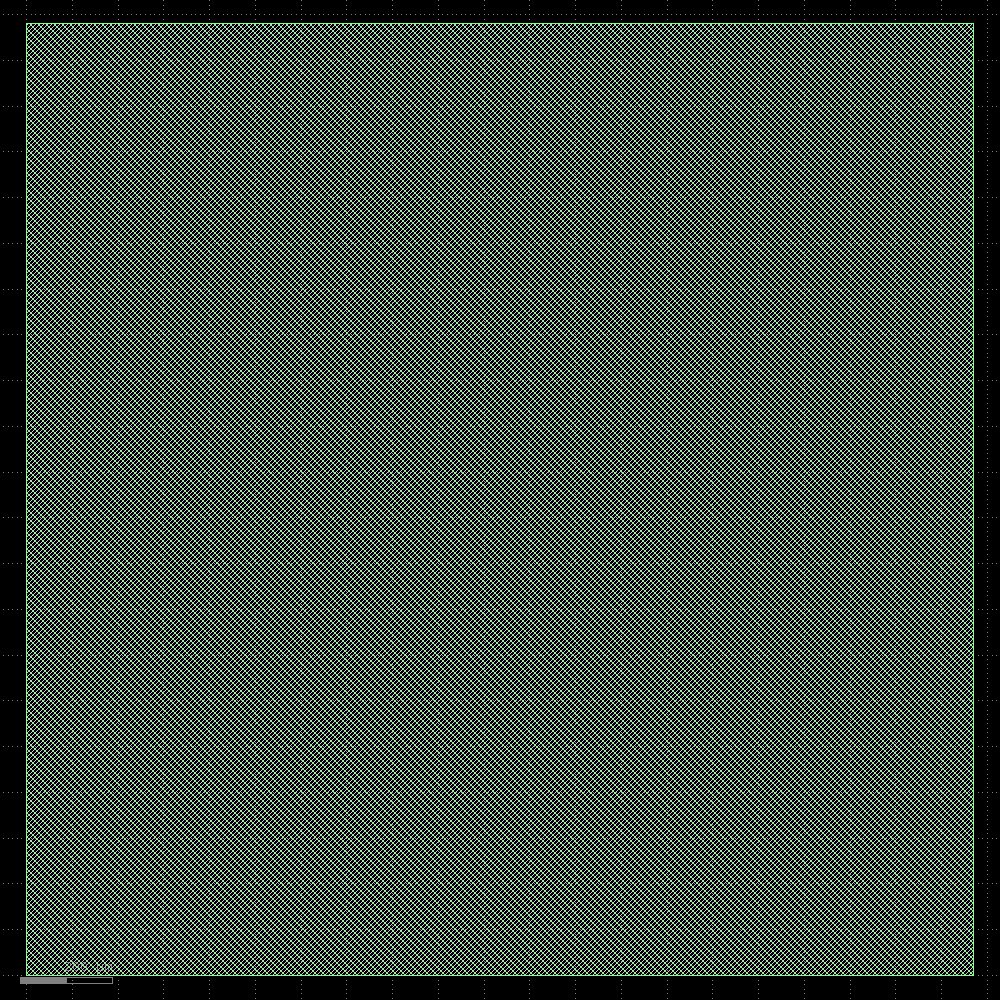

In [ ]:
# @title Floorplanning
Floorplan = Step.factory.get("OpenROAD.Floorplan")

floorplan = Floorplan(state_in=synthesis.state_out)
floorplan.start()
display(floorplan)

─────────────────────────────────────────────── Tap/Decap Insertion ───────────────────────────────────────────────

[18:49:41] VERBOSE  Running 'OpenROAD.TapEndcapInsertion'… (Log:                                       ]8;id=11856;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=139052;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=540073;file:///content/openlane_run/20-openroad-tapendcapinsertion/openroad-tapendcapinsertion.log\.]8;;\]8;id=149663;file:///content/openlane_run/20-openroad-tapendcapinsertion/openroad-tapendcapinsertion.log\/openlane_run/20-openroad-tapendcapinsertion/]8;;\]8;id=561815;file:///content/openlane_run/20-openroad-tapendcapinsertion/openroad-tapendcapinsertion.log\openroad-tapendcapinsertion.log]8;;\)                 

Reading OpenROAD database at '/content/openlane_run/19-openroad-floorplan/btle_controller_wrapper.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO TAP-0004] Inserted 1514 endcaps.

[INFO TAP-0005] Inserted 60340 tapcells.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/20-openroad-tapendcapinsertion/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/20-openroad-tapendcapinsertion/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/20-openroad-tapendcapinsertion/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/20-openroad-tapendcapinsertion/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/20-openroad-tapendcapinsertion/btle_controller_wrapper.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[18:50:11] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=867030;file:///tmp/tmpz8s8a0js/klayout-render.log\/tmp/tmpz8s8a0js/]8;;\]8;id=496708;file:///tmp/tmpz8s8a0js/klayout-render.log\klayout-render.log]8;;\)               ]8;id=184417;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=820926;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 30.45s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
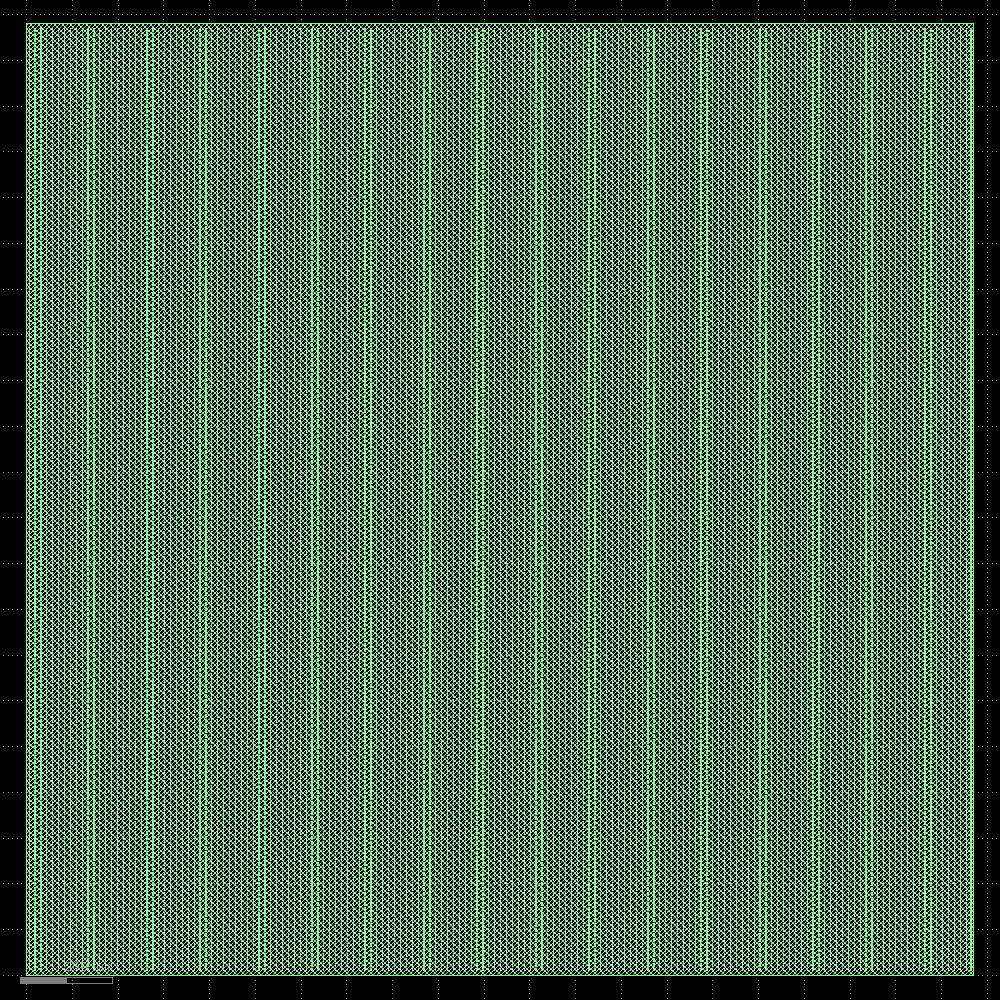

In [ ]:
# @title Tap/Endcap Cell Insertion

TapEndcapInsertion = Step.factory.get("OpenROAD.TapEndcapInsertion")

tdi = TapEndcapInsertion(state_in=floorplan.state_out)
tdi.start()
display(tdi)

────────────────────────────────────────────────── I/O Placement ──────────────────────────────────────────────────

[18:50:20] VERBOSE  Running 'OpenROAD.IOPlacement'… (Log:                                              ]8;id=710299;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=746294;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=71407;file:///content/openlane_run/21-openroad-ioplacement/openroad-ioplacement.log\.]8;;\]8;id=557601;file:///content/openlane_run/21-openroad-ioplacement/openroad-ioplacement.log\/openlane_run/21-openroad-ioplacement/]8;;\]8;id=236089;file:///content/openlane_run/21-openroad-ioplacement/openroad-ioplacement.log\openroad-ioplacement.log]8;;\)                               

Reading OpenROAD database at '/content/openlane_run/20-openroad-tapendcapinsertion/btle_controller_wrapper.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] place_pins args: -min_distance 3

Found 0 macro blocks.

[INFO PPL-0010] Tentative 0 to set up sections.

[INFO PPL-0001] Number of slots           2510

[INFO PPL-0002] Number of I/O             88

[INFO PPL-0003] Number of I/O w/sink      88

[INFO PPL-0004] Number of I/O w/o sink    0

[INFO PPL-0005] Slots per section         200

[INFO PPL-0006] Slots increase factor     0.01

[INFO PPL-0008] Successfully assigned pins to sections.

[INFO PPL-0012] I/O nets HPWL: 97681.49 um.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/21-openroad-ioplacement/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/21-openroad-ioplacement/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/21-openroad-ioplacement/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/21-openroad-ioplacement/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/21-openroad-ioplacement/btle_controller_wrapper.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[18:50:42] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=961843;file:///tmp/tmplcawrn08/klayout-render.log\/tmp/tmplcawrn08/]8;;\]8;id=198508;file:///tmp/tmplcawrn08/klayout-render.log\klayout-render.log]8;;\)               ]8;id=449777;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=394173;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 22.38s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
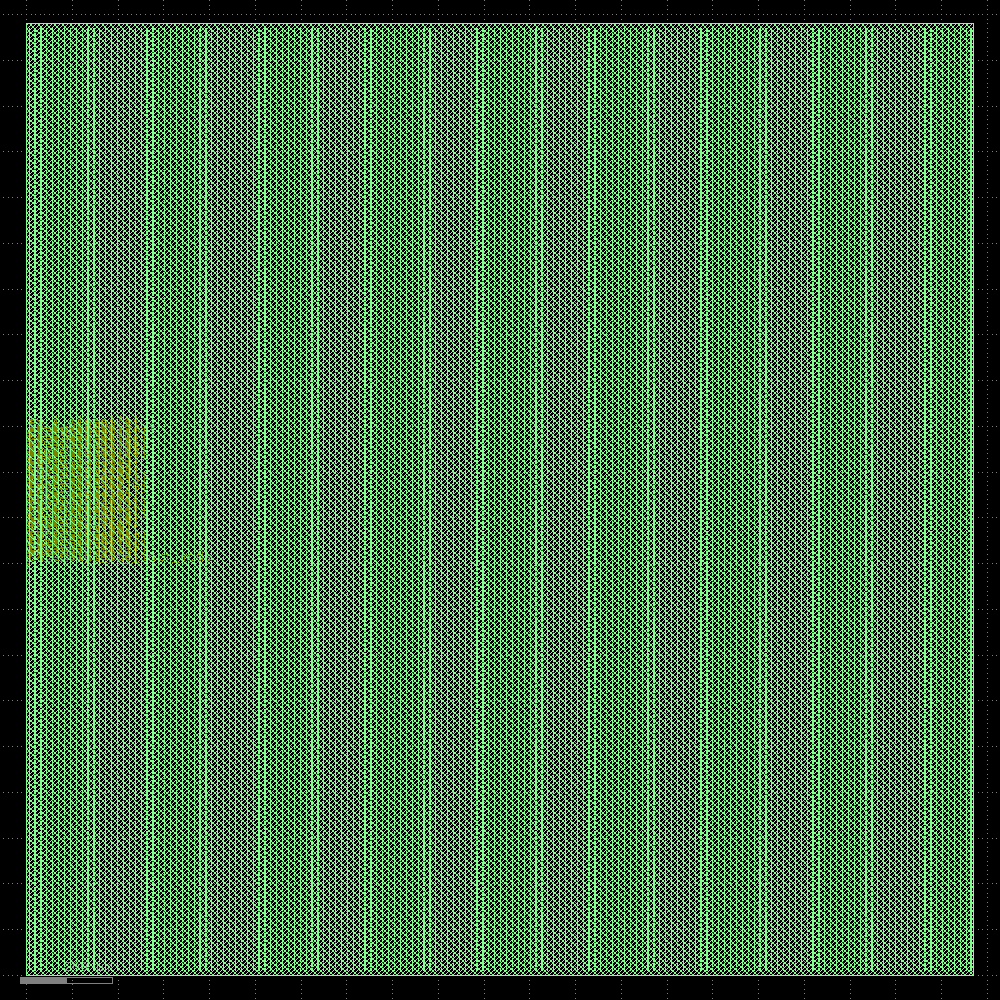

In [ ]:
# @title I/O Placement
IOPlacement = Step.factory.get("OpenROAD.IOPlacement")

ioplace = IOPlacement(state_in=tdi.state_out)
ioplace.start()
display(ioplace)

────────────────────────────────────── Power Distribution Network Generation ──────────────────────────────────────

[18:50:52] VERBOSE  Running 'OpenROAD.GeneratePDN'… (Log:                                              ]8;id=179148;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=987011;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=922116;file:///content/openlane_run/22-openroad-generatepdn/openroad-generatepdn.log\.]8;;\]8;id=665881;file:///content/openlane_run/22-openroad-generatepdn/openroad-generatepdn.log\/openlane_run/22-openroad-generatepdn/]8;;\]8;id=802396;file:///content/openlane_run/22-openroad-generatepdn/openroad-generatepdn.log\openroad-generatepdn.log]8;;\)                               

[18:50:52] INFO     'FP_PDN_CFG' not explicitly set, setting it to                                 ]8;id=296149;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=166554;file:///content/openlane_ipynb/openlane/steps/openroad.py#1085\1085]8;;\
                    /content/openlane_ipynb/openlane/scripts/openroad/common/pdn_cfg.tcl…                          

Reading OpenROAD database at '/content/openlane_run/21-openroad-ioplacement/btle_controller_wrapper.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting global connections...

[INFO PDN-0001] Inserting grid: stdcell_grid

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/22-openroad-generatepdn/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/22-openroad-generatepdn/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/22-openroad-generatepdn/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/22-openroad-generatepdn/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/22-openroad-generatepdn/btle_controller_wrapper.sdc'…

[INFO PSM-0076] Setting metal node density to be standard cell height times 5.

[INFO PSM-0031] Number of PDN nodes on net VPWR = 219385.

[INFO PSM-0064] Number of voltage sources = 11316.

[INFO PSM-0040] All PDN stripes on net VPWR are connected.

[INFO PSM-0076] Setting metal node density to be standard cell height times 5.

[INFO PSM-0031] Number of PDN nodes on net VGND = 216833.

[INFO PSM-0064] Number of voltage sources = 11152.

[INFO PSM-0040] All PDN stripes on net VGND are connected.

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[18:52:40] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=18861;file:///tmp/tmpfm3jfplp/klayout-render.log\/tmp/tmpfm3jfplp/]8;;\]8;id=105925;file:///tmp/tmpfm3jfplp/klayout-render.log\klayout-render.log]8;;\)               ]8;id=535397;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=741693;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 107.85s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
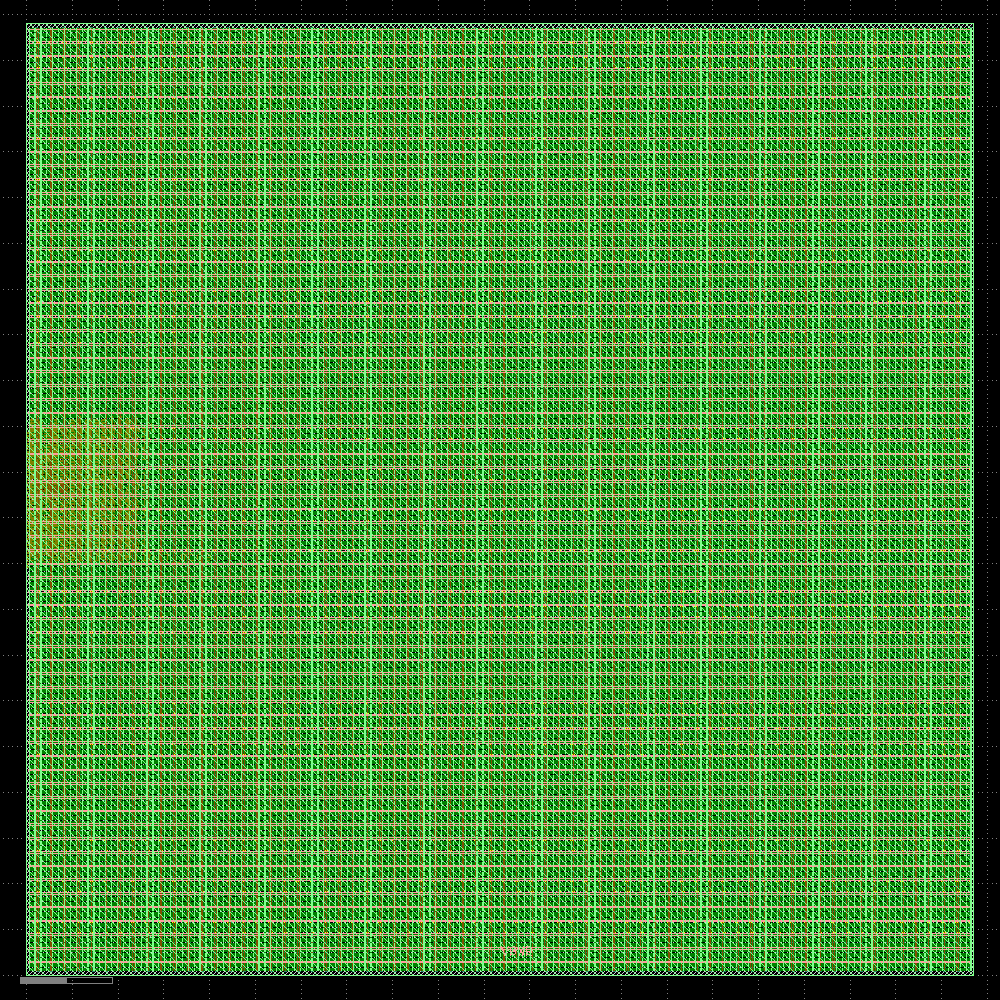

In [ ]:
# @title Generating the Power Distribution Network (PDN)
GeneratePDN = Step.factory.get("OpenROAD.GeneratePDN")

pdn = GeneratePDN(
    state_in=ioplace.state_out,
    FP_PDN_VWIDTH=2,
    FP_PDN_HWIDTH=2,
    FP_PDN_VPITCH=30,
    FP_PDN_HPITCH=30,
)
pdn.start()

display(pdn)

──────────────────────────────────────────────── Global Placement ─────────────────────────────────────────────────

[18:52:54] VERBOSE  Running 'OpenROAD.GlobalPlacement'… (Log:                                          ]8;id=158142;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=544964;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=405946;file:///content/openlane_run/23-openroad-globalplacement/openroad-globalplacement.log\.]8;;\]8;id=90298;file:///content/openlane_run/23-openroad-globalplacement/openroad-globalplacement.log\/openlane_run/23-openroad-globalplacement/]8;;\]8;id=508233;file:///content/openlane_run/23-openroad-globalplacement/openroad-globalplacement.log\openroad-globalplacement.log]8;;\)                       

[18:52:54] INFO     'PL_TARGET_DENSITY_PCT' not explicitly set, using dynamically calculated       ]8;id=914182;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=9402;file:///content/openlane_ipynb/openlane/steps/openroad.py#1172\1172]8;;\
                    target density: 61.800200…                                                                     

Reading OpenROAD database at '/content/openlane_run/22-openroad-generatepdn/btle_controller_wrapper.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting RC values…

[INFO] Setting signal min routing layer to: met1 and clock min routing layer to met1.

[INFO] Setting signal max routing layer to: met5 and clock max routing layer to met5.

{*}-density 0.6180019999999999 -timing_driven -routability_driven -pad_right 0 -pad_left 0 -init_wirelength_coef   
0.25

[INFO GPL-0002] DBU: 1000

[INFO GPL-0003] SiteSize: 460 2720

[INFO GPL-0004] CoreAreaLxLy: 5520 10880

[INFO GPL-0005] CoreAreaUxUy: 2064480 2069920

[INFO GPL-0006] NumInstances: 229355

[INFO GPL-0007] NumPlaceInstances: 167501

[INFO GPL-0008] NumFixedInstances: 61854

[INFO GPL-0009] NumDummyInstances: 0

[INFO GPL-0010] NumNets: 167538

[INFO GPL-0011] NumPins: 629190

[INFO GPL-0012] DieAreaLxLy: 0 0

[INFO GPL-0013] DieAreaUxUy: 2070435 2081155

[INFO GPL-0014] CoreAreaLxLy: 5520 10880

[INFO GPL-0015] CoreAreaUxUy: 2064480 2069920

[INFO GPL-0016] CoreArea: 4239480998400

[INFO GPL-0017] NonPlaceInstsArea: 81180358400

[INFO GPL-0018] PlaceInstsArea: 2120563788800

[INFO GPL-0019] Util(%): 51.00

[INFO GPL-0020] StdInstsArea: 2120563788800

[INFO GPL-0021] MacroInstsArea: 0

[InitialPlace]  Iter: 1 CG residual: 0.00105344 HPWL: 1528794820

[InitialPlace]  Iter: 2 CG residual: 0.00083999 HPWL: 1630783975

[InitialPlace]  Iter: 3 CG residual: 0.00064122 HPWL: 1633893157

[InitialPlace]  Iter: 4 CG residual: 0.00072468 HPWL: 1639552607

[InitialPlace]  Iter: 5 CG residual: 0.00060557 HPWL: 1637712221

[InitialPlace]  Iter: 6 CG residual: 0.00075113 HPWL: 1640268066

[InitialPlace]  Iter: 7 CG residual: 0.00063711 HPWL: 1637935180

[InitialPlace]  Iter: 8 CG residual: 0.00065026 HPWL: 1640258923

[InitialPlace]  Iter: 9 CG residual: 0.00059265 HPWL: 1637790683

[InitialPlace]  Iter: 10 CG residual: 0.00058869 HPWL: 1640121301

[InitialPlace]  Iter: 11 CG residual: 0.00063235 HPWL: 1637666621

[InitialPlace]  Iter: 12 CG residual: 0.00057282 HPWL: 1640002158

[InitialPlace]  Iter: 13 CG residual: 0.00059040 HPWL: 1637529853

[InitialPlace]  Iter: 14 CG residual: 0.00053512 HPWL: 1639817316

[InitialPlace]  Iter: 15 CG residual: 0.00056737 HPWL: 1637337008

[InitialPlace]  Iter: 16 CG residual: 0.00063166 HPWL: 1639603707

[InitialPlace]  Iter: 17 CG residual: 0.00059725 HPWL: 1637217557

[InitialPlace]  Iter: 18 CG residual: 0.00053942 HPWL: 1639446589

[InitialPlace]  Iter: 19 CG residual: 0.00058763 HPWL: 1637034871

[InitialPlace]  Iter: 20 CG residual: 0.00056342 HPWL: 1639342468

[INFO GPL-0031] FillerInit: NumGCells: 203315

[INFO GPL-0032] FillerInit: NumGNets: 167538

[INFO GPL-0033] FillerInit: NumGPins: 629190

[INFO GPL-0023] TargetDensity: 0.62

[INFO GPL-0024] AveragePlaceInstArea: 12660006

[INFO GPL-0025] IdealBinArea: 20485380

[INFO GPL-0026] IdealBinCnt: 206951

[INFO GPL-0027] TotalBinArea: 4239480998400

[INFO GPL-0028] BinCnt: 256 256

[INFO GPL-0029] BinSize: 8043 8044

[INFO GPL-0030] NumBins: 65536

[NesterovSolve] Iter: 1 overflow: 0.998834 HPWL: 406882207

[NesterovSolve] Iter: 10 overflow: 0.997034 HPWL: 458084624

[NesterovSolve] Iter: 20 overflow: 0.99584 HPWL: 464250366

[NesterovSolve] Iter: 30 overflow: 0.995038 HPWL: 496847596

[NesterovSolve] Iter: 40 overflow: 0.994732 HPWL: 519388836

[NesterovSolve] Iter: 50 overflow: 0.99465 HPWL: 528798782

[NesterovSolve] Iter: 60 overflow: 0.994615 HPWL: 527005795

[NesterovSolve] Iter: 70 overflow: 0.994498 HPWL: 520208131

[NesterovSolve] Iter: 80 overflow: 0.994419 HPWL: 514365224

[NesterovSolve] Iter: 90 overflow: 0.99431 HPWL: 511955473

[NesterovSolve] Iter: 100 overflow: 0.994108 HPWL: 512144817

[NesterovSolve] Iter: 110 overflow: 0.994012 HPWL: 512949634

[NesterovSolve] Iter: 120 overflow: 0.993883 HPWL: 513334227

[NesterovSolve] Iter: 130 overflow: 0.99381 HPWL: 513569865

[NesterovSolve] Iter: 140 overflow: 0.993589 HPWL: 515672043

[NesterovSolve] Iter: 150 overflow: 0.993254 HPWL: 522955512

[NesterovSolve] Iter: 160 overflow: 0.992466 HPWL: 537614938

[NesterovSolve] Iter: 170 overflow: 0.991182 HPWL: 559483810

[NesterovSolve] Iter: 180 overflow: 0.988979 HPWL: 589718670

[NesterovSolve] Iter: 190 overflow: 0.985458 HPWL: 629749494

[NesterovSolve] Iter: 200 overflow: 0.980693 HPWL: 683875938

[NesterovSolve] Iter: 210 overflow: 0.973852 HPWL: 755460025

[NesterovSolve] Iter: 220 overflow: 0.964229 HPWL: 843630242

[NesterovSolve] Iter: 230 overflow: 0.952395 HPWL: 952391400

[NesterovSolve] Iter: 240 overflow: 0.938343 HPWL: 1086756843

[NesterovSolve] Iter: 250 overflow: 0.920697 HPWL: 1247538037

[NesterovSolve] Iter: 260 overflow: 0.899875 HPWL: 1435318425

[NesterovSolve] Iter: 270 overflow: 0.87608 HPWL: 1653016589

[NesterovSolve] Iter: 280 overflow: 0.853093 HPWL: 1875606001

[NesterovSolve] Iter: 290 overflow: 0.82764 HPWL: 2043724158

[NesterovSolve] Iter: 300 overflow: 0.797684 HPWL: 2209117260

[INFO GPL-0100] worst slack 2.73e-08

[INFO GPL-0103] Weighted 16742 nets.

[NesterovSolve] Iter: 310 overflow: 0.769061 HPWL: 2341490402

[NesterovSolve] Iter: 320 overflow: 0.741311 HPWL: 2458151437

[NesterovSolve] Iter: 330 overflow: 0.706135 HPWL: 2629767881

[NesterovSolve] Iter: 340 overflow: 0.662787 HPWL: 2699000578

[INFO GPL-0100] worst slack 2.68e-08

[INFO GPL-0103] Weighted 16750 nets.

[NesterovSolve] Iter: 350 overflow: 0.62262 HPWL: 2692161881

[NesterovSolve] Snapshot saved at iter = 355

[NesterovSolve] Iter: 360 overflow: 0.579555 HPWL: 2782192620

[NesterovSolve] Iter: 370 overflow: 0.533345 HPWL: 2743817547

[NesterovSolve] Iter: 380 overflow: 0.489169 HPWL: 2731465847

[INFO GPL-0100] worst slack 2.68e-08

[INFO GPL-0103] Weighted 16751 nets.

[NesterovSolve] Iter: 390 overflow: 0.437786 HPWL: 2697431564

[NesterovSolve] Iter: 400 overflow: 0.391161 HPWL: 2732393326

[NesterovSolve] Iter: 410 overflow: 0.345316 HPWL: 2695767945

[NesterovSolve] Iter: 420 overflow: 0.303195 HPWL: 2646129279

[INFO GPL-0100] worst slack 2.75e-08

[INFO GPL-0103] Weighted 16750 nets.

[NesterovSolve] Iter: 430 overflow: 0.268197 HPWL: 2605792533

[NesterovSolve] Iter: 440 overflow: 0.230136 HPWL: 2558646079

[INFO GPL-0100] worst slack 2.79e-08

[INFO GPL-0103] Weighted 16752 nets.

[NesterovSolve] Iter: 450 overflow: 0.19899 HPWL: 2516645742

[INFO GPL-0075] Routability numCall: 1 inflationIterCnt: 1 bloatIterCnt: 0

[INFO GPL-0036] TileLxLy: 0 0

[INFO GPL-0037] TileSize: 6900 6900

[INFO GPL-0038] TileCnt: 300 301

[INFO GPL-0039] numRoutingLayers: 6

[INFO GPL-0040] NumTiles: 90300

[INFO GPL-0063] TotalRouteOverflowH2: 83.40000784397125

[INFO GPL-0064] TotalRouteOverflowV2: 29.166672110557556

[INFO GPL-0065] OverflowTileCnt2: 683

[INFO GPL-0066] 0.5%RC: 1.0692691095049596

[INFO GPL-0067] 1.0%RC: 1.0346345547524798

[INFO GPL-0068] 2.0%RC: 1.0173208739032131

[INFO GPL-0069] 5.0%RC: 1.0069286373551525

[INFO GPL-0070] 0.5rcK: 1

[INFO GPL-0071] 1.0rcK: 1

[INFO GPL-0072] 2.0rcK: 0

[INFO GPL-0073] 5.0rcK: 0

[INFO GPL-0074] FinalRC: 1.0519519

[NesterovSolve] Iter: 460 overflow: 0.169732 HPWL: 2484458485

[NesterovSolve] Iter: 470 overflow: 0.145246 HPWL: 2461141432

[INFO GPL-0100] worst slack 2.76e-08

[INFO GPL-0103] Weighted 16750 nets.

[NesterovSolve] Iter: 480 overflow: 0.123055 HPWL: 2445421164

[NesterovSolve] Iter: 490 overflow: 0.104403 HPWL: 2433430488

[NesterovSolve] Finished with Overflow: 0.099956

[INFO] Setting RC values…

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/23-openroad-globalplacement/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/23-openroad-globalplacement/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/23-openroad-globalplacement/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/23-openroad-globalplacement/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/23-openroad-globalplacement/btle_controller_wrapper.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[19:36:39] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=90932;file:///tmp/tmp2jqjmck8/klayout-render.log\/tmp/tmp2jqjmck8/]8;;\]8;id=283987;file:///tmp/tmp2jqjmck8/klayout-render.log\klayout-render.log]8;;\)               ]8;id=175778;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=370861;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 2625.47s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
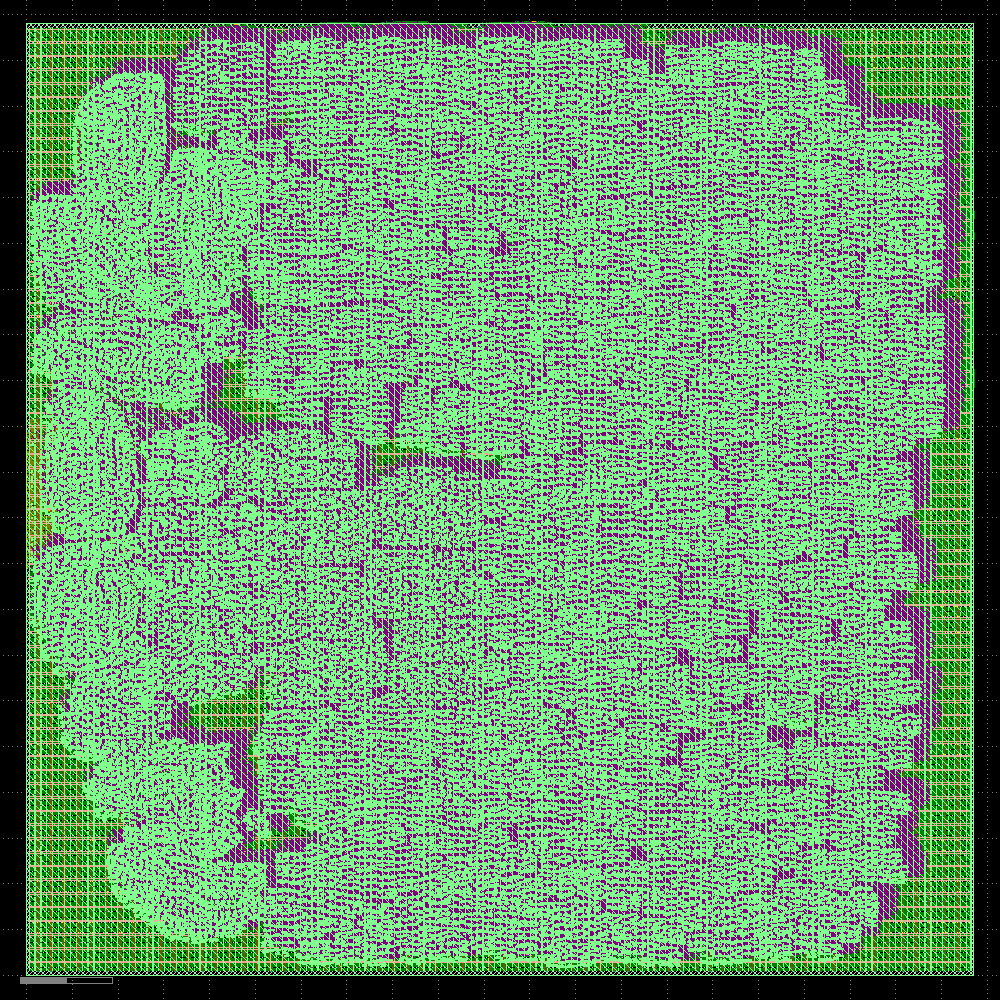

In [ ]:
# @title Global Placement
GlobalPlacement = Step.factory.get("OpenROAD.GlobalPlacement")

gpl = GlobalPlacement(state_in=pdn.state_out)
gpl.start()

display(gpl)

─────────────────────────────────────────────── Detailed Placement ────────────────────────────────────────────────

[19:36:55] VERBOSE  Running 'OpenROAD.DetailedPlacement'… (Log:                                        ]8;id=65130;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=329880;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=178961;file:///content/openlane_run/24-openroad-detailedplacement/openroad-detailedplacement.log\.]8;;\]8;id=601680;file:///content/openlane_run/24-openroad-detailedplacement/openroad-detailedplacement.log\/openlane_run/24-openroad-detailedplacement/]8;;\]8;id=694609;file:///content/openlane_run/24-openroad-detailedplacement/openroad-detailedplacement.log\openroad-detailedplacement.log]8;;\)                   

Reading OpenROAD database at '/content/openlane_run/23-openroad-globalplacement/btle_controller_wrapper.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

Placement Analysis

---------------------------------

total displacement     570220.8 u

average displacement        2.5 u

max displacement           14.5 u

original HPWL         2430256.7 u

legalized HPWL        3083582.0 u

delta HPWL                   27 %

[INFO DPL-0020] Mirrored 38482 instances

[INFO DPL-0021] HPWL before          3083582.0 u

[INFO DPL-0022] HPWL after           3011343.4 u

[INFO DPL-0023] HPWL delta               -2.3 %

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/24-openroad-detailedplacement/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/24-openroad-detailedplacement/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/24-openroad-detailedplacement/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/24-openroad-detailedplacement/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/24-openroad-detailedplacement/btle_controller_wrapper.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[19:37:21] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=933452;file:///tmp/tmprcyxcqb1/klayout-render.log\/tmp/tmprcyxcqb1/]8;;\]8;id=427373;file:///tmp/tmprcyxcqb1/klayout-render.log\klayout-render.log]8;;\)               ]8;id=140836;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=680314;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 26.17s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
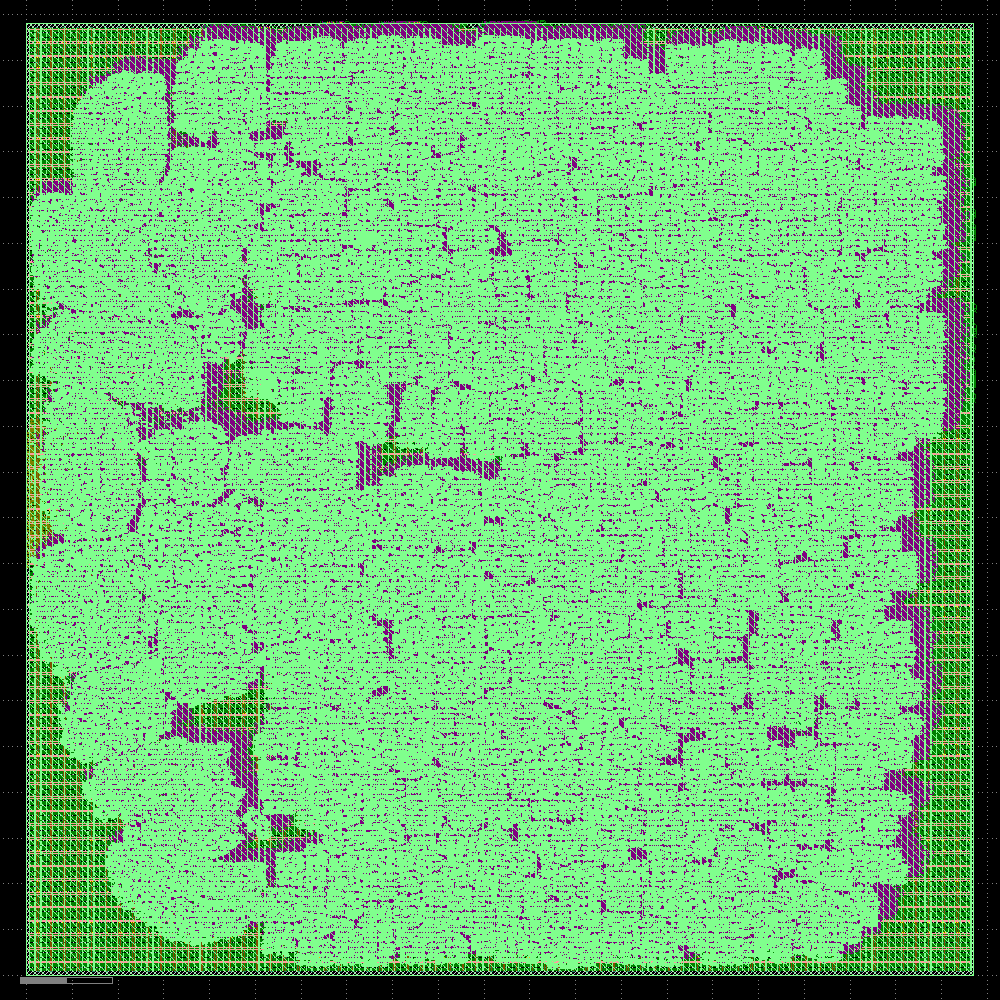

In [ ]:
# @title Detailed Placement
DetailedPlacement = Step.factory.get("OpenROAD.DetailedPlacement")

dpl = DetailedPlacement(state_in=gpl.state_out)
dpl.start()
display(dpl)

────────────────────────────────────────────── Clock Tree Synthesis ───────────────────────────────────────────────

[19:37:37] VERBOSE  Running 'OpenROAD.CTS'… (Log: ]8;id=419693;file:///content/openlane_run/25-openroad-cts/openroad-cts.log\.]8;;\]8;id=345532;file:///content/openlane_run/25-openroad-cts/openroad-cts.log\/openlane_run/25-openroad-cts/]8;;\]8;id=969805;file:///content/openlane_run/25-openroad-cts/openroad-cts.log\openroad-cts.log]8;;\)     ]8;id=122250;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=18126;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

Reading timing models for corner nom_tt_025C_1v80…

Reading timing library for the 'nom_tt_025C_1v80' corner at                                                        
'/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading timing models for corner nom_ff_n40C_1v95…

Reading timing library for the 'nom_ff_n40C_1v95' corner at                                                        
'/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ff_n40C_1v95.lib'…

Reading timing models for corner nom_ss_100C_1v60…

Reading timing library for the 'nom_ss_100C_1v60' corner at                                                        
'/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ss_100C_1v60.lib'…

Reading OpenROAD database at '/content/openlane_run/24-openroad-detailedplacement/btle_controller_wrapper.odb'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting RC values…

[INFO] Configuring cts characterization…

[INFO] Performing clock tree synthesis…

[INFO] Looking for the following net(s): clk

[INFO] Running Clock Tree Synthesis…

[INFO CTS-0050] Root buffer is sky130_fd_sc_hd__clkbuf_16.

[INFO CTS-0051] Sink buffer is sky130_fd_sc_hd__clkbuf_8.

[INFO CTS-0052] The following clock buffers will be used for CTS:

sky130_fd_sc_hd__clkbuf_2

sky130_fd_sc_hd__clkbuf_4

sky130_fd_sc_hd__clkbuf_8

[INFO CTS-0049] Characterization buffer is sky130_fd_sc_hd__clkbuf_8.

[INFO CTS-0007] Net "clk" found for clock "clk".

[INFO CTS-0010]  Clock net "clk" has 40275 sinks.

[INFO CTS-0008] TritonCTS found 1 clock nets.

[INFO CTS-0097] Characterization used 3 buffer(s) types.

[INFO CTS-0200] 0 placement blockages have been identified.

[INFO CTS-0201] 0 placed hard macros will be treated like blockages.

[INFO CTS-0027] Generating H-Tree topology for net clk.

[INFO CTS-0028]  Total number of sinks: 40275.

[INFO CTS-0029]  Sinks will be clustered in groups of up to 25 and with maximum cluster diameter of 50.0 um.

[INFO CTS-0030]  Number of static layers: 0.

[INFO CTS-0020]  Wire segment unit: 13600  dbu (13 um).

[INFO CTS-0204] A clustering solution was found from clustering size of 25 and clustering diameter of 50.

[INFO CTS-0205] Better solution may be possible if either -sink_clustering_size, -sink_clustering_max_diameter, or 
both options are omitted to enable automatic clustering.

[INFO CTS-0019]  Total number of sinks after clustering: 3852.

[INFO CTS-0024]  Normalized sink region: [(0.822151, 2.13046), (147.471, 150.302)].

[INFO CTS-0025]     Width:  146.6484.

[INFO CTS-0026]     Height: 148.1714.

Level 1

Direction: Vertical

Sinks per sub-region: 1926

Sub-region size: 146.6484 X 74.0857

[INFO CTS-0034]     Segment length (rounded): 38.

Level 2

Direction: Horizontal

Sinks per sub-region: 963

Sub-region size: 73.3242 X 74.0857

[INFO CTS-0034]     Segment length (rounded): 36.

Level 3

Direction: Vertical

Sinks per sub-region: 482

Sub-region size: 73.3242 X 37.0429

[INFO CTS-0034]     Segment length (rounded): 18.

Level 4

Direction: Horizontal

Sinks per sub-region: 241

Sub-region size: 36.6621 X 37.0429

[INFO CTS-0034]     Segment length (rounded): 18.

Level 5

Direction: Vertical

Sinks per sub-region: 121

Sub-region size: 36.6621 X 18.5214

[INFO CTS-0034]     Segment length (rounded): 10.

Level 6

Direction: Horizontal

Sinks per sub-region: 61

Sub-region size: 18.3311 X 18.5214

[INFO CTS-0034]     Segment length (rounded): 10.

Level 7

Direction: Vertical

Sinks per sub-region: 31

Sub-region size: 18.3311 X 9.2607

[INFO CTS-0034]     Segment length (rounded): 4.

Level 8

Direction: Horizontal

Sinks per sub-region: 16

Sub-region size: 9.1655 X 9.2607

[INFO CTS-0034]     Segment length (rounded): 4.

Level 9

Direction: Vertical

Sinks per sub-region: 8

Sub-region size: 9.1655 X 4.6304

[INFO CTS-0034]     Segment length (rounded): 2.

[INFO CTS-0032]  Stop criterion found. Max number of sinks is 15.

[INFO CTS-0035]  Number of sinks covered: 3852.

[INFO CTS-0018]     Created 4430 clock buffers.

[INFO CTS-0012]     Minimum number of buffers in the clock path: 7.

[INFO CTS-0013]     Maximum number of buffers in the clock path: 8.

[INFO CTS-0015]     Created 4430 clock nets.

[INFO CTS-0016]     Fanout distribution for the current clock = 2:35, 3:47, 4:95, 5:138, 6:325, 7:436, 8:458,      
9:492, 10:381, 11:352, 12:375, 13:376, 14:289, 15:218, 16:166, 17:84, 18:46, 19:17, 20:4, 22:1..

[INFO CTS-0017]     Max level of the clock tree: 9.

[INFO CTS-0098] Clock net "clk"

[INFO CTS-0099]  Sinks 40275

[INFO CTS-0100]  Leaf buffers 3823

[INFO CTS-0101]  Average sink wire length 2814.63 um

[INFO CTS-0102]  Path depth 7 - 8

[INFO] Repairing long wires on clock nets…

[INFO RSZ-0058] Using max wire length 4459um.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.sdc'…

[INFO] Legalizing…

Placement Analysis

---------------------------------

total displacement      35040.0 u

average displacement        0.1 u

max displacement           11.5 u

original HPWL         3320395.1 u

legalized HPWL        3425434.8 u

delta HPWL                    3 %

[INFO DPL-0020] Mirrored 42041 instances

[INFO DPL-0021] HPWL before          3425434.8 u

[INFO DPL-0022] HPWL after           3339438.7 u

[INFO DPL-0023] HPWL delta               -2.5 %

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.odb'…

Writing netlist to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.nl.v'…

Writing powered netlist to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.pnl.v'…

Writing layout to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.def'…

Writing timing constraints to '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[19:41:22] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=903853;file:///tmp/tmp2lemzfrq/klayout-render.log\/tmp/tmp2lemzfrq/]8;;\]8;id=361614;file:///tmp/tmp2lemzfrq/klayout-render.log\klayout-render.log]8;;\)               ]8;id=870721;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=799032;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 225.29s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
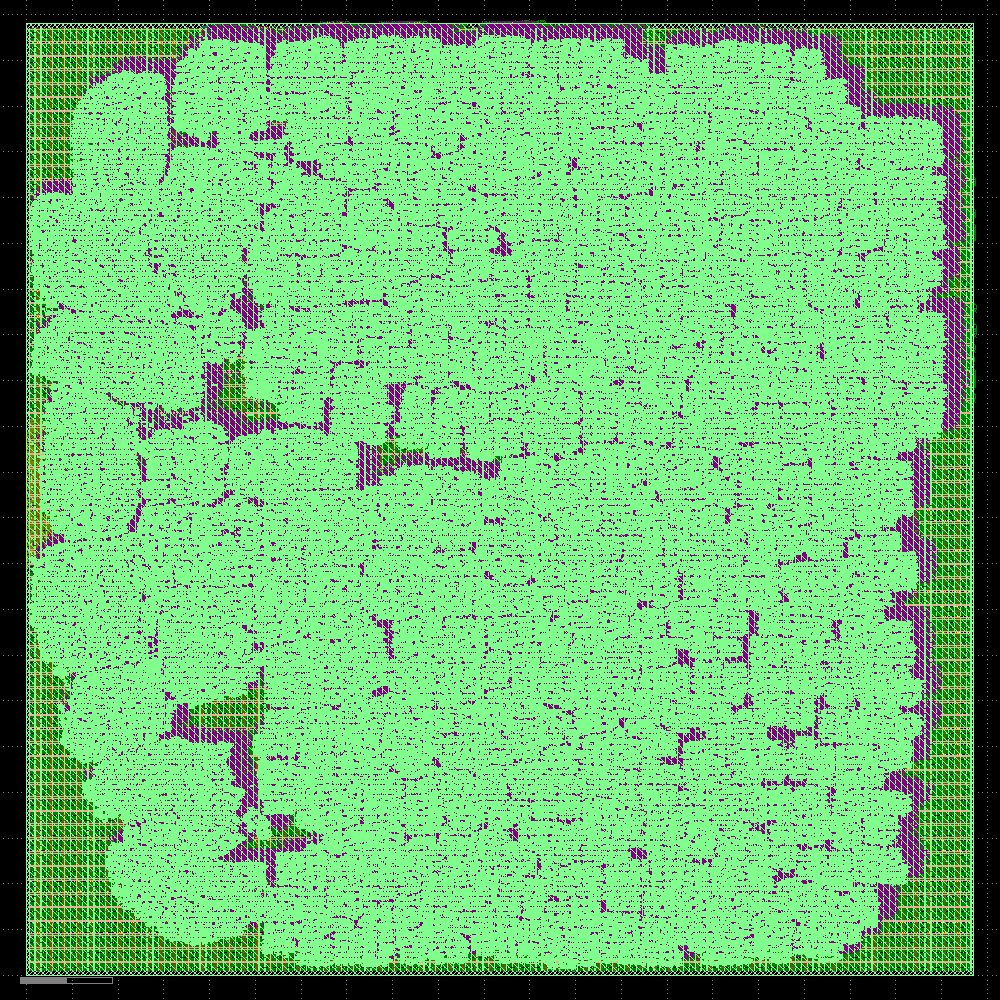

In [ ]:
# @title Clock Tree Synthesis (CTS)
CTS = Step.factory.get("OpenROAD.CTS")

cts = CTS(state_in=dpl.state_out)
cts.start()
display(cts)

In [ ]:
# @title Global Routing
GlobalRouting = Step.factory.get("OpenROAD.GlobalRouting")

grt = GlobalRouting(state_in=cts.state_out)
grt.start()

───────────────────────────────────────────────── Global Routing ──────────────────────────────────────────────────

[19:41:39] VERBOSE  Running 'OpenROAD.GlobalRouting'… (Log:                                            ]8;id=632243;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=329187;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=68064;file:///content/openlane_run/26-openroad-globalrouting/openroad-globalrouting.log\.]8;;\]8;id=73518;file:///content/openlane_run/26-openroad-globalrouting/openroad-globalrouting.log\/openlane_run/26-openroad-globalrouting/]8;;\]8;id=266044;file:///content/openlane_run/26-openroad-globalrouting/openroad-globalrouting.log\openroad-globalrouting.log]8;;\)                           

Reading OpenROAD database at '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting signal min routing layer to: met1 and clock min routing layer to met1.

[INFO] Setting signal max routing layer to: met5 and clock max routing layer to met5.

-congestion_iterations 50 -verbose

[INFO GRT-0020] Min routing layer: met1

[INFO GRT-0021] Max routing layer: met5

[INFO GRT-0022] Global adjustment: 30%

[INFO GRT-0023] Grid origin: (0, 0)

[INFO GRT-0043] No OR_DEFAULT vias defined.

[INFO GRT-0088] Layer li1     Track-Pitch = 0.4600  line-2-Via Pitch: 0.3400

[INFO GRT-0088] Layer met1    Track-Pitch = 0.3400  line-2-Via Pitch: 0.3400

[INFO GRT-0088] Layer met2    Track-Pitch = 0.4600  line-2-Via Pitch: 0.3500

[INFO GRT-0088] Layer met3    Track-Pitch = 0.6800  line-2-Via Pitch: 0.6150

[INFO GRT-0088] Layer met4    Track-Pitch = 0.9200  line-2-Via Pitch: 1.0400

[INFO GRT-0088] Layer met5    Track-Pitch = 3.4000  line-2-Via Pitch: 3.1100

[INFO GRT-0019] Found 4431 clock nets.

[INFO GRT-0001] Minimum degree: 2

[INFO GRT-0002] Maximum degree: 16386

[INFO GRT-0003] Macros: 0

[INFO GRT-0004] Blockages: 590752

[INFO GRT-0053] Routing resources analysis:

Routing      Original      Derated      Resource

Layer     Direction    Resources     Resources    Reduction (%)

---------------------------------------------------------------

li1        Vertical            0             0          0.00%

met1       Horizontal    1809580        861072          52.42%

met2       Vertical      1354515        900000          33.56%

met3       Horizontal     904790        614325          32.10%

met4       Vertical       542107        270001          50.19%

met5       Horizontal     180898         74152          59.01%

---------------------------------------------------------------

[INFO GRT-0101] Running extra iterations to remove overflow.

[INFO GRT-0197] Via related to pin nodes: 1085454

[INFO GRT-0198] Via related Steiner nodes: 25238

[INFO GRT-0199] Via filling finished.

[INFO GRT-0111] Final number of vias: 1365252

[INFO GRT-0112] Final usage 3D: 4914041

[INFO GRT-0096] Final congestion report:

Layer         Resource        Demand        Usage (%)    Max H / Max V / Total Overflow

---------------------------------------------------------------------------------------

li1                  0             0            0.00%             0 /  0 /  0

met1            861072        379906           44.12%             0 /  0 /  0

met2            900000        375034           41.67%             0 /  0 /  0

met3            614325         41686            6.79%             0 /  0 /  0

met4            270001         21539            7.98%             0 /  0 /  0

met5             74152           120            0.16%             0 /  0 /  0

---------------------------------------------------------------------------------------

Total          2719550        818285           30.09%             0 /  0 /  0

[INFO GRT-0018] Total wirelength: 8853638 um

[INFO GRT-0014] Routed nets: 171968

StepException: OpenROAD.GlobalRouting failed unexpectedly. Please check the logs and file an issue.

In [ ]:
# @title The global routing has error. No rich info there. Try a smaller submodule in later section
!cat openlane_run/26-openroad-globalrouting/openroad-globalrouting.log

Reading OpenROAD database at '/content/openlane_run/25-openroad-cts/btle_controller_wrapper.odb'…
Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…
Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…
[INFO] Using clock clk…
[INFO] Setting output delay to: 12.5
[INFO] Setting input delay to: 12.5
[INFO] Setting load to: 0.033442
[INFO] Setting clock uncertainty to: 0.25
[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375
[INFO] Setting timing derate to: 5%
[INFO] Setting signal min routing layer to: met1 and clock min routing layer to met1. 
[INFO] Setting signal max routing layer to: met5 and clock max routing layer to met5. 
-congestion_iterations 50 -verbose
[INFO GRT-0020] Min routing layer: met1
[INFO GRT-0021] Max routing layer: met5
[INFO GRT-0022] Global adjustment: 30%
[INFO GRT-0023] Grid origin: (0, 0)
[INFO GRT-0043] No OR_DEFAULT vias d

In [ ]:
# @title Detailed Routing
DetailedRouting = Step.factory.get("OpenROAD.DetailedRouting")

drt = DetailedRouting(state_in=grt.state_out)
drt.start()
display(drt)

TypeError: Using an implicit input state in interactive mode is no longer supported- pass the last state in as follows: `state_in=last_step.state_out`

In [ ]:
# @title Fill Insertion
FillInsertion = Step.factory.get("OpenROAD.FillInsertion")

fill = FillInsertion(state_in=drt.state_out)
fill.start()
display(fill)

In [ ]:
# @title Parasitics Extraction a.k.a. Resistance/Capacitance Extraction (RCX)
RCX = Step.factory.get("OpenROAD.RCX")

rcx = RCX(state_in=fill.state_out)
rcx.start()

In [ ]:
# @title Static Timing Analysis (Post-PnR)
STAPostPNR = Step.factory.get("OpenROAD.STAPostPNR")

sta_post_pnr = STAPostPNR(state_in=rcx.state_out)
sta_post_pnr.start()

In [ ]:
# @title Stream-out
StreamOut = Step.factory.get("KLayout.StreamOut")

gds = StreamOut(state_in=sta_post_pnr.state_out)
gds.start()
display(gds)

In [ ]:
# @title Design Rule Checks (DRC)
DRC = Step.factory.get("Magic.DRC")

drc = DRC(state_in=gds.state_out)
drc.start()

In [ ]:
# @title SPICE Extraction for Layout vs. Schematic Check
SpiceExtraction = Step.factory.get("Magic.SpiceExtraction")

spx = SpiceExtraction(state_in=drc.state_out)
spx.start()

In [ ]:
# @title Layout vs. Schematic (LVS)
LVS = Step.factory.get("Netgen.LVS")

lvs = LVS(state_in=spx.state_out)
lvs.start()

## Try a smaller submodule. The receiver core: btle_rx_core

In [ ]:
# @title Setting up the configuration

from openlane.config import Config

Config.interactive(
    "btle_rx_core",
    PDK="sky130A",
    CLOCK_PORT="clk",
    CLOCK_NET="clk",
    CLOCK_PERIOD=62.5,
    PRIMARY_GDSII_STREAMOUT_TOOL="klayout",
)


### Interactive Configuration
#### Initial Values

<br />

```yaml
CELL_BB_VERILOG_MODELS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/sky130_fd_sc_hd__blackbox.v
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/sky130_fd_sc_hd__blackbox_pp.v
CELL_GDS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/gds/sky130_fd_sc_hd.gds
CELL_LEFS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef
CELL_PAD_EXCLUDE:
- sky130_fd_sc_hd__tap*
- sky130_fd_sc_hd__decap*
- sky130_ef_sc_hd__decap*
- sky130_fd_sc_hd__fill*
CELL_SPICE_MODELS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__decap_12.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_12.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_4.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_8.spice
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_fd_sc_hd.spice
CELL_VERILOG_MODELS:
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/primitives.v
- /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/verilog/sky130_fd_sc_hd.v
CLOCK_NET: clk
CLOCK_PERIOD: 62.5
CLOCK_PORT: clk
CLOCK_TRANSITION_CONSTRAINT: 0.15
CLOCK_UNCERTAINTY_CONSTRAINT: 0.25
CLOCK_WIRE_RC_LAYER: met5
DATA_WIRE_RC_LAYER: met2
DECAP_CELL:
- sky130_ef_sc_hd__decap_12
- sky130_fd_sc_hd__decap_8
- sky130_fd_sc_hd__decap_6
- sky130_fd_sc_hd__decap_4
- sky130_fd_sc_hd__decap_3
DEFAULT_CORNER: nom_tt_025C_1v80
DEFAULT_MAX_TRAN: null
DESIGN_DIR: .
DESIGN_NAME: btle_rx_core
DIE_AREA: null
DIODE_CELL: sky130_fd_sc_hd__diode_2/DIODE
ENDCAP_CELL: sky130_fd_sc_hd__decap_3
EXTRA_EXCLUDED_CELLS: null
EXTRA_GDS_FILES: null
EXTRA_LEFS: null
EXTRA_LIBS: null
EXTRA_SPICE_MODELS: null
EXTRA_VERILOG_MODELS: null
FALLBACK_SDC_FILE: /content/openlane_ipynb/openlane/scripts/base.sdc
FILL_CELL:
- sky130_fd_sc_hd__fill*
FP_IO_HLAYER: met3
FP_IO_VLAYER: met2
FP_TAPCELL_DIST: 13
FP_TRACKS_INFO: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tracks.info
GND_NETS: null
GND_PIN: VGND
GPIO_PADS_LEF:
- /root/.volare/sky130A/libs.ref/sky130_fd_io/lef/sky130_fd_io.lef
- /root/.volare/sky130A/libs.ref/sky130_fd_io/lef/sky130_ef_io.lef
GPIO_PADS_LEF_CORE_SIDE:
- /root/.volare/sky130A/libs.tech/openlane/custom_cells/lef/sky130_fd_io_core.lef
- /root/.volare/sky130A/libs.tech/openlane/custom_cells/lef/sky130_ef_io_core.lef
GPIO_PADS_VERILOG:
- /root/.volare/sky130A/libs.ref/sky130_fd_io/verilog/sky130_ef_io.v
GPIO_PAD_CELLS:
- sky130_fd_io*
- sky130_ef_io*
IO_DELAY_CONSTRAINT: 20
LIB:
  '*_ff_n40C_1v95':
  - /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ff_n40C_1v95.lib
  '*_ss_100C_1v60':
  - /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ss_100C_1v60.lib
  '*_tt_025C_1v80':
  - /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib
MACROS: null
MAX_CAPACITANCE_CONSTRAINT: 0.2
MAX_FANOUT_CONSTRAINT: 10
MAX_TRANSITION_CONSTRAINT: 0.75
OUTPUT_CAP_LOAD: 33.442
PDK: sky130A
PDK_ROOT: /root/.volare
PLACE_SITE: unithd
PNR_EXCLUDED_CELL_FILE: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/drc_exclude.cells
PRIMARY_GDSII_STREAMOUT_TOOL: klayout
RT_MAX_LAYER: met5
RT_MIN_LAYER: met1
SCL_GROUND_PINS:
- VGND
- VNB
SCL_POWER_PINS:
- VPWR
- VPB
STA_CORNERS:
- nom_tt_025C_1v80
- nom_ss_100C_1v60
- nom_ff_n40C_1v95
- min_tt_025C_1v80
- min_ss_100C_1v60
- min_ff_n40C_1v95
- max_tt_025C_1v80
- max_ss_100C_1v60
- max_ff_n40C_1v95
STD_CELL_LIBRARY: sky130_fd_sc_hd
SYNTH_BUFFER_CELL: sky130_fd_sc_hd__buf_2/A/X
SYNTH_CLK_DRIVING_CELL: null
SYNTH_DRIVING_CELL: sky130_fd_sc_hd__inv_2/Y
SYNTH_EXCLUDED_CELL_FILE: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/no_synth.cells
SYNTH_TIEHI_CELL: sky130_fd_sc_hd__conb_1/HI
SYNTH_TIELO_CELL: sky130_fd_sc_hd__conb_1/LO
TECH_LEFS:
  max_*: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__max.tlef
  min_*: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__min.tlef
  nom_*: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef
TIME_DERATING_CONSTRAINT: 5
TRISTATE_CELLS:
- sky130_fd_sc_hd__ebuf*
VDD_NETS: null
VDD_PIN: VPWR
VDD_PIN_VOLTAGE: 1.8
WELLTAP_CELL: sky130_fd_sc_hd__tapvpwrvgnd_1
WIRE_LENGTH_THRESHOLD: null
meta:
  flow: null
  openlane_version: 2.0.0rc2
  step: null
  version: 1

```


In [ ]:
# @title Synthesis

from openlane.steps import Step
Synthesis = Step.factory.get("Yosys.Synthesis")
from openlane.state import State

synthesis = Synthesis(
    VERILOG_FILES=["btle_rx_core.v", "gfsk_demodulation.v", "search_unique_bit_sequence.v", "scramble_core.v", "crc24_core.v"],
    state_in=State(),
)
synthesis.start()
display(synthesis)

──────────────────────────────────────────────────── Synthesis ────────────────────────────────────────────────────

[21:03:20] VERBOSE  Running 'Yosys.Synthesis'… (Log:                                                   ]8;id=631456;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=396278;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=317005;file:///content/openlane_run/27-yosys-synthesis/yosys-synthesis.log\.]8;;\]8;id=764036;file:///content/openlane_run/27-yosys-synthesis/yosys-synthesis.log\/openlane_run/27-yosys-synthesis/]8;;\]8;id=331116;file:///content/openlane_run/27-yosys-synthesis/yosys-synthesis.log\yosys-synthesis.log]8;;\)                                         

/----------------------------------------------------------------------------\

|                                                                            |

|  yosys -- Yosys Open SYnthesis Suite                                       |

|                                                                            |

|  Copyright (C) 2012 - 2020  Claire Xenia Wolf <claire@yosyshq.com>         |

|                                                                            |

|  Permission to use, copy, modify, and/or distribute this software for any  |

|  purpose with or without fee is hereby granted, provided that the above    |

|  copyright notice and this permission notice appear in all copies.         |

|                                                                            |

|  THE SOFTWARE IS PROVIDED "AS IS" AND THE AUTHOR DISCLAIMS ALL WARRANTIES  |

|  WITH REGARD TO THIS SOFTWARE INCLUDING ALL IMPLIED WARRANTIES OF          |

|  MERCHANTABILITY AND FITNESS. IN NO EVENT SHALL THE AUTHOR BE LIABLE FOR   |

|  ANY SPECIAL, DIRECT, INDIRECT, OR CONSEQUENTIAL DAMAGES OR ANY DAMAGES    |

|  WHATSOEVER RESULTING FROM LOSS OF USE, DATA OR PROFITS, WHETHER IN AN     |

|  ACTION OF CONTRACT, NEGLIGENCE OR OTHER TORTIOUS ACTION, ARISING OUT OF   |

|  OR IN CONNECTION WITH THE USE OR PERFORMANCE OF THIS SOFTWARE.            |

|                                                                            |

\----------------------------------------------------------------------------/

Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)

Loaded SDC plugin

[TCL: yosys -import] Command name collision: found pre-existing command `cd' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `eval' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `exec' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `read' -> skip.

[TCL: yosys -import] Command name collision: found pre-existing command `trace' -> skip.

1. Executing Liberty frontend: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib

Imported 428 cell types from liberty file.

2. Executing Verilog-2005 frontend: btle_rx_core.v

Parsing SystemVerilog input from `btle_rx_core.v' to AST representation.

Generating RTLIL representation for module `\btle_rx_core'.

Successfully finished Verilog frontend.

3. Executing Verilog-2005 frontend: gfsk_demodulation.v

Parsing SystemVerilog input from `gfsk_demodulation.v' to AST representation.

Generating RTLIL representation for module `\gfsk_demodulation'.

Successfully finished Verilog frontend.

4. Executing Verilog-2005 frontend: search_unique_bit_sequence.v

Parsing SystemVerilog input from `search_unique_bit_sequence.v' to AST representation.

Generating RTLIL representation for module `\search_unique_bit_sequence'.

Successfully finished Verilog frontend.

5. Executing Verilog-2005 frontend: scramble_core.v

Parsing SystemVerilog input from `scramble_core.v' to AST representation.

Generating RTLIL representation for module `\scramble_core'.

Successfully finished Verilog frontend.

6. Executing Verilog-2005 frontend: crc24_core.v

Parsing SystemVerilog input from `crc24_core.v' to AST representation.

Generating RTLIL representation for module `\crc24_core'.

Successfully finished Verilog frontend.

7. Generating Graphviz representation of design.

Writing dot description to `/content/openlane_run/27-yosys-synthesis/hierarchy.dot'.

Dumping module btle_rx_core to page 1.

8. Executing HIERARCHY pass (managing design hierarchy).

8.1. Analyzing design hierarchy..

Top module:  \btle_rx_core

Used module:     \crc24_core

Used module:     \scramble_core

Used module:     \search_unique_bit_sequence

Used module:     \gfsk_demodulation

Parameter \CRC_STATE_BIT_WIDTH = 24

8.2. Executing AST frontend in derive mode using pre-parsed AST for module `\crc24_core'.

Parameter \CRC_STATE_BIT_WIDTH = 24

Generating RTLIL representation for module                                                                         
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

8.3. Executing AST frontend in derive mode using pre-parsed AST for module `\scramble_core'.

Parameter \CHANNEL_NUMBER_BIT_WIDTH = 6

Generating RTLIL representation for module `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core'.

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

8.4. Executing AST frontend in derive mode using pre-parsed AST for module `\search_unique_bit_sequence'.

Parameter \LEN_UNIQUE_BIT_SEQUENCE = 32

Generating RTLIL representation for module                                                                         
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

8.5. Executing AST frontend in derive mode using pre-parsed AST for module `\gfsk_demodulation'.

Parameter \GFSK_DEMODULATION_BIT_WIDTH = 16

Generating RTLIL representation for module `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation'.

8.6. Analyzing design hierarchy..

Top module:  \btle_rx_core

Used module:     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

8.7. Analyzing design hierarchy..

Top module:  \btle_rx_core

Used module:     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Removing unused module `\crc24_core'.

Removing unused module `\scramble_core'.

Removing unused module `\search_unique_bit_sequence'.

Removing unused module `\gfsk_demodulation'.

Removed 4 unused modules.

Renaming module btle_rx_core to btle_rx_core.

9. Executing TRIBUF pass.

10. Executing HIERARCHY pass (managing design hierarchy).

10.1. Analyzing design hierarchy..

Top module:  \btle_rx_core

Used module:     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

10.2. Analyzing design hierarchy..

Top module:  \btle_rx_core

Used module:     $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000

Used module:     $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core

Used module:     $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence

Used module:     $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation

Removed 0 unused modules.

11. Executing PROC_CLEAN pass (remove empty switches from decision trees).

Cleaned up 0 empty switches.

12. Executing PROC_RMDEAD pass (remove dead branches from decision trees).

Marked 3 switch rules as full_case in process $proc$btle_rx_core.v:62$6 in module btle_rx_core.

Marked 1 switch rules as full_case in process $proc$search_unique_bit_sequence.v:24$59 in module                   
$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.

Marked 3 switch rules as full_case in process $proc$scramble_core.v:25$54 in module                                
$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.

Marked 2 switch rules as full_case in process $proc$crc24_core.v:31$47 in module                                   
$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Marked 1 switch rules as full_case in process $proc$gfsk_demodulation.v:36$60 in module                            
$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.

Removed a total of 0 dead cases.

13. Executing PROC_PRUNE pass (remove redundant assignments in processes).

Removed 7 redundant assignments.

Promoted 0 assignments to connections.

14. Executing PROC_INIT pass (extract init attributes).

15. Executing PROC_ARST pass (detect async resets in processes).

16. Executing PROC_ROM pass (convert switches to ROMs).

Converted 0 switches.

<suppressed ~17 debug messages>

17. Executing PROC_MUX pass (convert decision trees to multiplexers).

Creating decoders for process `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

1/10: $0\octet[7:0] [7]

2/10: $0\octet[7:0] [6:0]

3/10: $0\bit_count[9:0]

4/10: $0\phy_rx_state[1:0]

5/10: $0\crc_ok[0:0]

6/10: $0\decode_end[0:0]

7/10: $0\octet_valid[0:0]

8/10: $0\bit_valid_delay[0:0]

9/10: $0\payload_length_valid[0:0]

10/10: $0\payload_length[6:0]

Creating decoders for process                                                                                      
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$59'.

1/3: $0\bit_store[31:0] [31]

2/3: $0\bit_store[31:0] [30:0]

3/3: $0\bit_valid_delay1[0:0]

Creating decoders for process                                                                                      
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$54'.

1/9: $0\lfsr[6:0] [6]

2/9: $0\lfsr[6:0] [5]

3/9: $0\lfsr[6:0] [4]

4/9: $0\lfsr[6:0] [3]

5/9: $0\lfsr[6:0] [2]

6/9: $0\lfsr[6:0] [1]

7/9: $0\lfsr[6:0] [0]

8/9: $0\data_out[0:0]

9/9: $0\data_out_valid[0:0]

Creating decoders for process                                                                                      
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$47'.

1/12: $0\lfsr[23:0] [23:11]

2/12: $0\lfsr[23:0] [10]

3/12: $0\lfsr[23:0] [9]

4/12: $0\lfsr[23:0] [8]

5/12: $0\lfsr[23:0] [7]

6/12: $0\lfsr[23:0] [6]

7/12: $0\lfsr[23:0] [5]

8/12: $0\lfsr[23:0] [4]

9/12: $0\lfsr[23:0] [3]

10/12: $0\lfsr[23:0] [2]

11/12: $0\lfsr[23:0] [1]

12/12: $0\lfsr[23:0] [0]

Creating decoders for process                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

1/9: $0\iq_valid_delay3[0:0]

2/9: $0\iq_valid_delay2[0:0]

3/9: $0\iq_valid_delay1[0:0]

4/9: $0\phy_bit[0:0]

5/9: $0\signal_for_decision[31:0]

6/9: $0\q1[31:0]

7/9: $0\q0[31:0]

8/9: $0\i1[31:0]

9/9: $0\i0[31:0]

18. Executing PROC_DLATCH pass (convert process syncs to latches).

19. Executing PROC_DFF pass (convert process syncs to FFs).

Creating register for signal `\btle_rx_core.\payload_length' using process                                         
`\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$389' with positive edge clock.

Creating register for signal `\btle_rx_core.\payload_length_valid' using process                                   
`\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$390' with positive edge clock.

Creating register for signal `\btle_rx_core.\octet' using process `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$391' with positive edge clock.

Creating register for signal `\btle_rx_core.\octet_valid' using process `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$392' with positive edge clock.

Creating register for signal `\btle_rx_core.\decode_end' using process `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$393' with positive edge clock.

Creating register for signal `\btle_rx_core.\crc_ok' using process `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$394' with positive edge clock.

Creating register for signal `\btle_rx_core.\bit_valid_delay' using process                                        
`\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$395' with positive edge clock.

Creating register for signal `\btle_rx_core.\phy_rx_state' using process `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$396' with positive edge clock.

Creating register for signal `\btle_rx_core.\bit_count' using process `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

created $dff cell `$procdff$397' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.\bit_valid_delay1' using process     
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$59'.

created $dff cell `$procdff$398' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.\bit_store' using process            
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$59'.

created $dff cell `$procdff$399' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.\lfsr' using process 
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$54'.

created $dff cell `$procdff$400' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.\data_out' using     
process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$54'.

created $dff cell `$procdff$401' with positive edge clock.

Creating register for signal `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.\data_out_valid'     
using process `$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$54'.

created $dff cell `$procdff$402' with positive edge clock.

Creating register for signal `$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.\lfsr'  
using process                                                                                                      
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$47'.

created $dff cell `$procdff$403' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\phy_bit' using  
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$404' with positive edge clock.

Creating register for signal                                                                                       
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\signal_for_decision' using process           
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$405' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\i0' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$406' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\i1' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$407' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\q0' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$408' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\q1' using       
process `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$409' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\iq_valid_delay1'
using process                                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$410' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\iq_valid_delay2'
using process                                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$411' with positive edge clock.

Creating register for signal `$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.\iq_valid_delay3'
using process                                                                                                      
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

created $dff cell `$procdff$412' with positive edge clock.

20. Executing PROC_MEMWR pass (convert process memory writes to cells).

21. Executing PROC_CLEAN pass (remove empty switches from decision trees).

Found and cleaned up 7 empty switches in `\btle_rx_core.$proc$btle_rx_core.v:62$6'.

Removing empty process `btle_rx_core.$proc$btle_rx_core.v:62$6'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$59'.

Removing empty process                                                                                             
`$paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.$proc$search_unique_bit_sequence.v:24
$59'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$54'.

Removing empty process                                                                                             
`$paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.$proc$scramble_core.v:25$54'.

Found and cleaned up 3 empty switches in                                                                           
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$47'.

Removing empty process                                                                                             
`$paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.$proc$crc24_core.v:31$47'.

Found and cleaned up 2 empty switches in                                                                           
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

Removing empty process                                                                                             
`$paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.$proc$gfsk_demodulation.v:36$60'.

Cleaned up 17 empty switches.

22. Executing CHECK pass (checking for obvious problems).

Checking module btle_rx_core...

Checking module $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence...

Checking module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core...

Checking module $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000...

Checking module $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation...

Found and reported 0 problems.

23. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~12 debug messages>

Optimizing module $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.

Optimizing module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.

Optimizing module $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Optimizing module $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.

24. Executing FLATTEN pass (flatten design).

Deleting now unused module $paramod$730fe1a4af80a069006b2ec0fdae2377259897ca\search_unique_bit_sequence.

Deleting now unused module $paramod$50b9ec9a913bfca4639922c8f250c4e4a87f17da\scramble_core.

Deleting now unused module $paramod\crc24_core\CRC_STATE_BIT_WIDTH=s32'00000000000000000000000000011000.

Deleting now unused module $paramod$a2eb997e94e167bd48576a6157c8a2a563fce6f5\gfsk_demodulation.

<suppressed ~4 debug messages>

25. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~21 debug messages>

26. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 176 unused wires.

<suppressed ~2 debug messages>

27. Executing OPT pass (performing simple optimizations).

27.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

27.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

<suppressed ~78 debug messages>

Removed a total of 26 cells.

27.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~43 debug messages>

27.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

New ctrl vector for $pmux cell $procmux$146: { $procmux$107_CMP $auto$opt_reduce.cc:134:opt_pmux$414 }

Optimizing cells in module \btle_rx_core.

Performed a total of 1 changes.

27.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

<suppressed ~9 debug messages>

Removed a total of 3 cells.

27.6. Executing OPT_DFF pass (perform DFF optimizations).

27.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 28 unused wires.

<suppressed ~1 debug messages>

27.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

27.9. Rerunning OPT passes. (Maybe there is more to do..)

27.10. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~44 debug messages>

27.11. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

New ctrl vector for $pmux cell $procmux$67: { $procmux$108_CMP $auto$opt_reduce.cc:134:opt_pmux$416 }

New ctrl vector for $pmux cell $procmux$78: { $procmux$108_CMP $auto$opt_reduce.cc:134:opt_pmux$418 }

Optimizing cells in module \btle_rx_core.

Performed a total of 2 changes.

27.12. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

<suppressed ~3 debug messages>

Removed a total of 1 cells.

27.13. Executing OPT_DFF pass (perform DFF optimizations).

27.14. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 1 unused wires.

<suppressed ~1 debug messages>

27.15. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

27.16. Rerunning OPT passes. (Maybe there is more to do..)

27.17. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~44 debug messages>

27.18. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

27.19. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

27.20. Executing OPT_DFF pass (perform DFF optimizations).

27.21. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

27.22. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

27.23. Finished OPT passes. (There is nothing left to do.)

28. Executing FSM pass (extract and optimize FSM).

28.1. Executing FSM_DETECT pass (finding FSMs in design).

Found FSM state register btle_rx_core.phy_rx_state.

28.2. Executing FSM_EXTRACT pass (extracting FSM from design).

Extracting FSM `\phy_rx_state' from module `\btle_rx_core'.

found $dff cell for state register: $procdff$396

root of input selection tree: $0\phy_rx_state[1:0]

found reset state: 2'00 (guessed from mux tree)

found ctrl input: \rst

found ctrl input: $procmux$104_CMP

found ctrl input: $procmux$107_CMP

found ctrl input: $procmux$108_CMP

found ctrl input: $eq$btle_rx_core.v:116$18_Y

found state code: 2'00

found ctrl input: $eq$btle_rx_core.v:96$9_Y

found state code: 2'10

found ctrl input: \hit_flag

found state code: 2'01

found ctrl output: $procmux$104_CMP

found ctrl output: $procmux$107_CMP

found ctrl output: $procmux$108_CMP

ctrl inputs: { $eq$btle_rx_core.v:116$18_Y $eq$btle_rx_core.v:96$9_Y \hit_flag \rst }

ctrl outputs: { $procmux$108_CMP $procmux$107_CMP $procmux$104_CMP $0\phy_rx_state[1:0] }

transition:       2'00 4'--00 ->       2'00 5'10000

transition:       2'00 4'--10 ->       2'01 5'10001

transition:       2'00 4'---1 ->       2'00 5'10000

transition:       2'10 4'0--0 ->       2'10 5'00110

transition:       2'10 4'1--0 ->       2'00 5'00100

transition:       2'10 4'---1 ->       2'00 5'00100

transition:       2'01 4'-0-0 ->       2'01 5'01001

transition:       2'01 4'-1-0 ->       2'10 5'01010

transition:       2'01 4'---1 ->       2'00 5'01000

28.3. Executing FSM_OPT pass (simple optimizations of FSMs).

Optimizing FSM `$fsm$\phy_rx_state$419' from module `\btle_rx_core'.

28.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 9 unused cells and 9 unused wires.

<suppressed ~10 debug messages>

28.5. Executing FSM_OPT pass (simple optimizations of FSMs).

Optimizing FSM `$fsm$\phy_rx_state$419' from module `\btle_rx_core'.

Removing unused output signal $0\phy_rx_state[1:0] [0].

Removing unused output signal $0\phy_rx_state[1:0] [1].

28.6. Executing FSM_RECODE pass (re-assigning FSM state encoding).

Recoding FSM `$fsm$\phy_rx_state$419' from module `\btle_rx_core' using `auto' encoding:

mapping auto encoding to `one-hot` for this FSM.

00 -> --1

10 -> -1-

01 -> 1--

28.7. Executing FSM_INFO pass (dumping all available information on FSM cells).

FSM `$fsm$\phy_rx_state$419' from module `btle_rx_core':

-------------------------------------

Information on FSM $fsm$\phy_rx_state$419 (\phy_rx_state):

Number of input signals:    4

Number of output signals:   3

Number of state bits:       3

Input signals:

0: \rst

1: \hit_flag

2: $eq$btle_rx_core.v:96$9_Y

3: $eq$btle_rx_core.v:116$18_Y

Output signals:

0: $procmux$104_CMP

1: $procmux$107_CMP

2: $procmux$108_CMP

State encoding:

0:      3'--1  <RESET STATE>

1:      3'-1-

2:      3'1--

Transition Table (state_in, ctrl_in, state_out, ctrl_out):

0:     0 4'--00   ->     0 3'100

1:     0 4'---1   ->     0 3'100

2:     0 4'--10   ->     2 3'100

3:     1 4'1--0   ->     0 3'001

4:     1 4'---1   ->     0 3'001

5:     1 4'0--0   ->     1 3'001

6:     2 4'---1   ->     0 3'010

7:     2 4'-1-0   ->     1 3'010

8:     2 4'-0-0   ->     2 3'010

-------------------------------------

28.8. Executing FSM_MAP pass (mapping FSMs to basic logic).

Mapping FSM `$fsm$\phy_rx_state$419' from module `\btle_rx_core'.

29. Executing OPT pass (performing simple optimizations).

29.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~4 debug messages>

29.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

29.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~43 debug messages>

29.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

29.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

29.6. Executing OPT_DFF pass (perform DFF optimizations).

Adding SRST signal on $procdff$397 ($dff) from module btle_rx_core (D = $procmux$89_Y, Q = \bit_count, rval =      
10'0000000000).

Adding EN signal on $auto$ff.cc:266:slice$457 ($sdff) from module btle_rx_core (D = $procmux$89_Y, Q = \bit_count).

Adding SRST signal on $procdff$395 ($dff) from module btle_rx_core (D = \scramble_core_i.data_out_valid, Q =       
\bit_valid_delay, rval = 1'0).

Adding SRST signal on $procdff$394 ($dff) from module btle_rx_core (D = $procmux$115_Y, Q = \crc_ok, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$462 ($sdff) from module btle_rx_core (D = $procmux$115_Y, Q = \crc_ok).

Adding SRST signal on $procdff$393 ($dff) from module btle_rx_core (D = $procmux$124_Y, Q = \decode_end, rval =    
1'0).

Adding EN signal on $auto$ff.cc:266:slice$470 ($sdff) from module btle_rx_core (D = $procmux$124_Y, Q =            
\decode_end).

Adding SRST signal on $procdff$392 ($dff) from module btle_rx_core (D = $procmux$136_Y, Q = \octet_valid, rval =   
1'0).

Adding EN signal on $auto$ff.cc:266:slice$478 ($sdff) from module btle_rx_core (D = $procmux$136_Y, Q =            
\octet_valid).

Adding SRST signal on $procdff$391 ($dff) from module btle_rx_core (D = { $procmux$67_Y $procmux$78_Y }, Q =       
\octet, rval = 8'00000000).

Adding EN signal on $auto$ff.cc:266:slice$488 ($sdff) from module btle_rx_core (D = { $procmux$67_Y $procmux$78_Y  
}, Q = \octet).

Adding SRST signal on $procdff$390 ($dff) from module btle_rx_core (D = $procmux$146_Y, Q = \payload_length_valid, 
rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$496 ($sdff) from module btle_rx_core (D = $procmux$146_Y, Q =            
\payload_length_valid).

Adding SRST signal on $procdff$389 ($dff) from module btle_rx_core (D = $procmux$158_Y, Q = \payload_length, rval =
7'0000000).

Adding EN signal on $auto$ff.cc:266:slice$504 ($sdff) from module btle_rx_core (D = $procmux$158_Y, Q =            
\payload_length).

Adding SRST signal on $flatten\search_unique_bit_sequence_i.$procdff$399 ($dff) from module btle_rx_core (D = {    
$flatten\search_unique_bit_sequence_i.$procmux$164_Y $flatten\search_unique_bit_sequence_i.$procmux$169_Y }, Q =   
\search_unique_bit_sequence_i.bit_store, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$512 ($sdff) from module btle_rx_core (D = { \gfsk_demodulation_i.phy_bit 
\search_unique_bit_sequence_i.bit_store [31:1] }, Q = \search_unique_bit_sequence_i.bit_store).

Adding SRST signal on $flatten\search_unique_bit_sequence_i.$procdff$398 ($dff) from module btle_rx_core (D =      
\gfsk_demodulation_i.iq_valid_delay3, Q = \search_unique_bit_sequence_i.bit_valid_delay1, rval = 1'0).

Adding SRST signal on $flatten\scramble_core_i.$procdff$402 ($dff) from module btle_rx_core (D =                   
$flatten\scramble_core_i.$procmux$250_Y, Q = \scramble_core_i.data_out_valid, rval = 1'0).

Adding SRST signal on $flatten\scramble_core_i.$procdff$401 ($dff) from module btle_rx_core (D =                   
$flatten\scramble_core_i.$procmux$241_Y, Q = \scramble_core_i.data_out, rval = 1'0).

Adding EN signal on $auto$ff.cc:266:slice$516 ($sdff) from module btle_rx_core (D =                                
$flatten\scramble_core_i.$xor$scramble_core.v:58$56_Y, Q = \scramble_core_i.data_out).

Adding SRST signal on $flatten\scramble_core_i.$procdff$400 ($dff) from module btle_rx_core (D =                   
$flatten\scramble_core_i.$procmux$232_Y, Q = \scramble_core_i.lfsr [0], rval = 1'1).

Adding EN signal on $flatten\scramble_core_i.$procdff$400 ($dff) from module btle_rx_core (D =                     
$flatten\scramble_core_i.$0\lfsr[6:0] [6:1], Q = \scramble_core_i.lfsr [6:1]).

Adding EN signal on $auto$ff.cc:266:slice$518 ($sdff) from module btle_rx_core (D = \scramble_core_i.lfsr [6], Q = 
\scramble_core_i.lfsr [0]).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$412 ($dff) from module btle_rx_core (D =               
\gfsk_demodulation_i.iq_valid_delay2, Q = \gfsk_demodulation_i.iq_valid_delay3, rval = 1'0).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$411 ($dff) from module btle_rx_core (D =               
\gfsk_demodulation_i.iq_valid_delay1, Q = \gfsk_demodulation_i.iq_valid_delay2, rval = 1'0).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$410 ($dff) from module btle_rx_core (D = \iq_valid, Q =
\gfsk_demodulation_i.iq_valid_delay1, rval = 1'0).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$409 ($dff) from module btle_rx_core (D =               
$flatten\gfsk_demodulation_i.$procmux$369_Y, Q = \gfsk_demodulation_i.q1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$527 ($sdff) from module btle_rx_core (D = { \q [15] \q [15] \q [15] \q   
[15] \q [15] \q [15] \q [15] \q [15] \q [15] \q [15] \q [15] \q [15] \q [15] \q [15] \q [15] \q [15] \q }, Q =     
\gfsk_demodulation_i.q1).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$408 ($dff) from module btle_rx_core (D =               
$flatten\gfsk_demodulation_i.$procmux$374_Y, Q = \gfsk_demodulation_i.q0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$529 ($sdff) from module btle_rx_core (D = \gfsk_demodulation_i.q1, Q =   
\gfsk_demodulation_i.q0).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$407 ($dff) from module btle_rx_core (D =               
$flatten\gfsk_demodulation_i.$procmux$379_Y, Q = \gfsk_demodulation_i.i1, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$531 ($sdff) from module btle_rx_core (D = { \i [15] \i [15] \i [15] \i   
[15] \i [15] \i [15] \i [15] \i [15] \i [15] \i [15] \i [15] \i [15] \i [15] \i [15] \i [15] \i [15] \i }, Q =     
\gfsk_demodulation_i.i1).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$406 ($dff) from module btle_rx_core (D =               
$flatten\gfsk_demodulation_i.$procmux$384_Y, Q = \gfsk_demodulation_i.i0, rval = 0).

Adding EN signal on $auto$ff.cc:266:slice$533 ($sdff) from module btle_rx_core (D = \gfsk_demodulation_i.i1, Q =   
\gfsk_demodulation_i.i0).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$405 ($dff) from module btle_rx_core (D =               
$flatten\gfsk_demodulation_i.$sub$gfsk_demodulation.v:61$63_Y, Q = \gfsk_demodulation_i.signal_for_decision, rval =
0).

Adding SRST signal on $flatten\gfsk_demodulation_i.$procdff$404 ($dff) from module btle_rx_core (D =               
$flatten\gfsk_demodulation_i.$gt$gfsk_demodulation.v:62$64_Y, Q = \gfsk_demodulation_i.phy_bit, rval = 1'0).

Adding EN signal on $flatten\crc24_core_i.$procdff$403 ($dff) from module btle_rx_core (D =                        
$flatten\crc24_core_i.$0\lfsr[23:0], Q = \crc24_core_i.lfsr).

29.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 32 unused cells and 36 unused wires.

<suppressed ~33 debug messages>

29.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~9 debug messages>

29.9. Rerunning OPT passes. (Maybe there is more to do..)

29.10. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~28 debug messages>

29.11. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

29.12. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

<suppressed ~15 debug messages>

Removed a total of 5 cells.

29.13. Executing OPT_DFF pass (perform DFF optimizations).

29.14. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 5 unused wires.

<suppressed ~1 debug messages>

29.15. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

29.16. Rerunning OPT passes. (Maybe there is more to do..)

29.17. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~28 debug messages>

29.18. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

29.19. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

29.20. Executing OPT_DFF pass (perform DFF optimizations).

29.21. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

29.22. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

29.23. Finished OPT passes. (There is nothing left to do.)

30. Executing WREDUCE pass (reducing word size of cells).

Removed top 5 bits (of 7) from port B of cell btle_rx_core.$eq$btle_rx_core.v:96$9 ($eq).

Removed top 31 bits (of 32) from port B of cell btle_rx_core.$ge$btle_rx_core.v:102$12 ($ge).

Removed top 31 bits (of 32) from port B of cell btle_rx_core.$add$btle_rx_core.v:113$16 ($add).

Removed top 22 bits (of 32) from port Y of cell btle_rx_core.$add$btle_rx_core.v:113$16 ($add).

Removed top 30 bits (of 32) from port B of cell btle_rx_core.$add$btle_rx_core.v:116$17 ($add).

Removed top 24 bits (of 32) from port Y of cell btle_rx_core.$add$btle_rx_core.v:116$17 ($add).

Removed top 24 bits (of 32) from port B of cell btle_rx_core.$eq$btle_rx_core.v:116$18 ($eq).

Removed top 1 bits (of 2) from port B of cell btle_rx_core.$auto$opt_dff.cc:195:make_patterns_logic$493 ($ne).

Removed top 16 bits (of 32) from FF cell btle_rx_core.$auto$ff.cc:266:slice$528 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_rx_core.$auto$ff.cc:266:slice$530 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_rx_core.$auto$ff.cc:266:slice$532 ($sdffe).

Removed top 16 bits (of 32) from FF cell btle_rx_core.$auto$ff.cc:266:slice$534 ($sdffe).

Removed top 31 bits (of 32) from port B of cell                                                                    
btle_rx_core.$flatten\gfsk_demodulation_i.$gt$gfsk_demodulation.v:62$64 ($gt).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_rx_core.$flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$62 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_rx_core.$flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$62 ($mul).

Removed top 16 bits (of 32) from port A of cell                                                                    
btle_rx_core.$flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$61 ($mul).

Removed top 16 bits (of 32) from port B of cell                                                                    
btle_rx_core.$flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$61 ($mul).

Removed top 22 bits (of 32) from wire btle_rx_core.$add$btle_rx_core.v:113$16_Y.

Removed top 24 bits (of 32) from wire btle_rx_core.$add$btle_rx_core.v:116$17_Y.

31. Executing PEEPOPT pass (run peephole optimizers).

32. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 2 unused wires.

<suppressed ~1 debug messages>

33. Executing ALUMACC pass (create $alu and $macc cells).

Extracting $alu and $macc cells in module btle_rx_core:

creating $macc model for $add$btle_rx_core.v:113$16 ($add).

creating $macc model for $add$btle_rx_core.v:116$17 ($add).

creating $macc model for $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$61 ($mul).

creating $macc model for $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$62 ($mul).

creating $macc model for $flatten\gfsk_demodulation_i.$sub$gfsk_demodulation.v:61$63 ($sub).

merging $macc model for $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$61 into                           
$flatten\gfsk_demodulation_i.$sub$gfsk_demodulation.v:61$63.

merging $macc model for $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$62 into                           
$flatten\gfsk_demodulation_i.$sub$gfsk_demodulation.v:61$63.

creating $alu model for $macc $add$btle_rx_core.v:116$17.

creating $alu model for $macc $add$btle_rx_core.v:113$16.

creating $macc cell for $flatten\gfsk_demodulation_i.$sub$gfsk_demodulation.v:61$63:                               
$auto$alumacc.cc:365:replace_macc$542

creating $alu model for $flatten\gfsk_demodulation_i.$gt$gfsk_demodulation.v:62$64 ($gt): new $alu

creating $alu model for $ge$btle_rx_core.v:102$12 ($ge): new $alu

creating $alu model for $le$btle_rx_core.v:124$21 ($le): new $alu

creating $alu cell for $le$btle_rx_core.v:124$21: $auto$alumacc.cc:485:replace_alu$546

creating $alu cell for $ge$btle_rx_core.v:102$12: $auto$alumacc.cc:485:replace_alu$559

creating $alu cell for $flatten\gfsk_demodulation_i.$gt$gfsk_demodulation.v:62$64:                                 
$auto$alumacc.cc:485:replace_alu$568

creating $alu cell for $add$btle_rx_core.v:113$16: $auto$alumacc.cc:485:replace_alu$575

creating $alu cell for $add$btle_rx_core.v:116$17: $auto$alumacc.cc:485:replace_alu$578

created 5 $alu and 1 $macc cells.

34. Executing SHARE pass (SAT-based resource sharing).

Found 2 cells in module btle_rx_core that may be considered for resource sharing.

Analyzing resource sharing options for $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$62 ($mul):

Found cell that is never activated: $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$62

Cell is never active. Sharing is pointless, we simply remove it.

Analyzing resource sharing options for $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$61 ($mul):

Found cell that is never activated: $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$61

Cell is never active. Sharing is pointless, we simply remove it.

Removing 2 cells in module btle_rx_core:

Removing cell $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$61 ($mul).

Removing cell $flatten\gfsk_demodulation_i.$mul$gfsk_demodulation.v:61$62 ($mul).

35. Executing OPT pass (performing simple optimizations).

35.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

35.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

35.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~28 debug messages>

35.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

35.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

35.6. Executing OPT_DFF pass (perform DFF optimizations).

35.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 5 unused wires.

<suppressed ~1 debug messages>

35.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

35.9. Rerunning OPT passes. (Maybe there is more to do..)

35.10. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~28 debug messages>

35.11. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

35.12. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

35.13. Executing OPT_DFF pass (perform DFF optimizations).

35.14. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

35.15. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

35.16. Finished OPT passes. (There is nothing left to do.)

36. Executing MEMORY pass.

36.1. Executing OPT_MEM pass (optimize memories).

Performed a total of 0 transformations.

36.2. Executing OPT_MEM_PRIORITY pass (removing unnecessary memory write priority relations).

Performed a total of 0 transformations.

36.3. Executing OPT_MEM_FEEDBACK pass (finding memory read-to-write feedback paths).

36.4. Executing MEMORY_BMUX2ROM pass (converting muxes to ROMs).

36.5. Executing MEMORY_DFF pass (merging $dff cells to $memrd).

36.6. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

36.7. Executing MEMORY_SHARE pass (consolidating $memrd/$memwr cells).

36.8. Executing OPT_MEM_WIDEN pass (optimize memories where all ports are wide).

Performed a total of 0 transformations.

36.9. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

36.10. Executing MEMORY_COLLECT pass (generating $mem cells).

37. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

38. Executing OPT pass (performing simple optimizations).

38.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~41 debug messages>

38.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

38.3. Executing OPT_DFF pass (perform DFF optimizations).

38.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 1 unused cells and 29 unused wires.

<suppressed ~2 debug messages>

38.5. Finished fast OPT passes.

39. Executing MEMORY_MAP pass (converting memories to logic and flip-flops).

40. Executing OPT pass (performing simple optimizations).

40.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~1 debug messages>

40.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

40.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~23 debug messages>

40.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Consolidated identical input bits for $mux cell $procmux$158:

Old ports: A=7'0000000, B={ 1'0 $procmux$156_Y [5:0] }, Y=$procmux$158_Y

New ports: A=6'000000, B=$procmux$156_Y [5:0], Y=$procmux$158_Y [5:0]

New connections: $procmux$158_Y [6] = 1'0

Consolidated identical input bits for $mux cell $ternary$btle_rx_core.v:97$11:

Old ports: A={ 1'0 \octet [4:0] }, B=\octet [5:0], Y=$procmux$156_Y [5:0]

New ports: A=1'0, B=\octet [5], Y=$procmux$156_Y [5]

New connections: $procmux$156_Y [4:0] = \octet [4:0]

Optimizing cells in module \btle_rx_core.

Performed a total of 2 changes.

40.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

40.6. Executing OPT_SHARE pass.

40.7. Executing OPT_DFF pass (perform DFF optimizations).

40.8. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

40.9. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~1 debug messages>

40.10. Rerunning OPT passes. (Maybe there is more to do..)

40.11. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~23 debug messages>

40.12. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

40.13. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

40.14. Executing OPT_SHARE pass.

40.15. Executing OPT_DFF pass (perform DFF optimizations).

Setting constant 0-bit at position 6 on $auto$ff.cc:266:slice$505 ($sdffe) from module btle_rx_core.

40.16. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

40.17. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~5 debug messages>

40.18. Rerunning OPT passes. (Maybe there is more to do..)

40.19. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~23 debug messages>

40.20. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

40.21. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

40.22. Executing OPT_SHARE pass.

40.23. Executing OPT_DFF pass (perform DFF optimizations).

40.24. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 1 unused wires.

<suppressed ~1 debug messages>

40.25. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

40.26. Rerunning OPT passes. (Maybe there is more to do..)

40.27. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

Evaluating internal representation of mux trees.

Analyzing evaluation results.

Removed 0 multiplexer ports.

<suppressed ~23 debug messages>

40.28. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

40.29. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

40.30. Executing OPT_SHARE pass.

40.31. Executing OPT_DFF pass (perform DFF optimizations).

40.32. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

40.33. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

40.34. Finished OPT passes. (There is nothing left to do.)

41. Executing TECHMAP pass (map to technology primitives).

41.1. Executing Verilog-2005 frontend:                                                                             
/nix/store/vn1kmwhr52wisnfkmn6fk9g15p3klzs0-yosys/bin/../share/yosys/techmap.v

Parsing Verilog input from `/nix/store/vn1kmwhr52wisnfkmn6fk9g15p3klzs0-yosys/bin/../share/yosys/techmap.v' to AST 
representation.

Generating RTLIL representation for module `\_90_simplemap_bool_ops'.

Generating RTLIL representation for module `\_90_simplemap_reduce_ops'.

Generating RTLIL representation for module `\_90_simplemap_logic_ops'.

Generating RTLIL representation for module `\_90_simplemap_compare_ops'.

Generating RTLIL representation for module `\_90_simplemap_various'.

Generating RTLIL representation for module `\_90_simplemap_registers'.

Generating RTLIL representation for module `\_90_shift_ops_shr_shl_sshl_sshr'.

Generating RTLIL representation for module `\_90_shift_shiftx'.

Generating RTLIL representation for module `\_90_fa'.

Generating RTLIL representation for module `\_90_lcu'.

Generating RTLIL representation for module `\_90_alu'.

Generating RTLIL representation for module `\_90_macc'.

Generating RTLIL representation for module `\_90_alumacc'.

Generating RTLIL representation for module `\$__div_mod_u'.

Generating RTLIL representation for module `\$__div_mod_trunc'.

Generating RTLIL representation for module `\_90_div'.

Generating RTLIL representation for module `\_90_mod'.

Generating RTLIL representation for module `\$__div_mod_floor'.

Generating RTLIL representation for module `\_90_divfloor'.

Generating RTLIL representation for module `\_90_modfloor'.

Generating RTLIL representation for module `\_90_pow'.

Generating RTLIL representation for module `\_90_pmux'.

Generating RTLIL representation for module `\_90_demux'.

Generating RTLIL representation for module `\_90_lut'.

Successfully finished Verilog frontend.

41.2. Continuing TECHMAP pass.

Using extmapper simplemap for cells of type $not.

Using extmapper simplemap for cells of type $eq.

Using extmapper simplemap for cells of type $logic_or.

Using extmapper simplemap for cells of type $reduce_and.

Using extmapper simplemap for cells of type $reduce_or.

Using extmapper simplemap for cells of type $and.

Using template $paramod$7b00947614a4c48e09c066dca449366ddfa907a5\_90_alu for cells of type $alu.

Using extmapper simplemap for cells of type $logic_not.

Using extmapper simplemap for cells of type $logic_and.

Using template $paramod$821d2886e47353e724eaca46af4992e9c3e6ac1d\_90_alu for cells of type $alu.

Using extmapper simplemap for cells of type $reduce_bool.

Using extmapper simplemap for cells of type $ne.

Using extmapper simplemap for cells of type $or.

Using extmapper simplemap for cells of type $mux.

Using extmapper maccmap for cells of type $macc.

add \gfsk_demodulation_i.i0 [15:0] * \gfsk_demodulation_i.q1 [15:0] (16x16 bits, signed)

sub \gfsk_demodulation_i.i1 [15:0] * \gfsk_demodulation_i.q0 [15:0] (16x16 bits, signed)

Using template $paramod$5fa769bd6f6ca230a24c9bbc0e120f15bcfea838\_90_pmux for cells of type $pmux.

Using extmapper simplemap for cells of type $sdff.

Using extmapper simplemap for cells of type $dff.

Using template $paramod$c5c783b17ab1d780abfad8cfe6563a0a7b47a3b0\_90_pmux for cells of type $pmux.

Using template $paramod$dbcdc7e8aa1a4080cea2deda6fdc8772064f4d90\_90_alu for cells of type $alu.

Using extmapper simplemap for cells of type $sdffe.

Using extmapper simplemap for cells of type $xor.

Using extmapper simplemap for cells of type $dffe.

Using template $paramod$754650b284649a026620fc6856e5b6886cbfe794\_90_alu for cells of type $alu.

Using template $paramod\_90_fa\WIDTH=32'00000000000000000000000000100000 for cells of type $fa.

Using extmapper simplemap for cells of type $pos.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000100000 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000110 for cells of type $lcu.

Using template $paramod$fbc7873bff55778c0b3173955b7e4bce1d9d6834\_90_alu for cells of type $alu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000000111 for cells of type $lcu.

Using template $paramod\_90_lcu\WIDTH=32'00000000000000000000000000001010 for cells of type $lcu.

No more expansions possible.

<suppressed ~1495 debug messages>

42. Executing OPT pass (performing simple optimizations).

42.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~2150 debug messages>

42.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

<suppressed ~3282 debug messages>

Removed a total of 1094 cells.

42.3. Executing OPT_DFF pass (perform DFF optimizations).

42.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 171 unused cells and 866 unused wires.

<suppressed ~172 debug messages>

42.5. Finished fast OPT passes.

43. Executing ABC pass (technology mapping using ABC).

43.1. Extracting gate netlist of module `\btle_rx_core' to `<abc-temp-dir>/input.blif'..

Extracted 4680 gates and 4936 wires to a netlist network with 255 inputs and 104 outputs.

43.1.1. Executing ABC.

Running ABC command: "/nix/store/5bgsgwzww9f2z7wl7kga42xrf1vpmnql-yosys-abc/bin/abc" -s -f                         
<abc-temp-dir>/abc.script 2>&1

ABC: ABC command line: "source <abc-temp-dir>/abc.script".

ABC:

ABC: + read_blif <abc-temp-dir>/input.blif

ABC: + read_library <abc-temp-dir>/stdcells.genlib

ABC: Entered genlib library with 13 gates from file "<abc-temp-dir>/stdcells.genlib".

ABC: + strash

ABC: + dretime

ABC: + map

ABC: + write_blif <abc-temp-dir>/output.blif

43.1.2. Re-integrating ABC results.

ABC RESULTS:               NOT cells:       68

ABC RESULTS:               MUX cells:       47

ABC RESULTS:              NAND cells:      153

ABC RESULTS:               AND cells:      466

ABC RESULTS:             ORNOT cells:       56

ABC RESULTS:                OR cells:      623

ABC RESULTS:               NOR cells:      188

ABC RESULTS:            ANDNOT cells:     1265

ABC RESULTS:               XOR cells:     1146

ABC RESULTS:              XNOR cells:      261

ABC RESULTS:        internal signals:     4577

ABC RESULTS:           input signals:      255

ABC RESULTS:          output signals:      104

Removing temp directory.

44. Executing OPT pass (performing simple optimizations).

44.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

<suppressed ~16 debug messages>

44.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

<suppressed ~3 debug messages>

Removed a total of 1 cells.

44.3. Executing OPT_DFF pass (perform DFF optimizations).

44.4. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 1 unused cells and 781 unused wires.

<suppressed ~6 debug messages>

44.5. Finished fast OPT passes.

45. Executing HIERARCHY pass (managing design hierarchy).

45.1. Analyzing design hierarchy..

Top module:  \btle_rx_core

45.2. Analyzing design hierarchy..

Top module:  \btle_rx_core

Removed 0 unused modules.

46. Printing statistics.

=== btle_rx_core ===

Number of wires:               4298

Number of wire bits:           4954

Number of public wires:          64

Number of public wire bits:     556

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:               4469

$_ANDNOT_                    1265

$_AND_                        466

$_DFFE_PP_                     30

$_DFF_P_                        3

$_MUX_                         46

$_NAND_                       153

$_NOR_                        188

$_NOT_                         67

$_ORNOT_                       56

$_OR_                         623

$_SDFFE_PN0P_                   1

$_SDFFE_PN1P_                   1

$_SDFFE_PP0P_                 124

$_SDFF_PN0_                     1

$_SDFF_PP0_                    38

$_XNOR_                       261

$_XOR_                       1146

47. Executing CHECK pass (checking for obvious problems).

Checking module btle_rx_core...

Found and reported 0 problems.

48. Generating Graphviz representation of design.

Writing dot description to `/content/openlane_run/27-yosys-synthesis/post_techmap.dot'.

Dumping module btle_rx_core to page 1.

49. Executing SHARE pass (SAT-based resource sharing).

50. Executing OPT pass (performing simple optimizations).

50.1. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

50.2. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

50.3. Executing OPT_MUXTREE pass (detect dead branches in mux trees).

Running muxtree optimizer on module \btle_rx_core..

Creating internal representation of mux trees.

No muxes found in this module.

Removed 0 multiplexer ports.

50.4. Executing OPT_REDUCE pass (consolidate $*mux and $reduce_* inputs).

Optimizing cells in module \btle_rx_core.

Performed a total of 0 changes.

50.5. Executing OPT_MERGE pass (detect identical cells).

Finding identical cells in module `\btle_rx_core'.

Removed a total of 0 cells.

50.6. Executing OPT_DFF pass (perform DFF optimizations).

50.7. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

50.8. Executing OPT_EXPR pass (perform const folding).

Optimizing module btle_rx_core.

50.9. Finished OPT passes. (There is nothing left to do.)

51. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 31 unused wires.

<suppressed ~31 debug messages>

{

"creator": "Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)",

"invocation": "stat -json -liberty /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib ",

"modules": {

"\\btle_rx_core": {

"num_wires":         4267,

"num_wire_bits":     4759,

"num_pub_wires":     33,

"num_pub_wire_bits": 361,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         4469,

"num_cells_by_type": {

"$_ANDNOT_": 1265,

"$_AND_": 466,

"$_DFFE_PP_": 30,

"$_DFF_P_": 3,

"$_MUX_": 46,

"$_NAND_": 153,

"$_NOR_": 188,

"$_NOT_": 67,

"$_ORNOT_": 56,

"$_OR_": 623,

"$_SDFFE_PN0P_": 1,

"$_SDFFE_PN1P_": 1,

"$_SDFFE_PP0P_": 124,

"$_SDFF_PN0_": 1,

"$_SDFF_PP0_": 38,

"$_XNOR_": 261,

"$_XOR_": 1146

}

}

},

"design": {

"num_wires":         4267,

"num_wire_bits":     4759,

"num_pub_wires":     33,

"num_pub_wire_bits": 361,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         4469,

"num_cells_by_type": {

"$_ANDNOT_": 1265,

"$_AND_": 466,

"$_DFFE_PP_": 30,

"$_DFF_P_": 3,

"$_MUX_": 46,

"$_NAND_": 153,

"$_NOR_": 188,

"$_NOT_": 67,

"$_ORNOT_": 56,

"$_OR_": 623,

"$_SDFFE_PN0P_": 1,

"$_SDFFE_PN1P_": 1,

"$_SDFFE_PP0P_": 124,

"$_SDFF_PN0_": 1,

"$_SDFF_PP0_": 38,

"$_XNOR_": 261,

"$_XOR_": 1146

}

}

}

52. Printing statistics.

=== btle_rx_core ===

Number of wires:               4267

Number of wire bits:           4759

Number of public wires:          33

Number of public wire bits:     361

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:               4469

$_ANDNOT_                    1265

$_AND_                        466

$_DFFE_PP_                     30

$_DFF_P_                        3

$_MUX_                         46

$_NAND_                       153

$_NOR_                        188

$_NOT_                         67

$_ORNOT_                       56

$_OR_                         623

$_SDFFE_PN0P_                   1

$_SDFFE_PN1P_                   1

$_SDFFE_PP0P_                 124

$_SDFF_PN0_                     1

$_SDFF_PP0_                    38

$_XNOR_                       261

$_XOR_                       1146

Area for cell type $_NOT_ is unknown!

Area for cell type $_AND_ is unknown!

Area for cell type $_NAND_ is unknown!

Area for cell type $_OR_ is unknown!

Area for cell type $_NOR_ is unknown!

Area for cell type $_XOR_ is unknown!

Area for cell type $_XNOR_ is unknown!

Area for cell type $_ANDNOT_ is unknown!

Area for cell type $_ORNOT_ is unknown!

Area for cell type $_MUX_ is unknown!

Area for cell type $_DFF_P_ is unknown!

Area for cell type $_DFFE_PP_ is unknown!

Area for cell type $_SDFF_PN0_ is unknown!

Area for cell type $_SDFF_PP0_ is unknown!

Area for cell type $_SDFFE_PN0P_ is unknown!

Area for cell type $_SDFFE_PN1P_ is unknown!

Area for cell type $_SDFFE_PP0P_ is unknown!

mapping tbuf

[INFO] Applying tri-state buffer mapping from                                                                      
'/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tribuff_map.v'â¦

53. Executing TECHMAP pass (map to technology primitives).

53.1. Executing Verilog-2005 frontend: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tribuff_map.v

Parsing Verilog input from `/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/tribuff_map.v' to AST         
representation.

Generating RTLIL representation for module `\$_TBUF_'.

Successfully finished Verilog frontend.

53.2. Continuing TECHMAP pass.

No more expansions possible.

<suppressed ~3 debug messages>

54. Executing SIMPLEMAP pass (map simple cells to gate primitives).

[INFO] Applying latch mapping from '/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/latch_map.v'â¦

55. Executing TECHMAP pass (map to technology primitives).

55.1. Executing Verilog-2005 frontend: /root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/latch_map.v

Parsing Verilog input from `/root/.volare/sky130A/libs.tech/openlane/sky130_fd_sc_hd/latch_map.v' to AST           
representation.

Generating RTLIL representation for module `\$_DLATCH_P_'.

Generating RTLIL representation for module `\$_DLATCH_N_'.

Successfully finished Verilog frontend.

55.2. Continuing TECHMAP pass.

No more expansions possible.

<suppressed ~4 debug messages>

56. Executing SIMPLEMAP pass (map simple cells to gate primitives).

57. Executing DFFLIBMAP pass (mapping DFF cells to sequential cells from liberty file).

cell sky130_fd_sc_hd__dfxtp_2 (noninv, pins=3, area=21.27) is a direct match for cell type $_DFF_P_.

cell sky130_fd_sc_hd__dfrtp_2 (noninv, pins=4, area=26.28) is a direct match for cell type $_DFF_PN0_.

cell sky130_fd_sc_hd__dfstp_2 (noninv, pins=4, area=26.28) is a direct match for cell type $_DFF_PN1_.

cell sky130_fd_sc_hd__dfbbn_2 (noninv, pins=6, area=35.03) is a direct match for cell type $_DFFSR_NNN_.

final dff cell mappings:

unmapped dff cell: $_DFF_N_

\sky130_fd_sc_hd__dfxtp_2 _DFF_P_ (.CLK( C), .D( D), .Q( Q));

unmapped dff cell: $_DFF_NN0_

unmapped dff cell: $_DFF_NN1_

unmapped dff cell: $_DFF_NP0_

unmapped dff cell: $_DFF_NP1_

\sky130_fd_sc_hd__dfrtp_2 _DFF_PN0_ (.CLK( C), .D( D), .Q( Q), .RESET_B( R));

\sky130_fd_sc_hd__dfstp_2 _DFF_PN1_ (.CLK( C), .D( D), .Q( Q), .SET_B( R));

unmapped dff cell: $_DFF_PP0_

unmapped dff cell: $_DFF_PP1_

\sky130_fd_sc_hd__dfbbn_2 _DFFSR_NNN_ (.CLK_N( C), .D( D), .Q( Q), .Q_N(~Q), .RESET_B( R), .SET_B( S));

unmapped dff cell: $_DFFSR_NNP_

unmapped dff cell: $_DFFSR_NPN_

unmapped dff cell: $_DFFSR_NPP_

unmapped dff cell: $_DFFSR_PNN_

unmapped dff cell: $_DFFSR_PNP_

unmapped dff cell: $_DFFSR_PPN_

unmapped dff cell: $_DFFSR_PPP_

57.1. Executing DFFLEGALIZE pass (convert FFs to types supported by the target).

Mapping DFF cells in module `\btle_rx_core':

mapped 198 $_DFF_P_ cells to \sky130_fd_sc_hd__dfxtp_2 cells.

{

"creator": "Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)",

"invocation": "stat -json -liberty /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib ",

"modules": {

"\\btle_rx_core": {

"num_wires":         4588,

"num_wire_bits":     5080,

"num_pub_wires":     33,

"num_pub_wire_bits": 361,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         4790,

"area":              4211.539200,

"num_cells_by_type": {

"$_ANDNOT_": 1265,

"$_AND_": 466,

"$_MUX_": 367,

"$_NAND_": 153,

"$_NOR_": 188,

"$_NOT_": 67,

"$_ORNOT_": 56,

"$_OR_": 623,

"$_XNOR_": 261,

"$_XOR_": 1146,

"sky130_fd_sc_hd__dfxtp_2": 198

}

}

},

"design": {

"num_wires":         4588,

"num_wire_bits":     5080,

"num_pub_wires":     33,

"num_pub_wire_bits": 361,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         4790,

"area":              4211.539200,

"num_cells_by_type": {

"$_ANDNOT_": 1265,

"$_AND_": 466,

"$_MUX_": 367,

"$_NAND_": 153,

"$_NOR_": 188,

"$_NOT_": 67,

"$_ORNOT_": 56,

"$_OR_": 623,

"$_XNOR_": 261,

"$_XOR_": 1146,

"sky130_fd_sc_hd__dfxtp_2": 198

}

}

}

58. Printing statistics.

=== btle_rx_core ===

Number of wires:               4588

Number of wire bits:           5080

Number of public wires:          33

Number of public wire bits:     361

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:               4790

$_ANDNOT_                    1265

$_AND_                        466

$_MUX_                        367

$_NAND_                       153

$_NOR_                        188

$_NOT_                         67

$_ORNOT_                       56

$_OR_                         623

$_XNOR_                       261

$_XOR_                       1146

sky130_fd_sc_hd__dfxtp_2      198

Area for cell type $_NOT_ is unknown!

Area for cell type $_AND_ is unknown!

Area for cell type $_NAND_ is unknown!

Area for cell type $_OR_ is unknown!

Area for cell type $_NOR_ is unknown!

Area for cell type $_XOR_ is unknown!

Area for cell type $_XNOR_ is unknown!

Area for cell type $_ANDNOT_ is unknown!

Area for cell type $_ORNOT_ is unknown!

Area for cell type $_MUX_ is unknown!

Chip area for module '\btle_rx_core': 4211.539200

[INFO] USING STRATEGY AREA 0

59. Executing ABC pass (technology mapping using ABC).

59.1. Extracting gate netlist of module `\btle_rx_core' to `/tmp/yosys-abc-rPivpa/input.blif'..

Extracted 4592 gates and 4888 wires to a netlist network with 294 inputs and 199 outputs.

59.1.1. Executing ABC.

Running ABC command: "/nix/store/5bgsgwzww9f2z7wl7kga42xrf1vpmnql-yosys-abc/bin/abc" -s -f                         
/tmp/yosys-abc-rPivpa/abc.script 2>&1

ABC: ABC command line: "source /tmp/yosys-abc-rPivpa/abc.script".

ABC:

ABC: + read_blif /tmp/yosys-abc-rPivpa/input.blif

ABC: + read_lib -w /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib

ABC: Parsing finished successfully.  Parsing time =     0.28 sec

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfbbn_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfrbp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfrtp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfrtp_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfsbp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfstp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfstp_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfxbp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfxtp_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dfxtp_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtn_1".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtn_2".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtn_4".

ABC: Scl_LibertyReadGenlib() skipped sequential cell "sky130_fd_sc_hd__dlxtp_1".

ABC: Scl_LibertyReadGenlib() skipped three-state cell "sky130_fd_sc_hd__ebufn_2".

ABC: Scl_LibertyReadGenlib() skipped three-state cell "sky130_fd_sc_hd__ebufn_4".

ABC: Scl_LibertyReadGenlib() skipped three-state cell "sky130_fd_sc_hd__ebufn_8".

ABC: Library "sky130_fd_sc_hd__tt_025C_1v80" from "/content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib" 
has 175 cells (17 skipped: 14 seq; 3 tri-state; 0 no func; 0 dont_use).  Time =     0.37 sec

ABC: Memory =    9.54 MB. Time =     0.37 sec

ABC: Warning: Detected 2 multi-output gates (for example, "sky130_fd_sc_hd__fa_1").

ABC: + read_constr -v /content/openlane_run/27-yosys-synthesis/synthesis.sdc

ABC: Setting driving cell to be "sky130_fd_sc_hd__inv_2/Y".

ABC: Setting output load to be 33.442001.

ABC: + read_constr /content/openlane_run/27-yosys-synthesis/synthesis.sdc

ABC: + fx

ABC: + mfs

ABC: + strash

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + retime -D -D 62500.0 -M 5

ABC: + scleanup

ABC: Error: The network is combinational.

ABC: + fraig_store

ABC: + balance

ABC: + fraig_store

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + fraig_store

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + fraig_store

ABC: + balance

ABC: + drw -l

ABC: + drf -l

ABC: + balance

ABC: + drw -l

ABC: + drw -l -z

ABC: + balance

ABC: + drf -l -z

ABC: + drw -l -z

ABC: + balance

ABC: + fraig_store

ABC: + fraig_restore

ABC: + amap -m -Q 0.1 -F 20 -A 20 -C 5000

ABC: + retime -D -D 62500.0

ABC: + &get -n

ABC: + &st

ABC: + &dch

ABC: + &nf

ABC: + &put

ABC: +

ABC: + stime -p

ABC: Cannot find the default PI driving cell (sky130_fd_sc_hd__inv_2/Y) in the library.

ABC: WireLoad = "none"  Gates =   3840 (  2.2 %)   Cap = 10.9 ff (  2.3 %)   Area =    38434.36 ( 93.0 %)   Delay =
7550.48 ps  (  4.1 %)

ABC: Path  0 --     106 : 0   35 pi                        A =   0.00  Df =   0.0   -0.0 ps  S =   0.0 ps  Cin =   
0.0 ff  Cout = 116.0 ff  Cmax =   0.0 ff  G =    0

ABC: Path  1 --    1235 : 4    3 sky130_fd_sc_hd__a22o_2   A =  10.01  Df = 253.5 -107.9 ps  S =  67.3 ps  Cin =   
2.3 ff  Cout =   9.6 ff  Cmax = 301.2 ff  G =  391

ABC: Path  2 --    1352 : 3    2 sky130_fd_sc_hd__a21bo_2  A =  10.01  Df = 477.5 -153.0 ps  S =  55.1 ps  Cin =   
2.0 ff  Cout =   7.3 ff  Cmax = 288.4 ff  G =  338

ABC: Path  3 --    1353 : 3    3 sky130_fd_sc_hd__a21o_2   A =   8.76  Df = 679.0 -199.0 ps  S =  61.2 ps  Cin =   
2.4 ff  Cout =   9.5 ff  Cmax = 309.5 ff  G =  391

ABC: Path  4 --    1511 : 3    2 sky130_fd_sc_hd__a21bo_2  A =  10.01  Df = 900.4 -269.6 ps  S =  55.9 ps  Cin =   
2.0 ff  Cout =   7.3 ff  Cmax = 288.4 ff  G =  338

ABC: Path  5 --    1512 : 3    2 sky130_fd_sc_hd__a21o_2   A =   8.76  Df =1091.6 -202.9 ps  S =  45.9 ps  Cin =   
2.4 ff  Cout =   6.1 ff  Cmax = 309.5 ff  G =  252

ABC: Path  6 --    1516 : 3    4 sky130_fd_sc_hd__and3_2   A =   7.51  Df =1312.1  -90.4 ps  S =  96.4 ps  Cin =   
1.5 ff  Cout =  14.4 ff  Cmax = 309.5 ff  G =  902

ABC: Path  7 --    1518 : 4    3 sky130_fd_sc_hd__a211o_2  A =  10.01  Df =1609.7 -230.6 ps  S =  69.9 ps  Cin =   
2.4 ff  Cout =  11.2 ff  Cmax = 325.0 ff  G =  458

ABC: Path  8 --    1527 : 3    4 sky130_fd_sc_hd__and3_2   A =   7.51  Df =1842.5 -134.2 ps  S =  96.6 ps  Cin =   
1.5 ff  Cout =  14.4 ff  Cmax = 309.5 ff  G =  902

ABC: Path  9 --    1529 : 4    3 sky130_fd_sc_hd__a211o_2  A =  10.01  Df =2139.9 -217.7 ps  S =  69.8 ps  Cin =   
2.4 ff  Cout =  11.3 ff  Cmax = 325.0 ff  G =  459

ABC: Path 10 --    1532 : 3    4 sky130_fd_sc_hd__and3_2   A =   7.51  Df =2386.8 -144.6 ps  S =  96.6 ps  Cin =   
1.5 ff  Cout =  14.4 ff  Cmax = 309.5 ff  G =  902

ABC: Path 11 --    1534 : 4    3 sky130_fd_sc_hd__a211o_2  A =  10.01  Df =2684.3 -231.8 ps  S =  69.8 ps  Cin =   
2.4 ff  Cout =  11.3 ff  Cmax = 325.0 ff  G =  459

ABC: Path 12 --    1537 : 3    4 sky130_fd_sc_hd__and3_2   A =   7.51  Df =2931.1 -144.6 ps  S =  96.6 ps  Cin =   
1.5 ff  Cout =  14.4 ff  Cmax = 309.5 ff  G =  902

ABC: Path 13 --    1539 : 4    5 sky130_fd_sc_hd__a211o_2  A =  10.01  Df =3249.6 -229.8 ps  S =  98.6 ps  Cin =   
2.4 ff  Cout =  18.3 ff  Cmax = 325.0 ff  G =  746

ABC: Path 14 --    1541 : 3    3 sky130_fd_sc_hd__and3_2   A =   7.51  Df =3489.6 -129.6 ps  S =  75.8 ps  Cin =   
1.5 ff  Cout =   9.7 ff  Cmax = 309.5 ff  G =  604

ABC: Path 15 --    1543 : 4    2 sky130_fd_sc_hd__o211a_2  A =  10.01  Df =3737.3  -85.0 ps  S =  63.8 ps  Cin =   
2.4 ff  Cout =   6.8 ff  Cmax = 268.3 ff  G =  273

ABC: Path 16 --    1547 : 3    4 sky130_fd_sc_hd__or3_2    A =   7.51  Df =4236.2 -384.4 ps  S = 112.4 ps  Cin =   
1.5 ff  Cout =  13.7 ff  Cmax = 310.4 ff  G =  863

ABC: Path 17 --    1687 : 4    1 sky130_fd_sc_hd__o211a_2  A =  10.01  Df =4371.6  -83.5 ps  S =  36.2 ps  Cin =   
2.4 ff  Cout =   1.5 ff  Cmax = 268.3 ff  G =   59

ABC: Path 18 --    1688 : 2    4 sky130_fd_sc_hd__or2_2    A =   6.26  Df =4761.6  -80.9 ps  S =  85.3 ps  Cin =   
1.5 ff  Cout =  14.0 ff  Cmax = 299.4 ff  G =  924

ABC: Path 19 --    2325 : 4    2 sky130_fd_sc_hd__or4_2    A =   8.76  Df =5350.4 -464.5 ps  S = 103.2 ps  Cin =   
1.5 ff  Cout =   4.1 ff  Cmax = 310.4 ff  G =  255

ABC: Path 20 --    2327 : 5    2 sky130_fd_sc_hd__a2111o_2 A =  12.51  Df =5706.3 -737.1 ps  S =  65.4 ps  Cin =   
2.4 ff  Cout =   3.9 ff  Cmax = 324.1 ff  G =  157

ABC: Path 21 --    3452 : 5    3 sky130_fd_sc_hd__a311o_2  A =  11.26  Df =6095.2 -917.3 ps  S =  72.8 ps  Cin =   
2.3 ff  Cout =   9.6 ff  Cmax = 298.5 ff  G =  404

ABC: Path 22 --    3859 : 5    2 sky130_fd_sc_hd__a2111o_2 A =  12.51  Df =6522.6-1209.2 ps  S =  68.9 ps  Cin =   
2.4 ff  Cout =   4.9 ff  Cmax = 324.1 ff  G =  194

ABC: Path 23 --    3860 : 3    4 sky130_fd_sc_hd__a21o_2   A =   8.76  Df =6767.6-1303.8 ps  S =  78.1 ps  Cin =   
2.4 ff  Cout =  13.2 ff  Cmax = 309.5 ff  G =  540

ABC: Path 24 --    4007 : 5    3 sky130_fd_sc_hd__a311oi_2 A =  15.01  Df =7095.3-1508.2 ps  S = 315.1 ps  Cin =   
4.3 ff  Cout =  11.0 ff  Cmax =  84.2 ff  G =  240

ABC: Path 25 --    4042 : 3    1 sky130_fd_sc_hd__or3_2    A =   7.51  Df =7266.5-1228.1 ps  S =  69.6 ps  Cin =   
1.5 ff  Cout =   1.6 ff  Cmax = 310.4 ff  G =  100

ABC: Path 26 --    4043 : 3    1 sky130_fd_sc_hd__and3_2   A =   7.51  Df =7550.5 -120.4 ps  S = 192.3 ps  Cin =   
1.5 ff  Cout =  33.4 ff  Cmax = 309.5 ff  G = 2252

ABC: Start-point = pi105 (\gfsk_demodulation_i.q1 [6]).  End-point = po67 ($auto$rtlil.cc:2684:MuxGate$14213).

ABC: + print_stats -m

ABC: netlist                       : i/o =  294/  199  lat =    0  nd =  3840  edge =  10208  area =38442.27  delay
=26.00  lev = 26

ABC: + write_blif /tmp/yosys-abc-rPivpa/output.blif

59.1.2. Re-integrating ABC results.

ABC RESULTS:   sky130_fd_sc_hd__o22ai_2 cells:        3

ABC RESULTS:   sky130_fd_sc_hd__nor4b_2 cells:        2

ABC RESULTS:   sky130_fd_sc_hd__nor4_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__a41o_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__o2111a_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__a2111oi_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__o32ai_2 cells:        4

ABC RESULTS:   sky130_fd_sc_hd__and4bb_2 cells:        4

ABC RESULTS:   sky130_fd_sc_hd__nor3b_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__a32oi_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__nand4_2 cells:       17

ABC RESULTS:   sky130_fd_sc_hd__o32a_2 cells:        3

ABC RESULTS:   sky130_fd_sc_hd__a211oi_2 cells:       44

ABC RESULTS:   sky130_fd_sc_hd__o2bb2ai_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__a211o_2 cells:       94

ABC RESULTS:   sky130_fd_sc_hd__a311o_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__a31oi_2 cells:       15

ABC RESULTS:   sky130_fd_sc_hd__a22oi_2 cells:       66

ABC RESULTS:   sky130_fd_sc_hd__a21boi_2 cells:       21

ABC RESULTS:   sky130_fd_sc_hd__a32o_2 cells:        3

ABC RESULTS:   sky130_fd_sc_hd__a2bb2o_2 cells:       11

ABC RESULTS:   sky130_fd_sc_hd__and4_2 cells:       76

ABC RESULTS:   sky130_fd_sc_hd__a2111o_2 cells:        3

ABC RESULTS:   sky130_fd_sc_hd__or3b_2 cells:       17

ABC RESULTS:   sky130_fd_sc_hd__o2bb2a_2 cells:        5

ABC RESULTS:   sky130_fd_sc_hd__and4b_2 cells:       10

ABC RESULTS:   sky130_fd_sc_hd__nor3_2 cells:       16

ABC RESULTS:   sky130_fd_sc_hd__nand3b_2 cells:        2

ABC RESULTS:   sky130_fd_sc_hd__and2b_2 cells:      124

ABC RESULTS:   sky130_fd_sc_hd__nand3_2 cells:      146

ABC RESULTS:   sky130_fd_sc_hd__o21bai_2 cells:       15

ABC RESULTS:   sky130_fd_sc_hd__a31o_2 cells:       35

ABC RESULTS:   sky130_fd_sc_hd__a311oi_2 cells:        1

ABC RESULTS:   sky130_fd_sc_hd__or4b_2 cells:        3

ABC RESULTS:   sky130_fd_sc_hd__o211ai_2 cells:       92

ABC RESULTS:   sky130_fd_sc_hd__o21ba_2 cells:       52

ABC RESULTS:   sky130_fd_sc_hd__a21bo_2 cells:       65

ABC RESULTS:   sky130_fd_sc_hd__xnor2_2 cells:      488

ABC RESULTS:   sky130_fd_sc_hd__or3_2 cells:       37

ABC RESULTS:   sky130_fd_sc_hd__or4_2 cells:       22

ABC RESULTS:   sky130_fd_sc_hd__and3b_2 cells:       12

ABC RESULTS:   sky130_fd_sc_hd__o21ai_2 cells:       83

ABC RESULTS:   sky130_fd_sc_hd__mux2_1 cells:       67

ABC RESULTS:   sky130_fd_sc_hd__o31a_2 cells:        2

ABC RESULTS:   sky130_fd_sc_hd__nand2_2 cells:      381

ABC RESULTS:   sky130_fd_sc_hd__and3_2 cells:      144

ABC RESULTS:   sky130_fd_sc_hd__a22o_2 cells:       55

ABC RESULTS:   sky130_fd_sc_hd__a21o_2 cells:      184

ABC RESULTS:   sky130_fd_sc_hd__o211a_2 cells:       80

ABC RESULTS:   sky130_fd_sc_hd__inv_2 cells:       83

ABC RESULTS:   sky130_fd_sc_hd__o21a_2 cells:       69

ABC RESULTS:   sky130_fd_sc_hd__a21oi_2 cells:      195

ABC RESULTS:   sky130_fd_sc_hd__nor2_2 cells:      206

ABC RESULTS:   sky130_fd_sc_hd__or2_2 cells:      164

ABC RESULTS:   sky130_fd_sc_hd__nand2b_2 cells:      120

ABC RESULTS:   sky130_fd_sc_hd__xor2_2 cells:      227

ABC RESULTS:   sky130_fd_sc_hd__o221a_2 cells:       10

ABC RESULTS:   sky130_fd_sc_hd__and2_2 cells:      210

ABC RESULTS:   sky130_fd_sc_hd__a221o_2 cells:       34

ABC RESULTS:   sky130_fd_sc_hd__o22a_2 cells:       10

ABC RESULTS:        internal signals:     4395

ABC RESULTS:           input signals:      294

ABC RESULTS:          output signals:      199

Removing temp directory.

60. Executing SETUNDEF pass (replace undef values with defined constants).

61. Executing HILOMAP pass (mapping to constant drivers).

Warning: Selection "sky130_fd_sc_hd__conb_1" did not match any module.

Warning: Selection "LO" did not match any object.

62. Executing SPLITNETS pass (splitting up multi-bit signals).

63. Executing OPT_CLEAN pass (remove unused cells and wires).

Finding unused cells or wires in module \btle_rx_core..

Removed 0 unused cells and 5078 unused wires.

<suppressed ~65 debug messages>

64. Executing INSBUF pass (insert buffer cells for connected wires).

Add btle_rx_core/$auto$insbuf.cc:97:execute$18513: 1'0 -> \payload_length [6]

65. Executing CHECK pass (checking for obvious problems).

Checking module btle_rx_core...

Found and reported 0 problems.

{

"creator": "Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)",

"invocation": "stat -json -liberty /content/openlane_run/tmp/83f028f6604844708ecd0cc721f574d8.lib ",

"modules": {

"\\btle_rx_core": {

"num_wires":         4034,

"num_wire_bits":     4136,

"num_pub_wires":     195,

"num_pub_wire_bits": 297,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         4039,

"area":              42650.905600,

"num_cells_by_type": {

"sky130_fd_sc_hd__a2111o_2": 3,

"sky130_fd_sc_hd__a2111oi_2": 1,

"sky130_fd_sc_hd__a211o_2": 94,

"sky130_fd_sc_hd__a211oi_2": 44,

"sky130_fd_sc_hd__a21bo_2": 65,

"sky130_fd_sc_hd__a21boi_2": 21,

"sky130_fd_sc_hd__a21o_2": 184,

"sky130_fd_sc_hd__a21oi_2": 195,

"sky130_fd_sc_hd__a221o_2": 34,

"sky130_fd_sc_hd__a22o_2": 55,

"sky130_fd_sc_hd__a22oi_2": 66,

"sky130_fd_sc_hd__a2bb2o_2": 11,

"sky130_fd_sc_hd__a311o_2": 1,

"sky130_fd_sc_hd__a311oi_2": 1,

"sky130_fd_sc_hd__a31o_2": 35,

"sky130_fd_sc_hd__a31oi_2": 15,

"sky130_fd_sc_hd__a32o_2": 3,

"sky130_fd_sc_hd__a32oi_2": 1,

"sky130_fd_sc_hd__a41o_2": 1,

"sky130_fd_sc_hd__and2_2": 210,

"sky130_fd_sc_hd__and2b_2": 124,

"sky130_fd_sc_hd__and3_2": 144,

"sky130_fd_sc_hd__and3b_2": 12,

"sky130_fd_sc_hd__and4_2": 76,

"sky130_fd_sc_hd__and4b_2": 10,

"sky130_fd_sc_hd__and4bb_2": 4,

"sky130_fd_sc_hd__buf_2": 1,

"sky130_fd_sc_hd__dfxtp_2": 198,

"sky130_fd_sc_hd__inv_2": 83,

"sky130_fd_sc_hd__mux2_1": 67,

"sky130_fd_sc_hd__nand2_2": 381,

"sky130_fd_sc_hd__nand2b_2": 120,

"sky130_fd_sc_hd__nand3_2": 146,

"sky130_fd_sc_hd__nand3b_2": 2,

"sky130_fd_sc_hd__nand4_2": 17,

"sky130_fd_sc_hd__nor2_2": 206,

"sky130_fd_sc_hd__nor3_2": 16,

"sky130_fd_sc_hd__nor3b_2": 1,

"sky130_fd_sc_hd__nor4_2": 1,

"sky130_fd_sc_hd__nor4b_2": 2,

"sky130_fd_sc_hd__o2111a_2": 1,

"sky130_fd_sc_hd__o211a_2": 80,

"sky130_fd_sc_hd__o211ai_2": 92,

"sky130_fd_sc_hd__o21a_2": 69,

"sky130_fd_sc_hd__o21ai_2": 83,

"sky130_fd_sc_hd__o21ba_2": 52,

"sky130_fd_sc_hd__o21bai_2": 15,

"sky130_fd_sc_hd__o221a_2": 10,

"sky130_fd_sc_hd__o22a_2": 10,

"sky130_fd_sc_hd__o22ai_2": 3,

"sky130_fd_sc_hd__o2bb2a_2": 5,

"sky130_fd_sc_hd__o2bb2ai_2": 1,

"sky130_fd_sc_hd__o31a_2": 2,

"sky130_fd_sc_hd__o32a_2": 3,

"sky130_fd_sc_hd__o32ai_2": 4,

"sky130_fd_sc_hd__or2_2": 164,

"sky130_fd_sc_hd__or3_2": 37,

"sky130_fd_sc_hd__or3b_2": 17,

"sky130_fd_sc_hd__or4_2": 22,

"sky130_fd_sc_hd__or4b_2": 3,

"sky130_fd_sc_hd__xnor2_2": 488,

"sky130_fd_sc_hd__xor2_2": 227

}

}

},

"design": {

"num_wires":         4034,

"num_wire_bits":     4136,

"num_pub_wires":     195,

"num_pub_wire_bits": 297,

"num_memories":      0,

"num_memory_bits":   0,

"num_processes":     0,

"num_cells":         4039,

"area":              42650.905600,

"num_cells_by_type": {

"sky130_fd_sc_hd__a2111o_2": 3,

"sky130_fd_sc_hd__a2111oi_2": 1,

"sky130_fd_sc_hd__a211o_2": 94,

"sky130_fd_sc_hd__a211oi_2": 44,

"sky130_fd_sc_hd__a21bo_2": 65,

"sky130_fd_sc_hd__a21boi_2": 21,

"sky130_fd_sc_hd__a21o_2": 184,

"sky130_fd_sc_hd__a21oi_2": 195,

"sky130_fd_sc_hd__a221o_2": 34,

"sky130_fd_sc_hd__a22o_2": 55,

"sky130_fd_sc_hd__a22oi_2": 66,

"sky130_fd_sc_hd__a2bb2o_2": 11,

"sky130_fd_sc_hd__a311o_2": 1,

"sky130_fd_sc_hd__a311oi_2": 1,

"sky130_fd_sc_hd__a31o_2": 35,

"sky130_fd_sc_hd__a31oi_2": 15,

"sky130_fd_sc_hd__a32o_2": 3,

"sky130_fd_sc_hd__a32oi_2": 1,

"sky130_fd_sc_hd__a41o_2": 1,

"sky130_fd_sc_hd__and2_2": 210,

"sky130_fd_sc_hd__and2b_2": 124,

"sky130_fd_sc_hd__and3_2": 144,

"sky130_fd_sc_hd__and3b_2": 12,

"sky130_fd_sc_hd__and4_2": 76,

"sky130_fd_sc_hd__and4b_2": 10,

"sky130_fd_sc_hd__and4bb_2": 4,

"sky130_fd_sc_hd__buf_2": 1,

"sky130_fd_sc_hd__dfxtp_2": 198,

"sky130_fd_sc_hd__inv_2": 83,

"sky130_fd_sc_hd__mux2_1": 67,

"sky130_fd_sc_hd__nand2_2": 381,

"sky130_fd_sc_hd__nand2b_2": 120,

"sky130_fd_sc_hd__nand3_2": 146,

"sky130_fd_sc_hd__nand3b_2": 2,

"sky130_fd_sc_hd__nand4_2": 17,

"sky130_fd_sc_hd__nor2_2": 206,

"sky130_fd_sc_hd__nor3_2": 16,

"sky130_fd_sc_hd__nor3b_2": 1,

"sky130_fd_sc_hd__nor4_2": 1,

"sky130_fd_sc_hd__nor4b_2": 2,

"sky130_fd_sc_hd__o2111a_2": 1,

"sky130_fd_sc_hd__o211a_2": 80,

"sky130_fd_sc_hd__o211ai_2": 92,

"sky130_fd_sc_hd__o21a_2": 69,

"sky130_fd_sc_hd__o21ai_2": 83,

"sky130_fd_sc_hd__o21ba_2": 52,

"sky130_fd_sc_hd__o21bai_2": 15,

"sky130_fd_sc_hd__o221a_2": 10,

"sky130_fd_sc_hd__o22a_2": 10,

"sky130_fd_sc_hd__o22ai_2": 3,

"sky130_fd_sc_hd__o2bb2a_2": 5,

"sky130_fd_sc_hd__o2bb2ai_2": 1,

"sky130_fd_sc_hd__o31a_2": 2,

"sky130_fd_sc_hd__o32a_2": 3,

"sky130_fd_sc_hd__o32ai_2": 4,

"sky130_fd_sc_hd__or2_2": 164,

"sky130_fd_sc_hd__or3_2": 37,

"sky130_fd_sc_hd__or3b_2": 17,

"sky130_fd_sc_hd__or4_2": 22,

"sky130_fd_sc_hd__or4b_2": 3,

"sky130_fd_sc_hd__xnor2_2": 488,

"sky130_fd_sc_hd__xor2_2": 227

}

}

}

66. Printing statistics.

=== btle_rx_core ===

Number of wires:               4034

Number of wire bits:           4136

Number of public wires:         195

Number of public wire bits:     297

Number of memories:               0

Number of memory bits:            0

Number of processes:              0

Number of cells:               4039

sky130_fd_sc_hd__a2111o_2       3

sky130_fd_sc_hd__a2111oi_2      1

sky130_fd_sc_hd__a211o_2       94

sky130_fd_sc_hd__a211oi_2      44

sky130_fd_sc_hd__a21bo_2       65

sky130_fd_sc_hd__a21boi_2      21

sky130_fd_sc_hd__a21o_2       184

sky130_fd_sc_hd__a21oi_2      195

sky130_fd_sc_hd__a221o_2       34

sky130_fd_sc_hd__a22o_2        55

sky130_fd_sc_hd__a22oi_2       66

sky130_fd_sc_hd__a2bb2o_2      11

sky130_fd_sc_hd__a311o_2        1

sky130_fd_sc_hd__a311oi_2       1

sky130_fd_sc_hd__a31o_2        35

sky130_fd_sc_hd__a31oi_2       15

sky130_fd_sc_hd__a32o_2         3

sky130_fd_sc_hd__a32oi_2        1

sky130_fd_sc_hd__a41o_2         1

sky130_fd_sc_hd__and2_2       210

sky130_fd_sc_hd__and2b_2      124

sky130_fd_sc_hd__and3_2       144

sky130_fd_sc_hd__and3b_2       12

sky130_fd_sc_hd__and4_2        76

sky130_fd_sc_hd__and4b_2       10

sky130_fd_sc_hd__and4bb_2       4

sky130_fd_sc_hd__buf_2          1

sky130_fd_sc_hd__dfxtp_2      198

sky130_fd_sc_hd__inv_2         83

sky130_fd_sc_hd__mux2_1        67

sky130_fd_sc_hd__nand2_2      381

sky130_fd_sc_hd__nand2b_2     120

sky130_fd_sc_hd__nand3_2      146

sky130_fd_sc_hd__nand3b_2       2

sky130_fd_sc_hd__nand4_2       17

sky130_fd_sc_hd__nor2_2       206

sky130_fd_sc_hd__nor3_2        16

sky130_fd_sc_hd__nor3b_2        1

sky130_fd_sc_hd__nor4_2         1

sky130_fd_sc_hd__nor4b_2        2

sky130_fd_sc_hd__o2111a_2       1

sky130_fd_sc_hd__o211a_2       80

sky130_fd_sc_hd__o211ai_2      92

sky130_fd_sc_hd__o21a_2        69

sky130_fd_sc_hd__o21ai_2       83

sky130_fd_sc_hd__o21ba_2       52

sky130_fd_sc_hd__o21bai_2      15

sky130_fd_sc_hd__o221a_2       10

sky130_fd_sc_hd__o22a_2        10

sky130_fd_sc_hd__o22ai_2        3

sky130_fd_sc_hd__o2bb2a_2       5

sky130_fd_sc_hd__o2bb2ai_2      1

sky130_fd_sc_hd__o31a_2         2

sky130_fd_sc_hd__o32a_2         3

sky130_fd_sc_hd__o32ai_2        4

sky130_fd_sc_hd__or2_2        164

sky130_fd_sc_hd__or3_2         37

sky130_fd_sc_hd__or3b_2        17

sky130_fd_sc_hd__or4_2         22

sky130_fd_sc_hd__or4b_2         3

sky130_fd_sc_hd__xnor2_2      488

sky130_fd_sc_hd__xor2_2       227

Chip area for module '\btle_rx_core': 42650.905600

67. Executing Verilog backend.

Dumping module `\btle_rx_core'.

68. Executing JSON backend.

Warnings: 2 unique messages, 2 total

End of script. Logfile hash: ae6b86281a, CPU: user 7.11s system 0.26s, MEM: 249.53 MB peak

Yosys 0.38 (git sha1 543faed9c8c, clang++ 16.0.6 -fPIC -Os)

Time spent: 68% 2x abc (14 sec), 6% 31x opt_expr (1 sec), ...

[21:03:54] VERBOSE  Parsing synthesis checks…                                                           ]8;id=467436;file:///content/openlane_ipynb/openlane/steps/yosys.py\yosys.py]8;;\:]8;id=998676;file:///content/openlane_ipynb/openlane/steps/yosys.py#55\55]8;;\

#### Time Elapsed: 33.42s
#### Views updated:
* Verilog Netlist


──────────────────────────────────────────── Floorplan Initialization ─────────────────────────────────────────────

[21:03:54] VERBOSE  Running 'OpenROAD.Floorplan'… (Log:                                                ]8;id=854434;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=638373;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=542738;file:///content/openlane_run/28-openroad-floorplan/openroad-floorplan.log\.]8;;\]8;id=775208;file:///content/openlane_run/28-openroad-floorplan/openroad-floorplan.log\/openlane_run/28-openroad-floorplan/]8;;\]8;id=149698;file:///content/openlane_run/28-openroad-floorplan/openroad-floorplan.log\openroad-floorplan.log]8;;\)                                   

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading technology LEF file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef'…

[INFO ODB-0222] Reading LEF file: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef

[INFO ODB-0223]     Created 13 technology layers

[INFO ODB-0224]     Created 25 technology vias

[INFO ODB-0226] Finished LEF file:                                                                                 
/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef

Reading cell LEF file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef'…

[INFO ODB-0222] Reading LEF file: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef

The NOWIREEXTENSIONATPIN statement will be ignored. See file                                                       
/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef at line 2.

[INFO ODB-0225]     Created 4 library cells

[INFO ODB-0226] Finished LEF file:  /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef

Reading cell LEF file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef'…

[INFO ODB-0222] Reading LEF file: /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef

The NOWIREEXTENSIONATPIN statement will be ignored. See file                                                       
/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef at line 2.

[INFO ODB-0225]     Created 437 library cells

[INFO ODB-0226] Finished LEF file:  /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef

Reading top-level netlist at '/content/openlane_run/27-yosys-synthesis/btle_rx_core.nl.v'…

Linking design 'btle_rx_core' from netlist…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

Using site height: 2.72 and site width: 0.46…

[INFO] Using relative sizing for the floorplan.

[INFO IFP-0001] Added 107 rows of 634 site unithd.

[INFO IFP-0030] Inserted 1 tiecells using sky130_fd_sc_hd__conb_1/LO.

[INFO IFP-0030] Inserted 0 tiecells using sky130_fd_sc_hd__conb_1/HI.

[INFO] Extracting DIE_AREA and CORE_AREA from the floorplan

[INFO] Floorplanned on a die area of 0.0 0.0 303.105 313.825 (µm).

[INFO] Floorplanned on a core area of 5.52 10.88 297.16 301.92 (µm).

Writing metric design__die__bbox: 0.0 0.0 303.105 313.825

Writing metric design__core__bbox: 5.52 10.88 297.16 301.92

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/28-openroad-floorplan/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/28-openroad-floorplan/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/28-openroad-floorplan/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/28-openroad-floorplan/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/28-openroad-floorplan/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:03:57] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=670671;file:///tmp/tmpo2k6i0hv/klayout-render.log\/tmp/tmpo2k6i0hv/]8;;\]8;id=678394;file:///tmp/tmpo2k6i0hv/klayout-render.log\klayout-render.log]8;;\)               ]8;id=935017;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=69655;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 3.27s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
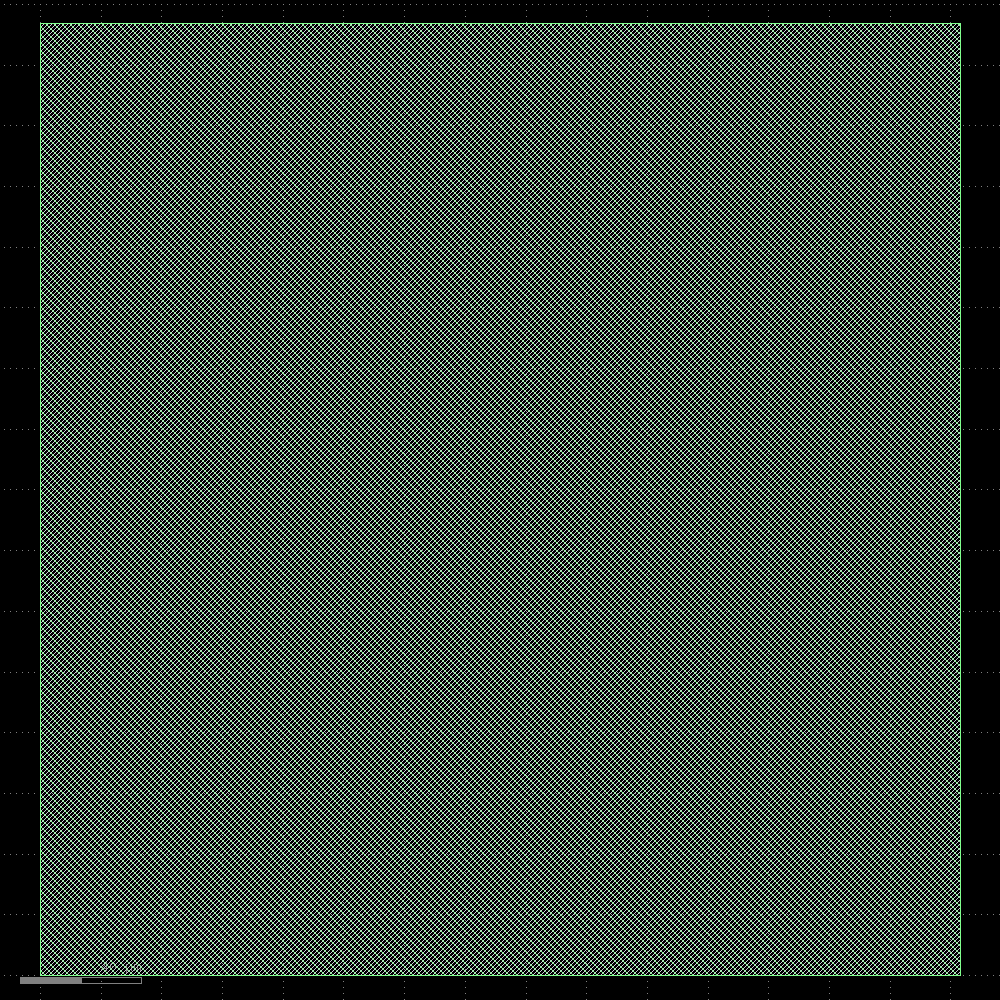

In [ ]:
# @title Floorplanning
Floorplan = Step.factory.get("OpenROAD.Floorplan")

floorplan = Floorplan(state_in=synthesis.state_out)
floorplan.start()
display(floorplan)

─────────────────────────────────────────────── Tap/Decap Insertion ───────────────────────────────────────────────

[21:03:59] VERBOSE  Running 'OpenROAD.TapEndcapInsertion'… (Log:                                       ]8;id=546876;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=963683;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=982886;file:///content/openlane_run/29-openroad-tapendcapinsertion/openroad-tapendcapinsertion.log\.]8;;\]8;id=1678;file:///content/openlane_run/29-openroad-tapendcapinsertion/openroad-tapendcapinsertion.log\/openlane_run/29-openroad-tapendcapinsertion/]8;;\]8;id=116421;file:///content/openlane_run/29-openroad-tapendcapinsertion/openroad-tapendcapinsertion.log\openroad-tapendcapinsertion.log]8;;\)                 

Reading OpenROAD database at '/content/openlane_run/28-openroad-floorplan/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO TAP-0004] Inserted 214 endcaps.

[INFO TAP-0005] Inserted 1199 tapcells.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/29-openroad-tapendcapinsertion/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/29-openroad-tapendcapinsertion/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/29-openroad-tapendcapinsertion/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/29-openroad-tapendcapinsertion/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/29-openroad-tapendcapinsertion/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:04:01] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=892080;file:///tmp/tmpn1uwp522/klayout-render.log\/tmp/tmpn1uwp522/]8;;\]8;id=864541;file:///tmp/tmpn1uwp522/klayout-render.log\klayout-render.log]8;;\)               ]8;id=907094;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=413810;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 1.73s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
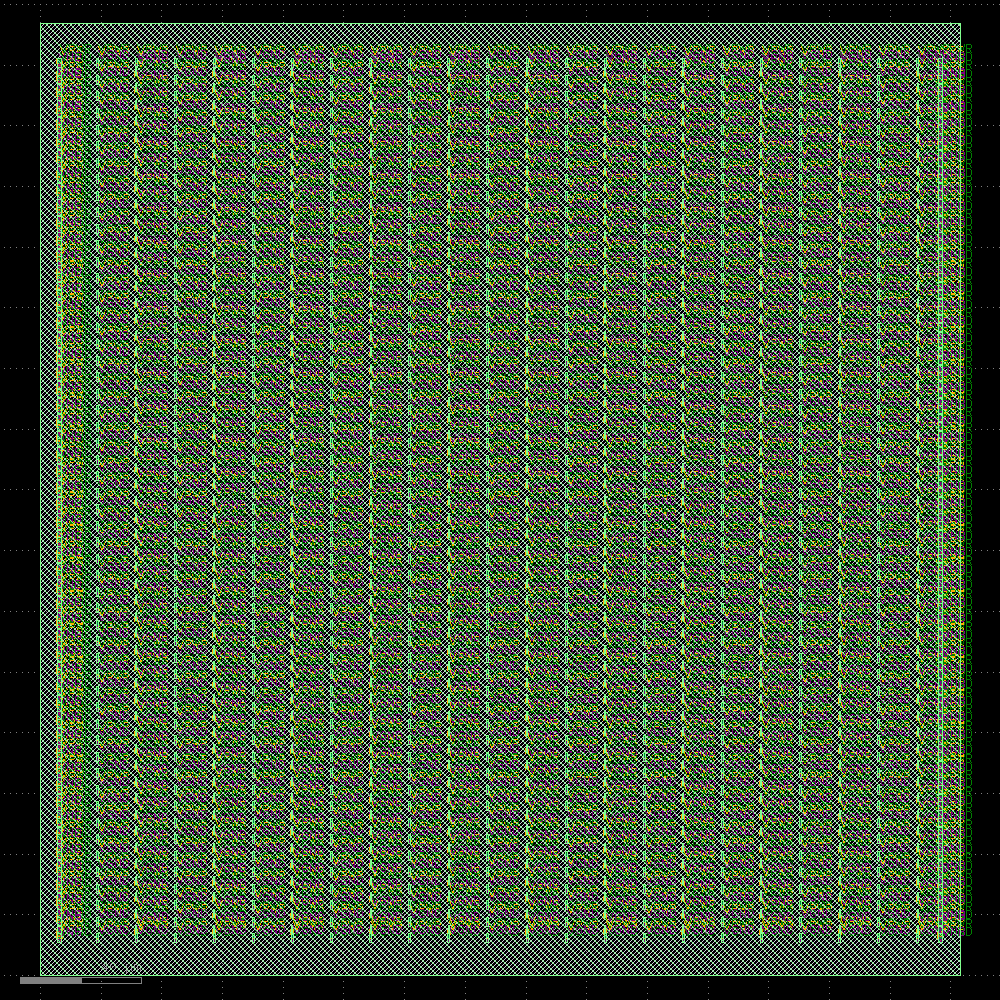

In [ ]:
# @title Tap/Endcap Cell Insertion

TapEndcapInsertion = Step.factory.get("OpenROAD.TapEndcapInsertion")

tdi = TapEndcapInsertion(state_in=floorplan.state_out)
tdi.start()
display(tdi)

────────────────────────────────────────────────── I/O Placement ──────────────────────────────────────────────────

[21:04:03] VERBOSE  Running 'OpenROAD.IOPlacement'… (Log:                                              ]8;id=864686;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=670734;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=547575;file:///content/openlane_run/30-openroad-ioplacement/openroad-ioplacement.log\.]8;;\]8;id=29862;file:///content/openlane_run/30-openroad-ioplacement/openroad-ioplacement.log\/openlane_run/30-openroad-ioplacement/]8;;\]8;id=35038;file:///content/openlane_run/30-openroad-ioplacement/openroad-ioplacement.log\openroad-ioplacement.log]8;;\)                               

Reading OpenROAD database at '/content/openlane_run/29-openroad-tapendcapinsertion/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] place_pins args: -min_distance 3

Found 0 macro blocks.

[INFO PPL-0010] Tentative 0 to set up sections.

[INFO PPL-0001] Number of slots           376

[INFO PPL-0002] Number of I/O             119

[INFO PPL-0003] Number of I/O w/sink      119

[INFO PPL-0004] Number of I/O w/o sink    0

[INFO PPL-0005] Slots per section         200

[INFO PPL-0006] Slots increase factor     0.01

[INFO PPL-0008] Successfully assigned pins to sections.

[INFO PPL-0012] I/O nets HPWL: 25960.29 um.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/30-openroad-ioplacement/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/30-openroad-ioplacement/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/30-openroad-ioplacement/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/30-openroad-ioplacement/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/30-openroad-ioplacement/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:04:04] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=644869;file:///tmp/tmpgaq9zoel/klayout-render.log\/tmp/tmpgaq9zoel/]8;;\]8;id=697710;file:///tmp/tmpgaq9zoel/klayout-render.log\klayout-render.log]8;;\)               ]8;id=446697;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=632468;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 1.64s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
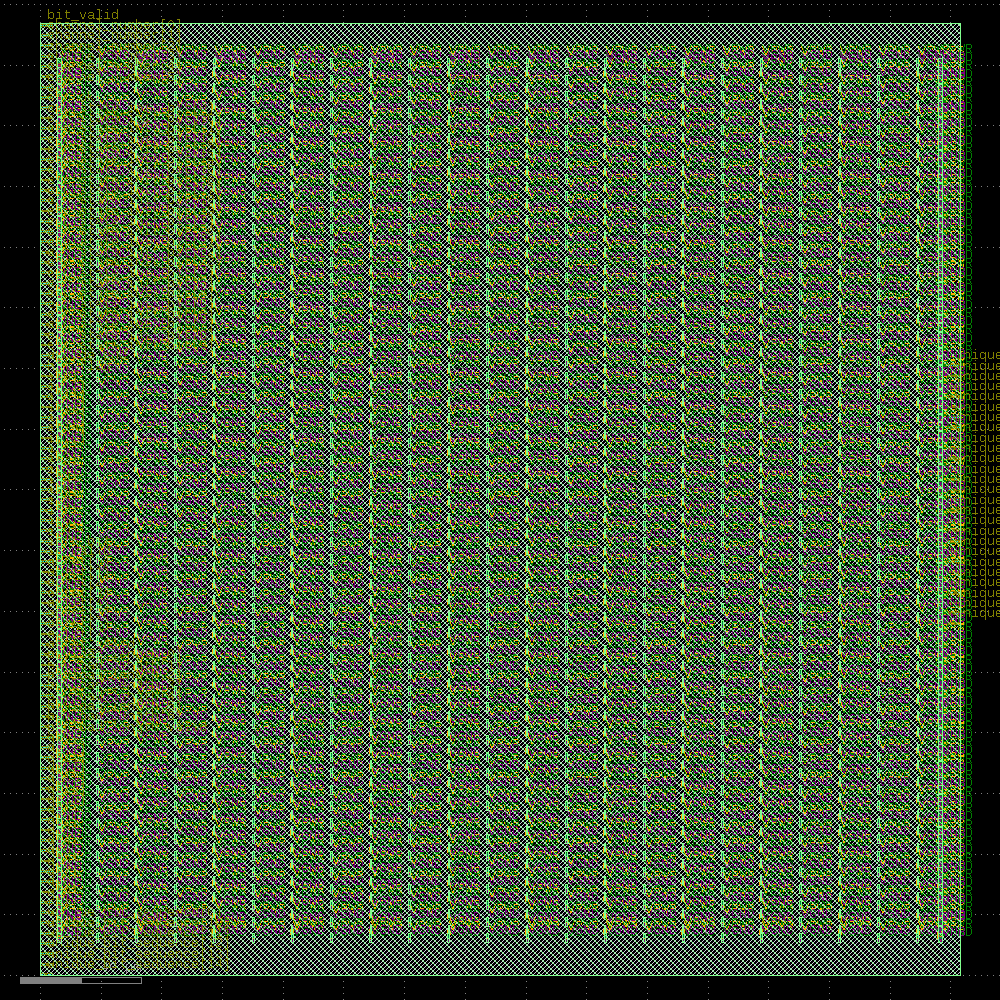

In [ ]:
# @title I/O Placement
IOPlacement = Step.factory.get("OpenROAD.IOPlacement")

ioplace = IOPlacement(state_in=tdi.state_out)
ioplace.start()
display(ioplace)

────────────────────────────────────── Power Distribution Network Generation ──────────────────────────────────────

[21:04:06] VERBOSE  Running 'OpenROAD.GeneratePDN'… (Log:                                              ]8;id=403083;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=842632;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=597911;file:///content/openlane_run/31-openroad-generatepdn/openroad-generatepdn.log\.]8;;\]8;id=91653;file:///content/openlane_run/31-openroad-generatepdn/openroad-generatepdn.log\/openlane_run/31-openroad-generatepdn/]8;;\]8;id=616791;file:///content/openlane_run/31-openroad-generatepdn/openroad-generatepdn.log\openroad-generatepdn.log]8;;\)                               

[21:04:06] INFO     'FP_PDN_CFG' not explicitly set, setting it to                                 ]8;id=72447;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=166202;file:///content/openlane_ipynb/openlane/steps/openroad.py#1085\1085]8;;\
                    /content/openlane_ipynb/openlane/scripts/openroad/common/pdn_cfg.tcl…                          

Reading OpenROAD database at '/content/openlane_run/30-openroad-ioplacement/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting global connections...

[INFO PDN-0001] Inserting grid: stdcell_grid

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/31-openroad-generatepdn/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/31-openroad-generatepdn/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/31-openroad-generatepdn/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/31-openroad-generatepdn/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/31-openroad-generatepdn/btle_rx_core.sdc'…

[INFO PSM-0076] Setting metal node density to be standard cell height times 5.

[INFO PSM-0031] Number of PDN nodes on net VPWR = 4614.

[INFO PSM-0064] Number of voltage sources = 240.

[INFO PSM-0040] All PDN stripes on net VPWR are connected.

[INFO PSM-0076] Setting metal node density to be standard cell height times 5.

[INFO PSM-0031] Number of PDN nodes on net VGND = 4614.

[INFO PSM-0064] Number of voltage sources = 240.

[INFO PSM-0040] All PDN stripes on net VGND are connected.

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:04:08] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=326679;file:///tmp/tmp272njkll/klayout-render.log\/tmp/tmp272njkll/]8;;\]8;id=630326;file:///tmp/tmp272njkll/klayout-render.log\klayout-render.log]8;;\)               ]8;id=122058;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=490803;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 2.35s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
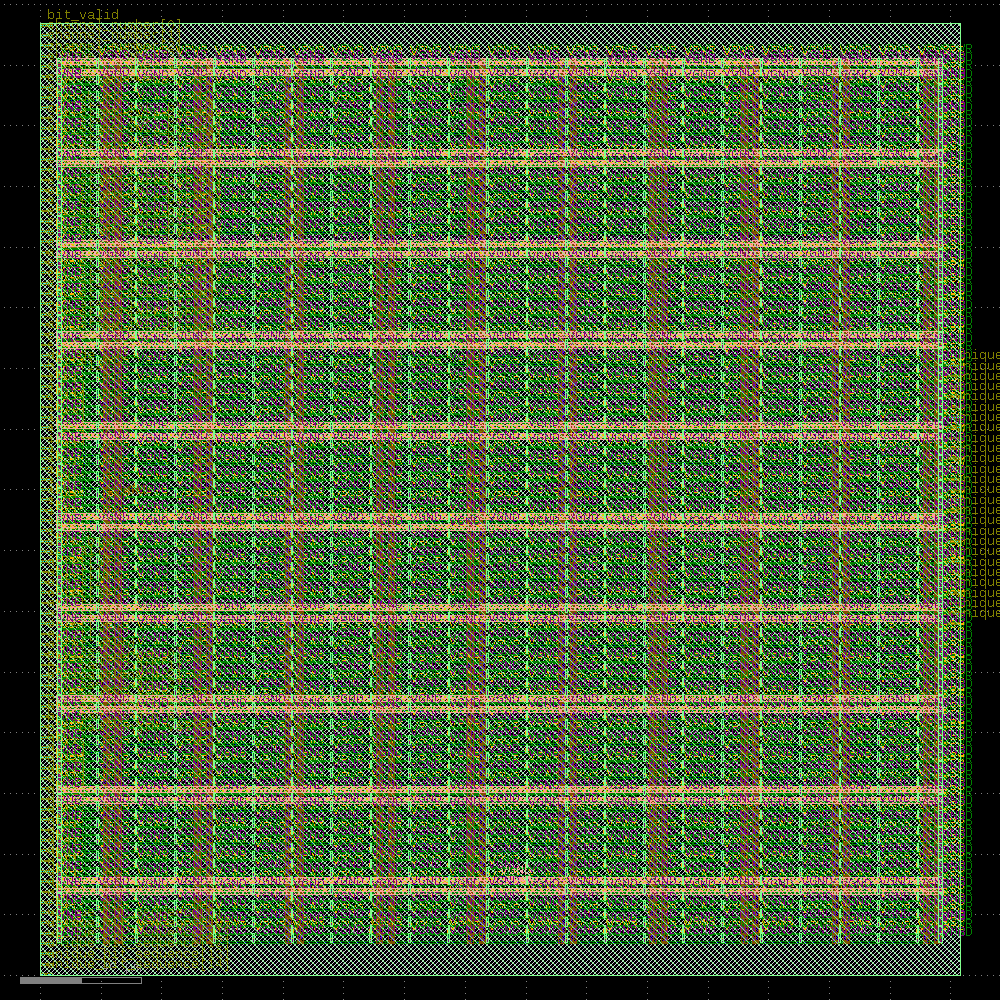

In [ ]:
# @title Generating the Power Distribution Network (PDN)
GeneratePDN = Step.factory.get("OpenROAD.GeneratePDN")

pdn = GeneratePDN(
    state_in=ioplace.state_out,
    FP_PDN_VWIDTH=2,
    FP_PDN_HWIDTH=2,
    FP_PDN_VPITCH=30,
    FP_PDN_HPITCH=30,
)
pdn.start()

display(pdn)

──────────────────────────────────────────────── Global Placement ─────────────────────────────────────────────────

[21:04:10] VERBOSE  Running 'OpenROAD.GlobalPlacement'… (Log:                                          ]8;id=546199;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=55750;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=203183;file:///content/openlane_run/32-openroad-globalplacement/openroad-globalplacement.log\.]8;;\]8;id=763085;file:///content/openlane_run/32-openroad-globalplacement/openroad-globalplacement.log\/openlane_run/32-openroad-globalplacement/]8;;\]8;id=174556;file:///content/openlane_run/32-openroad-globalplacement/openroad-globalplacement.log\openroad-globalplacement.log]8;;\)                       

[21:04:10] INFO     'PL_TARGET_DENSITY_PCT' not explicitly set, using dynamically calculated       ]8;id=574395;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=711749;file:///content/openlane_ipynb/openlane/steps/openroad.py#1172\1172]8;;\
                    target density: 62.02100…                                                                      

Reading OpenROAD database at '/content/openlane_run/31-openroad-generatepdn/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting RC values…

[INFO] Setting signal min routing layer to: met1 and clock min routing layer to met1.

[INFO] Setting signal max routing layer to: met5 and clock max routing layer to met5.

{*}-density 0.62021 -timing_driven -routability_driven -pad_right 0 -pad_left 0 -init_wirelength_coef 0.25

[INFO GPL-0002] DBU: 1000

[INFO GPL-0003] SiteSize: 460 2720

[INFO GPL-0004] CoreAreaLxLy: 5520 10880

[INFO GPL-0005] CoreAreaUxUy: 297160 301920

[INFO GPL-0006] NumInstances: 5453

[INFO GPL-0007] NumPlaceInstances: 4040

[INFO GPL-0008] NumFixedInstances: 1413

[INFO GPL-0009] NumDummyInstances: 0

[INFO GPL-0010] NumNets: 4137

[INFO GPL-0011] NumPins: 14764

[INFO GPL-0012] DieAreaLxLy: 0 0

[INFO GPL-0013] DieAreaUxUy: 303105 313825

[INFO GPL-0014] CoreAreaLxLy: 5520 10880

[INFO GPL-0015] CoreAreaUxUy: 297160 301920

[INFO GPL-0016] CoreArea: 84878905600

[INFO GPL-0017] NonPlaceInstsArea: 2303459200

[INFO GPL-0018] PlaceInstsArea: 42654659200

[INFO GPL-0019] Util(%): 51.66

[INFO GPL-0020] StdInstsArea: 42654659200

[INFO GPL-0021] MacroInstsArea: 0

[InitialPlace]  Iter: 1 CG residual: 0.00457186 HPWL: 58171050

[InitialPlace]  Iter: 2 CG residual: 0.00646607 HPWL: 53818992

[InitialPlace]  Iter: 3 CG residual: 0.00201734 HPWL: 50038463

[InitialPlace]  Iter: 4 CG residual: 0.00136174 HPWL: 48278618

[InitialPlace]  Iter: 5 CG residual: 0.00049185 HPWL: 47120844

[InitialPlace]  Iter: 6 CG residual: 0.00018544 HPWL: 46427049

[InitialPlace]  Iter: 7 CG residual: 0.00007062 HPWL: 45931321

[InitialPlace]  Iter: 8 CG residual: 0.00006557 HPWL: 45677162

[InitialPlace]  Iter: 9 CG residual: 0.00001157 HPWL: 45519134

[InitialPlace]  Iter: 10 CG residual: 0.00001163 HPWL: 45451819

[InitialPlace]  Iter: 11 CG residual: 0.00000631 HPWL: 45408028

[INFO GPL-0031] FillerInit: NumGCells: 4873

[INFO GPL-0032] FillerInit: NumGNets: 4137

[INFO GPL-0033] FillerInit: NumGPins: 14764

[INFO GPL-0023] TargetDensity: 0.62

[INFO GPL-0024] AveragePlaceInstArea: 10558083

[INFO GPL-0025] IdealBinArea: 17023400

[INFO GPL-0026] IdealBinCnt: 4986

[INFO GPL-0027] TotalBinArea: 84878905600

[INFO GPL-0028] BinCnt: 64 64

[INFO GPL-0029] BinSize: 4557 4548

[INFO GPL-0030] NumBins: 4096

[NesterovSolve] Iter: 1 overflow: 0.972963 HPWL: 22264399

[NesterovSolve] Iter: 10 overflow: 0.937968 HPWL: 23891632

[NesterovSolve] Iter: 20 overflow: 0.933392 HPWL: 24482586

[NesterovSolve] Iter: 30 overflow: 0.933052 HPWL: 24585188

[NesterovSolve] Iter: 40 overflow: 0.932711 HPWL: 24614999

[NesterovSolve] Iter: 50 overflow: 0.932381 HPWL: 24602062

[NesterovSolve] Iter: 60 overflow: 0.931281 HPWL: 24601083

[NesterovSolve] Iter: 70 overflow: 0.930315 HPWL: 24602593

[NesterovSolve] Iter: 80 overflow: 0.930733 HPWL: 24635535

[NesterovSolve] Iter: 90 overflow: 0.929334 HPWL: 24710923

[NesterovSolve] Iter: 100 overflow: 0.929045 HPWL: 24809037

[NesterovSolve] Iter: 110 overflow: 0.929267 HPWL: 24921908

[NesterovSolve] Iter: 120 overflow: 0.927625 HPWL: 25049158

[NesterovSolve] Iter: 130 overflow: 0.927146 HPWL: 25228275

[NesterovSolve] Iter: 140 overflow: 0.926438 HPWL: 25530697

[NesterovSolve] Iter: 150 overflow: 0.925173 HPWL: 26011022

[NesterovSolve] Iter: 160 overflow: 0.922128 HPWL: 26748456

[NesterovSolve] Iter: 170 overflow: 0.917231 HPWL: 27818756

[NesterovSolve] Iter: 180 overflow: 0.910963 HPWL: 29303827

[NesterovSolve] Iter: 190 overflow: 0.903494 HPWL: 31255657

[NesterovSolve] Iter: 200 overflow: 0.891137 HPWL: 33762651

[NesterovSolve] Iter: 210 overflow: 0.875848 HPWL: 36792493

[NesterovSolve] Iter: 220 overflow: 0.855372 HPWL: 40288304

[NesterovSolve] Iter: 230 overflow: 0.829814 HPWL: 44114685

[NesterovSolve] Iter: 240 overflow: 0.796646 HPWL: 47947128

[INFO GPL-0100] worst slack 3.52e-08

[INFO GPL-0103] Weighted 413 nets.

[NesterovSolve] Iter: 250 overflow: 0.759949 HPWL: 51120595

[NesterovSolve] Iter: 260 overflow: 0.722538 HPWL: 54243421

[NesterovSolve] Iter: 270 overflow: 0.682838 HPWL: 56979923

[NesterovSolve] Iter: 280 overflow: 0.634291 HPWL: 59769078

[INFO GPL-0100] worst slack 3.51e-08

[INFO GPL-0103] Weighted 413 nets.

[NesterovSolve] Snapshot saved at iter = 287

[NesterovSolve] Iter: 290 overflow: 0.58657 HPWL: 61480505

[NesterovSolve] Iter: 300 overflow: 0.534505 HPWL: 62652597

[NesterovSolve] Iter: 310 overflow: 0.488091 HPWL: 64119295

[INFO GPL-0100] worst slack 3.51e-08

[INFO GPL-0103] Weighted 413 nets.

[NesterovSolve] Iter: 320 overflow: 0.43801 HPWL: 66067708

[NesterovSolve] Iter: 330 overflow: 0.402353 HPWL: 67469215

[NesterovSolve] Iter: 340 overflow: 0.372542 HPWL: 68164660

[NesterovSolve] Iter: 350 overflow: 0.337034 HPWL: 68496238

[NesterovSolve] Iter: 360 overflow: 0.308324 HPWL: 69067053

[INFO GPL-0100] worst slack 3.53e-08

[INFO GPL-0103] Weighted 413 nets.

[NesterovSolve] Iter: 370 overflow: 0.281379 HPWL: 69376060

[NesterovSolve] Iter: 380 overflow: 0.259703 HPWL: 69639286

[NesterovSolve] Iter: 390 overflow: 0.241273 HPWL: 69770394

[NesterovSolve] Iter: 400 overflow: 0.215353 HPWL: 69856000

[INFO GPL-0100] worst slack 3.53e-08

[INFO GPL-0103] Weighted 413 nets.

[INFO GPL-0075] Routability numCall: 1 inflationIterCnt: 1 bloatIterCnt: 0

[INFO GPL-0036] TileLxLy: 0 0

[INFO GPL-0037] TileSize: 6900 6900

[INFO GPL-0038] TileCnt: 43 45

[INFO GPL-0039] numRoutingLayers: 6

[INFO GPL-0040] NumTiles: 1935

[INFO GPL-0063] TotalRouteOverflowH2: 0

[INFO GPL-0064] TotalRouteOverflowV2: 0

[INFO GPL-0065] OverflowTileCnt2: 0

[INFO GPL-0066] 0.5%RC: 1

[INFO GPL-0067] 1.0%RC: 1

[INFO GPL-0068] 2.0%RC: 1

[INFO GPL-0069] 5.0%RC: 0.9791353333713417

[INFO GPL-0070] 0.5rcK: 1

[INFO GPL-0071] 1.0rcK: 1

[INFO GPL-0072] 2.0rcK: 0

[INFO GPL-0073] 5.0rcK: 0

[INFO GPL-0074] FinalRC: 1

[NesterovSolve] Iter: 410 overflow: 0.196247 HPWL: 70042295

[NesterovSolve] Iter: 420 overflow: 0.177923 HPWL: 70249400

[NesterovSolve] Iter: 430 overflow: 0.160087 HPWL: 70464807

[INFO GPL-0100] worst slack 3.53e-08

[INFO GPL-0103] Weighted 412 nets.

[NesterovSolve] Iter: 440 overflow: 0.143061 HPWL: 70662484

[NesterovSolve] Iter: 450 overflow: 0.128467 HPWL: 70932230

[NesterovSolve] Iter: 460 overflow: 0.112645 HPWL: 71246340

[NesterovSolve] Finished with Overflow: 0.099301

[INFO] Setting RC values…

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/32-openroad-globalplacement/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/32-openroad-globalplacement/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/32-openroad-globalplacement/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/32-openroad-globalplacement/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/32-openroad-globalplacement/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:04:37] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=775694;file:///tmp/tmpeugp1mio/klayout-render.log\/tmp/tmpeugp1mio/]8;;\]8;id=832274;file:///tmp/tmpeugp1mio/klayout-render.log\klayout-render.log]8;;\)               ]8;id=983070;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=238007;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 27.53s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
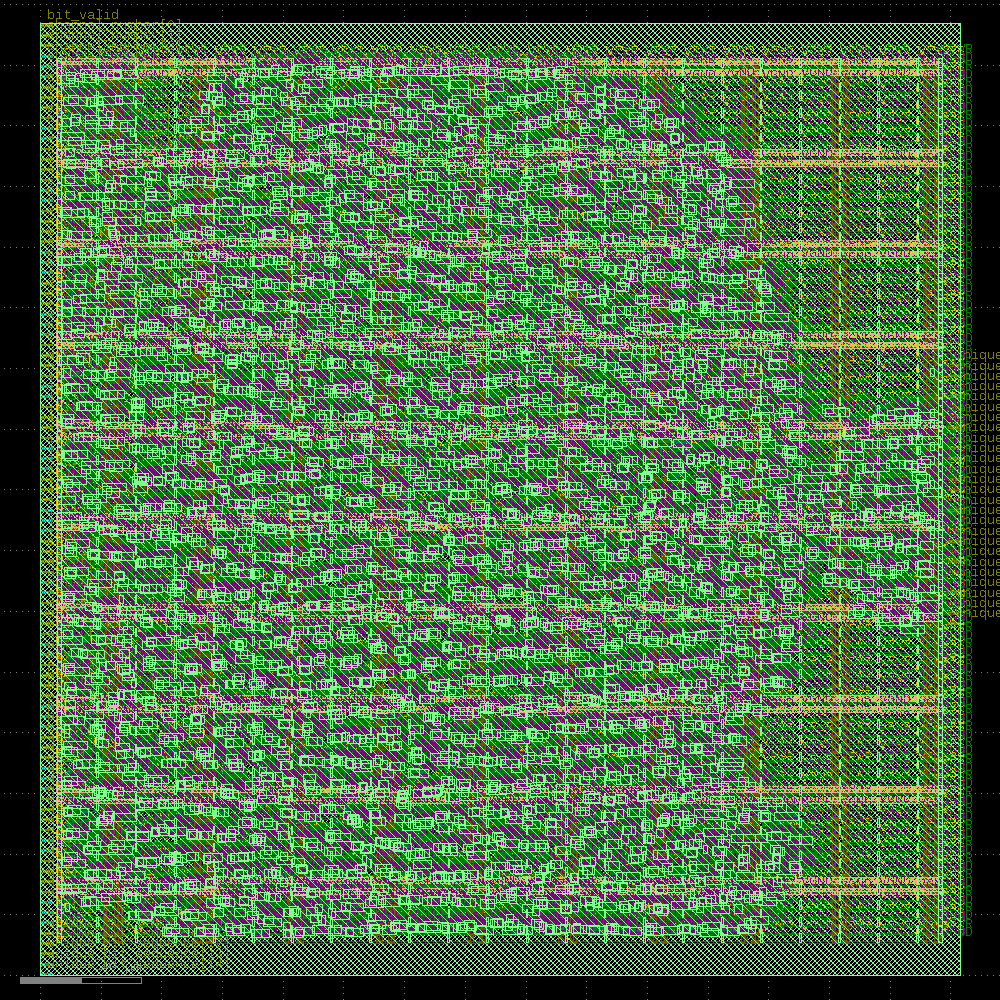

In [ ]:
# @title Global Placement
GlobalPlacement = Step.factory.get("OpenROAD.GlobalPlacement")

gpl = GlobalPlacement(state_in=pdn.state_out)
gpl.start()

display(gpl)

─────────────────────────────────────────────── Detailed Placement ────────────────────────────────────────────────

[21:04:39] VERBOSE  Running 'OpenROAD.DetailedPlacement'… (Log:                                        ]8;id=904717;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=242110;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=914651;file:///content/openlane_run/33-openroad-detailedplacement/openroad-detailedplacement.log\.]8;;\]8;id=119171;file:///content/openlane_run/33-openroad-detailedplacement/openroad-detailedplacement.log\/openlane_run/33-openroad-detailedplacement/]8;;\]8;id=192771;file:///content/openlane_run/33-openroad-detailedplacement/openroad-detailedplacement.log\openroad-detailedplacement.log]8;;\)                   

Reading OpenROAD database at '/content/openlane_run/32-openroad-globalplacement/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

Placement Analysis

---------------------------------

total displacement       9215.5 u

average displacement        1.7 u

max displacement            9.9 u

original HPWL           71509.5 u

legalized HPWL          82046.4 u

delta HPWL                   15 %

[INFO DPL-0020] Mirrored 1248 instances

[INFO DPL-0021] HPWL before           82046.4 u

[INFO DPL-0022] HPWL after            79801.7 u

[INFO DPL-0023] HPWL delta               -2.7 %

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/33-openroad-detailedplacement/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/33-openroad-detailedplacement/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/33-openroad-detailedplacement/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/33-openroad-detailedplacement/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/33-openroad-detailedplacement/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:04:41] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=514680;file:///tmp/tmpyeconsqc/klayout-render.log\/tmp/tmpyeconsqc/]8;;\]8;id=617237;file:///tmp/tmpyeconsqc/klayout-render.log\klayout-render.log]8;;\)               ]8;id=764964;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=984923;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 1.74s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
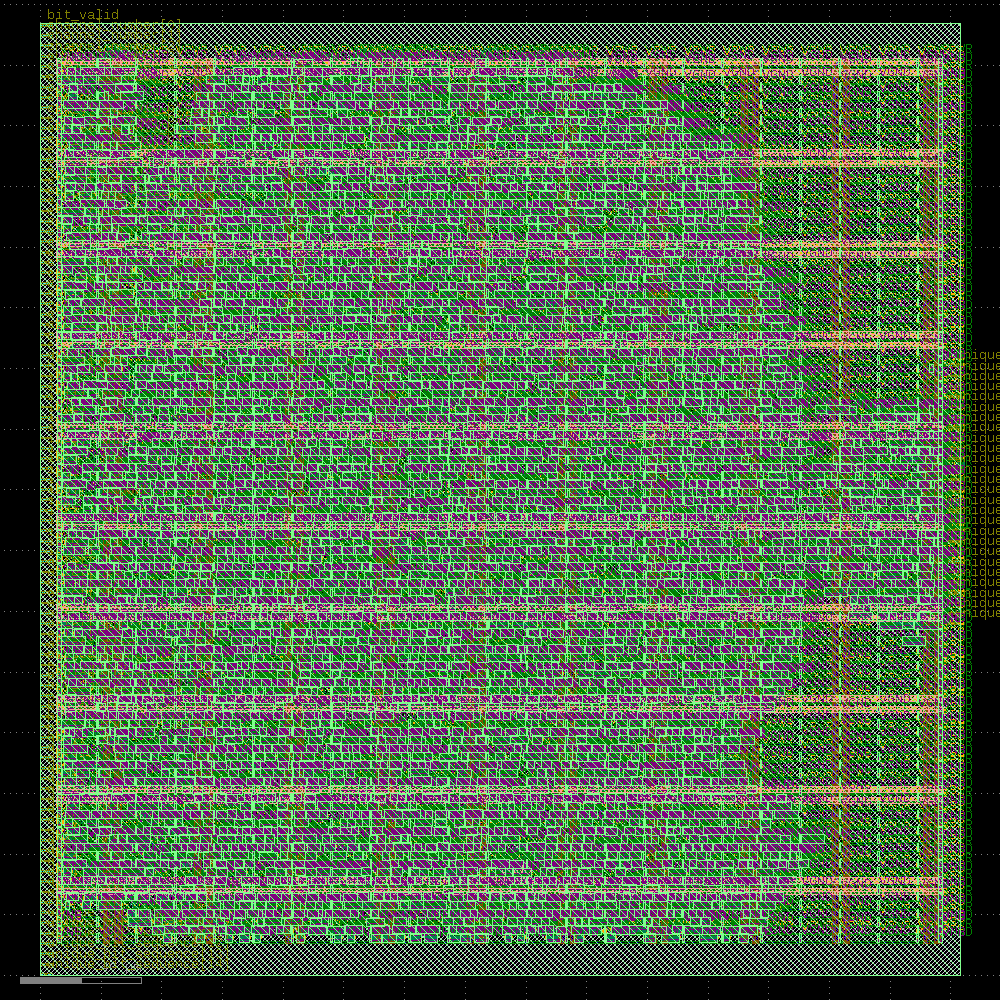

In [ ]:
# @title Detailed Placement
DetailedPlacement = Step.factory.get("OpenROAD.DetailedPlacement")

dpl = DetailedPlacement(state_in=gpl.state_out)
dpl.start()
display(dpl)

────────────────────────────────────────────── Clock Tree Synthesis ───────────────────────────────────────────────

[21:04:42] VERBOSE  Running 'OpenROAD.CTS'… (Log: ]8;id=825721;file:///content/openlane_run/34-openroad-cts/openroad-cts.log\.]8;;\]8;id=421860;file:///content/openlane_run/34-openroad-cts/openroad-cts.log\/openlane_run/34-openroad-cts/]8;;\]8;id=300424;file:///content/openlane_run/34-openroad-cts/openroad-cts.log\openroad-cts.log]8;;\)     ]8;id=796389;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=241435;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

Reading timing models for corner nom_tt_025C_1v80…

Reading timing library for the 'nom_tt_025C_1v80' corner at                                                        
'/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading timing models for corner nom_ff_n40C_1v95…

Reading timing library for the 'nom_ff_n40C_1v95' corner at                                                        
'/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ff_n40C_1v95.lib'…

Reading timing models for corner nom_ss_100C_1v60…

Reading timing library for the 'nom_ss_100C_1v60' corner at                                                        
'/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__ss_100C_1v60.lib'…

Reading OpenROAD database at '/content/openlane_run/33-openroad-detailedplacement/btle_rx_core.odb'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting RC values…

[INFO] Configuring cts characterization…

[INFO] Performing clock tree synthesis…

[INFO] Looking for the following net(s): clk

[INFO] Running Clock Tree Synthesis…

[INFO CTS-0050] Root buffer is sky130_fd_sc_hd__clkbuf_16.

[INFO CTS-0051] Sink buffer is sky130_fd_sc_hd__clkbuf_8.

[INFO CTS-0052] The following clock buffers will be used for CTS:

sky130_fd_sc_hd__clkbuf_2

sky130_fd_sc_hd__clkbuf_4

sky130_fd_sc_hd__clkbuf_8

[INFO CTS-0049] Characterization buffer is sky130_fd_sc_hd__clkbuf_8.

[INFO CTS-0007] Net "clk" found for clock "clk".

[INFO CTS-0010]  Clock net "clk" has 198 sinks.

[INFO CTS-0008] TritonCTS found 1 clock nets.

[INFO CTS-0097] Characterization used 3 buffer(s) types.

[INFO CTS-0200] 0 placement blockages have been identified.

[INFO CTS-0201] 0 placed hard macros will be treated like blockages.

[INFO CTS-0027] Generating H-Tree topology for net clk.

[INFO CTS-0028]  Total number of sinks: 198.

[INFO CTS-0029]  Sinks will be clustered in groups of up to 25 and with maximum cluster diameter of 50.0 um.

[INFO CTS-0030]  Number of static layers: 0.

[INFO CTS-0020]  Wire segment unit: 13600  dbu (13 um).

[INFO CTS-0023]  Original sink region: [(7165, 15020), (295515, 297900)].

[INFO CTS-0024]  Normalized sink region: [(0.526838, 1.10441), (21.729, 21.9044)].

[INFO CTS-0025]     Width:  21.2022.

[INFO CTS-0026]     Height: 20.8000.

Level 1

Direction: Horizontal

Sinks per sub-region: 99

Sub-region size: 10.6011 X 20.8000

[INFO CTS-0034]     Segment length (rounded): 6.

Level 2

Direction: Vertical

Sinks per sub-region: 50

Sub-region size: 10.6011 X 10.4000

[INFO CTS-0034]     Segment length (rounded): 6.

Level 3

Direction: Horizontal

Sinks per sub-region: 25

Sub-region size: 5.3006 X 10.4000

[INFO CTS-0034]     Segment length (rounded): 2.

Level 4

Direction: Vertical

Sinks per sub-region: 13

Sub-region size: 5.3006 X 5.2000

[INFO CTS-0034]     Segment length (rounded): 2.

[INFO CTS-0032]  Stop criterion found. Max number of sinks is 15.

[INFO CTS-0035]  Number of sinks covered: 198.

[INFO CTS-0018]     Created 17 clock buffers.

[INFO CTS-0012]     Minimum number of buffers in the clock path: 2.

[INFO CTS-0013]     Maximum number of buffers in the clock path: 2.

[INFO CTS-0015]     Created 17 clock nets.

[INFO CTS-0016]     Fanout distribution for the current clock = 6:1, 7:2, 8:1, 10:1, 11:1, 12:3, 13:1, 14:2, 15:1, 
16:1, 20:1, 21:1..

[INFO CTS-0017]     Max level of the clock tree: 4.

[INFO CTS-0098] Clock net "clk"

[INFO CTS-0099]  Sinks 198

[INFO CTS-0100]  Leaf buffers 0

[INFO CTS-0101]  Average sink wire length 487.24 um

[INFO CTS-0102]  Path depth 2 - 2

[INFO] Repairing long wires on clock nets…

[INFO RSZ-0058] Using max wire length 4459um.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/34-openroad-cts/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/34-openroad-cts/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/34-openroad-cts/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/34-openroad-cts/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/34-openroad-cts/btle_rx_core.sdc'…

[INFO] Legalizing…

Placement Analysis

---------------------------------

total displacement        103.2 u

average displacement        0.0 u

max displacement            8.3 u

original HPWL           81830.6 u

legalized HPWL          84141.6 u

delta HPWL                    3 %

[INFO DPL-0020] Mirrored 1251 instances

[INFO DPL-0021] HPWL before           84141.6 u

[INFO DPL-0022] HPWL after            81855.6 u

[INFO DPL-0023] HPWL delta               -2.7 %

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/34-openroad-cts/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/34-openroad-cts/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/34-openroad-cts/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/34-openroad-cts/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/34-openroad-cts/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:04:58] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=284016;file:///tmp/tmp046s0a_d/klayout-render.log\/tmp/tmp046s0a_d/]8;;\]8;id=819091;file:///tmp/tmp046s0a_d/klayout-render.log\klayout-render.log]8;;\)               ]8;id=555209;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=246554;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 15.87s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
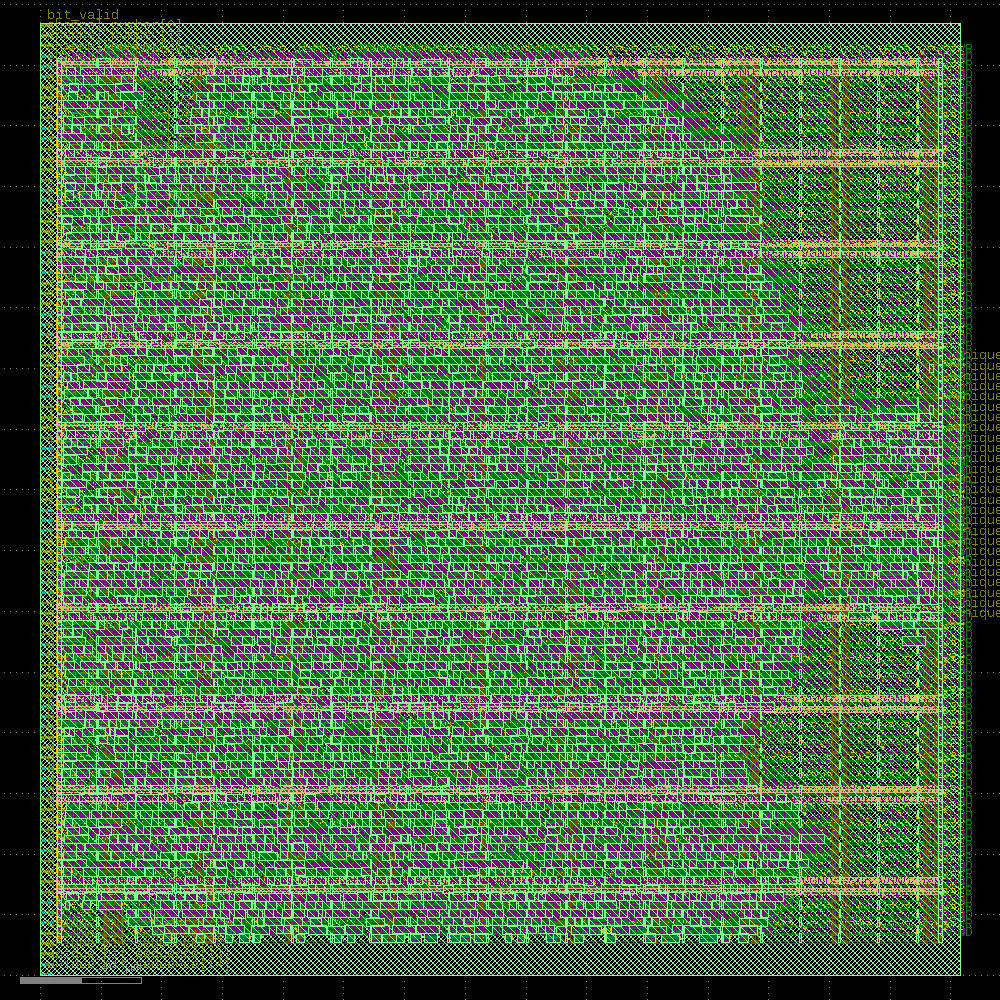

In [ ]:
# @title Clock Tree Synthesis (CTS)
CTS = Step.factory.get("OpenROAD.CTS")

cts = CTS(state_in=dpl.state_out)
cts.start()
display(cts)

In [ ]:
# @title Global Routing
GlobalRouting = Step.factory.get("OpenROAD.GlobalRouting")

grt = GlobalRouting(state_in=cts.state_out)
grt.start()

───────────────────────────────────────────────── Global Routing ──────────────────────────────────────────────────

[21:05:00] VERBOSE  Running 'OpenROAD.GlobalRouting'… (Log:                                            ]8;id=764073;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=889462;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=138338;file:///content/openlane_run/35-openroad-globalrouting/openroad-globalrouting.log\.]8;;\]8;id=378695;file:///content/openlane_run/35-openroad-globalrouting/openroad-globalrouting.log\/openlane_run/35-openroad-globalrouting/]8;;\]8;id=78729;file:///content/openlane_run/35-openroad-globalrouting/openroad-globalrouting.log\openroad-globalrouting.log]8;;\)                           

Reading OpenROAD database at '/content/openlane_run/34-openroad-cts/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO] Setting signal min routing layer to: met1 and clock min routing layer to met1.

[INFO] Setting signal max routing layer to: met5 and clock max routing layer to met5.

-congestion_iterations 50 -verbose

[INFO GRT-0020] Min routing layer: met1

[INFO GRT-0021] Max routing layer: met5

[INFO GRT-0022] Global adjustment: 30%

[INFO GRT-0023] Grid origin: (0, 0)

[INFO GRT-0043] No OR_DEFAULT vias defined.

[INFO GRT-0088] Layer li1     Track-Pitch = 0.4600  line-2-Via Pitch: 0.3400

[INFO GRT-0088] Layer met1    Track-Pitch = 0.3400  line-2-Via Pitch: 0.3400

[INFO GRT-0088] Layer met2    Track-Pitch = 0.4600  line-2-Via Pitch: 0.3500

[INFO GRT-0088] Layer met3    Track-Pitch = 0.6800  line-2-Via Pitch: 0.6150

[INFO GRT-0088] Layer met4    Track-Pitch = 0.9200  line-2-Via Pitch: 1.0400

[INFO GRT-0088] Layer met5    Track-Pitch = 3.4000  line-2-Via Pitch: 3.1100

[INFO GRT-0019] Found 18 clock nets.

[INFO GRT-0001] Minimum degree: 2

[INFO GRT-0002] Maximum degree: 124

[INFO GRT-0003] Macros: 0

[INFO GRT-0004] Blockages: 6347

[INFO GRT-0053] Routing resources analysis:

Routing      Original      Derated      Resource

Layer     Direction    Resources     Resources    Reduction (%)

---------------------------------------------------------------

li1        Vertical            0             0          0.00%

met1       Horizontal      39090         19045          51.28%

met2       Vertical        29640         19316          34.83%

met3       Horizontal      19545         12883          34.09%

met4       Vertical        11982          5856          51.13%

met5       Horizontal       3909          1638          58.10%

---------------------------------------------------------------

[INFO GRT-0101] Running extra iterations to remove overflow.

[INFO GRT-0197] Via related to pin nodes: 22527

[INFO GRT-0198] Via related Steiner nodes: 276

[INFO GRT-0199] Via filling finished.

[INFO GRT-0111] Final number of vias: 27722

[INFO GRT-0112] Final usage 3D: 96941

[INFO GRT-0096] Final congestion report:

Layer         Resource        Demand        Usage (%)    Max H / Max V / Total Overflow

---------------------------------------------------------------------------------------

li1                  0             0            0.00%             0 /  0 /  0

met1             19045          6611           34.71%             0 /  0 /  0

met2             19316          6428           33.28%             0 /  0 /  0

met3             12883           593            4.60%             0 /  0 /  0

met4              5856           143            2.44%             0 /  0 /  0

met5              1638             0            0.00%             0 /  0 /  0

---------------------------------------------------------------------------------------

Total            58738         13775           23.45%             0 /  0 /  0

[INFO GRT-0018] Total wirelength: 157099 um

[INFO GRT-0014] Routed nets: 4154

[INFO] Setting RC values…

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/35-openroad-globalrouting/btle_rx_core.odb'…

Writing layout to '/content/openlane_run/35-openroad-globalrouting/btle_rx_core.def'…

Format,Path
nl,openlane_run/34-openroad-cts/btle_rx_core.nl.v
pnl,openlane_run/34-openroad-cts/btle_rx_core.pnl.v
def,openlane_run/35-openroad-globalrouting/btle_rx_core.def
odb,openlane_run/35-openroad-globalrouting/btle_rx_core.odb
sdc,openlane_run/34-openroad-cts/btle_rx_core.sdc


──────────────────────────────────────────────── Detailed Routing ─────────────────────────────────────────────────

[21:05:04] VERBOSE  Running 'OpenROAD.DetailedRouting'… (Log:                                          ]8;id=991089;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=578708;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=324689;file:///content/openlane_run/36-openroad-detailedrouting/openroad-detailedrouting.log\.]8;;\]8;id=226522;file:///content/openlane_run/36-openroad-detailedrouting/openroad-detailedrouting.log\/openlane_run/36-openroad-detailedrouting/]8;;\]8;id=548819;file:///content/openlane_run/36-openroad-detailedrouting/openroad-detailedrouting.log\openroad-detailedrouting.log]8;;\)                       

[21:05:04] INFO     Running TritonRoute with 2 threads…                                            ]8;id=456385;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=777943;file:///content/openlane_ipynb/openlane/steps/openroad.py#1529\1529]8;;\

Reading OpenROAD database at '/content/openlane_run/35-openroad-globalrouting/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

[INFO ORD-0030] Using 2 thread(s).

[INFO DRT-0149] Reading tech and libs.

Units:                1000

Number of layers:     13

Number of macros:     441

Number of vias:       25

Number of viarulegen: 25

[INFO DRT-0150] Reading design.

Design:                   btle_rx_core

Die area:                 ( 0 0 ) ( 303105 313825 )

Number of track patterns: 12

Number of DEF vias:       0

Number of components:     5470

Number of terminals:      121

Number of snets:          2

Number of nets:           4154

[INFO DRT-0167] List of default vias:

Layer via

default via: M1M2_PR

Layer via2

default via: M2M3_PR

Layer via3

default via: M3M4_PR

Layer via4

default via: M4M5_PR

[INFO DRT-0162] Library cell analysis.

[INFO DRT-0163] Instance analysis.

[INFO DRT-0164] Number of unique instances = 206.

[INFO DRT-0168] Init region query.

[INFO DRT-0024]   Complete FR_MASTERSLICE.

[INFO DRT-0024]   Complete Fr_VIA.

[INFO DRT-0024]   Complete li1.

[INFO DRT-0024]   Complete mcon.

[INFO DRT-0024]   Complete met1.

[INFO DRT-0024]   Complete via.

[INFO DRT-0024]   Complete met2.

[INFO DRT-0024]   Complete via2.

[INFO DRT-0024]   Complete met3.

[INFO DRT-0024]   Complete via3.

[INFO DRT-0024]   Complete met4.

[INFO DRT-0024]   Complete via4.

[INFO DRT-0024]   Complete met5.

[INFO DRT-0033] FR_MASTERSLICE shape region query size = 0.

[INFO DRT-0033] FR_VIA shape region query size = 0.

[INFO DRT-0033] li1 shape region query size = 128131.

[INFO DRT-0033] mcon shape region query size = 74874.

[INFO DRT-0033] met1 shape region query size = 16992.

[INFO DRT-0033] via shape region query size = 6480.

[INFO DRT-0033] met2 shape region query size = 2160.

[INFO DRT-0033] via2 shape region query size = 5400.

[INFO DRT-0033] met3 shape region query size = 3359.

[INFO DRT-0033] via3 shape region query size = 5400.

[INFO DRT-0033] met4 shape region query size = 1320.

[INFO DRT-0033] via4 shape region query size = 200.

[INFO DRT-0033] met5 shape region query size = 240.

[INFO DRT-0165] Start pin access.

[INFO DRT-0076]   Complete 100 pins.

[INFO DRT-0076]   Complete 200 pins.

[INFO DRT-0076]   Complete 300 pins.

[INFO DRT-0076]   Complete 400 pins.

[INFO DRT-0076]   Complete 500 pins.

[INFO DRT-0076]   Complete 600 pins.

[INFO DRT-0076]   Complete 700 pins.

[INFO DRT-0076]   Complete 800 pins.

[INFO DRT-0078]   Complete 854 pins.

[INFO DRT-0079]   Complete 100 unique inst patterns.

[INFO DRT-0079]   Complete 200 unique inst patterns.

[INFO DRT-0081]   Complete 200 unique inst patterns.

[INFO DRT-0082]   Complete 1000 groups.

[INFO DRT-0082]   Complete 2000 groups.

[INFO DRT-0084]   Complete 2728 groups.

#scanned instances     = 5470

#unique  instances     = 206

#stdCellGenAp          = 5786

#stdCellValidPlanarAp  = 28

#stdCellValidViaAp     = 4560

#stdCellPinNoAp        = 0

#stdCellPinCnt         = 14679

#instTermValidViaApCnt = 0

#macroGenAp            = 0

#macroValidPlanarAp    = 0

#macroValidViaAp       = 0

#macroNoAp             = 0

[INFO DRT-0166] Complete pin access.

[INFO DRT-0267] cpu time = 00:01:48, elapsed time = 00:01:07, memory = 145.80 (MB), peak = 249.53 (MB)

Number of guides:     28701

[INFO DRT-0169] Post process guides.

[INFO DRT-0176] GCELLGRID X 0 DO 43 STEP 6900 ;

[INFO DRT-0177] GCELLGRID Y 0 DO 45 STEP 6900 ;

[INFO DRT-0026]   Complete 10000 origin guides.

[INFO DRT-0026]   Complete 20000 origin guides.

[INFO DRT-0028]   Complete FR_MASTERSLICE.

[INFO DRT-0028]   Complete Fr_VIA.

[INFO DRT-0028]   Complete li1.

[INFO DRT-0028]   Complete mcon.

[INFO DRT-0028]   Complete met1.

[INFO DRT-0028]   Complete via.

[INFO DRT-0028]   Complete met2.

[INFO DRT-0028]   Complete via2.

[INFO DRT-0028]   Complete met3.

[INFO DRT-0028]   Complete via3.

[INFO DRT-0028]   Complete met4.

[INFO DRT-0028]   Complete via4.

[INFO DRT-0028]   Complete met5.

[INFO DRT-0178] Init guide query.

[INFO DRT-0035]   Complete FR_MASTERSLICE (guide).

[INFO DRT-0035]   Complete Fr_VIA (guide).

[INFO DRT-0035]   Complete li1 (guide).

[INFO DRT-0035]   Complete mcon (guide).

[INFO DRT-0035]   Complete met1 (guide).

[INFO DRT-0035]   Complete via (guide).

[INFO DRT-0035]   Complete met2 (guide).

[INFO DRT-0035]   Complete via2 (guide).

[INFO DRT-0035]   Complete met3 (guide).

[INFO DRT-0035]   Complete via3 (guide).

[INFO DRT-0035]   Complete met4 (guide).

[INFO DRT-0035]   Complete via4 (guide).

[INFO DRT-0035]   Complete met5 (guide).

[INFO DRT-0036] FR_MASTERSLICE guide region query size = 0.

[INFO DRT-0036] FR_VIA guide region query size = 0.

[INFO DRT-0036] li1 guide region query size = 10397.

[INFO DRT-0036] mcon guide region query size = 0.

[INFO DRT-0036] met1 guide region query size = 7655.

[INFO DRT-0036] via guide region query size = 0.

[INFO DRT-0036] met2 guide region query size = 4109.

[INFO DRT-0036] via2 guide region query size = 0.

[INFO DRT-0036] met3 guide region query size = 191.

[INFO DRT-0036] via3 guide region query size = 0.

[INFO DRT-0036] met4 guide region query size = 22.

[INFO DRT-0036] via4 guide region query size = 0.

[INFO DRT-0036] met5 guide region query size = 0.

[INFO DRT-0179] Init gr pin query.

[INFO DRT-0245] skipped writing guide updates to database.

[INFO DRT-0185] Post process initialize RPin region query.

[INFO DRT-0181] Start track assignment.

[INFO DRT-0184] Done with 14528 vertical wires in 1 frboxes and 7846 horizontal wires in 1 frboxes.

[INFO DRT-0186] Done with 1522 vertical wires in 1 frboxes and 2108 horizontal wires in 1 frboxes.

[INFO DRT-0182] Complete track assignment.

[INFO DRT-0267] cpu time = 00:00:03, elapsed time = 00:00:02, memory = 196.57 (MB), peak = 249.53 (MB)

[INFO DRT-0187] Start routing data preparation.

[INFO DRT-0267] cpu time = 00:00:00, elapsed time = 00:00:00, memory = 196.57 (MB), peak = 249.53 (MB)

[INFO DRT-0194] Start detail routing.

[INFO DRT-0195] Start 0th optimization iteration.

Completing 10% with 0 violations.

elapsed time = 00:00:16, memory = 272.76 (MB).

Completing 20% with 0 violations.

elapsed time = 00:00:16, memory = 272.76 (MB).

Completing 30% with 0 violations.

elapsed time = 00:00:28, memory = 325.49 (MB).

Completing 40% with 342 violations.

elapsed time = 00:00:44, memory = 337.86 (MB).

Completing 50% with 342 violations.

elapsed time = 00:00:49, memory = 352.82 (MB).

Completing 60% with 782 violations.

elapsed time = 00:01:03, memory = 351.26 (MB).

Completing 70% with 782 violations.

elapsed time = 00:01:15, memory = 351.77 (MB).

Completing 80% with 782 violations.

elapsed time = 00:01:35, memory = 355.40 (MB).

Completing 90% with 1183 violations.

elapsed time = 00:01:50, memory = 355.66 (MB).

Completing 100% with 1571 violations.

elapsed time = 00:02:08, memory = 362.88 (MB).

[INFO DRT-0199]   Number of violations = 2194.

Viol/Layer         li1   mcon   met1   met2   met3   met4

Cut Spacing          0      5      0      0      0      0

Metal Spacing       51      0    419     60     14      0

Min Hole             0      0      2      0      0      0

NS Metal             0      0      1      0      0      0

Recheck              3      0    400    202     17      1

Short                0      0    889    130      0      0

[INFO DRT-0267] cpu time = 00:03:20, elapsed time = 00:02:09, memory = 655.75 (MB), peak = 655.75 (MB)

Total wire length = 100858 um.

Total wire length on LAYER li1 = 0 um.

Total wire length on LAYER met1 = 51023 um.

Total wire length on LAYER met2 = 43961 um.

Total wire length on LAYER met3 = 5019 um.

Total wire length on LAYER met4 = 853 um.

Total wire length on LAYER met5 = 0 um.

Total number of vias = 29145.

Up-via summary (total 29145):.

------------------------

FR_MASTERSLICE        0

li1    14480

met1    14383

met2      244

met3       38

met4        0

------------------------

29145

[INFO DRT-0195] Start 1st optimization iteration.

Completing 10% with 2194 violations.

elapsed time = 00:00:11, memory = 655.75 (MB).

Completing 20% with 2194 violations.

elapsed time = 00:00:12, memory = 655.75 (MB).

Completing 30% with 2194 violations.

elapsed time = 00:00:21, memory = 655.75 (MB).

Completing 40% with 1829 violations.

elapsed time = 00:00:43, memory = 655.75 (MB).

Completing 50% with 1829 violations.

elapsed time = 00:00:53, memory = 655.75 (MB).

Completing 60% with 1359 violations.

elapsed time = 00:01:02, memory = 655.75 (MB).

Completing 70% with 1359 violations.

elapsed time = 00:01:08, memory = 655.75 (MB).

Completing 80% with 1359 violations.

elapsed time = 00:01:22, memory = 655.75 (MB).

Completing 90% with 1034 violations.

elapsed time = 00:01:37, memory = 655.75 (MB).

Completing 100% with 708 violations.

elapsed time = 00:01:54, memory = 655.75 (MB).

[INFO DRT-0199]   Number of violations = 708.

Viol/Layer        met1   met2   met3

Metal Spacing      186     42     10

Short              393     77      0

[INFO DRT-0267] cpu time = 00:02:56, elapsed time = 00:01:55, memory = 658.70 (MB), peak = 658.70 (MB)

Total wire length = 99903 um.

Total wire length on LAYER li1 = 0 um.

Total wire length on LAYER met1 = 50573 um.

Total wire length on LAYER met2 = 43558 um.

Total wire length on LAYER met3 = 4986 um.

Total wire length on LAYER met4 = 785 um.

Total wire length on LAYER met5 = 0 um.

Total number of vias = 29087.

Up-via summary (total 29087):.

------------------------

FR_MASTERSLICE        0

li1    14453

met1    14347

met2      254

met3       33

met4        0

------------------------

29087

[INFO DRT-0195] Start 2nd optimization iteration.

Completing 10% with 708 violations.

elapsed time = 00:00:01, memory = 658.70 (MB).

Completing 20% with 708 violations.

elapsed time = 00:00:11, memory = 658.70 (MB).

Completing 30% with 713 violations.

elapsed time = 00:00:22, memory = 658.70 (MB).

Completing 40% with 713 violations.

elapsed time = 00:00:38, memory = 658.70 (MB).

Completing 50% with 713 violations.

elapsed time = 00:00:50, memory = 658.70 (MB).

Completing 60% with 754 violations.

elapsed time = 00:00:56, memory = 658.70 (MB).

Completing 70% with 754 violations.

elapsed time = 00:01:06, memory = 658.70 (MB).

Completing 80% with 778 violations.

elapsed time = 00:01:24, memory = 658.70 (MB).

Completing 90% with 778 violations.

elapsed time = 00:01:36, memory = 658.70 (MB).

Completing 100% with 776 violations.

elapsed time = 00:01:53, memory = 658.70 (MB).

[INFO DRT-0199]   Number of violations = 776.

Viol/Layer        met1   met2   met3

Metal Spacing      190     32     10

Short              480     64      0

[INFO DRT-0267] cpu time = 00:03:01, elapsed time = 00:01:54, memory = 658.70 (MB), peak = 658.70 (MB)

Total wire length = 99628 um.

Total wire length on LAYER li1 = 0 um.

Total wire length on LAYER met1 = 50369 um.

Total wire length on LAYER met2 = 43477 um.

Total wire length on LAYER met3 = 4961 um.

Total wire length on LAYER met4 = 820 um.

Total wire length on LAYER met5 = 0 um.

Total number of vias = 29133.

Up-via summary (total 29133):.

------------------------

FR_MASTERSLICE        0

li1    14452

met1    14406

met2      240

met3       35

met4        0

------------------------

29133

[INFO DRT-0195] Start 3rd optimization iteration.

Completing 10% with 776 violations.

elapsed time = 00:00:06, memory = 658.70 (MB).

Completing 20% with 776 violations.

elapsed time = 00:00:06, memory = 658.70 (MB).

Completing 30% with 776 violations.

elapsed time = 00:00:28, memory = 658.70 (MB).

Completing 40% with 624 violations.

elapsed time = 00:00:38, memory = 667.24 (MB).

Completing 50% with 624 violations.

elapsed time = 00:00:45, memory = 667.24 (MB).

Completing 60% with 412 violations.

elapsed time = 00:01:00, memory = 668.01 (MB).

Completing 70% with 412 violations.

elapsed time = 00:01:08, memory = 668.01 (MB).

Completing 80% with 412 violations.

elapsed time = 00:01:21, memory = 668.01 (MB).

Completing 90% with 231 violations.

elapsed time = 00:01:38, memory = 668.01 (MB).

Completing 100% with 72 violations.

elapsed time = 00:01:48, memory = 668.01 (MB).

[INFO DRT-0199]   Number of violations = 72.

Viol/Layer        met1   met2

Metal Spacing       29      4

Short               37      2

[INFO DRT-0267] cpu time = 00:02:46, elapsed time = 00:01:49, memory = 668.01 (MB), peak = 668.01 (MB)

Total wire length = 99659 um.

Total wire length on LAYER li1 = 0 um.

Total wire length on LAYER met1 = 49214 um.

Total wire length on LAYER met2 = 43593 um.

Total wire length on LAYER met3 = 5898 um.

Total wire length on LAYER met4 = 952 um.

Total wire length on LAYER met5 = 0 um.

Total number of vias = 29498.

Up-via summary (total 29498):.

------------------------

FR_MASTERSLICE        0

li1    14452

met1    14599

met2      400

met3       47

met4        0

------------------------

29498

[INFO DRT-0195] Start 4th optimization iteration.

Completing 10% with 72 violations.

elapsed time = 00:00:00, memory = 668.01 (MB).

Completing 20% with 72 violations.

elapsed time = 00:00:00, memory = 668.01 (MB).

Completing 30% with 72 violations.

elapsed time = 00:00:01, memory = 668.01 (MB).

Completing 40% with 61 violations.

elapsed time = 00:00:02, memory = 668.01 (MB).

Completing 50% with 61 violations.

elapsed time = 00:00:03, memory = 668.01 (MB).

Completing 60% with 48 violations.

elapsed time = 00:00:11, memory = 668.01 (MB).

Completing 70% with 48 violations.

elapsed time = 00:00:12, memory = 668.01 (MB).

Completing 80% with 48 violations.

elapsed time = 00:00:14, memory = 668.01 (MB).

Completing 90% with 19 violations.

elapsed time = 00:00:14, memory = 668.01 (MB).

Completing 100% with 10 violations.

elapsed time = 00:00:16, memory = 668.01 (MB).

[INFO DRT-0199]   Number of violations = 10.

Viol/Layer        met1

Metal Spacing        2

Short                8

[INFO DRT-0267] cpu time = 00:00:22, elapsed time = 00:00:16, memory = 668.01 (MB), peak = 668.01 (MB)

Total wire length = 99632 um.

Total wire length on LAYER li1 = 0 um.

Total wire length on LAYER met1 = 49102 um.

Total wire length on LAYER met2 = 43595 um.

Total wire length on LAYER met3 = 5973 um.

Total wire length on LAYER met4 = 961 um.

Total wire length on LAYER met5 = 0 um.

Total number of vias = 29522.

Up-via summary (total 29522):.

------------------------

FR_MASTERSLICE        0

li1    14452

met1    14612

met2      411

met3       47

met4        0

------------------------

29522

[INFO DRT-0195] Start 5th optimization iteration.

Completing 10% with 10 violations.

elapsed time = 00:00:00, memory = 668.01 (MB).

Completing 20% with 10 violations.

elapsed time = 00:00:00, memory = 668.01 (MB).

Completing 30% with 10 violations.

elapsed time = 00:00:00, memory = 668.01 (MB).

Completing 40% with 10 violations.

elapsed time = 00:00:00, memory = 668.01 (MB).

Completing 50% with 10 violations.

elapsed time = 00:00:00, memory = 668.01 (MB).

Completing 60% with 0 violations.

elapsed time = 00:00:01, memory = 668.01 (MB).

Completing 70% with 0 violations.

elapsed time = 00:00:01, memory = 668.01 (MB).

Completing 80% with 0 violations.

elapsed time = 00:00:01, memory = 668.01 (MB).

Completing 90% with 0 violations.

elapsed time = 00:00:01, memory = 668.01 (MB).

Completing 100% with 0 violations.

elapsed time = 00:00:01, memory = 668.01 (MB).

[INFO DRT-0199]   Number of violations = 0.

[INFO DRT-0267] cpu time = 00:00:01, elapsed time = 00:00:01, memory = 668.01 (MB), peak = 668.01 (MB)

Total wire length = 99631 um.

Total wire length on LAYER li1 = 0 um.

Total wire length on LAYER met1 = 49104 um.

Total wire length on LAYER met2 = 43592 um.

Total wire length on LAYER met3 = 5973 um.

Total wire length on LAYER met4 = 961 um.

Total wire length on LAYER met5 = 0 um.

Total number of vias = 29520.

Up-via summary (total 29520):.

------------------------

FR_MASTERSLICE        0

li1    14452

met1    14610

met2      411

met3       47

met4        0

------------------------

29520

[INFO DRT-0198] Complete detail routing.

Total wire length = 99631 um.

Total wire length on LAYER li1 = 0 um.

Total wire length on LAYER met1 = 49104 um.

Total wire length on LAYER met2 = 43592 um.

Total wire length on LAYER met3 = 5973 um.

Total wire length on LAYER met4 = 961 um.

Total wire length on LAYER met5 = 0 um.

Total number of vias = 29520.

Up-via summary (total 29520):.

------------------------

FR_MASTERSLICE        0

li1    14452

met1    14610

met2      411

met3       47

met4        0

------------------------

29520

[INFO DRT-0267] cpu time = 00:12:28, elapsed time = 00:08:07, memory = 668.01 (MB), peak = 668.01 (MB)

[INFO DRT-0180] Post processing.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/36-openroad-detailedrouting/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/36-openroad-detailedrouting/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/36-openroad-detailedrouting/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/36-openroad-detailedrouting/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/36-openroad-detailedrouting/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:14:25] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=297898;file:///tmp/tmpwu0dmcbh/klayout-render.log\/tmp/tmpwu0dmcbh/]8;;\]8;id=108641;file:///tmp/tmpwu0dmcbh/klayout-render.log\klayout-render.log]8;;\)               ]8;id=424641;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=801203;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 561.19s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
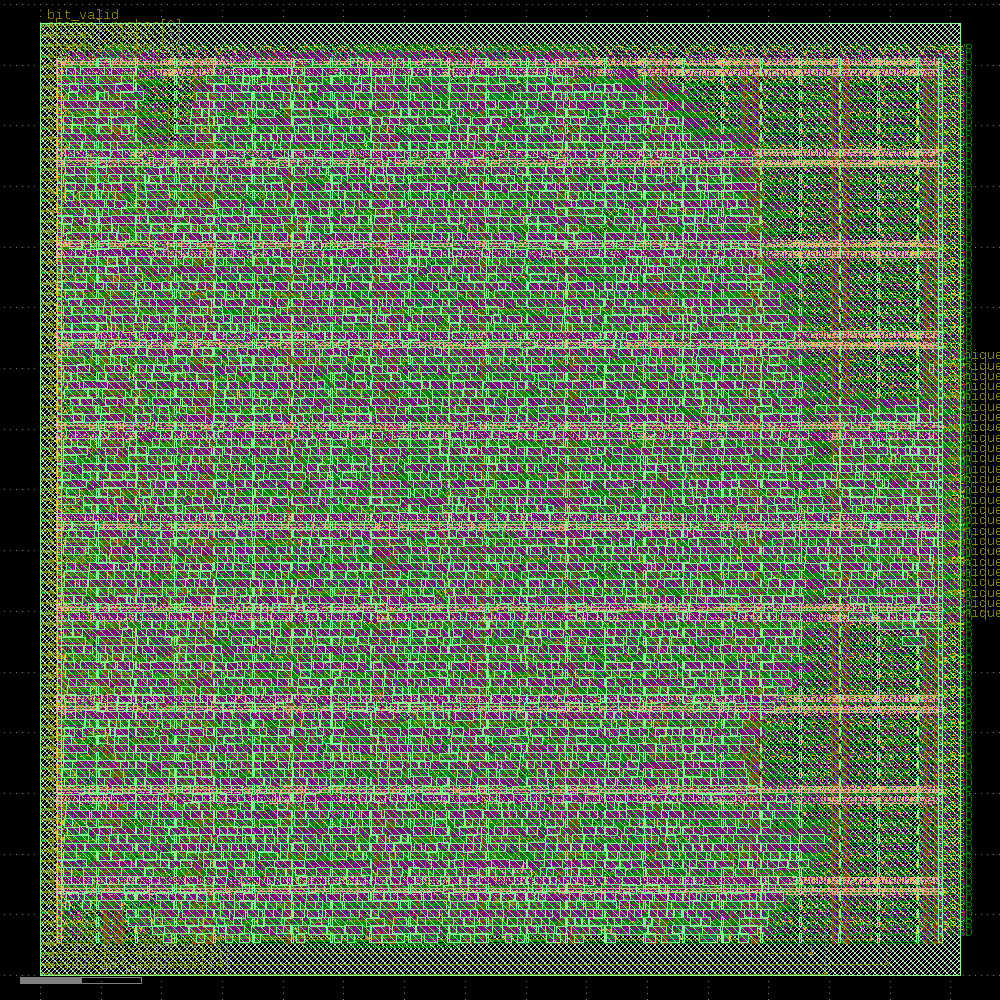

In [ ]:
# @title Detailed Routing
DetailedRouting = Step.factory.get("OpenROAD.DetailedRouting")

drt = DetailedRouting(state_in=grt.state_out)
drt.start()
display(drt)

───────────────────────────────────────────────── Fill Insertion ──────────────────────────────────────────────────

[21:14:29] VERBOSE  Running 'OpenROAD.FillInsertion'… (Log:                                            ]8;id=384032;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=43013;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=668162;file:///content/openlane_run/37-openroad-fillinsertion/openroad-fillinsertion.log\.]8;;\]8;id=68431;file:///content/openlane_run/37-openroad-fillinsertion/openroad-fillinsertion.log\/openlane_run/37-openroad-fillinsertion/]8;;\]8;id=231971;file:///content/openlane_run/37-openroad-fillinsertion/openroad-fillinsertion.log\openroad-fillinsertion.log]8;;\)                           

Reading OpenROAD database at '/content/openlane_run/36-openroad-detailedrouting/btle_rx_core.odb'…

Reading library file at '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lib/sky130_fd_sc_hd__tt_025C_1v80.lib'…

Reading design constraints file at '/content/openlane_ipynb/openlane/scripts/base.sdc'…

[INFO] Using clock clk…

[INFO] Setting output delay to: 12.5

[INFO] Setting input delay to: 12.5

[INFO] Setting load to: 0.033442

[INFO] Setting clock uncertainty to: 0.25

[INFO] Setting clock transition to: 0.1499999999999999944488848768742172978818416595458984375

[INFO] Setting timing derate to: 5%

sky130_ef_sc_hd__decap_12 sky130_fd_sc_hd__decap_8 sky130_fd_sc_hd__decap_6 sky130_fd_sc_hd__decap_4               
sky130_fd_sc_hd__decap_3 sky130_fd_sc_hd__fill*

[INFO DPL-0001] Placed 5625 filler instances.

Setting global connections for newly added cells…

[INFO] Setting global connections...

Writing OpenROAD database to '/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.odb'…

Writing netlist to '/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.nl.v'…

Writing powered netlist to '/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.pnl.v'…

Writing layout to '/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.def'…

Writing timing constraints to '/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.sdc'…

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:14:31] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=485383;file:///tmp/tmpghowx0nm/klayout-render.log\/tmp/tmpghowx0nm/]8;;\]8;id=935000;file:///tmp/tmpghowx0nm/klayout-render.log\klayout-render.log]8;;\)               ]8;id=282568;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=659369;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 2.04s
#### Views updated:
* Verilog Netlist
* Powered Verilog Netlist
* Design Exchange Format
* OpenDB Database
* Design Constraints
#### Preview:
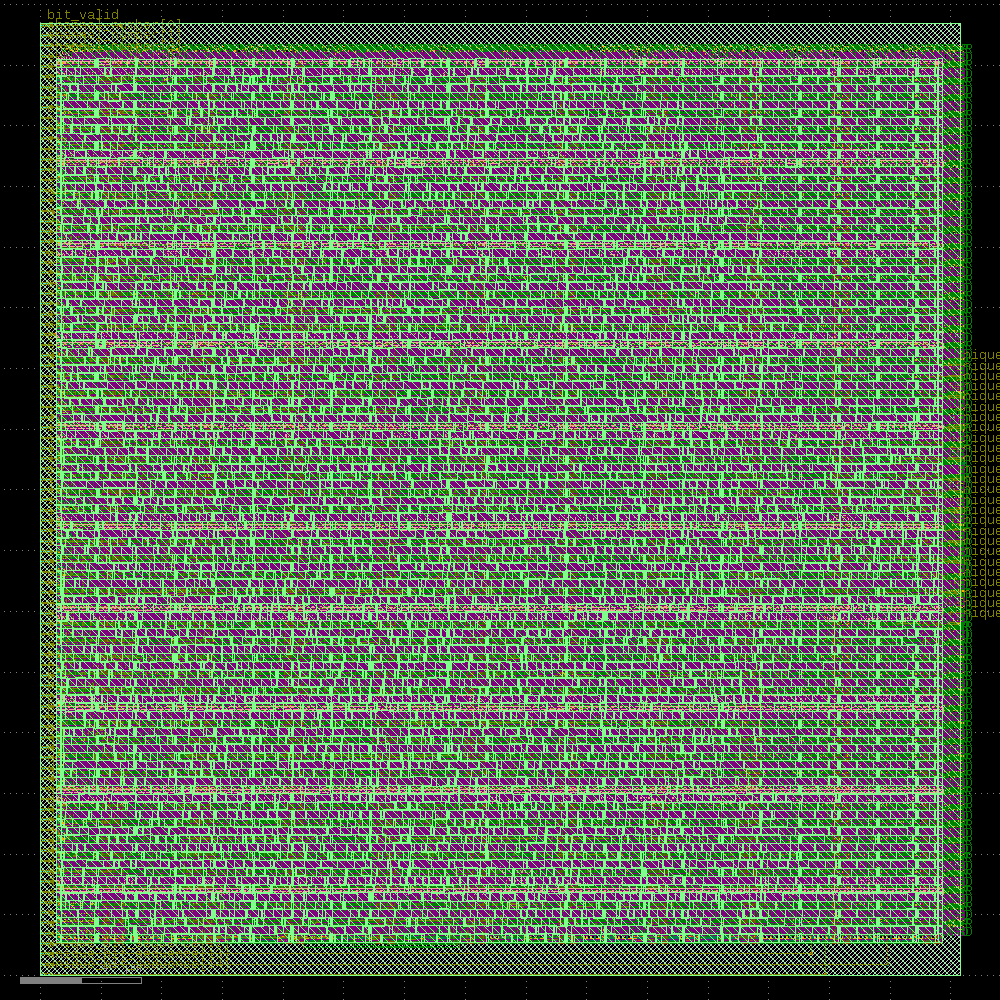

In [ ]:
# @title Fill Insertion
FillInsertion = Step.factory.get("OpenROAD.FillInsertion")

fill = FillInsertion(state_in=drt.state_out)
fill.start()
display(fill)

In [ ]:
# @title Parasitics Extraction a.k.a. Resistance/Capacitance Extraction (RCX)
RCX = Step.factory.get("OpenROAD.RCX")

rcx = RCX(state_in=fill.state_out)
rcx.start()

─────────────────────────────────── Parasitic Resistance/Capacitance Extraction ───────────────────────────────────

[21:14:33] VERBOSE  Running 'OpenROAD.RCX'… (Log: ]8;id=615611;file:///content/openlane_run/38-openroad-rcx/openroad-rcx.log\.]8;;\]8;id=508858;file:///content/openlane_run/38-openroad-rcx/openroad-rcx.log\/openlane_run/38-openroad-rcx/]8;;\]8;id=353483;file:///content/openlane_run/38-openroad-rcx/openroad-rcx.log\openroad-rcx.log]8;;\)     ]8;id=21937;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=697601;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

[21:14:33] INFO     Running RCX for corners matching nom_*                                         ]8;id=219565;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=955123;file:///content/openlane_ipynb/openlane/steps/openroad.py#1653\1653]8;;\
                    (/content/openlane_run/38-openroad-rcx/nom/rcx.log)…                                           

[21:14:33] INFO     Running RCX for corners matching min_*                                         ]8;id=633855;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=79460;file:///content/openlane_ipynb/openlane/steps/openroad.py#1653\1653]8;;\
                    (/content/openlane_run/38-openroad-rcx/min/rcx.log)…                                           

[21:14:37] INFO     Finished RCX for corners matching nom_*.                                       ]8;id=629401;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=107159;file:///content/openlane_ipynb/openlane/steps/openroad.py#1662\1662]8;;\

[21:14:37] INFO     Finished RCX for corners matching min_*.                                       ]8;id=322879;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=273299;file:///content/openlane_ipynb/openlane/steps/openroad.py#1662\1662]8;;\

[21:14:37] INFO     Running RCX for corners matching max_*                                         ]8;id=715860;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=994508;file:///content/openlane_ipynb/openlane/steps/openroad.py#1653\1653]8;;\
                    (/content/openlane_run/38-openroad-rcx/max/rcx.log)…                                           

[21:14:40] INFO     Finished RCX for corners matching max_*.                                       ]8;id=834435;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=103085;file:///content/openlane_ipynb/openlane/steps/openroad.py#1662\1662]8;;\

{'nl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.nl.v'), 'pnl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.pnl.v'), 'pnl-sdf-friendly': None, 'pnl-npc': None, 'def': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.def'), 'lef': None, 'openroad-lef': None, 'odb': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.odb'), 'sdc': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.sdc'), 'sdf': None, 'spef': {'nom_*': Path('/content/openlane_run/38-openroad-rcx/nom/btle_rx_core.nom.spef'), 'min_*': Path('/content/openlane_run/38-openroad-rcx/min/btle_rx_core.min.spef'), 'max_*': Path('/content/openlane_run/38-openroad-rcx/max/btle_rx_core.max.spef')}, 'lib': None, 'spice': None, 'mag': None, 'gds': None, 'mag_gds': None, 'klayout_gds': None, 'json_h': None, 'vh': None, 'metrics': {'design__instance__count': 5256, 'design__instance__area': Decimal('44400.1'), 'design__instance_unmapped__count': 0, 'synthesis__check_error__count': 0, 'design__die__bbox': '0.0 0.0 303.105 313.825', 'design__core__bbox': '5.52 10.88 297.16 301.92', 'design__io': 121, 'design__die__area': Decimal('95121.9'), 'design__core__area': Decimal('84878.9'), 'design__instance__count__stdcell': 5256, 'design__instance__area__stdcell': Decimal('44400.1'), 'design__instance__count__macros': 0, 'design__instance__area__macros': 0, 'design__instance__utilization': Decimal('0.523099'), 'design__instance__utilization__stdcell': Decimal('0.523099'), 'floorplan__design__io': 119, 'design__io__hpwl': 25960286, 'design__power_grid_violation__count__net:VGND': 0, 'design__power_grid_violation__count__net:VPWR': 0, 'design__power_grid_violation__count': 0, 'design__instance__displacement__total': Decimal('103.236'), 'design__instance__displacement__mean': Decimal('0.018'), 'design__instance__displacement__max': Decimal('8.273'), 'route__wirelength__estimated': Decimal('84141.6'), 'design__violations': 0, 'antenna__violating__nets': 9, 'antenna__violating__pins': 10, 'route__net': 4154, 'route__net__special': 2, 'route__drc_errors__iter:1': 2194, 'route__wirelength__iter:1': 100858, 'route__drc_errors__iter:2': 708, 'route__wirelength__iter:2': 99903, 'route__drc_errors__iter:3': 776, 'route__wirelength__iter:3': 99628, 'route__drc_errors__iter:4': 72, 'route__wirelength__iter:4': 99659, 'route__drc_errors__iter:5': 10, 'route__wirelength__iter:5': 99632, 'route__drc_errors__iter:6': 0, 'route__wirelength__iter:6': 99631, 'route__drc_errors': 0, 'route__wirelength': 99631, 'route__vias': 29520, 'route__vias__singlecut': 29520, 'route__vias__multicut': 0}}

─────────────────────────────────────────── GDSII Stream Out (KLayout) ────────────────────────────────────────────

[21:14:40] VERBOSE  Running 'KLayout.StreamOut'… (Log:                                                 ]8;id=37916;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=17994;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=320796;file:///content/openlane_run/39-klayout-streamout/klayout-streamout.log\.]8;;\]8;id=767606;file:///content/openlane_run/39-klayout-streamout/klayout-streamout.log\/openlane_run/39-klayout-streamout/]8;;\]8;id=808180;file:///content/openlane_run/39-klayout-streamout/klayout-streamout.log\klayout-streamout.log]8;;\)                                     

[INFO] Clearing cells…

[INFO] Merging GDS files…

[INFO] Copying top level cell 'btle_rx_core'…

[INFO] Checking for missing GDS…

[INFO] All LEF cells have matching GDS cells.

[INFO] Writing out GDS '/content/openlane_run/39-klayout-streamout/btle_rx_core.klayout.gds'…

[INFO] Done.

──────────────────────────────────────────── Render Image (w/ KLayout) ────────────────────────────────────────────

[21:14:42] VERBOSE  Running 'KLayout.Render'… (Log: ]8;id=721459;file:///tmp/tmplmqwiz_h/klayout-render.log\/tmp/tmplmqwiz_h/]8;;\]8;id=978180;file:///tmp/tmplmqwiz_h/klayout-render.log\klayout-render.log]8;;\)               ]8;id=67192;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=868841;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

#### Time Elapsed: 2.15s
#### Views updated:
* GDSII Stream
* GDSII Stream (KLayout)
#### Preview:
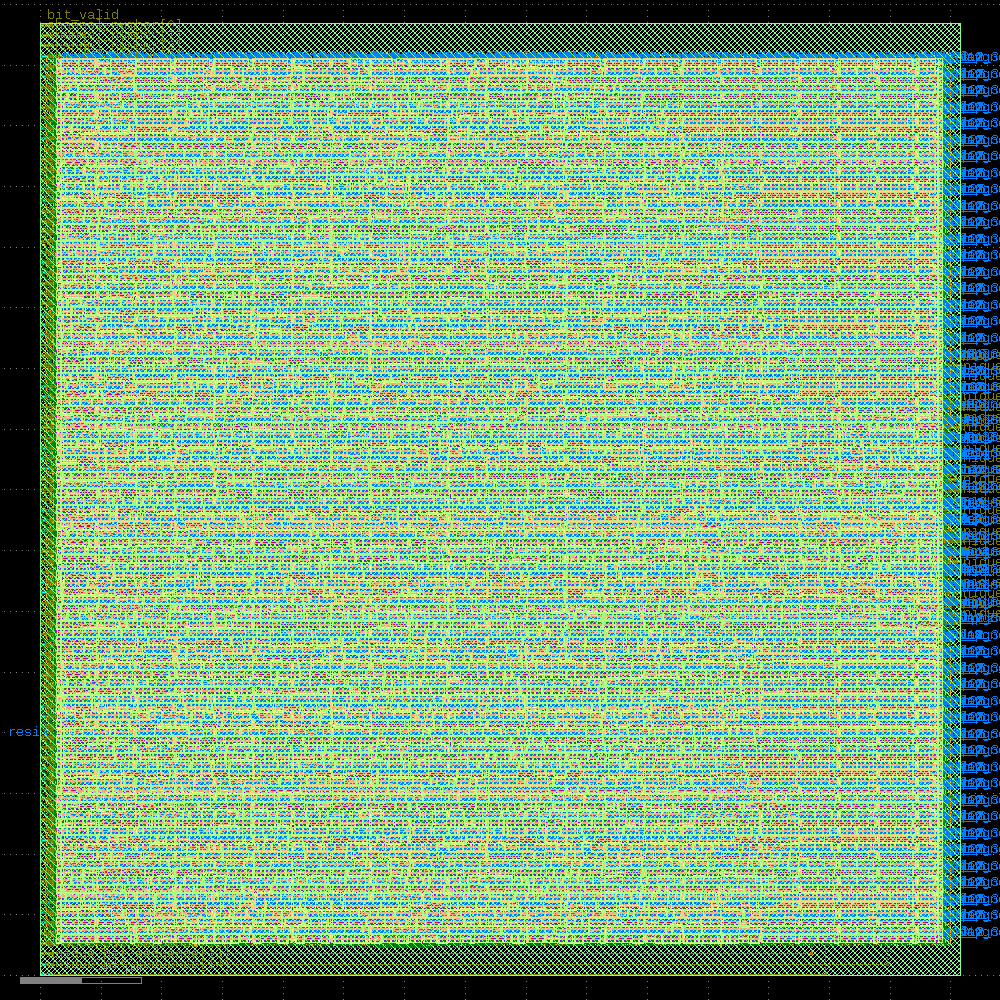

In [ ]:
# @title Stream-out
StreamOut = Step.factory.get("KLayout.StreamOut")

gds = StreamOut(state_in=rcx.state_out)
gds.start()
display(gds)

In [ ]:
# @title SPICE Extraction for Layout vs. Schematic Check
SpiceExtraction = Step.factory.get("Magic.SpiceExtraction")

spx = SpiceExtraction(state_in=gds.state_out)
spx.start()

───────────────────────────────────────────── SPICE Model Extraction ──────────────────────────────────────────────

[21:14:45] VERBOSE  Running 'Magic.SpiceExtraction'… (Log:                                             ]8;id=13009;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=714870;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=346648;file:///content/openlane_run/40-magic-spiceextraction/magic-spiceextraction.log\.]8;;\]8;id=802099;file:///content/openlane_run/40-magic-spiceextraction/magic-spiceextraction.log\/openlane_run/40-magic-spiceextraction/]8;;\]8;id=97823;file:///content/openlane_run/40-magic-spiceextraction/magic-spiceextraction.log\magic-spiceextraction.log]8;;\)                             

Magic 8.3 revision 466 - Compiled on Thu Mar 21 17:31:46 UTC 2024.

Starting magic under Tcl interpreter

Using the terminal as the console.

Using NULL graphics device.

Processing system .magicrc file

Sourcing design .magicrc for technology sky130A ...

2 Magic internal units = 1 Lambda

Input style sky130(): scaleFactor=2, multiplier=2

The following types are not handled by extraction and will be treated as non-electrical types:

ubm

Scaled tech values by 2 / 1 to match internal grid scaling

Loading sky130A Device Generator Menu ...

Loading "/content/openlane_ipynb/openlane/scripts/magic/wrapper.tcl" from command line.

> lef read /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef

Reading LEF data from file /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef.

This action cannot be undone.

LEF read, Line 78 (Message): Unknown keyword "ANTENNAMODEL" in LEF file; ignoring.

LEF read, Line 79 (Message): Unknown keyword "ANTENNADIFFSIDEAREARATIO" in LEF file; ignoring.

LEF read, Line 112 (Message): Unknown keyword "MINENCLOSEDAREA" in LEF file; ignoring.

LEF read, Line 114 (Message): Unknown keyword "ANTENNAMODEL" in LEF file; ignoring.

LEF read, Line 115 (Message): Unknown keyword "ANTENNADIFFSIDEAREARATIO" in LEF file; ignoring.

LEF read, Line 121 (Message): Unknown keyword "MAXIMUMDENSITY" in LEF file; ignoring.

LEF read, Line 122 (Message): Unknown keyword "DENSITYCHECKWINDOW" in LEF file; ignoring.

LEF read, Line 123 (Message): Unknown keyword "DENSITYCHECKSTEP" in LEF file; ignoring.

LEF read, Line 156 (Message): Unknown keyword "MINENCLOSEDAREA" in LEF file; ignoring.

LEF read, Line 164 (Message): Unknown keyword "ANTENNAMODEL" in LEF file; ignoring.

LEF read, Line 165 (Message): Unknown keyword "ANTENNADIFFSIDEAREARATIO" in LEF file; ignoring.

LEF read, Line 167 (Message): Unknown keyword "MAXIMUMDENSITY" in LEF file; ignoring.

LEF read, Line 168 (Message): Unknown keyword "DENSITYCHECKWINDOW" in LEF file; ignoring.

LEF read, Line 169 (Message): Unknown keyword "DENSITYCHECKSTEP" in LEF file; ignoring.

LEF read, Line 206 (Message): Unknown keyword "ANTENNAMODEL" in LEF file; ignoring.

LEF read, Line 207 (Message): Unknown keyword "ANTENNADIFFSIDEAREARATIO" in LEF file; ignoring.

LEF read, Line 209 (Message): Unknown keyword "MAXIMUMDENSITY" in LEF file; ignoring.

LEF read, Line 210 (Message): Unknown keyword "DENSITYCHECKWINDOW" in LEF file; ignoring.

LEF read, Line 211 (Message): Unknown keyword "DENSITYCHECKSTEP" in LEF file; ignoring.

LEF read, Line 248 (Message): Unknown keyword "ANTENNAMODEL" in LEF file; ignoring.

LEF read, Line 249 (Message): Unknown keyword "ANTENNADIFFSIDEAREARATIO" in LEF file; ignoring.

LEF read, Line 251 (Message): Unknown keyword "MAXIMUMDENSITY" in LEF file; ignoring.

LEF read, Line 252 (Message): Unknown keyword "DENSITYCHECKWINDOW" in LEF file; ignoring.

LEF read, Line 253 (Message): Unknown keyword "DENSITYCHECKSTEP" in LEF file; ignoring.

LEF read, Line 290 (Message): Unknown keyword "ANTENNAMODEL" in LEF file; ignoring.

LEF read, Line 291 (Message): Unknown keyword "ANTENNADIFFSIDEAREARATIO" in LEF file; ignoring.

LEF read: Processed 797 lines.

> lef read /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef

Reading LEF data from file /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef.

This action cannot be undone.

LEF read: Processed 278 lines.

> lef read /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef

Reading LEF data from file /root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef.

This action cannot be undone.

LEF read: Processed 68740 lines.

> def read /content/openlane_run/37-openroad-fillinsertion/btle_rx_core.def -noblockage -labels

Reading DEF data from file /content/openlane_run/37-openroad-fillinsertion/btle_rx_core.def.

This action cannot be undone.

Processed 4 vias total.

Processed 11095 subcell instances total.

Processed 121 pins total.

Processed 2 special nets total.

Processed 4154 nets total.

DEF read: Processed 81301 lines.

Moving label "_0011_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0017_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0022_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0023_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0027_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0030_" from metal1 to viali in cell btle_rx_core.

Moving label "_0031_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0033_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0053_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0064_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0067_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0070_" from metal1 to viali in cell btle_rx_core.

Moving label "_0077_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0087_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0092_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0096_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0099_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0100_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0110_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0112_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0118_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0119_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0122_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0125_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0126_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0128_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0139_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0158_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0160_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0161_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0164_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0174_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0179_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0185_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0188_" from metal1 to viali in cell btle_rx_core.

Moving label "_0189_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0216_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0227_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0465_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0523_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0542_" from metal1 to viali in cell btle_rx_core.

Moving label "_0604_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0631_" from metal2 to via1 in cell btle_rx_core.

Moving label "_0678_" from metal2 to via2 in cell btle_rx_core.

Moving label "_0687_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0695_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0698_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0779_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0783_" from metal1 to viali in cell btle_rx_core.

Moving label "_0805_" from metal1 to viali in cell btle_rx_core.

Moving label "_0851_" from metal1 to viali in cell btle_rx_core.

Moving label "_0859_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0885_" from metal2 to via1 in cell btle_rx_core.

Moving label "_0894_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0926_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0930_" from metal1 to viali in cell btle_rx_core.

Moving label "_0981_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0984_" from metal1 to via1 in cell btle_rx_core.

Moving label "_0988_" from metal1 to viali in cell btle_rx_core.

Moving label "_1007_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1075_" from metal2 to via1 in cell btle_rx_core.

Moving label "_1104_" from metal1 to viali in cell btle_rx_core.

Moving label "_1189_" from metal1 to viali in cell btle_rx_core.

Moving label "_1218_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1362_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1438_" from metal1 to viali in cell btle_rx_core.

Moving label "_1458_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1509_" from metal2 to via1 in cell btle_rx_core.

Moving label "_1540_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1576_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1617_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1647_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1738_" from metal1 to viali in cell btle_rx_core.

Moving label "_1766_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1794_" from metal1 to via1 in cell btle_rx_core.

Moving label "_1839_" from metal1 to viali in cell btle_rx_core.

Moving label "_1963_" from metal1 to via1 in cell btle_rx_core.

Moving label "_2075_" from metal2 to via1 in cell btle_rx_core.

Moving label "_2144_" from metal1 to via1 in cell btle_rx_core.

Moving label "_2196_" from metal2 to via2 in cell btle_rx_core.

Moving label "_2226_" from metal2 to via2 in cell btle_rx_core.

Moving label "_2255_" from metal2 to via2 in cell btle_rx_core.

Moving label "_2362_" from metal2 to via2 in cell btle_rx_core.

Moving label "_2492_" from metal1 to via1 in cell btle_rx_core.

Moving label "_2813_" from metal1 to via1 in cell btle_rx_core.

Moving label "_2881_" from metal1 to viali in cell btle_rx_core.

Moving label "_2984_" from metal1 to viali in cell btle_rx_core.

Moving label "_3247_" from metal2 to via2 in cell btle_rx_core.

Moving label "_3331_" from metal1 to viali in cell btle_rx_core.

Moving label "_3376_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3380_" from metal1 to viali in cell btle_rx_core.

Moving label "_3423_" from metal1 to viali in cell btle_rx_core.

Moving label "_3433_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3449_" from metal2 to via1 in cell btle_rx_core.

Moving label "_3477_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3486_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3492_" from metal1 to viali in cell btle_rx_core.

Moving label "_3548_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3595_" from metal2 to via1 in cell btle_rx_core.

Moving label "_3646_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3655_" from metal1 to viali in cell btle_rx_core.

Moving label "_3678_" from metal1 to viali in cell btle_rx_core.

Moving label "_3720_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3733_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3797_" from metal1 to viali in cell btle_rx_core.

Moving label "_3803_" from metal1 to viali in cell btle_rx_core.

Moving label "_3808_" from metal1 to via1 in cell btle_rx_core.

Moving label "_3823_" from metal1 to via1 in cell btle_rx_core.

Moving label "crc24_core_i.lfsr\[10\]" from metal1 to via1 in cell btle_rx_core.

Moving label "crc24_core_i.lfsr\[18\]" from metal2 to via1 in cell btle_rx_core.

Moving label "crc24_core_i.lfsr\[22\]" from metal1 to via1 in cell btle_rx_core.

Moving label "gfsk_demodulation_i.i0\[14\]" from metal2 to via2 in cell btle_rx_core.

Moving label "gfsk_demodulation_i.i1\[8\]" from metal2 to via2 in cell btle_rx_core.

Moving label "gfsk_demodulation_i.q1\[12\]" from metal3 to via3 in cell btle_rx_core.

Moving label "i[13]" from metal2 to via2 in cell btle_rx_core.

Moving label "i[6]" from metal2 to via2 in cell btle_rx_core.

Moving label "i[8]" from metal2 to via2 in cell btle_rx_core.

Moving label "q[13]" from metal2 to via2 in cell btle_rx_core.

Moving label "scramble_core_i.lfsr\[3\]" from metal1 to via1 in cell btle_rx_core.

Moving label "scramble_core_i.lfsr\[6\]" from metal1 to via1 in cell btle_rx_core.

Moving label "search_unique_bit_sequence_i.bit_store\[0\]" from metal1 to via1 in cell btle_rx_core.

Moving label "unique_bit_sequence[23]" from metal2 to via2 in cell btle_rx_core.

Moving label "unique_bit_sequence[29]" from metal1 to viali in cell btle_rx_core.

Processing btle_rx_core

Extracting sky130_ef_sc_hd__decap_12 into sky130_ef_sc_hd__decap_12.ext:

Extracting sky130_fd_sc_hd__decap_3 into sky130_fd_sc_hd__decap_3.ext:

Extracting sky130_fd_sc_hd__fill_1 into sky130_fd_sc_hd__fill_1.ext:

Extracting sky130_fd_sc_hd__tapvpwrvgnd_1 into sky130_fd_sc_hd__tapvpwrvgnd_1.ext:

Extracting sky130_fd_sc_hd__decap_4 into sky130_fd_sc_hd__decap_4.ext:

Extracting sky130_fd_sc_hd__decap_8 into sky130_fd_sc_hd__decap_8.ext:

Extracting sky130_fd_sc_hd__decap_6 into sky130_fd_sc_hd__decap_6.ext:

Extracting sky130_fd_sc_hd__fill_2 into sky130_fd_sc_hd__fill_2.ext:

Extracting sky130_fd_sc_hd__mux2_1 into sky130_fd_sc_hd__mux2_1.ext:

Extracting sky130_fd_sc_hd__and2_2 into sky130_fd_sc_hd__and2_2.ext:

Extracting sky130_fd_sc_hd__dfxtp_2 into sky130_fd_sc_hd__dfxtp_2.ext:

Extracting sky130_fd_sc_hd__nand2_2 into sky130_fd_sc_hd__nand2_2.ext:

Extracting sky130_fd_sc_hd__xnor2_2 into sky130_fd_sc_hd__xnor2_2.ext:

Extracting sky130_fd_sc_hd__a31o_2 into sky130_fd_sc_hd__a31o_2.ext:

Extracting sky130_fd_sc_hd__and3_2 into sky130_fd_sc_hd__and3_2.ext:

Extracting sky130_fd_sc_hd__xor2_2 into sky130_fd_sc_hd__xor2_2.ext:

Extracting sky130_fd_sc_hd__and2b_2 into sky130_fd_sc_hd__and2b_2.ext:

Extracting sky130_fd_sc_hd__a22oi_2 into sky130_fd_sc_hd__a22oi_2.ext:

Extracting sky130_fd_sc_hd__and4_2 into sky130_fd_sc_hd__and4_2.ext:

Extracting sky130_fd_sc_hd__nand2b_2 into sky130_fd_sc_hd__nand2b_2.ext:

Extracting sky130_fd_sc_hd__a21boi_2 into sky130_fd_sc_hd__a21boi_2.ext:

Extracting sky130_fd_sc_hd__or2_2 into sky130_fd_sc_hd__or2_2.ext:

Extracting sky130_fd_sc_hd__nor2_2 into sky130_fd_sc_hd__nor2_2.ext:

Extracting sky130_fd_sc_hd__a21oi_2 into sky130_fd_sc_hd__a21oi_2.ext:

Extracting sky130_fd_sc_hd__a2bb2o_2 into sky130_fd_sc_hd__a2bb2o_2.ext:

Extracting sky130_fd_sc_hd__o21a_2 into sky130_fd_sc_hd__o21a_2.ext:

Extracting sky130_fd_sc_hd__o22a_2 into sky130_fd_sc_hd__o22a_2.ext:

Extracting sky130_fd_sc_hd__or4_2 into sky130_fd_sc_hd__or4_2.ext:

Extracting sky130_fd_sc_hd__o21ai_2 into sky130_fd_sc_hd__o21ai_2.ext:

Extracting sky130_fd_sc_hd__a21o_2 into sky130_fd_sc_hd__a21o_2.ext:

Extracting sky130_fd_sc_hd__a22o_2 into sky130_fd_sc_hd__a22o_2.ext:

Extracting sky130_fd_sc_hd__inv_2 into sky130_fd_sc_hd__inv_2.ext:

Extracting sky130_fd_sc_hd__nand3_2 into sky130_fd_sc_hd__nand3_2.ext:

Extracting sky130_fd_sc_hd__nand4_2 into sky130_fd_sc_hd__nand4_2.ext:

Extracting sky130_fd_sc_hd__o211a_2 into sky130_fd_sc_hd__o211a_2.ext:

Extracting sky130_fd_sc_hd__or3_2 into sky130_fd_sc_hd__or3_2.ext:

Extracting sky130_fd_sc_hd__a21bo_2 into sky130_fd_sc_hd__a21bo_2.ext:

Extracting sky130_fd_sc_hd__a211oi_2 into sky130_fd_sc_hd__a211oi_2.ext:

Extracting sky130_fd_sc_hd__a211o_2 into sky130_fd_sc_hd__a211o_2.ext:

Extracting sky130_fd_sc_hd__o211ai_2 into sky130_fd_sc_hd__o211ai_2.ext:

Extracting sky130_fd_sc_hd__o32a_2 into sky130_fd_sc_hd__o32a_2.ext:

Extracting sky130_fd_sc_hd__nor3_2 into sky130_fd_sc_hd__nor3_2.ext:

Extracting sky130_fd_sc_hd__a2111oi_2 into sky130_fd_sc_hd__a2111oi_2.ext:

Extracting sky130_fd_sc_hd__a31oi_2 into sky130_fd_sc_hd__a31oi_2.ext:

Extracting sky130_fd_sc_hd__or4b_2 into sky130_fd_sc_hd__or4b_2.ext:

Extracting sky130_fd_sc_hd__o21ba_2 into sky130_fd_sc_hd__o21ba_2.ext:

Extracting sky130_fd_sc_hd__o32ai_2 into sky130_fd_sc_hd__o32ai_2.ext:

Extracting sky130_fd_sc_hd__a2111o_2 into sky130_fd_sc_hd__a2111o_2.ext:

Extracting sky130_fd_sc_hd__and3b_2 into sky130_fd_sc_hd__and3b_2.ext:

Extracting sky130_fd_sc_hd__nor3b_2 into sky130_fd_sc_hd__nor3b_2.ext:

Extracting sky130_fd_sc_hd__o31a_2 into sky130_fd_sc_hd__o31a_2.ext:

Extracting sky130_fd_sc_hd__clkbuf_8 into sky130_fd_sc_hd__clkbuf_8.ext:

Extracting sky130_fd_sc_hd__o21bai_2 into sky130_fd_sc_hd__o21bai_2.ext:

Extracting sky130_fd_sc_hd__nor4_2 into sky130_fd_sc_hd__nor4_2.ext:

Extracting sky130_fd_sc_hd__conb_1 into sky130_fd_sc_hd__conb_1.ext:

Extracting sky130_fd_sc_hd__buf_2 into sky130_fd_sc_hd__buf_2.ext:

Extracting sky130_fd_sc_hd__a221o_2 into sky130_fd_sc_hd__a221o_2.ext:

Extracting sky130_fd_sc_hd__o221a_2 into sky130_fd_sc_hd__o221a_2.ext:

Extracting sky130_fd_sc_hd__a32o_2 into sky130_fd_sc_hd__a32o_2.ext:

Extracting sky130_fd_sc_hd__or3b_2 into sky130_fd_sc_hd__or3b_2.ext:

Extracting sky130_fd_sc_hd__and4bb_2 into sky130_fd_sc_hd__and4bb_2.ext:

Extracting sky130_fd_sc_hd__o2bb2a_2 into sky130_fd_sc_hd__o2bb2a_2.ext:

Extracting sky130_fd_sc_hd__a41o_2 into sky130_fd_sc_hd__a41o_2.ext:

Extracting sky130_fd_sc_hd__a311o_2 into sky130_fd_sc_hd__a311o_2.ext:

Extracting sky130_fd_sc_hd__o22ai_2 into sky130_fd_sc_hd__o22ai_2.ext:

Extracting sky130_fd_sc_hd__a32oi_2 into sky130_fd_sc_hd__a32oi_2.ext:

Extracting sky130_fd_sc_hd__nor4b_2 into sky130_fd_sc_hd__nor4b_2.ext:

Extracting sky130_fd_sc_hd__o2111a_2 into sky130_fd_sc_hd__o2111a_2.ext:

Extracting sky130_fd_sc_hd__clkbuf_16 into sky130_fd_sc_hd__clkbuf_16.ext:

Extracting sky130_fd_sc_hd__o2bb2ai_2 into sky130_fd_sc_hd__o2bb2ai_2.ext:

Extracting sky130_fd_sc_hd__nand3b_2 into sky130_fd_sc_hd__nand3b_2.ext:

Extracting sky130_fd_sc_hd__and4b_2 into sky130_fd_sc_hd__and4b_2.ext:

Extracting sky130_fd_sc_hd__a311oi_2 into sky130_fd_sc_hd__a311oi_2.ext:

Extracting btle_rx_core into btle_rx_core.ext:

exttospice finished.

Using technology "sky130A", version 1.0.465-2-gbdc9412

{'nl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.nl.v'), 'pnl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.pnl.v'), 'pnl-sdf-friendly': None, 'pnl-npc': None, 'def': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.def'), 'lef': None, 'openroad-lef': None, 'odb': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.odb'), 'sdc': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.sdc'), 'sdf': None, 'spef': {'nom_*': Path('/content/openlane_run/38-openroad-rcx/nom/btle_rx_core.nom.spef'), 'min_*': Path('/content/openlane_run/38-openroad-rcx/min/btle_rx_core.min.spef'), 'max_*': Path('/content/openlane_run/38-openroad-rcx/max/btle_rx_core.max.spef')}, 'lib': None, 'spice': Path('/content/openlane_run/40-magic-spiceextraction/btle_rx_core.spice'), 'mag': None, 'gds': Path('/content/openlane_run/39-klayout-streamout/btle_rx_core.gds'), 'mag_gds': None, 'klayout_gds': Path('/content/openlane_run/39-klayout-streamout/btle_rx_core.klayout.gds'), 'json_h': None, 'vh': None, 'metrics': {'design__instance__count': 5256, 'design__instance__area': Decimal('44400.1'), 'design__instance_unmapped__count': 0, 'synthesis__check_error__count': 0, 'design__die__bbox': '0.0 0.0 303.105 313.825', 'design__core__bbox': '5.52 10.88 297.16 301.92', 'design__io': 121, 'design__die__area': Decimal('95121.9'), 'design__core__area': Decimal('84878.9'), 'design__instance__count__stdcell': 5256, 'design__instance__area__stdcell': Decimal('44400.1'), 'design__instance__count__macros': 0, 'design__instance__area__macros': 0, 'design__instance__utilization': Decimal('0.523099'), 'design__instance__utilization__stdcell': Decimal('0.523099'), 'floorplan__design__io': 119, 'design__io__hpwl': 25960286, 'design__power_grid_violation__count__net:VGND': 0, 'design__power_grid_violation__count__net:VPWR': 0, 'design__power_grid_violation__count': 0, 'design__instance__displacement__total': Decimal('103.236'), 'design__instance__displacement__mean': Decimal('0.018'), 'design__instance__displacement__max': Decimal('8.273'), 'route__wirelength__estimated': Decimal('84141.6'), 'design__violations': 0, 'antenna__violating__nets': 9, 'antenna__violating__pins': 10, 'route__net': 4154, 'route__net__special': 2, 'route__drc_errors__iter:1': 2194, 'route__wirelength__iter:1': 100858, 'route__drc_errors__iter:2': 708, 'route__wirelength__iter:2': 99903, 'route__drc_errors__iter:3': 776, 'route__wirelength__iter:3': 99628, 'route__drc_errors__iter:4': 72, 'route__wirelength__iter:4': 99659, 'route__drc_errors__iter:5': 10, 'route__wirelength__iter:5': 99632, 'route__drc_errors__iter:6': 0, 'route__wirelength__iter:6': 99631, 'route__drc_errors': 0, 'route__wirelength': 99631, 'route__vias': 29520, 'route__vias__singlecut': 29520, 'route__vias__multicut': 0, 'magic__illegal_overlap__count': 0}}

In [ ]:
# @title Layout vs. Schematic (LVS)
LVS = Step.factory.get("Netgen.LVS")

lvs = LVS(state_in=spx.state_out)
lvs.start()

─────────────────────────────────────────────────── Netgen LVS ────────────────────────────────────────────────────

[21:15:00] VERBOSE  Running 'Netgen.LVS'… (Log: ]8;id=257729;file:///content/openlane_run/41-netgen-lvs/netgen-lvs.log\.]8;;\]8;id=419243;file:///content/openlane_run/41-netgen-lvs/netgen-lvs.log\/openlane_run/41-netgen-lvs/]8;;\]8;id=614413;file:///content/openlane_run/41-netgen-lvs/netgen-lvs.log\netgen-lvs.log]8;;\)           ]8;id=638490;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=432966;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

Netgen 1.5.255 compiled on Tue Dec  5 22:48:12 UTC 2023

Warning: netgen command 'format' use fully-qualified name '::netgen::format'

Warning: netgen command 'global' use fully-qualified name '::netgen::global'

Reading SPICE netlist file                                                                                         
'/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__decap_12.spice'...

Call to undefined subcircuit sky130_fd_pr__pfet_01v8_hvt

Creating placeholder cell definition.

Call to undefined subcircuit sky130_fd_pr__nfet_01v8

Creating placeholder cell definition.

Reading SPICE netlist file '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_12.spice'...

Reading SPICE netlist file '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_4.spice'...

Reading SPICE netlist file '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_ef_sc_hd__fill_8.spice'...

Reading SPICE netlist file '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/spice/sky130_fd_sc_hd.spice'...

Call to undefined subcircuit sky130_fd_sc_hd__nand2_2

Creating placeholder cell definition.

Call to undefined subcircuit sky130_fd_sc_hd__nor2_2

Creating placeholder cell definition.

Generating JSON file result

Reading netlist file /content/openlane_run/40-magic-spiceextraction/btle_rx_core.spice

Reading netlist file /content/openlane_run/37-openroad-fillinsertion/btle_rx_core.pnl.v

Warning:  A case-insensitive file has been read and so the      verilog file must be treated case-insensitive to   
match.

Note:  Implicit pin HI in instance TIE_ZERO_zero_ of sky130_fd_sc_hd__conb_1 in cell btle_rx_core

Reading setup file /content/openlane_ipynb/openlane/scripts/netgen/setup.tcl

Model sky130_fd_pr__res_generic_po pin end_a == end_b

No property mult found for device sky130_fd_pr__res_generic_po

Model sky130_fd_pr__nfet_01v8 pin 1 == 3

No property mult found for device sky130_fd_pr__nfet_01v8

No property sa found for device sky130_fd_pr__nfet_01v8

No property sb found for device sky130_fd_pr__nfet_01v8

No property sd found for device sky130_fd_pr__nfet_01v8

No property nf found for device sky130_fd_pr__nfet_01v8

No property nrd found for device sky130_fd_pr__nfet_01v8

No property nrs found for device sky130_fd_pr__nfet_01v8

No property area found for device sky130_fd_pr__nfet_01v8

No property perim found for device sky130_fd_pr__nfet_01v8

No property topography found for device sky130_fd_pr__nfet_01v8

Model sky130_fd_pr__pfet_01v8_hvt pin 1 == 3

No property mult found for device sky130_fd_pr__pfet_01v8_hvt

No property sa found for device sky130_fd_pr__pfet_01v8_hvt

No property sb found for device sky130_fd_pr__pfet_01v8_hvt

No property sd found for device sky130_fd_pr__pfet_01v8_hvt

No property nf found for device sky130_fd_pr__pfet_01v8_hvt

No property nrd found for device sky130_fd_pr__pfet_01v8_hvt

No property nrs found for device sky130_fd_pr__pfet_01v8_hvt

No property area found for device sky130_fd_pr__pfet_01v8_hvt

No property perim found for device sky130_fd_pr__pfet_01v8_hvt

No property topography found for device sky130_fd_pr__pfet_01v8_hvt

No property value found for device sky130_fd_pr__diode_pw2nd_05v5

No property mult found for device sky130_fd_pr__diode_pw2nd_05v5

No property perim found for device sky130_fd_pr__diode_pw2nd_05v5

Comparison output logged to file /content/openlane_run/41-netgen-lvs/reports/lvs.netgen.rpt

Logging to file "/content/openlane_run/41-netgen-lvs/reports/lvs.netgen.rpt" enabled

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__decap_3'

Circuit sky130_fd_sc_hd__decap_3 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__decap_3'

Circuit sky130_fd_sc_hd__decap_3 contains 2 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   1

Class: sky130_fd_pr__pfet_01v8_hvt instances:   1

Circuit contains 4 nets.

Circuit sky130_fd_sc_hd__decap_3 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__and4_2'

Circuit sky130_fd_sc_hd__and4_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__and4_2'

Circuit sky130_fd_sc_hd__and4_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__and4_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__decap_8'

Circuit sky130_fd_sc_hd__decap_8 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__decap_8'

Circuit sky130_fd_sc_hd__decap_8 contains 2 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   1

Class: sky130_fd_pr__pfet_01v8_hvt instances:   1

Circuit contains 4 nets.

Circuit sky130_fd_sc_hd__decap_8 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_ef_sc_hd__decap_12'

Circuit sky130_ef_sc_hd__decap_12 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_ef_sc_hd__decap_12'

Circuit sky130_ef_sc_hd__decap_12 contains 2 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   1

Class: sky130_fd_pr__pfet_01v8_hvt instances:   1

Circuit contains 4 nets.

Circuit sky130_ef_sc_hd__decap_12 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__and2b_2'

Circuit sky130_fd_sc_hd__and2b_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__and2b_2'

Circuit sky130_fd_sc_hd__and2b_2 contains 10 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   5

Class: sky130_fd_pr__pfet_01v8_hvt instances:   5

Circuit contains 10 nets.

Circuit sky130_fd_sc_hd__and2b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nor2_2'

Circuit sky130_fd_sc_hd__nor2_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nor2_2'

Circuit sky130_fd_sc_hd__nor2_2 contains 8 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   4

Class: sky130_fd_pr__pfet_01v8_hvt instances:   4

Circuit contains 8 nets.

Circuit sky130_fd_sc_hd__nor2_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__fill_2'

Circuit sky130_fd_sc_hd__fill_2 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__fill_2'

Circuit sky130_fd_sc_hd__fill_2 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Circuit sky130_fd_sc_hd__fill_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a41o_2'

Circuit sky130_fd_sc_hd__a41o_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a41o_2'

Circuit sky130_fd_sc_hd__a41o_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__a41o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__tapvpwrvgnd_1'

Circuit sky130_fd_sc_hd__tapvpwrvgnd_1 contains 0 device instances.

Circuit contains 0 nets, and 2 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__tapvpwrvgnd_1'

Circuit sky130_fd_sc_hd__tapvpwrvgnd_1 contains 0 device instances.

Circuit contains 0 nets, and 2 disconnected pins.

Circuit sky130_fd_sc_hd__tapvpwrvgnd_1 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__xnor2_2'

Circuit sky130_fd_sc_hd__xnor2_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__xnor2_2'

Circuit sky130_fd_sc_hd__xnor2_2 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__xnor2_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__fill_1'

Circuit sky130_fd_sc_hd__fill_1 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__fill_1'

Circuit sky130_fd_sc_hd__fill_1 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Circuit sky130_fd_sc_hd__fill_1 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o211ai_2'

Circuit sky130_fd_sc_hd__o211ai_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o211ai_2'

Circuit sky130_fd_sc_hd__o211ai_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__o211ai_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__decap_6'

Circuit sky130_fd_sc_hd__decap_6 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__decap_6'

Circuit sky130_fd_sc_hd__decap_6 contains 2 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   1

Class: sky130_fd_pr__pfet_01v8_hvt instances:   1

Circuit contains 4 nets.

Circuit sky130_fd_sc_hd__decap_6 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__or2_2'

Circuit sky130_fd_sc_hd__or2_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__or2_2'

Circuit sky130_fd_sc_hd__or2_2 contains 8 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   4

Class: sky130_fd_pr__pfet_01v8_hvt instances:   4

Circuit contains 9 nets.

Circuit sky130_fd_sc_hd__or2_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__xor2_2'

Circuit sky130_fd_sc_hd__xor2_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__xor2_2'

Circuit sky130_fd_sc_hd__xor2_2 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__xor2_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__decap_4'

Circuit sky130_fd_sc_hd__decap_4 contains 0 device instances.

Circuit contains 0 nets, and 4 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__decap_4'

Circuit sky130_fd_sc_hd__decap_4 contains 2 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   1

Class: sky130_fd_pr__pfet_01v8_hvt instances:   1

Circuit contains 4 nets.

Circuit sky130_fd_sc_hd__decap_4 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nand3_2'

Circuit sky130_fd_sc_hd__nand3_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nand3_2'

Circuit sky130_fd_sc_hd__nand3_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 10 nets.

Circuit sky130_fd_sc_hd__nand3_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o21ai_2'

Circuit sky130_fd_sc_hd__o21ai_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o21ai_2'

Circuit sky130_fd_sc_hd__o21ai_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 10 nets.

Circuit sky130_fd_sc_hd__o21ai_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a21oi_2'

Circuit sky130_fd_sc_hd__a21oi_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a21oi_2'

Circuit sky130_fd_sc_hd__a21oi_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__a21oi_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__inv_2'

Circuit sky130_fd_sc_hd__inv_2 contains 0 device instances.

Circuit contains 0 nets, and 6 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__inv_2'

Circuit sky130_fd_sc_hd__inv_2 contains 4 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   2

Class: sky130_fd_pr__pfet_01v8_hvt instances:   2

Circuit contains 6 nets.

Circuit sky130_fd_sc_hd__inv_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o211a_2'

Circuit sky130_fd_sc_hd__o211a_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o211a_2'

Circuit sky130_fd_sc_hd__o211a_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__o211a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__buf_2'

Circuit sky130_fd_sc_hd__buf_2 contains 0 device instances.

Circuit contains 0 nets, and 6 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__buf_2'

Circuit sky130_fd_sc_hd__buf_2 contains 6 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   3

Class: sky130_fd_pr__pfet_01v8_hvt instances:   3

Circuit contains 7 nets.

Circuit sky130_fd_sc_hd__buf_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o21ba_2'

Circuit sky130_fd_sc_hd__o21ba_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o21ba_2'

Circuit sky130_fd_sc_hd__o21ba_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__o21ba_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nand2_2'

Circuit sky130_fd_sc_hd__nand2_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nand2_2'

Circuit sky130_fd_sc_hd__nand2_2 contains 8 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   4

Class: sky130_fd_pr__pfet_01v8_hvt instances:   4

Circuit contains 8 nets.

Circuit sky130_fd_sc_hd__nand2_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__and2_2'

Circuit sky130_fd_sc_hd__and2_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__and2_2'

Circuit sky130_fd_sc_hd__and2_2 contains 8 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   4

Class: sky130_fd_pr__pfet_01v8_hvt instances:   4

Circuit contains 9 nets.

Circuit sky130_fd_sc_hd__and2_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__dfxtp_2'

Circuit sky130_fd_sc_hd__dfxtp_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__dfxtp_2'

Circuit sky130_fd_sc_hd__dfxtp_2 contains 26 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  13

Class: sky130_fd_pr__pfet_01v8_hvt instances:  13

Circuit contains 18 nets.

Circuit sky130_fd_sc_hd__dfxtp_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a211o_2'

Circuit sky130_fd_sc_hd__a211o_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a211o_2'

Circuit sky130_fd_sc_hd__a211o_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__a211o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__clkbuf_8'

Circuit sky130_fd_sc_hd__clkbuf_8 contains 0 device instances.

Circuit contains 0 nets, and 6 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__clkbuf_8'

Circuit sky130_fd_sc_hd__clkbuf_8 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 7 nets.

Circuit sky130_fd_sc_hd__clkbuf_8 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a21o_2'

Circuit sky130_fd_sc_hd__a21o_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a21o_2'

Circuit sky130_fd_sc_hd__a21o_2 contains 10 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   5

Class: sky130_fd_pr__pfet_01v8_hvt instances:   5

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__a21o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__or3_2'

Circuit sky130_fd_sc_hd__or3_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__or3_2'

Circuit sky130_fd_sc_hd__or3_2 contains 10 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   5

Class: sky130_fd_pr__pfet_01v8_hvt instances:   5

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__or3_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a31o_2'

Circuit sky130_fd_sc_hd__a31o_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a31o_2'

Circuit sky130_fd_sc_hd__a31o_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__a31o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o21a_2'

Circuit sky130_fd_sc_hd__o21a_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o21a_2'

Circuit sky130_fd_sc_hd__o21a_2 contains 10 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   5

Class: sky130_fd_pr__pfet_01v8_hvt instances:   5

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__o21a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a32o_2'

Circuit sky130_fd_sc_hd__a32o_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a32o_2'

Circuit sky130_fd_sc_hd__a32o_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__a32o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__and3b_2'

Circuit sky130_fd_sc_hd__and3b_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__and3b_2'

Circuit sky130_fd_sc_hd__and3b_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__and3b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o221a_2'

Circuit sky130_fd_sc_hd__o221a_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o221a_2'

Circuit sky130_fd_sc_hd__o221a_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__o221a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__and4bb_2'

Circuit sky130_fd_sc_hd__and4bb_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__and4bb_2'

Circuit sky130_fd_sc_hd__and4bb_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__and4bb_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__mux2_1'

Circuit sky130_fd_sc_hd__mux2_1 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__mux2_1'

Circuit sky130_fd_sc_hd__mux2_1 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__mux2_1 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__and3_2'

Circuit sky130_fd_sc_hd__and3_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__and3_2'

Circuit sky130_fd_sc_hd__and3_2 contains 10 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   5

Class: sky130_fd_pr__pfet_01v8_hvt instances:   5

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__and3_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a211oi_2'

Circuit sky130_fd_sc_hd__a211oi_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a211oi_2'

Circuit sky130_fd_sc_hd__a211oi_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__a211oi_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nand2b_2'

Circuit sky130_fd_sc_hd__nand2b_2 contains 0 device instances.

Circuit contains 0 nets, and 7 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nand2b_2'

Circuit sky130_fd_sc_hd__nand2b_2 contains 10 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   5

Class: sky130_fd_pr__pfet_01v8_hvt instances:   5

Circuit contains 9 nets.

Circuit sky130_fd_sc_hd__nand2b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a21bo_2'

Circuit sky130_fd_sc_hd__a21bo_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a21bo_2'

Circuit sky130_fd_sc_hd__a21bo_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__a21bo_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a22oi_2'

Circuit sky130_fd_sc_hd__a22oi_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a22oi_2'

Circuit sky130_fd_sc_hd__a22oi_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__a22oi_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a221o_2'

Circuit sky130_fd_sc_hd__a221o_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a221o_2'

Circuit sky130_fd_sc_hd__a221o_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__a221o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__or3b_2'

Circuit sky130_fd_sc_hd__or3b_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__or3b_2'

Circuit sky130_fd_sc_hd__or3b_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__or3b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a22o_2'

Circuit sky130_fd_sc_hd__a22o_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a22o_2'

Circuit sky130_fd_sc_hd__a22o_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__a22o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nand3b_2'

Circuit sky130_fd_sc_hd__nand3b_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nand3b_2'

Circuit sky130_fd_sc_hd__nand3b_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__nand3b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o22a_2'

Circuit sky130_fd_sc_hd__o22a_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o22a_2'

Circuit sky130_fd_sc_hd__o22a_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__o22a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o32a_2'

Circuit sky130_fd_sc_hd__o32a_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o32a_2'

Circuit sky130_fd_sc_hd__o32a_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__o32a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o21bai_2'

Circuit sky130_fd_sc_hd__o21bai_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o21bai_2'

Circuit sky130_fd_sc_hd__o21bai_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__o21bai_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a2111o_2'

Circuit sky130_fd_sc_hd__a2111o_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a2111o_2'

Circuit sky130_fd_sc_hd__a2111o_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__a2111o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a21boi_2'

Circuit sky130_fd_sc_hd__a21boi_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a21boi_2'

Circuit sky130_fd_sc_hd__a21boi_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__a21boi_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__or4_2'

Circuit sky130_fd_sc_hd__or4_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__or4_2'

Circuit sky130_fd_sc_hd__or4_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__or4_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a31oi_2'

Circuit sky130_fd_sc_hd__a31oi_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a31oi_2'

Circuit sky130_fd_sc_hd__a31oi_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__a31oi_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o32ai_2'

Circuit sky130_fd_sc_hd__o32ai_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o32ai_2'

Circuit sky130_fd_sc_hd__o32ai_2 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__o32ai_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nor3b_2'

Circuit sky130_fd_sc_hd__nor3b_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nor3b_2'

Circuit sky130_fd_sc_hd__nor3b_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 11 nets.

Circuit sky130_fd_sc_hd__nor3b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nor3_2'

Circuit sky130_fd_sc_hd__nor3_2 contains 0 device instances.

Circuit contains 0 nets, and 8 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nor3_2'

Circuit sky130_fd_sc_hd__nor3_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 10 nets.

Circuit sky130_fd_sc_hd__nor3_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nand4_2'

Circuit sky130_fd_sc_hd__nand4_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nand4_2'

Circuit sky130_fd_sc_hd__nand4_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__nand4_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a2bb2o_2'

Circuit sky130_fd_sc_hd__a2bb2o_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a2bb2o_2'

Circuit sky130_fd_sc_hd__a2bb2o_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__a2bb2o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__and4b_2'

Circuit sky130_fd_sc_hd__and4b_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__and4b_2'

Circuit sky130_fd_sc_hd__and4b_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__and4b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__clkbuf_16'

Circuit sky130_fd_sc_hd__clkbuf_16 contains 0 device instances.

Circuit contains 0 nets, and 6 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__clkbuf_16'

Circuit sky130_fd_sc_hd__clkbuf_16 contains 40 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  20

Class: sky130_fd_pr__pfet_01v8_hvt instances:  20

Circuit contains 7 nets.

Circuit sky130_fd_sc_hd__clkbuf_16 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o2bb2ai_2'

Circuit sky130_fd_sc_hd__o2bb2ai_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o2bb2ai_2'

Circuit sky130_fd_sc_hd__o2bb2ai_2 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__o2bb2ai_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o2bb2a_2'

Circuit sky130_fd_sc_hd__o2bb2a_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o2bb2a_2'

Circuit sky130_fd_sc_hd__o2bb2a_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__o2bb2a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__or4b_2'

Circuit sky130_fd_sc_hd__or4b_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__or4b_2'

Circuit sky130_fd_sc_hd__or4b_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__or4b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__conb_1'

Circuit sky130_fd_sc_hd__conb_1 contains 0 device instances.

Circuit contains 0 nets, and 6 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__conb_1'

Circuit sky130_fd_sc_hd__conb_1 contains 2 device instances.

Class: sky130_fd_pr__res_generic_po instances:   2

Circuit contains 4 nets, and 2 disconnected pins.

Circuit sky130_fd_sc_hd__conb_1 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nor4b_2'

Circuit sky130_fd_sc_hd__nor4b_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nor4b_2'

Circuit sky130_fd_sc_hd__nor4b_2 contains 18 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   9

Class: sky130_fd_pr__pfet_01v8_hvt instances:   9

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__nor4b_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a311oi_2'

Circuit sky130_fd_sc_hd__a311oi_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a311oi_2'

Circuit sky130_fd_sc_hd__a311oi_2 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__a311oi_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a32oi_2'

Circuit sky130_fd_sc_hd__a32oi_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a32oi_2'

Circuit sky130_fd_sc_hd__a32oi_2 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 14 nets.

Circuit sky130_fd_sc_hd__a32oi_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o31a_2'

Circuit sky130_fd_sc_hd__o31a_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o31a_2'

Circuit sky130_fd_sc_hd__o31a_2 contains 12 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   6

Class: sky130_fd_pr__pfet_01v8_hvt instances:   6

Circuit contains 13 nets.

Circuit sky130_fd_sc_hd__o31a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o22ai_2'

Circuit sky130_fd_sc_hd__o22ai_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o22ai_2'

Circuit sky130_fd_sc_hd__o22ai_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__o22ai_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__o2111a_2'

Circuit sky130_fd_sc_hd__o2111a_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__o2111a_2'

Circuit sky130_fd_sc_hd__o2111a_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__o2111a_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__nor4_2'

Circuit sky130_fd_sc_hd__nor4_2 contains 0 device instances.

Circuit contains 0 nets, and 9 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__nor4_2'

Circuit sky130_fd_sc_hd__nor4_2 contains 16 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   8

Class: sky130_fd_pr__pfet_01v8_hvt instances:   8

Circuit contains 12 nets.

Circuit sky130_fd_sc_hd__nor4_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a311o_2'

Circuit sky130_fd_sc_hd__a311o_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a311o_2'

Circuit sky130_fd_sc_hd__a311o_2 contains 14 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:   7

Class: sky130_fd_pr__pfet_01v8_hvt instances:   7

Circuit contains 15 nets.

Circuit sky130_fd_sc_hd__a311o_2 contains no devices.

Contents of circuit 1:  Circuit: 'sky130_fd_sc_hd__a2111oi_2'

Circuit sky130_fd_sc_hd__a2111oi_2 contains 0 device instances.

Circuit contains 0 nets, and 10 disconnected pins.

Contents of circuit 2:  Circuit: 'sky130_fd_sc_hd__a2111oi_2'

Circuit sky130_fd_sc_hd__a2111oi_2 contains 20 device instances.

Class: sky130_fd_pr__nfet_01v8 instances:  10

Class: sky130_fd_pr__pfet_01v8_hvt instances:  10

Circuit contains 16 nets.

Circuit sky130_fd_sc_hd__a2111oi_2 contains no devices.

Contents of circuit 1:  Circuit: 'btle_rx_core'

Circuit btle_rx_core contains 11095 device instances.

Class: sky130_fd_sc_hd__a41o_2 instances:   1

Class: sky130_fd_sc_hd__a31o_2 instances:  35

Class: sky130_fd_sc_hd__a21o_2 instances: 184

Class: sky130_fd_sc_hd__o32ai_2 instances:   4

Class: sky130_fd_sc_hd__clkbuf_16 instances:   1

Class: sky130_fd_sc_hd__a32oi_2 instances:   1

Class: sky130_fd_sc_hd__dfxtp_2 instances: 198

Class: sky130_fd_sc_hd__or4_2 instances:  22

Class: sky130_fd_sc_hd__a31oi_2 instances:  15

Class: sky130_fd_sc_hd__nand4_2 instances:  17

Class: sky130_fd_sc_hd__buf_2 instances:   1

Class: sky130_fd_sc_hd__a2bb2o_2 instances:  11

Class: sky130_fd_sc_hd__and3b_2 instances:  12

Class: sky130_fd_sc_hd__xor2_2 instances: 227

Class: sky130_ef_sc_hd__decap_12 instances: 1415

Class: sky130_fd_sc_hd__and4_2 instances:  76

Class: sky130_fd_sc_hd__inv_2 instances:  83

Class: sky130_fd_sc_hd__clkbuf_8 instances:  16

Class: sky130_fd_sc_hd__or3_2 instances:  37

Class: sky130_fd_sc_hd__nand3_2 instances: 146

Class: sky130_fd_sc_hd__o21ba_2 instances:  52

Class: sky130_fd_sc_hd__conb_1 instances:   1

Class: sky130_fd_sc_hd__and2b_2 instances: 124

Class: sky130_fd_sc_hd__a21boi_2 instances:  21

Class: sky130_fd_sc_hd__a21bo_2 instances:  65

Class: sky130_fd_sc_hd__and3_2 instances: 144

Class: sky130_fd_sc_hd__a2111o_2 instances:   3

Class: sky130_fd_sc_hd__decap_3 instances: 754

Class: sky130_fd_sc_hd__decap_4 instances: 709

Class: sky130_fd_sc_hd__decap_6 instances: 580

Class: sky130_fd_sc_hd__decap_8 instances: 542

Class: sky130_fd_sc_hd__or2_2 instances: 164

Class: sky130_fd_sc_hd__a2111oi_2 instances:   1

Class: sky130_fd_sc_hd__nand2_2 instances: 381

Class: sky130_fd_sc_hd__nor4b_2 instances:   2

Class: sky130_fd_sc_hd__nand3b_2 instances:   2

Class: sky130_fd_sc_hd__mux2_1 instances:  67

Class: sky130_fd_sc_hd__o2bb2ai_2 instances:   1

Class: sky130_fd_sc_hd__a211oi_2 instances:  44

Class: sky130_fd_sc_hd__and2_2 instances: 210

Class: sky130_fd_sc_hd__or4b_2 instances:   3

Class: sky130_fd_sc_hd__nor4_2 instances:   1

Class: sky130_fd_sc_hd__o32a_2 instances:   3

Class: sky130_fd_sc_hd__o22a_2 instances:  10

Class: sky130_fd_sc_hd__xnor2_2 instances: 488

Class: sky130_fd_sc_hd__nor3b_2 instances:   1

Class: sky130_fd_sc_hd__o221a_2 instances:  10

Class: sky130_fd_sc_hd__o21bai_2 instances:  15

Class: sky130_fd_sc_hd__o211a_2 instances:  80

Class: sky130_fd_sc_hd__nand2b_2 instances: 120

Class: sky130_fd_sc_hd__a311oi_2 instances:   1

Class: sky130_fd_sc_hd__a221o_2 instances:  34

Class: sky130_fd_sc_hd__a211o_2 instances:  94

Class: sky130_fd_sc_hd__o2111a_2 instances:   1

Class: sky130_fd_sc_hd__or3b_2 instances:  17

Class: sky130_fd_sc_hd__nor3_2 instances:  16

Class: sky130_fd_sc_hd__a32o_2 instances:   3

Class: sky130_fd_sc_hd__a22o_2 instances:  55

Class: sky130_fd_sc_hd__o31a_2 instances:   2

Class: sky130_fd_sc_hd__o2bb2a_2 instances:   5

Class: sky130_fd_sc_hd__o21a_2 instances:  69

Class: sky130_fd_sc_hd__o22ai_2 instances:   3

Class: sky130_fd_sc_hd__a22oi_2 instances:  66

Class: sky130_fd_sc_hd__and4b_2 instances:  10

Class: sky130_fd_sc_hd__o21ai_2 instances:  83

Class: sky130_fd_sc_hd__tapvpwrvgnd_1 instances: 1199

Class: sky130_fd_sc_hd__a21oi_2 instances: 195

Class: sky130_fd_sc_hd__a311o_2 instances:   1

Class: sky130_fd_sc_hd__fill_1 instances: 1220

Class: sky130_fd_sc_hd__fill_2 instances: 619

Class: sky130_fd_sc_hd__o211ai_2 instances:  92

Class: sky130_fd_sc_hd__and4bb_2 instances:   4

Class: sky130_fd_sc_hd__nor2_2 instances: 206

Circuit contains 4157 nets.

Contents of circuit 2:  Circuit: 'btle_rx_core'

Circuit btle_rx_core contains 11095 device instances.

Class: sky130_fd_sc_hd__a41o_2 instances:   1

Class: sky130_fd_sc_hd__a31o_2 instances:  35

Class: sky130_fd_sc_hd__a21o_2 instances: 184

Class: sky130_fd_sc_hd__o32ai_2 instances:   4

Class: sky130_fd_sc_hd__clkbuf_16 instances:   1

Class: sky130_fd_sc_hd__dfxtp_2 instances: 198

Class: sky130_fd_sc_hd__a32oi_2 instances:   1

Class: sky130_fd_sc_hd__or4_2 instances:  22

Class: sky130_fd_sc_hd__a31oi_2 instances:  15

Class: sky130_fd_sc_hd__nand4_2 instances:  17

Class: sky130_fd_sc_hd__buf_2 instances:   1

Class: sky130_fd_sc_hd__a2bb2o_2 instances:  11

Class: sky130_fd_sc_hd__and3b_2 instances:  12

Class: sky130_fd_sc_hd__xor2_2 instances: 227

Class: sky130_ef_sc_hd__decap_12 instances: 1415

Class: sky130_fd_sc_hd__and4_2 instances:  76

Class: sky130_fd_sc_hd__inv_2 instances:  83

Class: sky130_fd_sc_hd__clkbuf_8 instances:  16

Class: sky130_fd_sc_hd__or3_2 instances:  37

Class: sky130_fd_sc_hd__nand3_2 instances: 146

Class: sky130_fd_sc_hd__o21ba_2 instances:  52

Class: sky130_fd_sc_hd__conb_1 instances:   1

Class: sky130_fd_sc_hd__and2b_2 instances: 124

Class: sky130_fd_sc_hd__a21boi_2 instances:  21

Class: sky130_fd_sc_hd__a21bo_2 instances:  65

Class: sky130_fd_sc_hd__and3_2 instances: 144

Class: sky130_fd_sc_hd__a2111o_2 instances:   3

Class: sky130_fd_sc_hd__decap_3 instances: 754

Class: sky130_fd_sc_hd__decap_4 instances: 709

Class: sky130_fd_sc_hd__decap_6 instances: 580

Class: sky130_fd_sc_hd__decap_8 instances: 542

Class: sky130_fd_sc_hd__or2_2 instances: 164

Class: sky130_fd_sc_hd__a2111oi_2 instances:   1

Class: sky130_fd_sc_hd__nand2_2 instances: 381

Class: sky130_fd_sc_hd__nor4b_2 instances:   2

Class: sky130_fd_sc_hd__nand3b_2 instances:   2

Class: sky130_fd_sc_hd__mux2_1 instances:  67

Class: sky130_fd_sc_hd__o2bb2ai_2 instances:   1

Class: sky130_fd_sc_hd__and2_2 instances: 210

Class: sky130_fd_sc_hd__a211oi_2 instances:  44

Class: sky130_fd_sc_hd__or4b_2 instances:   3

Class: sky130_fd_sc_hd__nor4_2 instances:   1

Class: sky130_fd_sc_hd__o32a_2 instances:   3

Class: sky130_fd_sc_hd__o22a_2 instances:  10

Class: sky130_fd_sc_hd__xnor2_2 instances: 488

Class: sky130_fd_sc_hd__nor3b_2 instances:   1

Class: sky130_fd_sc_hd__o221a_2 instances:  10

Class: sky130_fd_sc_hd__o21bai_2 instances:  15

Class: sky130_fd_sc_hd__o211a_2 instances:  80

Class: sky130_fd_sc_hd__nand2b_2 instances: 120

Class: sky130_fd_sc_hd__a311oi_2 instances:   1

Class: sky130_fd_sc_hd__a221o_2 instances:  34

Class: sky130_fd_sc_hd__a211o_2 instances:  94

Class: sky130_fd_sc_hd__o2111a_2 instances:   1

Class: sky130_fd_sc_hd__or3b_2 instances:  17

Class: sky130_fd_sc_hd__nor3_2 instances:  16

Class: sky130_fd_sc_hd__a32o_2 instances:   3

Class: sky130_fd_sc_hd__a22o_2 instances:  55

Class: sky130_fd_sc_hd__o31a_2 instances:   2

Class: sky130_fd_sc_hd__o2bb2a_2 instances:   5

Class: sky130_fd_sc_hd__o21a_2 instances:  69

Class: sky130_fd_sc_hd__o22ai_2 instances:   3

Class: sky130_fd_sc_hd__a22oi_2 instances:  66

Class: sky130_fd_sc_hd__and4b_2 instances:  10

Class: sky130_fd_sc_hd__tapvpwrvgnd_1 instances: 1199

Class: sky130_fd_sc_hd__o21ai_2 instances:  83

Class: sky130_fd_sc_hd__a21oi_2 instances: 195

Class: sky130_fd_sc_hd__a311o_2 instances:   1

Class: sky130_fd_sc_hd__fill_1 instances: 1220

Class: sky130_fd_sc_hd__fill_2 instances: 619

Class: sky130_fd_sc_hd__o211ai_2 instances:  92

Class: sky130_fd_sc_hd__and4bb_2 instances:   4

Class: sky130_fd_sc_hd__nor2_2 instances: 206

Circuit contains 4157 nets.

Circuit was modified by parallel/series device merging.

New circuit summary:

Contents of circuit 1:  Circuit: 'btle_rx_core'

Circuit btle_rx_core contains 4065 device instances.

Class: sky130_fd_sc_hd__a41o_2 instances:   1

Class: sky130_fd_sc_hd__a31o_2 instances:  35

Class: sky130_fd_sc_hd__a21o_2 instances: 184

Class: sky130_fd_sc_hd__o32ai_2 instances:   4

Class: sky130_fd_sc_hd__clkbuf_16 instances:   1

Class: sky130_fd_sc_hd__a32oi_2 instances:   1

Class: sky130_fd_sc_hd__dfxtp_2 instances: 198

Class: sky130_fd_sc_hd__or4_2 instances:  22

Class: sky130_fd_sc_hd__a31oi_2 instances:  15

Class: sky130_fd_sc_hd__nand4_2 instances:  17

Class: sky130_fd_sc_hd__buf_2 instances:   1

Class: sky130_fd_sc_hd__a2bb2o_2 instances:  11

Class: sky130_fd_sc_hd__and3b_2 instances:  12

Class: sky130_fd_sc_hd__xor2_2 instances: 227

Class: sky130_ef_sc_hd__decap_12 instances:   1

Class: sky130_fd_sc_hd__and4_2 instances:  76

Class: sky130_fd_sc_hd__inv_2 instances:  83

Class: sky130_fd_sc_hd__clkbuf_8 instances:  16

Class: sky130_fd_sc_hd__or3_2 instances:  37

Class: sky130_fd_sc_hd__nand3_2 instances: 146

Class: sky130_fd_sc_hd__o21ba_2 instances:  52

Class: sky130_fd_sc_hd__conb_1 instances:   1

Class: sky130_fd_sc_hd__and2b_2 instances: 124

Class: sky130_fd_sc_hd__a21boi_2 instances:  21

Class: sky130_fd_sc_hd__a21bo_2 instances:  65

Class: sky130_fd_sc_hd__and3_2 instances: 144

Class: sky130_fd_sc_hd__a2111o_2 instances:   3

Class: sky130_fd_sc_hd__decap_3 instances:   1

Class: sky130_fd_sc_hd__decap_4 instances:   1

Class: sky130_fd_sc_hd__decap_6 instances:   1

Class: sky130_fd_sc_hd__decap_8 instances:   1

Class: sky130_fd_sc_hd__or2_2 instances: 164

Class: sky130_fd_sc_hd__a2111oi_2 instances:   1

Class: sky130_fd_sc_hd__nand2_2 instances: 381

Class: sky130_fd_sc_hd__nor4b_2 instances:   2

Class: sky130_fd_sc_hd__nand3b_2 instances:   2

Class: sky130_fd_sc_hd__mux2_1 instances:  67

Class: sky130_fd_sc_hd__o2bb2ai_2 instances:   1

Class: sky130_fd_sc_hd__a211oi_2 instances:  44

Class: sky130_fd_sc_hd__and2_2 instances: 210

Class: sky130_fd_sc_hd__or4b_2 instances:   3

Class: sky130_fd_sc_hd__nor4_2 instances:   1

Class: sky130_fd_sc_hd__o32a_2 instances:   3

Class: sky130_fd_sc_hd__o22a_2 instances:  10

Class: sky130_fd_sc_hd__xnor2_2 instances: 488

Class: sky130_fd_sc_hd__nor3b_2 instances:   1

Class: sky130_fd_sc_hd__o221a_2 instances:  10

Class: sky130_fd_sc_hd__o21bai_2 instances:  15

Class: sky130_fd_sc_hd__o211a_2 instances:  80

Class: sky130_fd_sc_hd__nand2b_2 instances: 120

Class: sky130_fd_sc_hd__a311oi_2 instances:   1

Class: sky130_fd_sc_hd__a221o_2 instances:  34

Class: sky130_fd_sc_hd__a211o_2 instances:  94

Class: sky130_fd_sc_hd__o2111a_2 instances:   1

Class: sky130_fd_sc_hd__or3b_2 instances:  17

Class: sky130_fd_sc_hd__nor3_2 instances:  16

Class: sky130_fd_sc_hd__a32o_2 instances:   3

Class: sky130_fd_sc_hd__a22o_2 instances:  55

Class: sky130_fd_sc_hd__o31a_2 instances:   2

Class: sky130_fd_sc_hd__o2bb2a_2 instances:   5

Class: sky130_fd_sc_hd__o21a_2 instances:  69

Class: sky130_fd_sc_hd__o22ai_2 instances:   3

Class: sky130_fd_sc_hd__a22oi_2 instances:  66

Class: sky130_fd_sc_hd__and4b_2 instances:  10

Class: sky130_fd_sc_hd__o21ai_2 instances:  83

Class: sky130_fd_sc_hd__tapvpwrvgnd_1 instances:   1

Class: sky130_fd_sc_hd__a21oi_2 instances: 195

Class: sky130_fd_sc_hd__a311o_2 instances:   1

Class: sky130_fd_sc_hd__fill_1 instances:   1

Class: sky130_fd_sc_hd__fill_2 instances:   1

Class: sky130_fd_sc_hd__o211ai_2 instances:  92

Class: sky130_fd_sc_hd__and4bb_2 instances:   4

Class: sky130_fd_sc_hd__nor2_2 instances: 206

Circuit contains 4157 nets.

Contents of circuit 2:  Circuit: 'btle_rx_core'

Circuit btle_rx_core contains 4065 device instances.

Class: sky130_fd_sc_hd__a41o_2 instances:   1

Class: sky130_fd_sc_hd__a31o_2 instances:  35

Class: sky130_fd_sc_hd__a21o_2 instances: 184

Class: sky130_fd_sc_hd__o32ai_2 instances:   4

Class: sky130_fd_sc_hd__clkbuf_16 instances:   1

Class: sky130_fd_sc_hd__dfxtp_2 instances: 198

Class: sky130_fd_sc_hd__a32oi_2 instances:   1

Class: sky130_fd_sc_hd__or4_2 instances:  22

Class: sky130_fd_sc_hd__a31oi_2 instances:  15

Class: sky130_fd_sc_hd__nand4_2 instances:  17

Class: sky130_fd_sc_hd__buf_2 instances:   1

Class: sky130_fd_sc_hd__a2bb2o_2 instances:  11

Class: sky130_fd_sc_hd__and3b_2 instances:  12

Class: sky130_fd_sc_hd__xor2_2 instances: 227

Class: sky130_ef_sc_hd__decap_12 instances:   1

Class: sky130_fd_sc_hd__and4_2 instances:  76

Class: sky130_fd_sc_hd__inv_2 instances:  83

Class: sky130_fd_sc_hd__clkbuf_8 instances:  16

Class: sky130_fd_sc_hd__or3_2 instances:  37

Class: sky130_fd_sc_hd__nand3_2 instances: 146

Class: sky130_fd_sc_hd__o21ba_2 instances:  52

Class: sky130_fd_sc_hd__conb_1 instances:   1

Class: sky130_fd_sc_hd__and2b_2 instances: 124

Class: sky130_fd_sc_hd__a21boi_2 instances:  21

Class: sky130_fd_sc_hd__a21bo_2 instances:  65

Class: sky130_fd_sc_hd__and3_2 instances: 144

Class: sky130_fd_sc_hd__a2111o_2 instances:   3

Class: sky130_fd_sc_hd__decap_3 instances:   1

Class: sky130_fd_sc_hd__decap_4 instances:   1

Class: sky130_fd_sc_hd__decap_6 instances:   1

Class: sky130_fd_sc_hd__decap_8 instances:   1

Class: sky130_fd_sc_hd__or2_2 instances: 164

Class: sky130_fd_sc_hd__a2111oi_2 instances:   1

Class: sky130_fd_sc_hd__nand2_2 instances: 381

Class: sky130_fd_sc_hd__nor4b_2 instances:   2

Class: sky130_fd_sc_hd__nand3b_2 instances:   2

Class: sky130_fd_sc_hd__mux2_1 instances:  67

Class: sky130_fd_sc_hd__o2bb2ai_2 instances:   1

Class: sky130_fd_sc_hd__and2_2 instances: 210

Class: sky130_fd_sc_hd__a211oi_2 instances:  44

Class: sky130_fd_sc_hd__or4b_2 instances:   3

Class: sky130_fd_sc_hd__nor4_2 instances:   1

Class: sky130_fd_sc_hd__o32a_2 instances:   3

Class: sky130_fd_sc_hd__o22a_2 instances:  10

Class: sky130_fd_sc_hd__xnor2_2 instances: 488

Class: sky130_fd_sc_hd__nor3b_2 instances:   1

Class: sky130_fd_sc_hd__o221a_2 instances:  10

Class: sky130_fd_sc_hd__o21bai_2 instances:  15

Class: sky130_fd_sc_hd__o211a_2 instances:  80

Class: sky130_fd_sc_hd__nand2b_2 instances: 120

Class: sky130_fd_sc_hd__a311oi_2 instances:   1

Class: sky130_fd_sc_hd__a221o_2 instances:  34

Class: sky130_fd_sc_hd__a211o_2 instances:  94

Class: sky130_fd_sc_hd__o2111a_2 instances:   1

Class: sky130_fd_sc_hd__or3b_2 instances:  17

Class: sky130_fd_sc_hd__nor3_2 instances:  16

Class: sky130_fd_sc_hd__a32o_2 instances:   3

Class: sky130_fd_sc_hd__a22o_2 instances:  55

Class: sky130_fd_sc_hd__o31a_2 instances:   2

Class: sky130_fd_sc_hd__o2bb2a_2 instances:   5

Class: sky130_fd_sc_hd__o21a_2 instances:  69

Class: sky130_fd_sc_hd__o22ai_2 instances:   3

Class: sky130_fd_sc_hd__a22oi_2 instances:  66

Class: sky130_fd_sc_hd__and4b_2 instances:  10

Class: sky130_fd_sc_hd__tapvpwrvgnd_1 instances:   1

Class: sky130_fd_sc_hd__o21ai_2 instances:  83

Class: sky130_fd_sc_hd__a21oi_2 instances: 195

Class: sky130_fd_sc_hd__a311o_2 instances:   1

Class: sky130_fd_sc_hd__fill_1 instances:   1

Class: sky130_fd_sc_hd__fill_2 instances:   1

Class: sky130_fd_sc_hd__o211ai_2 instances:  92

Class: sky130_fd_sc_hd__and4bb_2 instances:   4

Class: sky130_fd_sc_hd__nor2_2 instances: 206

Circuit contains 4157 nets.

Circuit 1 contains 4065 devices, Circuit 2 contains 4065 devices.

Circuit 1 contains 4157 nets,    Circuit 2 contains 4157 nets.

Final result:

Circuits match uniquely.

.

Logging to file "/content/openlane_run/41-netgen-lvs/reports/lvs.netgen.rpt" disabled

LVS Done.

{'nl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.nl.v'), 'pnl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.pnl.v'), 'pnl-sdf-friendly': None, 'pnl-npc': None, 'def': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.def'), 'lef': None, 'openroad-lef': None, 'odb': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.odb'), 'sdc': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.sdc'), 'sdf': None, 'spef': {'nom_*': Path('/content/openlane_run/38-openroad-rcx/nom/btle_rx_core.nom.spef'), 'min_*': Path('/content/openlane_run/38-openroad-rcx/min/btle_rx_core.min.spef'), 'max_*': Path('/content/openlane_run/38-openroad-rcx/max/btle_rx_core.max.spef')}, 'lib': None, 'spice': Path('/content/openlane_run/40-magic-spiceextraction/btle_rx_core.spice'), 'mag': None, 'gds': Path('/content/openlane_run/39-klayout-streamout/btle_rx_core.gds'), 'mag_gds': None, 'klayout_gds': Path('/content/openlane_run/39-klayout-streamout/btle_rx_core.klayout.gds'), 'json_h': None, 'vh': None, 'metrics': {'design__instance__count': 5256, 'design__instance__area': Decimal('44400.1'), 'design__instance_unmapped__count': 0, 'synthesis__check_error__count': 0, 'design__die__bbox': '0.0 0.0 303.105 313.825', 'design__core__bbox': '5.52 10.88 297.16 301.92', 'design__io': 121, 'design__die__area': Decimal('95121.9'), 'design__core__area': Decimal('84878.9'), 'design__instance__count__stdcell': 5256, 'design__instance__area__stdcell': Decimal('44400.1'), 'design__instance__count__macros': 0, 'design__instance__area__macros': 0, 'design__instance__utilization': Decimal('0.523099'), 'design__instance__utilization__stdcell': Decimal('0.523099'), 'floorplan__design__io': 119, 'design__io__hpwl': 25960286, 'design__power_grid_violation__count__net:VGND': 0, 'design__power_grid_violation__count__net:VPWR': 0, 'design__power_grid_violation__count': 0, 'design__instance__displacement__total': Decimal('103.236'), 'design__instance__displacement__mean': Decimal('0.018'), 'design__instance__displacement__max': Decimal('8.273'), 'route__wirelength__estimated': Decimal('84141.6'), 'design__violations': 0, 'antenna__violating__nets': 9, 'antenna__violating__pins': 10, 'route__net': 4154, 'route__net__special': 2, 'route__drc_errors__iter:1': 2194, 'route__wirelength__iter:1': 100858, 'route__drc_errors__iter:2': 708, 'route__wirelength__iter:2': 99903, 'route__drc_errors__iter:3': 776, 'route__wirelength__iter:3': 99628, 'route__drc_errors__iter:4': 72, 'route__wirelength__iter:4': 99659, 'route__drc_errors__iter:5': 10, 'route__wirelength__iter:5': 99632, 'route__drc_errors__iter:6': 0, 'route__wirelength__iter:6': 99631, 'route__drc_errors': 0, 'route__wirelength': 99631, 'route__vias': 29520, 'route__vias__singlecut': 29520, 'route__vias__multicut': 0, 'magic__illegal_overlap__count': 0, 'design__lvs_device_difference__count': 0, 'design__lvs_net_difference__count': 0, 'design__lvs_property_fail__count': 0, 'design__lvs_error__count': 0, 'design__lvs_unmatched_device__count': 0, 'design__lvs_unmatched_net__count': 0, 'design__lvs_unmatched_pin__count': 0}}

In [ ]:
# @title Design Rule Checks (DRC)
DRC = Step.factory.get("Magic.DRC")

drc = DRC(state_in=lvs.state_out)
drc.start()

─────────────────────────────────────────────── Design Rule Checks ────────────────────────────────────────────────

[21:15:11] VERBOSE  Running 'Magic.DRC'… (Log: ]8;id=240094;file:///content/openlane_run/42-magic-drc/magic-drc.log\.]8;;\]8;id=112915;file:///content/openlane_run/42-magic-drc/magic-drc.log\/openlane_run/42-magic-drc/]8;;\]8;id=456278;file:///content/openlane_run/42-magic-drc/magic-drc.log\magic-drc.log]8;;\)              ]8;id=341853;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=405632;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\

Magic 8.3 revision 466 - Compiled on Thu Mar 21 17:31:46 UTC 2024.

Starting magic under Tcl interpreter

Using the terminal as the console.

Using NULL graphics device.

Processing system .magicrc file

Sourcing design .magicrc for technology sky130A ...

2 Magic internal units = 1 Lambda

Input style sky130(): scaleFactor=2, multiplier=2

The following types are not handled by extraction and will be treated as non-electrical types:

ubm

Scaled tech values by 2 / 1 to match internal grid scaling

Loading sky130A Device Generator Menu ...

Loading "/content/openlane_ipynb/openlane/scripts/magic/wrapper.tcl" from command line.

Warning: Calma reading is not undoable!  I hope that's OK.

Library written using GDS-II Release 6.0

Library name: LIB

Reading "VIA_M3M4_PR".

Reading "VIA_M1M2_PR_MR".

Reading "VIA_M2M3_PR".

Reading "VIA_M1M2_PR".

Reading "VIA_L1M1_PR_MR".

Reading "VIA_via2_3_2000_480_1_6_320_320".

Reading "VIA_via3_4_2000_480_1_5_400_400".

Reading "VIA_via4_5_2000_480_1_5_400_400".

Reading "VIA_via5_6_2000_2000_1_1_1600_1600".

Reading "sky130_fd_sc_hd__clkbuf_8".

Reading "sky130_fd_sc_hd__clkbuf_16".

Reading "sky130_fd_sc_hd__buf_2".

Reading "sky130_fd_sc_hd__dfxtp_2".

Reading "sky130_fd_sc_hd__a311oi_2".

Reading "sky130_fd_sc_hd__a311o_2".

Reading "sky130_fd_sc_hd__o2bb2ai_2".

Reading "sky130_fd_sc_hd__and4b_2".

Reading "sky130_fd_sc_hd__nand3b_2".

Reading "sky130_fd_sc_hd__a32oi_2".

Reading "sky130_fd_sc_hd__nor3b_2".

Reading "sky130_fd_sc_hd__o21bai_2".

Reading "sky130_fd_sc_hd__a32o_2".

Reading "sky130_fd_sc_hd__o31a_2".

Reading "sky130_fd_sc_hd__o2bb2a_2".

Reading "sky130_fd_sc_hd__a31oi_2".

Reading "sky130_fd_sc_hd__o32ai_2".

Reading "sky130_fd_sc_hd__o21ba_2".

Reading "sky130_fd_sc_hd__a2111oi_2".

Reading "sky130_fd_sc_hd__a211oi_2".

Reading "sky130_fd_sc_hd__or4b_2".

Reading "sky130_fd_sc_hd__o32a_2".

Reading "sky130_fd_sc_hd__a22oi_2".

Reading "sky130_fd_sc_hd__nand4_2".

Reading "sky130_fd_sc_hd__o2111a_2".

Reading "sky130_fd_sc_hd__a21boi_2".

Reading "sky130_fd_sc_hd__mux2_1".

Reading "sky130_fd_sc_hd__nor3_2".

Reading "sky130_fd_sc_hd__a41o_2".

Reading "sky130_fd_sc_hd__a211o_2".

Reading "sky130_fd_sc_hd__a21bo_2".

Reading "sky130_fd_sc_hd__nand3_2".

Reading "sky130_fd_sc_hd__or3_2".

Reading "sky130_fd_sc_hd__o21a_2".

Reading "sky130_fd_sc_hd__o211a_2".

Reading "sky130_fd_sc_hd__a31o_2".

Reading "sky130_fd_sc_hd__nor4_2".

Reading "sky130_fd_sc_hd__and4bb_2".

Reading "sky130_fd_sc_hd__or3b_2".

Reading "sky130_fd_sc_hd__and3b_2".

Reading "sky130_fd_sc_hd__o21ai_2".

Reading "sky130_fd_sc_hd__a21o_2".

Reading "sky130_fd_sc_hd__and2b_2".

Reading "sky130_fd_sc_hd__nand2b_2".

Reading "sky130_fd_sc_hd__nor2_2".

Reading "sky130_fd_sc_hd__and2_2".

Reading "sky130_fd_sc_hd__a21oi_2".

Reading "sky130_fd_sc_hd__and4_2".

Reading "sky130_fd_sc_hd__nor4b_2".

Reading "sky130_fd_sc_hd__o22ai_2".

Reading "sky130_fd_sc_hd__and3_2".

Reading "sky130_fd_sc_hd__o221a_2".

Reading "sky130_fd_sc_hd__o22a_2".

Reading "sky130_fd_sc_hd__a2111o_2".

Reading "sky130_fd_sc_hd__or4_2".

Reading "sky130_fd_sc_hd__a22o_2".

Reading "sky130_fd_sc_hd__o211ai_2".

Reading "sky130_fd_sc_hd__xnor2_2".

Reading "sky130_fd_sc_hd__a2bb2o_2".

Reading "sky130_fd_sc_hd__a221o_2".

Reading "sky130_fd_sc_hd__or2_2".

Reading "sky130_fd_sc_hd__nand2_2".

Reading "sky130_fd_sc_hd__xor2_2".

Reading "sky130_fd_sc_hd__inv_2".

Reading "sky130_fd_sc_hd__conb_1".

Reading "sky130_fd_sc_hd__tapvpwrvgnd_1".

Reading "sky130_fd_sc_hd__decap_3".

Reading "sky130_ef_sc_hd__decap_12".

Reading "sky130_fd_sc_hd__fill_2".

Reading "sky130_fd_sc_hd__fill_1".

Reading "sky130_fd_sc_hd__decap_4".

Reading "sky130_fd_sc_hd__decap_8".

Reading "sky130_fd_sc_hd__decap_6".

Reading "btle_rx_core".

5000 uses

10000 uses

15000 uses

20000 uses

25000 uses

30000 uses

35000 uses

40000 uses

[INFO] Loading btle_rx_core

DRC style is now "drc(full)"

Loading DRC CIF style.

No errors found.

[INFO] COUNT: 0

[INFO] Should be divided by 3 or 4

[INFO] DRC Checking DONE (/content/openlane_run/42-magic-drc/reports/drc_violations.magic.rpt)

[INFO] Saving mag view with DRC errors (/content/openlane_run/42-magic-drc/views/btle_rx_core.drc.mag)

[INFO] Saved

{'nl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.nl.v'), 'pnl': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.pnl.v'), 'pnl-sdf-friendly': None, 'pnl-npc': None, 'def': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.def'), 'lef': None, 'openroad-lef': None, 'odb': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.odb'), 'sdc': Path('/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.sdc'), 'sdf': None, 'spef': {'nom_*': Path('/content/openlane_run/38-openroad-rcx/nom/btle_rx_core.nom.spef'), 'min_*': Path('/content/openlane_run/38-openroad-rcx/min/btle_rx_core.min.spef'), 'max_*': Path('/content/openlane_run/38-openroad-rcx/max/btle_rx_core.max.spef')}, 'lib': None, 'spice': Path('/content/openlane_run/40-magic-spiceextraction/btle_rx_core.spice'), 'mag': None, 'gds': Path('/content/openlane_run/39-klayout-streamout/btle_rx_core.gds'), 'mag_gds': None, 'klayout_gds': Path('/content/openlane_run/39-klayout-streamout/btle_rx_core.klayout.gds'), 'json_h': None, 'vh': None, 'metrics': {'design__instance__count': 5256, 'design__instance__area': Decimal('44400.1'), 'design__instance_unmapped__count': 0, 'synthesis__check_error__count': 0, 'design__die__bbox': '0.0 0.0 303.105 313.825', 'design__core__bbox': '5.52 10.88 297.16 301.92', 'design__io': 121, 'design__die__area': Decimal('95121.9'), 'design__core__area': Decimal('84878.9'), 'design__instance__count__stdcell': 5256, 'design__instance__area__stdcell': Decimal('44400.1'), 'design__instance__count__macros': 0, 'design__instance__area__macros': 0, 'design__instance__utilization': Decimal('0.523099'), 'design__instance__utilization__stdcell': Decimal('0.523099'), 'floorplan__design__io': 119, 'design__io__hpwl': 25960286, 'design__power_grid_violation__count__net:VGND': 0, 'design__power_grid_violation__count__net:VPWR': 0, 'design__power_grid_violation__count': 0, 'design__instance__displacement__total': Decimal('103.236'), 'design__instance__displacement__mean': Decimal('0.018'), 'design__instance__displacement__max': Decimal('8.273'), 'route__wirelength__estimated': Decimal('84141.6'), 'design__violations': 0, 'antenna__violating__nets': 9, 'antenna__violating__pins': 10, 'route__net': 4154, 'route__net__special': 2, 'route__drc_errors__iter:1': 2194, 'route__wirelength__iter:1': 100858, 'route__drc_errors__iter:2': 708, 'route__wirelength__iter:2': 99903, 'route__drc_errors__iter:3': 776, 'route__wirelength__iter:3': 99628, 'route__drc_errors__iter:4': 72, 'route__wirelength__iter:4': 99659, 'route__drc_errors__iter:5': 10, 'route__wirelength__iter:5': 99632, 'route__drc_errors__iter:6': 0, 'route__wirelength__iter:6': 99631, 'route__drc_errors': 0, 'route__wirelength': 99631, 'route__vias': 29520, 'route__vias__singlecut': 29520, 'route__vias__multicut': 0, 'magic__illegal_overlap__count': 0, 'design__lvs_device_difference__count': 0, 'design__lvs_net_difference__count': 0, 'design__lvs_property_fail__count': 0, 'design__lvs_error__count': 0, 'design__lvs_unmatched_device__count': 0, 'design__lvs_unmatched_net__count': 0, 'design__lvs_unmatched_pin__count': 0, 'magic__drc_error__count': 0}}

In [ ]:
# @title Static Timing Analysis (Post-PnR)
STAPostPNR = Step.factory.get("OpenROAD.STAPostPNR")

sta_post_pnr = STAPostPNR(state_in=lvs.state_out)
sta_post_pnr.start()

──────────────────────────────────────── Static Timing Analysis (Post-PnR) ────────────────────────────────────────

[21:15:55] VERBOSE  Running 'OpenROAD.STAPostPNR'… (Log:                                               ]8;id=562180;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=311975;file:///content/openlane_ipynb/openlane/steps/step.py#1085\1085]8;;\
                    ]8;id=648652;file:///content/openlane_run/43-openroad-stapostpnr/openroad-stapostpnr.log\.]8;;\]8;id=763203;file:///content/openlane_run/43-openroad-stapostpnr/openroad-stapostpnr.log\/openlane_run/43-openroad-stapostpnr/]8;;\]8;id=461532;file:///content/openlane_run/43-openroad-stapostpnr/openroad-stapostpnr.log\openroad-stapostpnr.log]8;;\)                                 

[21:16:05] ERROR    Subprocess had a non-zero exit.                                                    ]8;id=597678;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=348800;file:///content/openlane_ipynb/openlane/steps/step.py#1310\1310]8;;\

[21:16:05] ERROR    Last 10 line(s):                                                                   ]8;id=886584;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=627137;file:///content/openlane_ipynb/openlane/steps/step.py#1315\1315]8;;\
                    AssertionError: SRE module mismatch                                                            
                    Traceback (most recent call last):                                                             
                      File "/content/openlane_ipynb/openlane/scripts/odbpy/filter_unannotated.py",                 
                    line 15, in <module>                                                                           
                        import re                                                                                  
                      File "/usr/lib/python3.10/re.py", line 125, in <module>                                      
                        import sre_compile                                                                         
                      File "/usr/lib/python3.10/sre_compile.py", line 17, in <module>                              
                        assert _sre.MAGIC == MAGIC, "SRE module mismatch"                                          
                               ^^^^^^^^^^^^^^^^^^^                                                                 
                    AssertionError: SRE module mismatch                                                            
                                                                                                                   

[21:16:05] ERROR    Full log file:                                                                     ]8;id=933576;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=120313;file:///content/openlane_ipynb/openlane/steps/step.py#1318\1318]8;;\
                    'openlane_run/43-openroad-stapostpnr/nom_ss_100C_1v60/filter_unannotated.log'                  

[21:16:05] ERROR    Subprocess had a non-zero exit.                                                    ]8;id=273046;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=173318;file:///content/openlane_ipynb/openlane/steps/step.py#1310\1310]8;;\

[21:16:05] ERROR    Failed STA for the nom_ss_100C_1v60 timing corner:                              ]8;id=653827;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=283953;file:///content/openlane_ipynb/openlane/steps/openroad.py#699\699]8;;\

[21:16:05] ERROR    Last 10 line(s):                                                                   ]8;id=332932;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=730834;file:///content/openlane_ipynb/openlane/steps/step.py#1315\1315]8;;\
                    AssertionError: SRE module mismatch                                                            
                    Traceback (most recent call last):                                                             
                      File "/content/openlane_ipynb/openlane/scripts/odbpy/filter_unannotated.py",                 
                    line 15, in <module>                                                                           
                        import re                                                                                  
                      File "/usr/lib/python3.10/re.py", line 125, in <module>                                      
                        import sre_compile                                                                         
                      File "/usr/lib/python3.10/sre_compile.py", line 17, in <module>                              
                        assert _sre.MAGIC == MAGIC, "SRE module mismatch"                                          
                               ^^^^^^^^^^^^^^^^^^^                                                                 
                    AssertionError: SRE module mismatch                                                            
                                                                                                                   

[21:16:05] ERROR    Full log file:                                                                     ]8;id=389642;file:///content/openlane_ipynb/openlane/steps/step.py\step.py]8;;\:]8;id=110312;file:///content/openlane_ipynb/openlane/steps/step.py#1318\1318]8;;\
                    'openlane_run/43-openroad-stapostpnr/nom_tt_025C_1v80/filter_unannotated.log'                  

[21:16:05] ERROR    Failed STA for the nom_tt_025C_1v80 timing corner:                              ]8;id=951668;file:///content/openlane_ipynb/openlane/steps/openroad.py\openroad.py]8;;\:]8;id=860523;file:///content/openlane_ipynb/openlane/steps/openroad.py#699\699]8;;\

StepError: STA (Post-PnR): subprocess (1, ['openroad', '-exit', '-no_splash', '-metrics', '/content/openlane_run/43-openroad-stapostpnr/nom_tt_025C_1v80/filter_unannotated_metrics.json', '-python', '/content/openlane_ipynb/openlane/scripts/odbpy/filter_unannotated.py', '--corner', 'nom_tt_025C_1v80', '--checks-report', '/content/openlane_run/43-openroad-stapostpnr/nom_tt_025C_1v80/checks.rpt', '/content/openlane_run/37-openroad-fillinsertion/btle_rx_core.odb', '--input-lef', '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/techlef/sky130_fd_sc_hd__nom.tlef', '--input-lef', '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_ef_sc_hd.lef', '--input-lef', '/root/.volare/sky130A/libs.ref/sky130_fd_sc_hd/lef/sky130_fd_sc_hd.lef']) failed